In [1]:
!nvidia-smi

/bin/bash: line 1: nvidia-smi: command not found


In [2]:
import os, natsort, re
from tqdm import tqdm
import time, random

In [3]:
from itertools import repeat, chain

import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import os

from sklearn.metrics import r2_score
from sklearn.metrics import mean_absolute_percentage_error as mape
from sklearn.metrics import mean_squared_error as mse
from sklearn.metrics import mean_squared_log_error as msle

import matplotlib_inline.backend_inline
matplotlib_inline.backend_inline.set_matplotlib_formats("png2x")
# 테마 설정: "default", "classic", "dark_background", "fivethirtyeight", "seaborn"
mpl.style.use("fivethirtyeight")
# 이미지가 레이아웃 안으로 들어오도록 함
mpl.rcParams.update({"figure.constrained_layout.use": True})
mpl.rcParams['axes.unicode_minus'] = False

In [4]:
from google.colab import drive

drive.mount('/content/drive/', force_remount=True)

Mounted at /content/drive/


In [5]:
cd /content/drive/MyDrive/kdt-EST-AI/project/project2/

/content/drive/MyDrive/kdt-EST-AI/project/project2


In [6]:
# 로컬에서

#plt.rc("font", family = "D2Coding")
#plt.rcParams["axes.unicode_minus"] = False

In [7]:
#PRJCT_PATH = '/home/doeun/code/AI/ESTSOFT2024/workspace/2.project_text/aladin_usedbook/'
PRJCT_PATH = '/content/drive/MyDrive/kdt-EST-AI/project/project2/'
save_dir = 'processed/model_input'
dir_path = os.path.join(PRJCT_PATH,save_dir)
#dir_path = './'

In [8]:
import sys
sys.path.append(PRJCT_PATH)

In [9]:
RSLT_DIR = PRJCT_PATH + 'processed/'

bookinfo_name = 'bookinfo_ver{}.pkl'.format(0.75)
bookinfo_path = os.path.join(RSLT_DIR,bookinfo_name)

sys.path.append(PRJCT_PATH)
from module_aladin.file_io import load_pkl, save_pkl
from module_aladin.reg_tool import make_reg_score_dict

from module_aladin.util import read_run_rslt
from module_aladin.plot import plot_area

In [10]:
input_dir = os.path.join(RSLT_DIR,'model_input')
files = list(filter(lambda x : 'scaled-scalar' in x,os.listdir(input_dir)))
files

['scaled-scalar.v1.0_st-0_X_vld.pkl',
 'scaled-scalar.v1.0_st-0_X_trn.pkl',
 'scaled-scalar.v1.0_st-0_y_vld.pkl',
 'scaled-scalar.v1.0_st-0_y_trn.pkl',
 'scaled-scalar.v1.0_st-0_y_tst.pkl',
 'scaled-scalar.v1.0_st-0_X_tst.pkl']

In [11]:
from collections import defaultdict

data_dict=defaultdict(dict)
for f in files:
    data_dict[f[-7:-4]][f[-9]] = load_pkl(os.path.join(input_dir,f))

In [12]:
data_dict.keys()

dict_keys(['vld', 'trn', 'tst'])

In [13]:
cols_tknz = ['Category','BName','BName_sub']
cols_scalar = ['Author','Author_mul','Publshr','Pdate', 'SalesPoint']
maxlens={
    'Category' : 5,
    'BName' : 30,
    'BName_sub' : 25
}
col_idx = [0,5,35,60,61,62,63,64,65]
col_start = [0,5,35,60,65]

In [14]:

import torch

# GPU device setting
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

torch.set_default_device(device)

In [15]:
import os
os.environ['CUDA_LAUNCH_BLOCKING'] = '1'
os.environ["CUDA_VISIBLE_DEVICES"] = '0'
os.environ["TORCH_USE_CUDA_DSA"] = '1'

In [16]:
device

device(type='cpu')

# train & evaluation module

In [17]:
import locale
locale.getpreferredencoding = lambda: "UTF-8"

!pip install torcheval
!pip install torchmetrics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 179.2/179.2 kB 11.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 927.3/927.3 kB 48.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 2.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 91.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 78.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 51.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 4.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 37.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 16.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 3.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 84.3 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink

In [18]:
from module_aladin.torch_train import trainer_setting, train, evaluate, run, test_n_plot, test_plot_err_dist, get_test_rslt, test_plot_reg_val

cpu


# Make model & setting

## Attention based model

In [19]:
import math
import time

from torch import nn, optim
from torch.optim import Adam


In [20]:
from module_aladin.attention_based_model import EncoderWithEmbedding

cpu


In [21]:
#col_start = np.array([0,5,35,60,64])
col_start = np.array([0,60,64])
col_len = col_start[1:]- col_start[:-1]
col_len

array([60,  4])

In [22]:
class Model4_5(nn.Module):
  def __init__(self,col_start,d_model,head,d_ff,dropout,n_layers,device):
    super().__init__()
    self.device=device
    self.d_model = d_model #300 # should be common multiplyer of col_len[:-1]
    self.col_start=col_start
    col_len = col_start[1:]- col_start[:-1]
    self.embd_encoder = nn.ModuleList([EncoderWithEmbedding(seq_len,d_model,head,d_ff,seq_len,dropout,n_layers,device)
                          for seq_len in col_len[:-1]])
    d_out= d_model*np.sum(col_len[:-1])+col_len[-1]
    self.fc1 = nn.Linear(d_out,d_out//2)
    self.fc2 = nn.Linear(d_out//2,d_out//2)
    self.fc3 = nn.Linear(d_out//2,1)
    self.relu = nn.ReLU()
    self.dropout = nn.Dropout(dropout)

  def cut_vec(self,src,col_start):
    return [src[:,i:j] for i,j in zip(col_start[:-1],col_start[1:])]

  def forward(self,src): #차원 체크해봐야 함
    vecs = self.cut_vec(src,self.col_start)
    intrmd, masks = [], []
    batch_size,_ = src.size()

    for vec,encoder in zip(vecs[:-1],self.embd_encoder):
      out = encoder(vec.to(torch.int32))
      intrmd.append(out.view(batch_size,-1))

    intrmd.append(vecs[-1])
    output = torch.cat(intrmd,dim=1)

    output = self.dropout(self.relu(self.fc1(output)))
    output = self.dropout(self.relu(self.fc2(output)))
    output = self.fc3(output)

    return output


In [23]:
from math import sqrt

print((len(data_dict['trn']['X'])/8192* 60 *sqrt(6) * 450)**(-0.5) /8.228676261460045e-05 )
print(1/((len(data_dict['trn']['X'])/8192* 60 *sqrt(6) * 450)**(-0.5) /8.228676261460045e-05 ))
print((len(data_dict['trn']['X'])/8192* 60 *6 * 450)**(-0.5) /8.228676261460045e-05 )
print(1/((len(data_dict['trn']['X'])/8192* 60 *6 * 450)**(-0.5) /8.228676261460045e-05 ))

13.446615507153101
0.07436815602171692
8.591622253746467
0.11639245423807355


init_lr = a * (len(data) / (b_size) * k_dim * N * best_epoch) ^(-0.5)

init_lr^(-2) = a * (len(data)/b_size * k_dim * N ) * best_epoch

In [24]:
(len(data_dict['trn']['X'])/(8192*2.5)* 60 *sqrt(6) * 450)**(-0.5)/(13.45)

0.000130074056128077

In [25]:
# model parameter setting
batch_size = 20480

# optimizer parameter setting
factor = 0.92
adam_eps = 5e-7
patience = 10
warmup = 3
epoch = 550
clip = 1.0
weight_decay = 5e-20
drop_prob = 0.1

## make dataloader

In [26]:
from module_aladin.load_data import load_dataloader_iters
from module_aladin.plot import plot_area

cpu


In [27]:
iter_dict = load_dataloader_iters(data_dict,batch_size)

In [28]:
class answer_out(nn.Module):
  def __init__(self,iter):
    super().__init__()
    self.input, self.output = zip(*iter)
  def forward(self,src):
    for i,x in enumerate(self.input):
      if x.shape != src.shape: continue
      cond = x.reshape(-1) == src.reshape(-1)
      if torch.sum(cond) == len(cond) : return self.output[i]
    else : return False

answer_trn = answer_out(iter_dict['trn'])
answer_vld = answer_out(iter_dict['vld'])
answer_tst = answer_out(iter_dict['tst'])

In [29]:
d_model = 60 #64
head = 6
d_ff = 128
n_layers= 6

In [30]:
def expt_config(title='test',coeff=1,init='auto',date='250101'):
  if init == 'auto' : init_lr=(len(data_dict['trn']['X'])/8192* 60 *sqrt(6) * 450)**(-0.5)/(13.45)
  else : init_lr = init
  init_lr *= coeff
  model = Model4_5(col_start,d_model,head,d_ff,drop_prob,n_layers,device)
  model, optimizer, scheduler, criterion =trainer_setting(model,init_lr,weight_decay,adam_eps,factor,patience)

  model_name = 'model4.5'
  expt_name = f'{model_name}_{batch_size}_{title}_lr{str(init)}_{coeff}'
  save_dir = os.path.join(RSLT_DIR,'model_test',expt_name)
  if not os.path.exists(save_dir) : os.makedirs(save_dir)
  file_name = 'model_{}_{}.pt'.format(title,date)
  train_config =[optimizer, scheduler, criterion, clip]
  return model, train_config, init_lr,save_dir,file_name

# Expt.2



In [31]:
def lr_conv_test(init,num,title,date,coeff=1,idx=0):
  for i in range(idx,idx+num):
    model, train_config, init_lr,save_dir,file_name = expt_config(title=f'{title}_{i}',coeff=coeff,init=init,date=date)
    model,train_loss,val_loss,train_score,val_score,best_epoch = run(model,train_config,iter_dict['trn'],iter_dict['vld'],epoch,warmup,10100,save_dir,file_name[:-3])
    torch.save(model,os.path.join(save_dir,file_name))
    save_pkl(save_dir,'train_loss.pkl',train_loss)
    save_pkl(save_dir,'valid_loss.pkl',val_loss)
    save_pkl(save_dir,'valid_score.pkl',val_score)
    coeff *= (best_epoch/450)

### check rslt

In [32]:
import natsort
from functools import reduce

def check_best_epoch(base_dir,exptname,feat='valid_score',high=True,set_print=False):
  dirs = list(filter(lambda x: exptname in x,os.listdir(base_dir)))
  dirs = natsort.natsorted(dirs)
  files = list(map(lambda x : os.path.join(base_dir,x,f'{feat}.pkl'),dirs))
  scores=dict()
  for dir, file in zip(dirs,files):
      try : scores[dir] = load_pkl(file)
      except : continue
  rslt = {
      dir : [np.argmax(score)+1 if high else np.argmin(score)+1,
             np.max(score) if high else np.min(score)]
      for dir,score in scores.items()
  }
  if set_print :
    for dir in dirs :
      print(dir,'\t',rslt[dir])
  return rslt

def get_total_coeff(rslt,unit=450):
  vals = list(map(lambda x : x/unit,rslt))
  return reduce(lambda x,y:x*y,vals,1)

In [33]:
def get_expt_rslt_epoch(base_dir,expt_name,print=False):
  feat = {
      'valid_score' : True,
      'valid_loss' : False
  }
  rslt_dict = {
      key : check_best_epoch(base_dir,expt_name,key,val,print)
      for key,val in feat.items() }
  return rslt_dict

In [34]:
def get_expt2_rslt_whole(base_dir,expt_name,unit=450):
  rslt_dict = get_expt_rslt_epoch(base_dir,expt_name)
  rslt= dict()
  for key,best in rslt_dict.items():
    epoch, score = dict(), dict()
    dirs = list(best.keys())
    first = dirs[0]
    for (i,dir) in list(enumerate(dirs)):
      epoch[dir] = best[dir][0]
      score[dir] = best[dir][1]

    rslt[key] = {
       'epoch' : epoch,
       'score' : score
    }

  return rslt

In [35]:
expt20_rslt = get_expt2_rslt_whole(os.path.join(RSLT_DIR,'model_test'),'20480_2.0')
expt21_rslt = get_expt2_rslt_whole(os.path.join(RSLT_DIR,'model_test'),'20480_2.1')
expt22_rslt = get_expt2_rslt_whole(os.path.join(RSLT_DIR,'model_test'),'20480_2.2')
expt23_rslt = get_expt2_rslt_whole(os.path.join(RSLT_DIR,'model_test'),'20480_2.3')
expt24_rslt = get_expt2_rslt_whole(os.path.join(RSLT_DIR,'model_test'),'20480_2.4')
expt25_rslt = get_expt2_rslt_whole(os.path.join(RSLT_DIR,'model_test'),'20480_2.5')
expt26_rslt = get_expt2_rslt_whole(os.path.join(RSLT_DIR,'model_test'),'20480_2.6')

In [36]:
from decimal import Decimal

def plot_expt_dist_rslt(expt_rslt,y_down=[]):
  fig,axes = plt.subplots(2,3,figsize=(16,8))
  axes_flat = axes.flatten()
  data = expt_rslt['valid_loss']
  sns.histplot(data=data,x='epoch',ax=axes_flat[0],bins=(len(data['epoch'])//3)+1)
  axes_flat[0].set_xlabel('best_epoch_loss')

  sns.scatterplot(data = data,x='epoch',y='score',ax=axes_flat[1])
  for i,dir in enumerate(data['epoch'].keys()):
    x,y = data['epoch'][dir],data['score'][dir]
    axes_flat[1].annotate(f'{i}',xy = (x,y),xytext = (x,y+10), fontsize = 10, ha='center')
  axes_flat[1].set_ylabel('best_loss')

  sns.histplot(data=data,x='score',ax=axes_flat[2],binwidth=25)
  axes_flat[2].set_xlabel('best_loss')

  data2 = expt_rslt['valid_score']
  sns.histplot(data=data2,x='epoch',ax=axes_flat[3],bins=(len(data['epoch'])//3)+1)#,binwidth=7.5)
  axes_flat[3].set_xlabel('best_epoch_score')

  sns.scatterplot(data = data2,x='epoch',y='score',ax=axes_flat[4])
  for i,dir in enumerate(data2['epoch'].keys()):
    x,y = data2['epoch'][dir],data2['score'][dir]
    axes_flat[4].annotate(f'{i}',xy = (x,y),xytext = (x,y+0.0011), fontsize = 10, ha='center')
  axes_flat[4].set_ylabel('best_score')

  sns.histplot(data=data2,x='score',ax=axes_flat[5],binwidth=0.0025)
  axes_flat[5].set_xlabel('best_score')

#  data2 = {
#      'valid_loss' : expt_rslt['valid_loss']['score'],
#      'valid_score' : expt_rslt['valid_score']['score']
#  }
#  sns.scatterplot(data = data2,x='valid_loss',y='valid_score',ax=axes_flat[2])
#  for i,dir in enumerate(data2['valid_loss'].keys()):
#    x,y = data2['valid_loss'][dir],data2['valid_score'][dir]
#    axes_flat[2].annotate(f'{i}',xy = (x,y),xytext = (x,y+0.0011), fontsize = 10, ha='center')



#### 확인하고 싶은 것
- init_lr vs best_epoch, loss, score
- 봉우리가 두 개인 경우 train, valid loss 그래프가 첫번째 봉우리에 있을 때와 두번째 봉우리에 있을 때가 다른지
- 어쨌든 전반적으로 train 및 valid loss 그래프를 봤을 때 best epoch이 어느 시점 즈음에 있는지 궁금 (안정기? or 과적합 시기? or 아직 학습 덜 되었다거나?)
  - 만약 한참 전에 best epoch 나왔어야 했는데 550 즈음에서 갱신된 경우
- loss 기준 best epoch에서 score값으로도 비교
- best model의 test score도 비교 - predict 결과값 pkl로 저장
- 현재 init_lr과 loss 및 score가 음의 상관관계를 갖는 것 같아 보이는데 이게 맞는지 (단 진짜 best epoch이 아직 안 나온 경우는 배제)
- init_lr가 best epoch 사이에 내가 추측했던 식이 얼추 맞는지 비교 -> 식 다시 정리하여 두 식이 선형 상관관계를 갖는지 보이는 식으로 진행


In [37]:
expt20_rslt['valid_loss'].keys()

dict_keys(['epoch', 'score'])

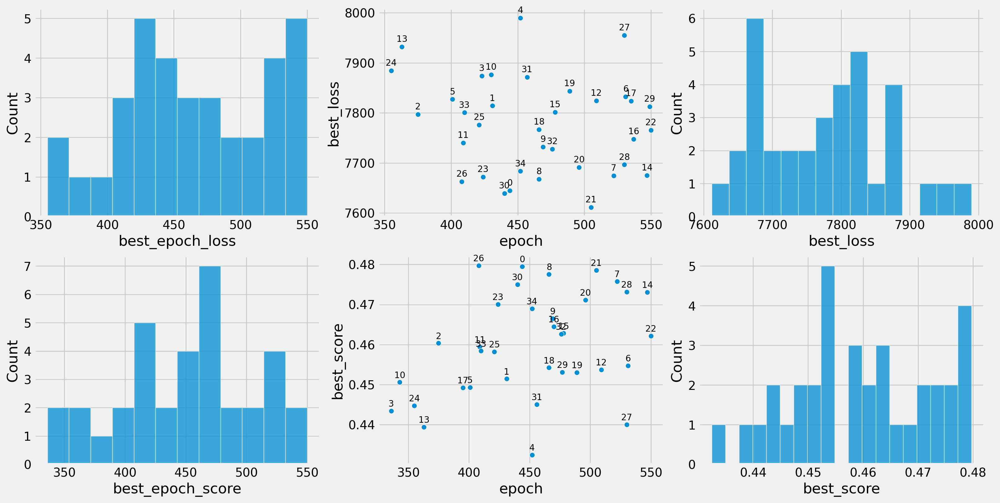

In [38]:
plot_expt_dist_rslt(expt20_rslt)

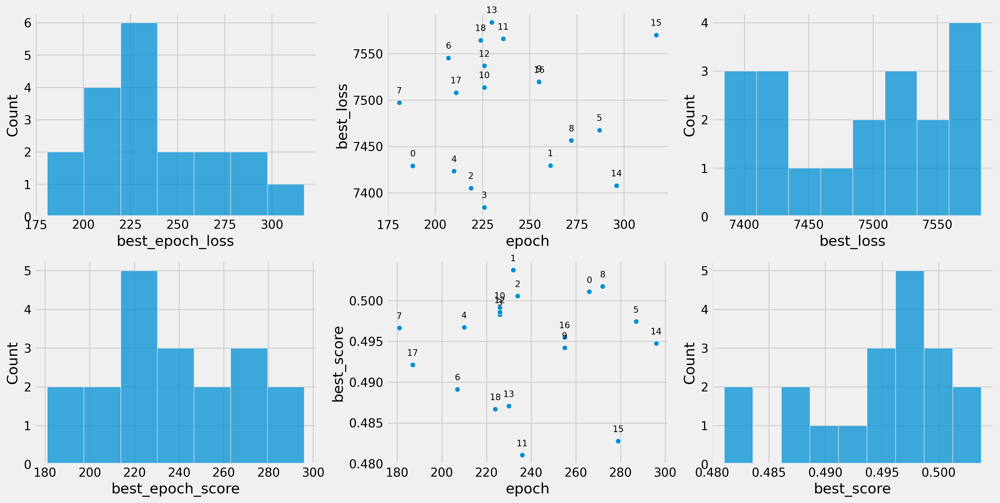

In [39]:
plot_expt_dist_rslt(expt21_rslt)

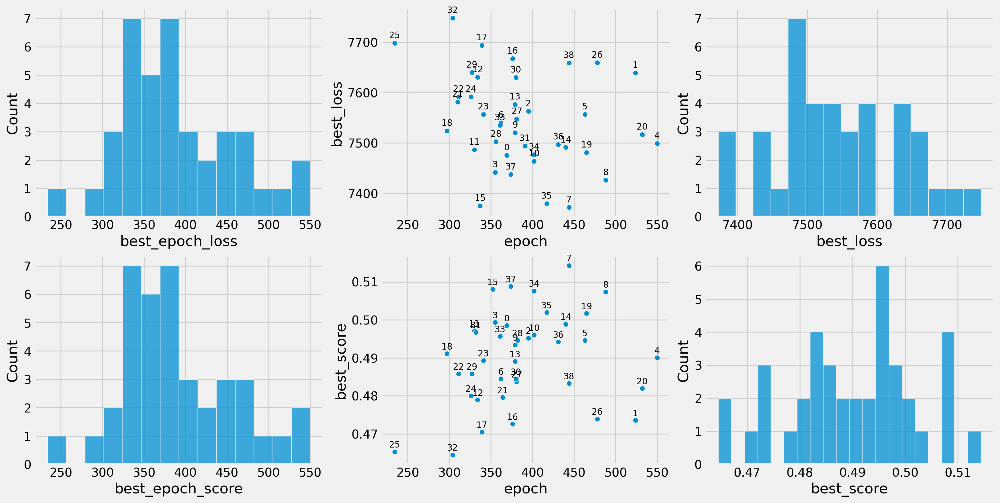

In [40]:
plot_expt_dist_rslt(expt22_rslt)

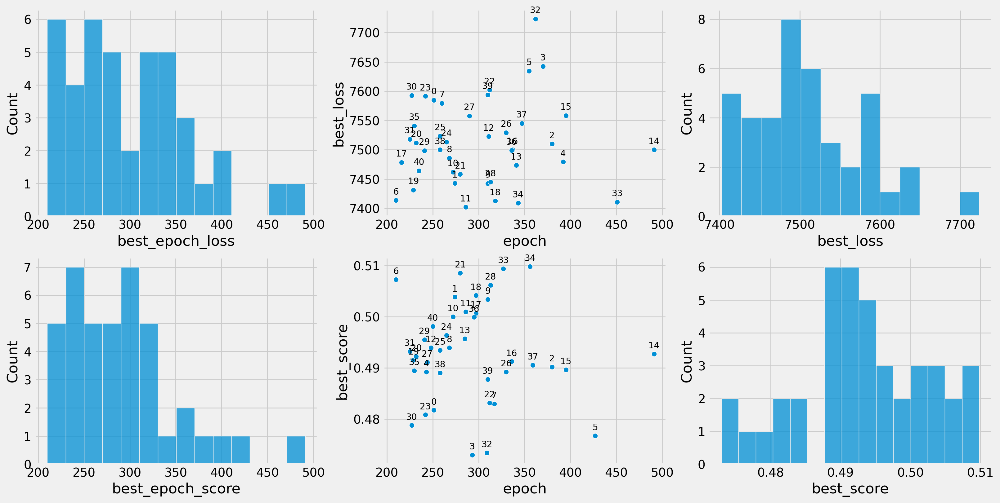

In [41]:
plot_expt_dist_rslt(expt23_rslt)

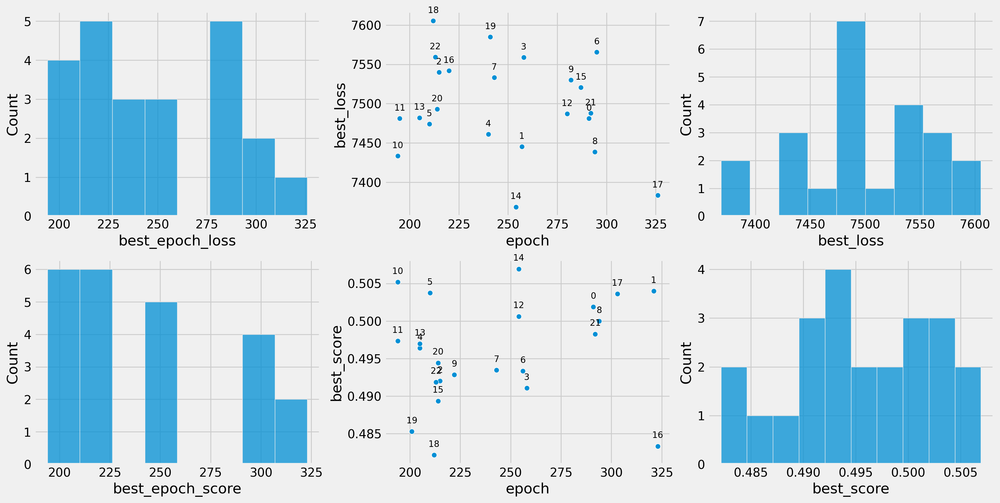

In [42]:
plot_expt_dist_rslt(expt24_rslt)

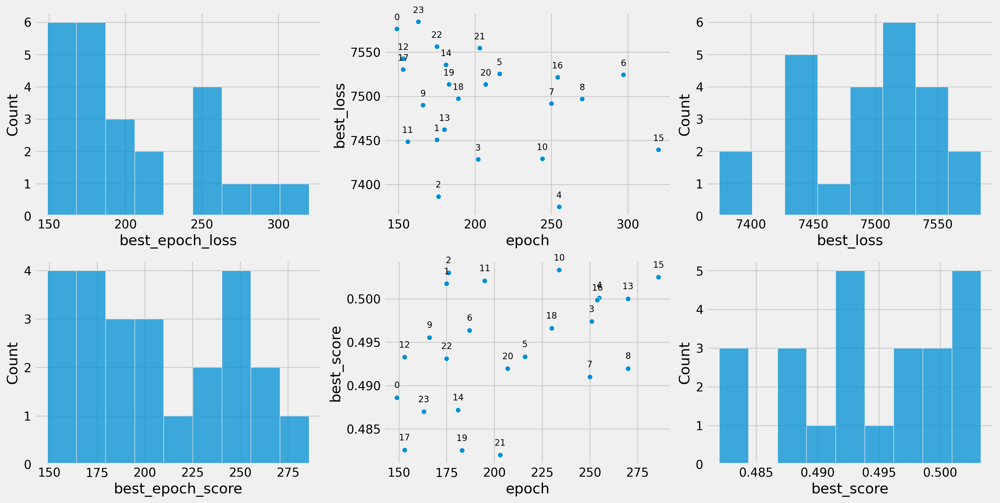

In [43]:
plot_expt_dist_rslt(expt25_rslt)

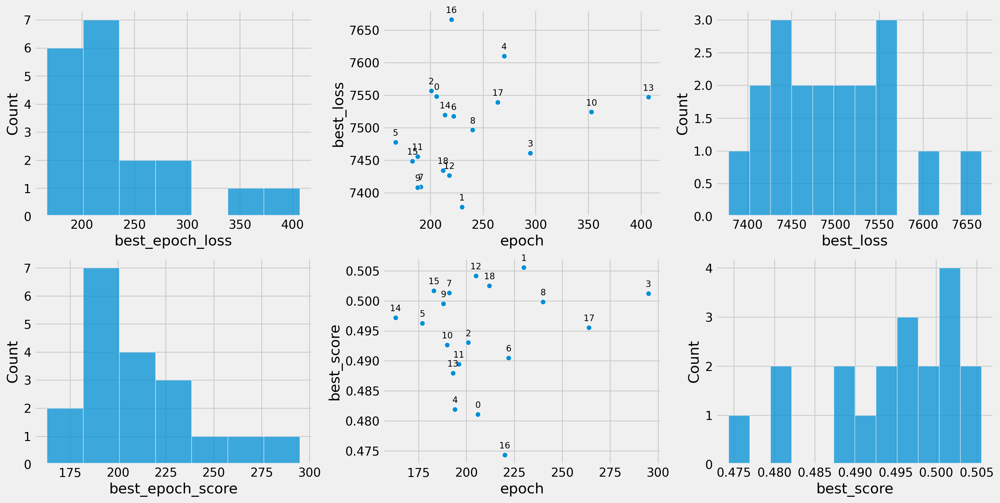

In [44]:
plot_expt_dist_rslt(expt26_rslt)

In [45]:
from collections import defaultdict

expt_rslt_dict = {
    '20480_2.0':expt20_rslt,
    '20480_2.1':expt21_rslt,
    '20480_2.2':expt22_rslt,
    '20480_2.3':expt23_rslt,
    '20480_2.4':expt24_rslt,
    '20480_2.5':expt25_rslt,
    '20480_2.6':expt26_rslt,
}

df_dict ={
    key : pd.DataFrame(val['valid_loss'])
    for key,val in expt_rslt_dict.items()
}

lr_dict = {
     '20480_2.0':1.76e-4,
     '20480_2.1':5e-4,
     '20480_2.2':2.84e-4,
     '20480_2.3':3.92e-4,
     '20480_2.4':4.46e-4,
     '20480_2.5':5.54e-4,
     '20480_2.6':5.27e-4,
}

def combine_val_dicts(dict1,dict2,name1='1',name2='2'):
  rslt = defaultdict(dict)
  for key,val in dict1.items():
    rslt[key][name1] = val
  for key,val in dict2.items():
    rslt[key][name2] = val
  return rslt

expt_dict = combine_val_dicts(df_dict,lr_dict,'df','lr')

for key,df in df_dict.items():
  df['epoch_approx'] = df['epoch'].apply(lambda x : round(x/10)*10)
  display(df.describe())
  print(df['epoch_approx'].mode())


,epoch,score,epoch_approx
count,35.000000,35.000000,35.000000
mean,465.142857,7775.292646,465.714286
std,55.800139,95.354972,56.113630
min,355.000000,7611.662368,360.000000
25%,423.500000,7687.519691,420.000000
50%,466.000000,7775.850050,470.000000
75%,515.500000,7829.895511,515.000000
max,550.000000,7989.682347,550.000000


0    410
1    420
2    470
3    530
4    550
Name: epoch_approx, dtype: int64


,epoch,score,epoch_approx
count,19.000000,19.000000,19.000000
mean,238.263158,7490.975121,240.000000
std,36.169112,63.701944,36.968455
min,181.000000,7384.473576,180.000000
25%,215.000000,7429.295120,215.000000
50%,226.000000,7507.883057,230.000000
75%,258.000000,7541.088407,260.000000
max,317.000000,7583.825684,320.000000


0    230
Name: epoch_approx, dtype: int64


,epoch,score,epoch_approx
count,39.000000,39.000000,39.000000
mean,387.897436,7542.864392,387.692308
std,69.559060,92.747812,69.109430
min,234.000000,7372.300591,230.000000
25%,338.000000,7484.137482,340.000000
50%,379.000000,7535.232047,380.000000
75%,435.500000,7610.961269,435.000000
max,550.000000,7748.170365,550.000000


0    380
Name: epoch_approx, dtype: int64


,epoch,score,epoch_approx
count,41.000000,41.000000,41.000000
mean,301.292683,7511.933315,301.463415
std,64.963930,71.986577,65.060010
min,210.000000,7402.174951,210.000000
25%,251.000000,7462.088180,250.000000
50%,290.000000,7500.055066,290.000000
75%,341.000000,7558.132309,340.000000
max,491.000000,7723.762943,490.000000


0    310
Name: epoch_approx, dtype: int64


,epoch,score,epoch_approx
count,23.000000,23.000000,23.000000
mean,248.608696,7498.194174,248.260870
std,38.617870,60.663400,39.502839
min,194.000000,7368.654965,190.000000
25%,213.500000,7467.502346,210.000000
50%,243.000000,7487.950320,240.000000
75%,284.500000,7540.838155,285.000000
max,326.000000,7605.459355,330.000000


0    210
1    290
Name: epoch_approx, dtype: int64


,epoch,score,epoch_approx
count,24.000000,24.000000,24.000000
mean,204.875000,7494.821326,205.416667
std,48.144089,56.654108,48.182548
min,149.000000,7374.599515,150.000000
25%,172.750000,7450.157160,177.500000
50%,186.000000,7505.397640,185.000000
75%,245.500000,7531.849471,242.500000
max,320.000000,7584.603615,320.000000


0    180
Name: epoch_approx, dtype: int64


,epoch,score,epoch_approx
count,19.000000,19.000000,19.000000
mean,235.210526,7496.006506,235.263158
std,60.807144,73.804815,61.043556
min,167.000000,7378.078476,170.000000
25%,196.000000,7441.448873,195.000000
50%,218.000000,7496.445424,220.000000
75%,252.000000,7543.031390,250.000000
max,407.000000,7666.399546,410.000000


0    190
1    210
2    220
Name: epoch_approx, dtype: int64


<Axes: xlabel='epoch_approx', ylabel='count'>

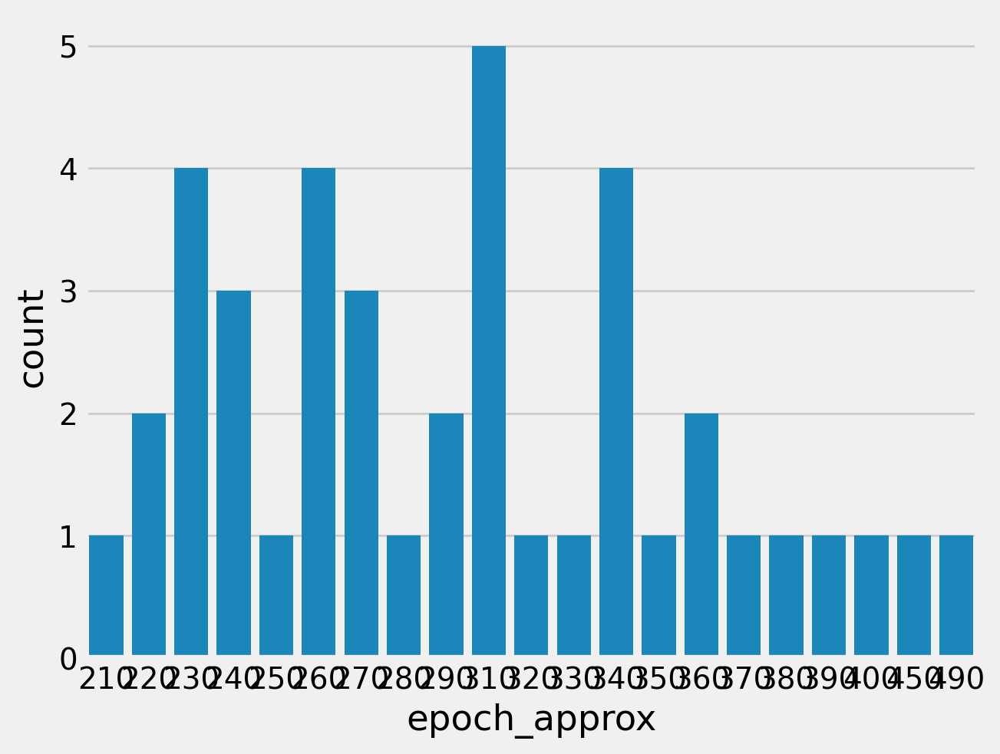

In [46]:
sns.countplot(df_dict['20480_2.3'],x='epoch_approx')

In [47]:
temp = df_dict['20480_2.3'].epoch.values
np.sort(temp)

array([210, 216, 225, 227, 229, 230, 232, 235, 241, 242, 251, 258, 258,
       260, 265, 268, 272, 274, 280, 286, 290, 310, 310, 311, 312, 313,
       318, 330, 336, 337, 341, 343, 347, 355, 362, 370, 380, 392, 395,
       451, 491])

In [48]:
expt2_mode ={
    1.76e-4:410,
    2.84e-4:330,
    3.92e-4:275,
    5e-4:225,
}

df_mode = pd.DataFrame([expt2_mode]).T
df_mode = df_mode.reset_index(names='lr')
df_mode

,lr,0
0,0.000176,410
1,0.000284,330
2,0.000392,275
3,0.000500,225


In [49]:
expt2_mode = {
    val['lr'] : val['df']['epoch'].median()
    for val in expt_dict.values()
}

df_mode = pd.DataFrame([expt2_mode]).T
df_mode = df_mode.reset_index(names='lr')
df_mode = df_mode.sort_values('lr')
display(df_mode)

expt2_mean = {
    val['lr'] : val['df']['epoch'].mean()
    for val in expt_dict.values()
}

df_mean = pd.DataFrame([expt2_mean]).T
df_mean = df_mean.reset_index(names='lr')
df_mean = df_mean.sort_values('lr')
display(df_mean)

display(np.abs(df_mean-df_mode))

,lr,0
0,0.000176,466.0
2,0.000284,379.0
3,0.000392,290.0
4,0.000446,243.0
1,0.000500,226.0
6,0.000527,218.0
5,0.000554,186.0


,lr,0
0,0.000176,465.142857
2,0.000284,387.897436
3,0.000392,301.292683
4,0.000446,248.608696
1,0.000500,238.263158
6,0.000527,235.210526
5,0.000554,204.875000


,lr,0
0,0.0,0.857143
2,0.0,8.897436
3,0.0,11.292683
4,0.0,5.608696
1,0.0,12.263158
6,0.0,17.210526
5,0.0,18.875000


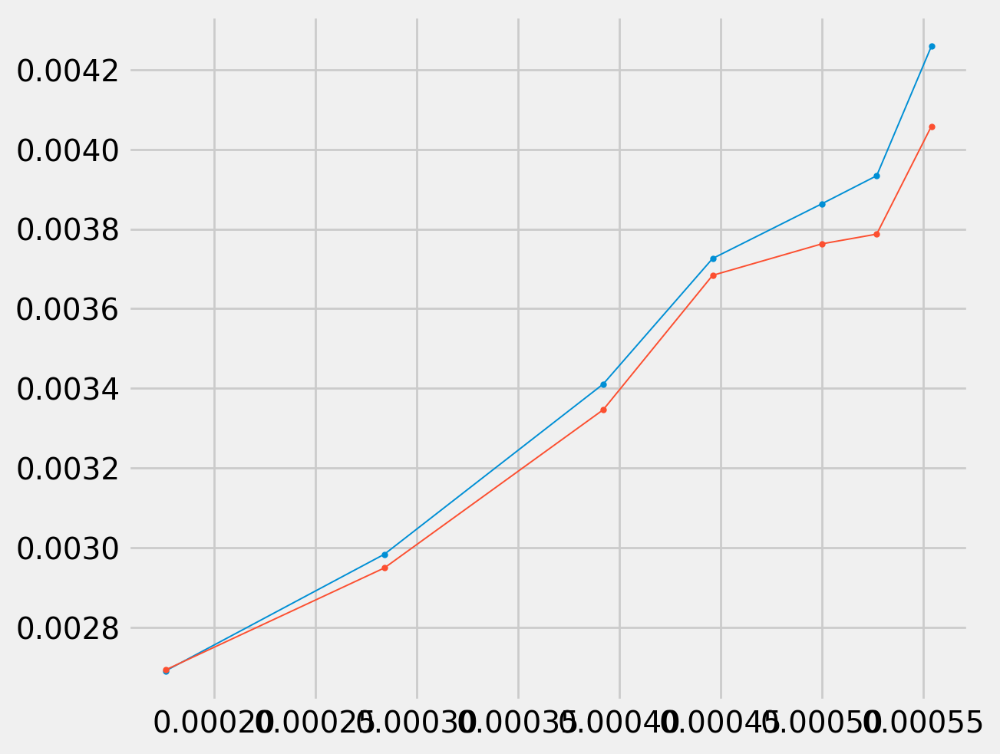

In [50]:
fig,ax=plt.subplots()
y = (len(data_dict['trn']['X'])/20480)*60
plt.plot(df_mode.lr.to_numpy(),np.power(df_mode[0].to_numpy()*y,-0.5),lw=0.7,marker='o',markersize=2)
plt.plot(df_mode.lr.to_numpy(),np.power(df_mean[0].to_numpy()*y,-0.5),lw=0.7,marker='o',markersize=2)
#plt.plot(df_mode.lr.to_numpy(),np.power(df_mode.lr.to_numpy()*10,1),lw=0.7,marker='o',markersize=2)
#plt.plot(np.power(df_mode.lr.to_numpy(),1),(df_mode[0].to_numpy()),lw=0.7,marker='o',markersize=2)

In [51]:
def get_lr_dict(expt_score_dict):
  temp = expt_score_dict
  temp['init_lr'] ={
    key : read_lr_from_name(key)
    for key in expt_score_dict['score'].keys()
  }
  return temp

def read_lr_from_name(dir_name) :
  temp = dir_name.split('_')
  return float(temp[-1])*float(temp[-2][2:])

def read_epoch_info(base_dir,expt_epoch,info):
  temp = dict()
  for key,val in expt_epoch.items():
    dat = load_pkl(os.path.join(base_dir,key,f'{info}.pkl'))
    temp[key] = float(dat[val-1])
  return temp

from tqdm.auto import tqdm

def read_expt_info(base_dir,expt_dirs,info):
  temp = dict()
  for key in tqdm(expt_dirs):
    cands = list(filter(lambda x : info in x, os.listdir(os.path.join(base_dir,key))))
    if len(cands) != 1 : raise Exception(f'multiple files exist : {key}, {cands}')
    temp[key] = load_pkl(os.path.join(base_dir,key,cands[0]))
  return temp

def add_epoch_info(base_dir,expt_epoch_dict,info):
  temp = expt_epoch_dict
  temp[info] = read_epoch_info(base_dir,expt_epoch_dict['epoch'],info)
  return temp


In [52]:
def get_expt_whole_rslt_df(base_dir,expt_name):
  temp= check_best_epoch(base_dir,expt_name,'valid_loss',False)
  epoch, score = dict(), dict()
  for dir in temp.keys():
    epoch[dir] = temp[dir][0]
    score[dir] = temp[dir][1]

  rslt = {
     'epoch' : epoch,
     'score' : score
  }
  rslt = get_lr_dict(rslt)
  rslt = add_epoch_info(base_dir,rslt,'valid_score')
  return pd.DataFrame(rslt)

from sklearn.metrics import r2_score
from sklearn.metrics import root_mean_squared_error as rmse
from sklearn.metrics import mean_absolute_percentage_error as mape

prefix_dixt ={
    'tst' : 'test',
    'vld' : 'valid',
    'trn' : 'train'
}

def add_test_rslt(base_dir,df,data='tst'):
  dirs = df.index.to_list()
  if data == 'tst' : key = 'rslt_best_model'
  else : key = f'rslt-{data}_best_model'
  temp = read_expt_info(base_dir,dirs,key)
  df[f'{data}_loss'] = pd.Series({dir : rmse(val[1],val[0]) for dir,val in temp.items()})
  df[f'{data}_score'] = pd.Series({dir : r2_score(val[1],val[0]) for dir,val in temp.items()})
  df[f'{data}_mape'] = pd.Series({dir : mape(val[1],val[0]) for dir,val in temp.items()})
  return df

In [53]:
idx_list = range(7)
df_expt_list = [get_expt_whole_rslt_df(os.path.join(RSLT_DIR,'model_test'),f'20480_2.{i}') for i in idx_list]

In [54]:
temp = get_expt_whole_rslt_df(os.path.join(RSLT_DIR,'model_test'),'20480_2.1')

a = temp['valid_score']['model4.5_20480_2.1_0_lr0.0005_1']
a

0.5010712742805481

<Axes: xlabel='init_lr', ylabel='valid_score'>

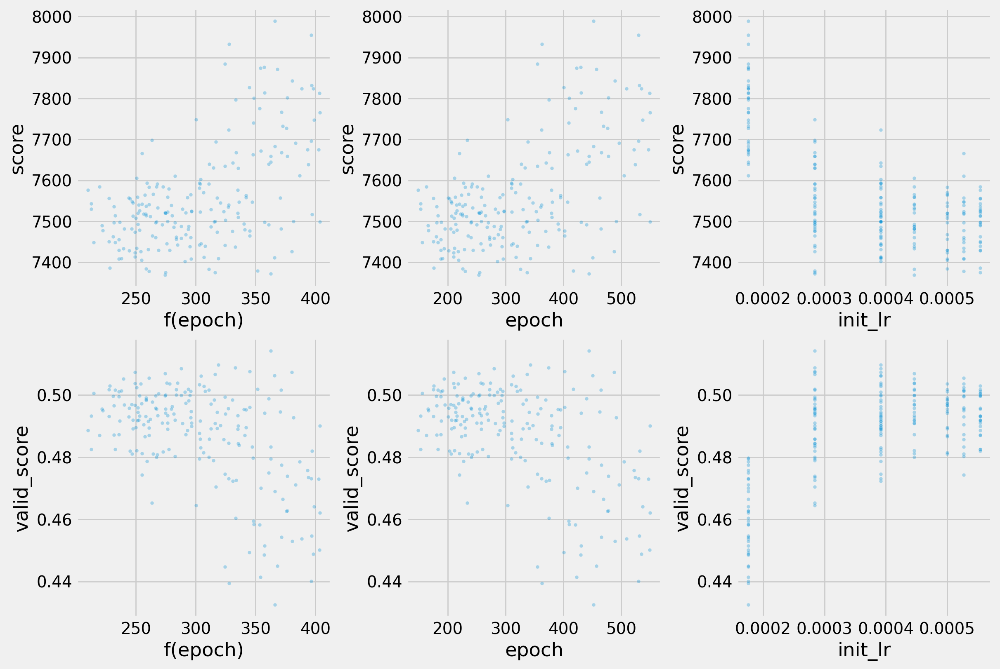

In [55]:
df_whole = pd.concat(df_expt_list)
coeff = (len(data_dict['trn']['X'])/20480)*60
df_whole['f(epoch)'] = np.power(coeff * df_whole['epoch'],+0.5)

fig,axes = plt.subplots(2,3,figsize=(12,8))
sns.scatterplot(data=df_whole,x='f(epoch)',y='score',alpha=0.3,s=10,ax=axes[0][0])
sns.scatterplot(data=df_whole,x='epoch',y='score',alpha=0.3,s=10,ax=axes[0][1])
sns.scatterplot(data=df_whole,x='init_lr',y='score',alpha=0.3,s=10,ax=axes[0][2])
sns.scatterplot(data=df_whole,x='f(epoch)',y='valid_score',alpha=0.3,s=10,ax=axes[1][0])
sns.scatterplot(data=df_whole,x='epoch',y='valid_score',alpha=0.3,s=10,ax=axes[1][1])
sns.scatterplot(data=df_whole,x='init_lr',y='valid_score',alpha=0.3,s=10,ax=axes[1][2])

#ax.scatter(df_mode.lr.to_numpy(),np.power(df_mode[0].to_numpy()*coeff,-0.5),lw=0.7,marker='x',s=45,color='#34d3af')

In [56]:
df_whole = add_test_rslt(os.path.join(RSLT_DIR,'model_test'),df_whole)
df_whole = add_test_rslt(os.path.join(RSLT_DIR,'model_test'),df_whole,'vld')
df_whole = add_test_rslt(os.path.join(RSLT_DIR,'model_test'),df_whole,'trn')

  0%|          | 0/200 [00:00<?, ?it/s]

  0%|          | 0/200 [00:00<?, ?it/s]

  0%|          | 0/200 [00:00<?, ?it/s]

In [57]:
df_whole.info()

<class 'pandas.core.frame.DataFrame'>
Index: 200 entries, model4.5_20480_2.0_0_lr0.000176_1 to model4.5_20480_2.6_18_lr0.000527_1
Data columns (total 14 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   epoch        200 non-null    int64  
 1   score        200 non-null    float64
 2   init_lr      200 non-null    float64
 3   valid_score  200 non-null    float64
 4   f(epoch)     200 non-null    float64
 5   tst_loss     200 non-null    float64
 6   tst_score    200 non-null    float64
 7   tst_mape     200 non-null    float64
 8   vld_loss     200 non-null    float64
 9   vld_score    200 non-null    float64
 10  vld_mape     200 non-null    float64
 11  trn_loss     200 non-null    float64
 12  trn_score    200 non-null    float64
 13  trn_mape     200 non-null    float64
dtypes: float64(13), int64(1)
memory usage: 31.5+ KB


In [58]:
df_whole.index[(np.abs(df_whole['valid_score']-df_whole['vld_score'])>5e-7)]

Index(['model4.5_20480_2.1_0_lr0.0005_1'], dtype='object')

In [59]:
df_whole.loc['model4.5_20480_2.1_0_lr0.0005_1'] #아마 실험 오류로 한 번의 테스트가 덧씌워진 듯

,model4.5_20480_2.1_0_lr0.0005_1
epoch,188.000000
score,7429.140731
init_lr,0.000500
valid_score,0.501071
f(epoch),236.059720
tst_loss,8698.023438
tst_score,0.427967
tst_mape,0.391379
vld_loss,7641.972168
vld_score,0.453356


In [60]:
display(df_whole.index[(df_whole['score'] < df_whole['vld_loss'])])

Index(['model4.5_20480_2.1_0_lr0.0005_1'], dtype='object')

In [61]:
df_whole.iloc[0] #vld_loss와 score과 다른 이유는 함 확인해봐야 함. 그런데 vld_score는 또 같은거고...

,model4.5_20480_2.0_0_lr0.000176_1
epoch,444.000000
score,7644.933747
init_lr,0.000176
valid_score,0.479500
f(epoch),362.772575
tst_loss,8510.256836
tst_score,0.452398
tst_mape,0.357151
vld_loss,7456.987305
vld_score,0.479500


<Axes: ylabel='Count'>

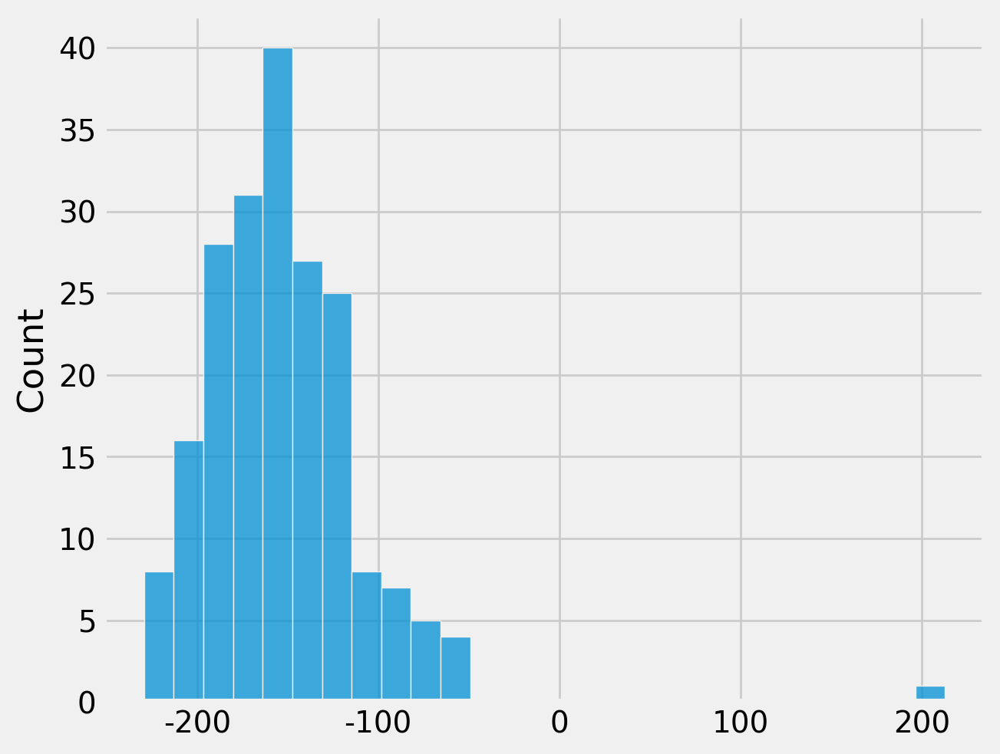

In [62]:
sns.histplot(x =df_whole['vld_loss'].values - df_whole['score'].values)

In [63]:
df_expt_list[0].info()

<class 'pandas.core.frame.DataFrame'>
Index: 35 entries, model4.5_20480_2.0_0_lr0.000176_1 to model4.5_20480_2.0_34_lr0.000176_1
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   epoch        35 non-null     int64  
 1   score        35 non-null     float64
 2   init_lr      35 non-null     float64
 3   valid_score  35 non-null     float64
dtypes: float64(3), int64(1)
memory usage: 1.4+ KB


In [64]:
display(df_expt_list[0].head())
display(df_whole.head())

,epoch,score,init_lr,valid_score
model4.5_20480_2.0_0_lr0.000176_1,444,7644.933747,0.000176,0.479500
model4.5_20480_2.0_1_lr0.000176_1,431,7814.182747,0.000176,0.451432
model4.5_20480_2.0_2_lr0.000176_1,375,7796.965564,0.000176,0.460336
model4.5_20480_2.0_3_lr0.000176_1,423,7873.925069,0.000176,0.441390
model4.5_20480_2.0_4_lr0.000176_1,452,7989.682347,0.000176,0.432457


,epoch,score,init_lr,valid_score,f(epoch),tst_loss,tst_score,tst_mape,vld_loss,vld_score,vld_mape,trn_loss,trn_score,trn_mape
model4.5_20480_2.0_0_lr0.000176_1,444,7644.933747,0.000176,0.479500,362.772575,8510.256836,0.452398,0.357151,7456.987305,0.479500,0.352562,6943.524902,0.601554,0.323951
model4.5_20480_2.0_1_lr0.000176_1,431,7814.182747,0.000176,0.451432,357.422261,8685.389648,0.429628,0.346606,7655.406250,0.451433,0.342210,7082.188965,0.585481,0.315615
model4.5_20480_2.0_2_lr0.000176_1,375,7796.965564,0.000176,0.460336,333.394627,8584.948242,0.442744,0.387158,7593.025879,0.460336,0.381434,7005.671387,0.594390,0.351948
model4.5_20480_2.0_3_lr0.000176_1,423,7873.925069,0.000176,0.441390,354.089580,8710.184570,0.426367,0.357565,7725.158691,0.441390,0.354732,7364.562012,0.551767,0.331462
model4.5_20480_2.0_4_lr0.000176_1,452,7989.682347,0.000176,0.432457,366.026206,8800.828125,0.414365,0.363786,7786.683594,0.432457,0.359058,7490.977051,0.536247,0.336884


In [65]:
def desc_dist(data,key,val):
  keys = sorted(data[key].unique())
  dict_desc = dict()
  for k in keys:
    cond = data[key]==k
    dict_desc[k] ={
        'count' : np.sum(cond),
        'mean' : data.loc[cond,val].mean(),
        'std' : data.loc[cond,val].std(),
        'min' : np.min(data.loc[cond,val]),
        'q1' : np.quantile(data.loc[cond,val],0.25),
        'median' : data.loc[cond,val].median(),
        'q3' : np.quantile(data.loc[cond,val],0.75),
        'max' : np.max(data.loc[cond,val]),
    }

  return pd.DataFrame(dict_desc).T

df_desc = desc_dist(df_whole,'init_lr','epoch')
df_desc

,count,mean,std,min,q1,median,q3,max
0.000176,35.0,465.142857,55.800139,355.0,423.50,466.0,515.5,550.0
0.000284,39.0,387.897436,69.559060,234.0,338.00,379.0,435.5,550.0
0.000392,41.0,301.292683,64.963930,210.0,251.00,290.0,341.0,491.0
0.000446,23.0,248.608696,38.617870,194.0,213.50,243.0,284.5,326.0
0.000500,19.0,238.263158,36.169112,181.0,215.00,226.0,258.0,317.0
0.000527,19.0,235.210526,60.807144,167.0,196.00,218.0,252.0,407.0
0.000554,24.0,204.875000,48.144089,149.0,172.75,186.0,245.5,320.0


In [66]:
init_lrs = sorted(df_whole['init_lr'].unique())
cnt, val = 0, 0
for lr in init_lrs[1:]:
  n = df_desc.loc[lr,'count']
  val += n*df_desc.loc[lr,'std']
  cnt += n

val/=cnt
cnt, val


(165.0, 56.13662121621185)

In [67]:
cnt, val = 0, 0
for lr in init_lrs[1:]:
  n = df_desc.loc[lr,'count']
  n = 2*n if n < 30 else n
  val += n*df_desc.loc[lr,'std']
  cnt += n

val/=cnt
cnt, val


(250.0, 52.59504206570072)

In [68]:
df_whole.info()

<class 'pandas.core.frame.DataFrame'>
Index: 200 entries, model4.5_20480_2.0_0_lr0.000176_1 to model4.5_20480_2.6_18_lr0.000527_1
Data columns (total 14 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   epoch        200 non-null    int64  
 1   score        200 non-null    float64
 2   init_lr      200 non-null    float64
 3   valid_score  200 non-null    float64
 4   f(epoch)     200 non-null    float64
 5   tst_loss     200 non-null    float64
 6   tst_score    200 non-null    float64
 7   tst_mape     200 non-null    float64
 8   vld_loss     200 non-null    float64
 9   vld_score    200 non-null    float64
 10  vld_mape     200 non-null    float64
 11  trn_loss     200 non-null    float64
 12  trn_score    200 non-null    float64
 13  trn_mape     200 non-null    float64
dtypes: float64(13), int64(1)
memory usage: 31.5+ KB


In [69]:
df_desc2 = desc_dist(df_whole,'init_lr','vld_loss')
df_desc2

,count,mean,std,min,q1,median,q3,max
0.000176,35.0,7598.099791,90.959879,7455.360840,7520.550537,7599.571777,7667.078125,7786.683594
0.000284,39.0,7381.024552,88.191116,7203.161621,7324.442871,7373.483887,7434.397949,7563.840820
0.000392,41.0,7361.705495,69.137320,7237.458984,7310.615723,7365.089355,7391.454590,7508.418945
0.000446,23.0,7343.865595,54.936750,7257.777832,7302.487549,7338.875000,7370.811035,7453.348145
0.000500,19.0,7368.609529,80.653301,7281.876465,7324.245361,7341.368164,7395.048828,7641.972168
0.000527,19.0,7355.455258,66.507179,7267.832520,7299.279297,7341.020996,7406.616699,7493.984863
0.000554,24.0,7355.767680,46.728789,7286.703613,7309.330566,7358.227295,7383.989014,7439.108398


In [70]:
df_desc2 = desc_dist(df_whole,'init_lr','tst_loss')
df_desc2

,count,mean,std,min,q1,median,q3,max
0.000176,35.0,8629.153181,82.712576,8450.181641,8584.928223,8633.677734,8687.534180,8800.828125
0.000284,39.0,8507.842874,87.639310,8329.232422,8448.355469,8513.005859,8556.461426,8678.063477
0.000392,41.0,8483.494522,73.668382,8351.933594,8428.649414,8466.597656,8533.852539,8645.986328
0.000446,23.0,8470.837551,79.481147,8337.542969,8412.899902,8471.942383,8494.150391,8673.708984
0.000500,19.0,8476.567948,103.402801,8315.838867,8409.847656,8485.343750,8518.179688,8698.023438
0.000527,19.0,8423.160619,81.553717,8265.035156,8368.824219,8424.439453,8474.769531,8556.323242
0.000554,24.0,8455.139689,94.857701,8126.821289,8407.560059,8465.217773,8522.098877,8559.454102


In [71]:
df_desc3 = desc_dist(df_whole,'init_lr','vld_score')
df_desc3

,count,mean,std,min,q1,median,q3,max
0.000176,35.0,0.459539,0.012945,0.432457,0.449758,0.459405,0.470589,0.479727
0.000284,39.0,0.489980,0.012200,0.464477,0.482649,0.491092,0.497839,0.514332
0.000392,41.0,0.492673,0.009537,0.472296,0.488609,0.492250,0.499733,0.509696
0.000446,23.0,0.495145,0.007565,0.480008,0.491461,0.495858,0.500845,0.506939
0.000500,19.0,0.491707,0.011253,0.453356,0.488111,0.495516,0.497866,0.503659
0.000527,19.0,0.493539,0.009181,0.474323,0.486508,0.495564,0.501284,0.505572
0.000554,24.0,0.493515,0.006440,0.481993,0.489641,0.493196,0.499909,0.503001


In [72]:
cond = df_whole['init_lr'] == 0.000446
df_whole[cond].sort_values(by='tst_loss',ascending=True)

,epoch,score,init_lr,valid_score,f(epoch),tst_loss,tst_score,tst_mape,vld_loss,vld_score,vld_mape,trn_loss,trn_score,trn_mape
model4.5_20480_2.4_8_lr0.000446_1,294,7438.678512,0.000446,0.499996,295.200187,8337.542969,0.474400,0.359422,7308.697754,0.499996,0.357172,5656.028809,0.735617,0.308840
model4.5_20480_2.4_18_lr0.000446_1,326,7383.420210,0.000446,0.501694,310.850638,8371.522461,0.470107,0.364730,7296.277344,0.501694,0.362087,5540.610840,0.746297,0.308324
model4.5_20480_2.4_10_lr0.000446_1,282,7530.157767,0.000446,0.490921,289.112931,8375.150391,0.469647,0.391746,7374.725098,0.490921,0.387808,5826.831055,0.719409,0.342769
model4.5_20480_2.4_11_lr0.000446_1,194,7433.671368,0.000446,0.505180,239.797046,8382.261719,0.468746,0.375196,7270.711426,0.505180,0.371215,6295.464844,0.672459,0.323553
model4.5_20480_2.4_5_lr0.000446_1,210,7473.960797,0.000446,0.503727,249.489694,8392.052734,0.467504,0.361309,7281.379883,0.503727,0.357457,6051.412598,0.697362,0.315230
model4.5_20480_2.4_14_lr0.000446_1,205,7482.224536,0.000446,0.496972,246.501686,8403.937500,0.465995,0.348832,7330.765137,0.496972,0.345951,6195.464355,0.682782,0.302655
model4.5_20480_2.4_13_lr0.000446_1,280,7487.310331,0.000446,0.499914,288.085884,8421.862305,0.463715,0.355506,7309.293457,0.499914,0.352261,5901.765625,0.712145,0.308593
model4.5_20480_2.4_4_lr0.000446_1,240,7461.043895,0.000446,0.495858,266.715702,8442.922852,0.461029,0.359965,7338.875000,0.495858,0.357370,6213.603027,0.680922,0.303787
model4.5_20480_2.4_0_lr0.000446_1,291,7481.142693,0.000446,0.501882,293.690202,8458.743164,0.459008,0.352000,7294.901855,0.501882,0.350972,5920.865234,0.710279,0.304623
model4.5_20480_2.4_12_lr0.000446_1,195,7481.318868,0.000446,0.496840,240.414285,8462.882812,0.458478,0.366225,7331.724121,0.496840,0.362817,6366.828613,0.664991,0.324582


In [73]:
df_whole.sort_values(by='tst_loss',ascending=True)

,epoch,score,init_lr,valid_score,f(epoch),tst_loss,tst_score,tst_mape,vld_loss,vld_score,vld_mape,trn_loss,trn_score,trn_mape
model4.5_20480_2.5_6_lr0.000554_1,216,7525.644956,0.000554,0.493329,253.028732,8126.821289,0.500632,0.344178,7357.260742,0.493329,0.344870,5665.269531,0.734753,0.290029
model4.5_20480_2.6_10_lr0.000527_1,353,7524.125863,0.000527,0.485701,323.467250,8265.035156,0.483501,0.358782,7412.433594,0.485702,0.357969,5380.115723,0.760783,0.299935
model4.5_20480_2.6_12_lr0.000527_1,218,7426.672337,0.000527,0.503671,254.197462,8276.033203,0.482126,0.384343,7281.786133,0.503671,0.381994,6054.964844,0.697007,0.339899
model4.5_20480_2.1_9_lr0.0005_1,272,7456.446875,0.000500,0.501739,283.940547,8315.838867,0.477132,0.378614,7295.947754,0.501739,0.375657,5628.571777,0.738178,0.322257
model4.5_20480_2.2_38_lr0.000284_1,374,7437.433832,0.000284,0.508829,332.949804,8329.232422,0.475447,0.368021,7243.852051,0.508829,0.362504,6379.915527,0.663613,0.332877
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
model4.5_20480_2.0_3_lr0.000176_1,423,7873.925069,0.000176,0.441390,354.089580,8710.184570,0.426367,0.357565,7725.158691,0.441390,0.354732,7364.562012,0.551767,0.331462
model4.5_20480_2.0_10_lr0.000176_1,430,7876.182197,0.000176,0.448512,357.007377,8725.190430,0.424389,0.370615,7675.757324,0.448512,0.367213,7248.039551,0.565839,0.338212
model4.5_20480_2.0_5_lr0.000176_1,401,7827.195283,0.000176,0.449314,344.758632,8732.138672,0.423471,0.365681,7670.169922,0.449315,0.360833,7208.913086,0.570514,0.336672
model4.5_20480_2.0_13_lr0.000176_1,363,7932.310760,0.000176,0.439420,328.016942,8787.754883,0.416104,0.373028,7738.769043,0.439420,0.368835,7497.673828,0.535418,0.345682


In [74]:
ds_temp = df_whole.loc['model4.5_20480_2.4_8_lr0.000446_1']

temp = dict()
for mode in ['trn','vld','tst']:
  temp [mode] = { score : ds_temp[f'{mode}_{score}'] for score in ['loss','score','mape']}

print(pd.DataFrame(temp).to_markdown())


|       |         trn |         vld |         tst |
|:------|------------:|------------:|------------:|
| loss  | 5656.03     | 7308.7      | 8337.54     |
| score |    0.735617 |    0.499996 |    0.4744   |
| mape  |    0.30884  |    0.357172 |    0.359422 |


In [75]:
ds_temp = df_whole.loc['model4.5_20480_2.4_1_lr0.000446_1']

temp = dict()
for mode in ['trn','vld','tst']:
  temp [mode] = { score : ds_temp[f'{mode}_{score}'] for score in ['loss','score','mape']}

print(pd.DataFrame(temp).to_markdown())


|       |         trn |         vld |         tst |
|:------|------------:|------------:|------------:|
| loss  | 6276.79     | 7280.17     | 8471.94     |
| score |    0.6744   |    0.503892 |    0.457318 |
| mape  |    0.298805 |    0.345549 |    0.347722 |


In [76]:
df_temp = df_whole.sort_values(by=['valid_score','score'],ascending=False)
df_temp

,epoch,score,init_lr,valid_score,f(epoch),tst_loss,tst_score,tst_mape,vld_loss,vld_score,vld_mape,trn_loss,trn_score,trn_mape
model4.5_20480_2.2_7_lr0.000284_1,444,7372.300591,0.000284,0.514331,362.772575,8363.469727,0.471125,0.367868,7203.161621,0.514332,0.364057,6022.703613,0.700227,0.319228
model4.5_20480_2.3_35_lr0.000392_1,343,7408.948103,0.000392,0.509696,318.852644,8438.709961,0.461567,0.355360,7237.458984,0.509696,0.355623,5732.791016,0.728392,0.294961
model4.5_20480_2.2_38_lr0.000284_1,374,7437.433832,0.000284,0.508829,332.949804,8329.232422,0.475447,0.368021,7243.852051,0.508829,0.362504,6379.915527,0.663613,0.332877
model4.5_20480_2.3_22_lr0.000392_1,280,7458.246443,0.000392,0.508585,288.085884,8428.649414,0.462850,0.382141,7245.651855,0.508585,0.378151,5971.655273,0.705287,0.332516
model4.5_20480_2.2_35_lr0.000284_1,402,7476.710105,0.000284,0.507635,345.188238,8524.273438,0.450593,0.355112,7252.648438,0.507635,0.351083,6125.794434,0.689877,0.308221
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
model4.5_20480_2.0_24_lr0.000176_1,355,7884.277773,0.000176,0.444761,324.382293,8705.378906,0.427000,0.358019,7701.812988,0.444762,0.355606,7303.956055,0.559114,0.323076
model4.5_20480_2.0_3_lr0.000176_1,423,7873.925069,0.000176,0.441390,354.089580,8710.184570,0.426367,0.357565,7725.158691,0.441390,0.354732,7364.562012,0.551767,0.331462
model4.5_20480_2.0_27_lr0.000176_1,530,7955.047203,0.000176,0.440037,396.351857,8699.406250,0.427786,0.371024,7734.509277,0.440037,0.367871,7219.087402,0.569301,0.342890
model4.5_20480_2.0_13_lr0.000176_1,363,7932.310760,0.000176,0.439420,328.016942,8787.754883,0.416104,0.373028,7738.769043,0.439420,0.368835,7497.673828,0.535418,0.345682


In [77]:
df_whole[['tst_loss','tst_score','tst_mape']].describe()

,tst_loss,tst_score,tst_mape
count,200.000000,200.000000,200.000000
mean,8502.484839,0.453315,0.361456
std,104.815890,0.013492,0.013354
min,8126.821289,0.414365,0.334195
25%,8428.543945,0.445765,0.352771
50%,8494.572754,0.454415,0.359267
75%,8561.642822,0.462863,0.369822
max,8800.828125,0.500632,0.401592


<Axes: xlabel='vld_mape', ylabel='tst_mape'>

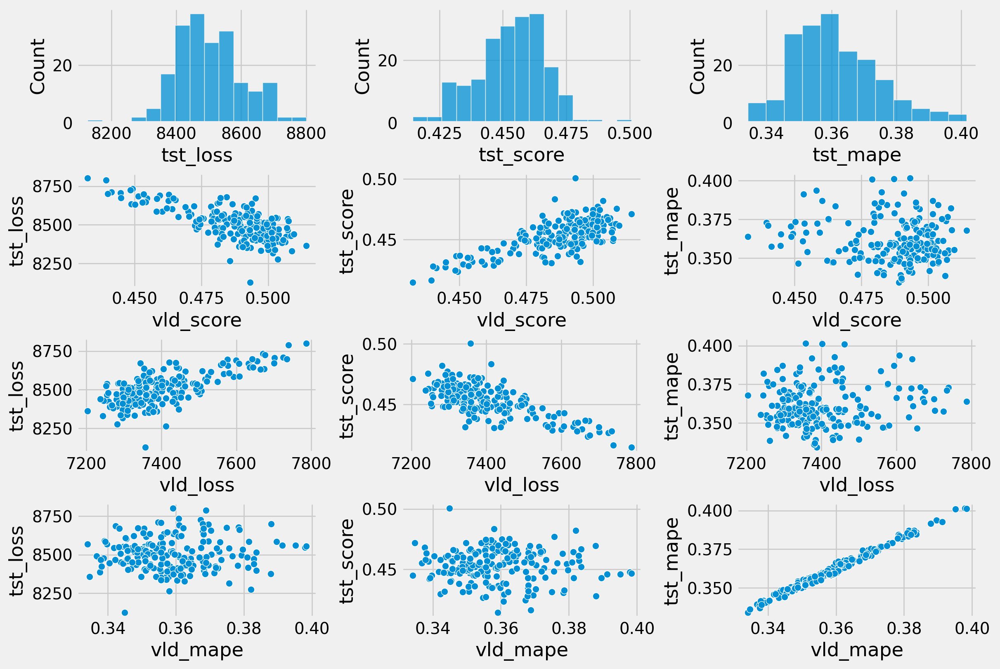

In [78]:
fig,axes = plt.subplots(4,3,figsize=(12,8))
ax_flt = axes.flatten()
sns.histplot(data=df_whole,x='tst_loss',ax = ax_flt[0])
sns.histplot(data=df_whole,x='tst_score',ax = ax_flt[1])
sns.histplot(data=df_whole,x='tst_mape',ax = ax_flt[2])
sns.scatterplot(data=df_whole,x='vld_score',y='tst_loss',ax=ax_flt[3])
sns.scatterplot(data=df_whole,x='vld_score',y='tst_score',ax=ax_flt[4])
sns.scatterplot(data=df_whole,x='vld_score',y='tst_mape',ax=ax_flt[5])
sns.scatterplot(data=df_whole,x='vld_loss',y='tst_loss',ax=ax_flt[6])
sns.scatterplot(data=df_whole,x='vld_loss',y='tst_score',ax=ax_flt[7])
sns.scatterplot(data=df_whole,x='vld_loss',y='tst_mape',ax=ax_flt[8])
sns.scatterplot(data=df_whole,x='vld_mape',y='tst_loss',ax=ax_flt[9])
sns.scatterplot(data=df_whole,x='vld_mape',y='tst_score',ax=ax_flt[10])
sns.scatterplot(data=df_whole,x='vld_mape',y='tst_mape',ax=ax_flt[11])

<Axes: xlabel='None', ylabel='Count'>

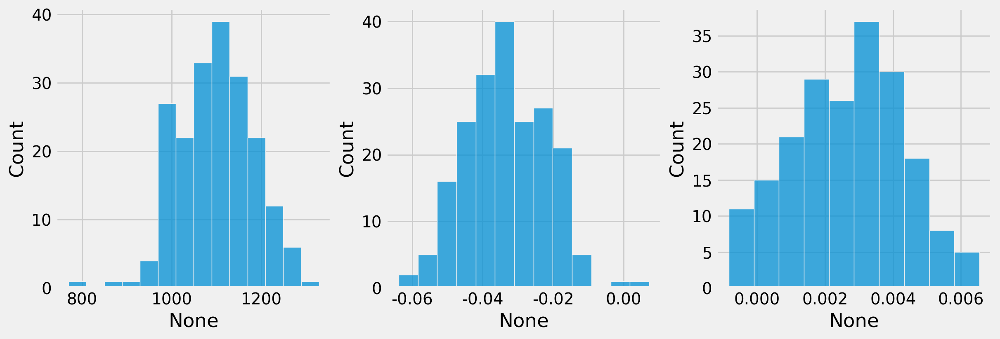

In [79]:
fig,ax = plt.subplots(1,3, figsize=(12,4))
sns.histplot(x=df_whole['tst_loss']-df_whole['vld_loss'],ax=ax[0])
sns.histplot(x=df_whole['tst_score']-df_whole['vld_score'],ax=ax[1])
sns.histplot(x=df_whole['tst_mape']-df_whole['vld_mape'],ax=ax[2])

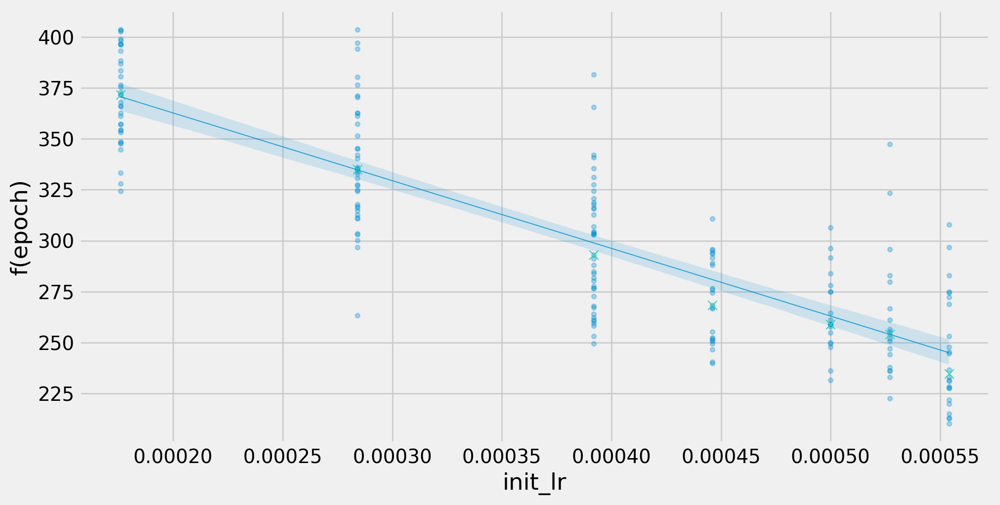

In [80]:
#df_whole = pd.concat(df_expt_list)
len(df_whole)
df_whole['coeff'] = (len(data_dict['trn']['X'])/20480)*60
df_whole['f(epoch)'] = np.power(df_whole['coeff']* df_whole['epoch'],+0.5)

fig,ax = plt.subplots(figsize=(10,5))
#sns.scatterplot(data=df_whole,x='init_lr',y='f(epoch)',alpha=0.3,s=10,ax=ax)
sns.regplot(data=df_whole,x='init_lr',y='f(epoch)',scatter_kws={'alpha':0.3,'s':10},line_kws={'alpha':0.8,'lw':0.7},ax=ax);

ax.scatter(df_mode.lr.to_numpy(),np.power(df_mode[0].to_numpy()*coeff,+0.5),lw=0.7,marker='x',s=45,color='#34d3af')

In [81]:
df_mode

,lr,0
0,0.000176,466.0
2,0.000284,379.0
3,0.000392,290.0
4,0.000446,243.0
1,0.000500,226.0
6,0.000527,218.0
5,0.000554,186.0


PearsonRResult(statistic=-0.7507623427998246, pvalue=3.6702267922057224e-31)


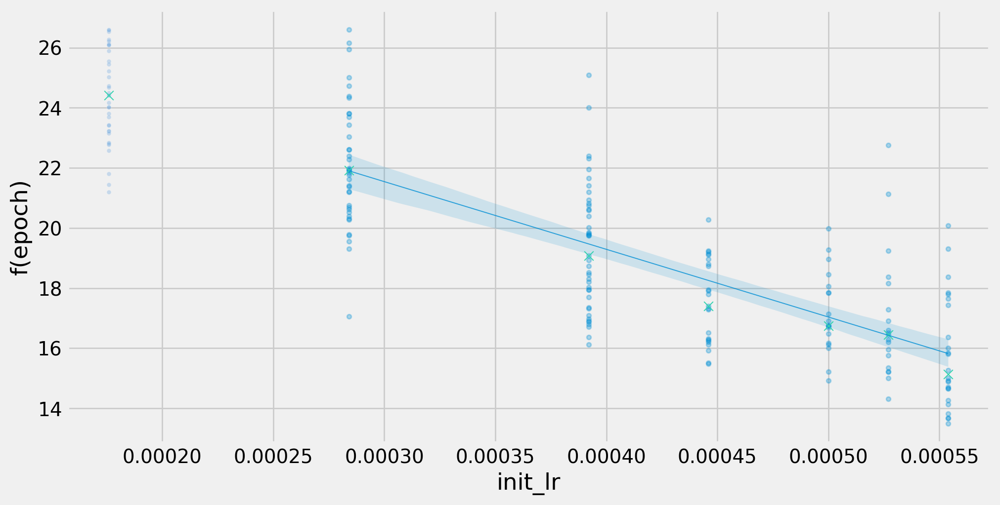

In [82]:
from scipy.stats import pearsonr

len(df_whole)
#df_whole['coeff'] = (len(data_dict['trn']['X'])/20480)*60
df_whole['f(epoch)'] = np.power(df_whole['epoch'],0.52)

fig,ax = plt.subplots(figsize=(10,5))
#sns.scatterplot(data=df_whole,x='init_lr',y='f(epoch)',alpha=0.3,s=10,ax=ax)
cond = df_whole['init_lr'] != 0.000176
sns.regplot(data=df_whole[cond],x='init_lr',y='f(epoch)',scatter_kws={'alpha':0.3,'s':10},line_kws={'alpha':0.8,'lw':0.7},ax=ax);
sns.scatterplot(data=df_whole[~cond],x='init_lr',y='f(epoch)',alpha=0.3,s=10,c='#65a3de');

ax.scatter(df_mode.lr.to_numpy(),np.power(df_mode[0].to_numpy(),+0.52),lw=0.7,marker='x',s=45,color='#34d3af')

print(pearsonr(df_whole.loc[cond,'init_lr'],df_whole.loc[cond,'f(epoch)']))

PearsonRResult(statistic=-0.7413910000633147, pvalue=4.8585478286396256e-30)


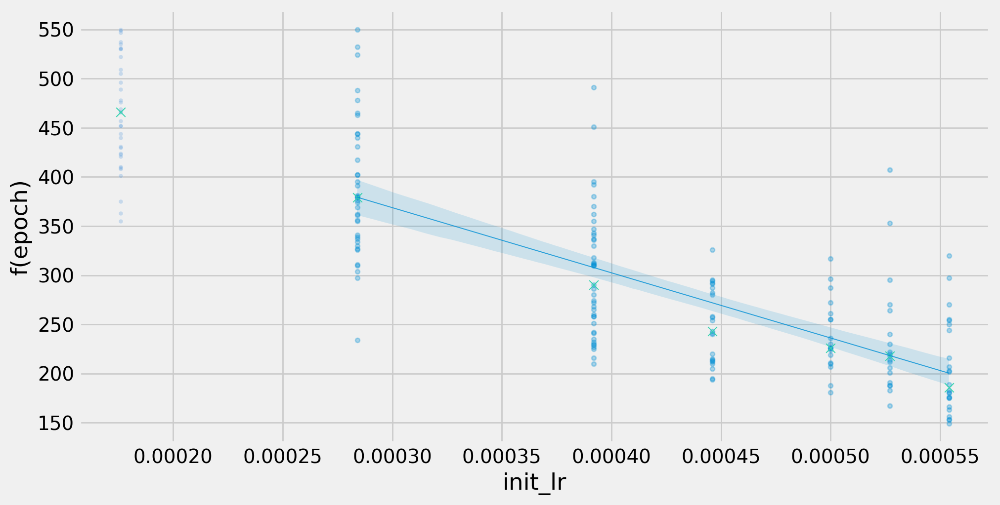

In [83]:
from scipy.stats import pearsonr

len(df_whole)
deg = 1
#df_whole['coeff'] = (len(data_dict['trn']['X'])/20480)*60
df_whole['f(epoch)'] = np.power(df_whole['epoch'],deg)

fig,ax = plt.subplots(figsize=(10,5))
#sns.scatterplot(data=df_whole,x='init_lr',y='f(epoch)',alpha=0.3,s=10,ax=ax)
cond = df_whole['init_lr'] != 0.000176
sns.regplot(data=df_whole[cond],x='init_lr',y='f(epoch)',scatter_kws={'alpha':0.3,'s':10},line_kws={'alpha':0.8,'lw':0.7},ax=ax);
sns.scatterplot(data=df_whole[~cond],x='init_lr',y='f(epoch)',alpha=0.3,s=10,c='#65a3de');

ax.scatter(df_mode.lr.to_numpy(),np.power(df_mode[0].to_numpy(),deg),lw=0.7,marker='x',s=45,color='#34d3af')

print(pearsonr(df_whole.loc[cond,'init_lr'],df_whole.loc[cond,'f(epoch)']))

In [84]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score, root_mean_squared_error

X = df_whole['init_lr'].values.reshape(-1,1)
y = df_whole['f(epoch)'].values

reg = LinearRegression(fit_intercept=True)

reg.fit(X,y)

print(reg.score(X,y))

a,b = reg.coef_,reg.intercept_
r2_score(y,a*X+b), root_mean_squared_error(y,a*X+b)

0.7081223690301311


(0.7081223690301311, 57.47110289457792)

In [85]:
df_temp = df_whole[['init_lr','coeff','epoch']]

deg_list = [1,-0.3,-0.5,-1,-2]
deg_list = np.append(-1/np.arange(1,11),np.arange(1,3,0.5))
reg_rslt=dict()

for deg in deg_list:
  X= df_whole['init_lr'].values.reshape(-1,1)
  y= np.power(df_whole['coeff'] * df_whole['epoch'], deg).values
  reg = LinearRegression(fit_intercept=True)
  reg.fit(X,y)
  a,b = reg.coef_,reg.intercept_
  estim = np.power(a*df_whole['init_lr']+b,1/deg)/df_whole['coeff']
  rslt = {
      'a':a,
      'b':b,
      'r2score':r2_score(df_whole['epoch'],estim),
      'rmse':root_mean_squared_error(df_whole['epoch'],estim),
  }
  reg_rslt[deg] = rslt

pd.DataFrame(reg_rslt)

,-1.000000,-0.500000,-0.333333,-0.250000,-0.200000,-0.166667,-0.142857,-0.125000,-0.111111,-0.100000,1.000000,1.500000,2.000000,2.500000
a,[0.02501714451659147],[3.6666908024005966],[16.303515226008326],[31.602184477009217],[44.70290388553837],[54.47745435368063],[61.262231950970325],[65.71348840723357],[68.43938988022043],[69.91916788397592],[-205561022.522774],[-96923022413.34258],[-41276072411576.97],[-1.6730657110800566e+16]
b,0.000002,0.002003,0.016328,0.046062,0.085559,0.12914,0.173199,0.215795,0.256006,0.293479,172447.230945,67007603.303713,25582834130.499889,9679153794583.830078
r2score,0.670416,0.697397,0.702416,0.704433,0.705505,0.706166,0.706612,0.706933,0.707174,0.707362,0.708122,0.697224,0.67598,0.630339
rmse,61.070617,58.51748,58.030217,57.833142,57.72817,57.663413,57.619632,57.588119,57.564379,57.545868,57.471103,58.534238,60.552911,64.677183


29 0.4500000000000013
29 0.4500000000000013


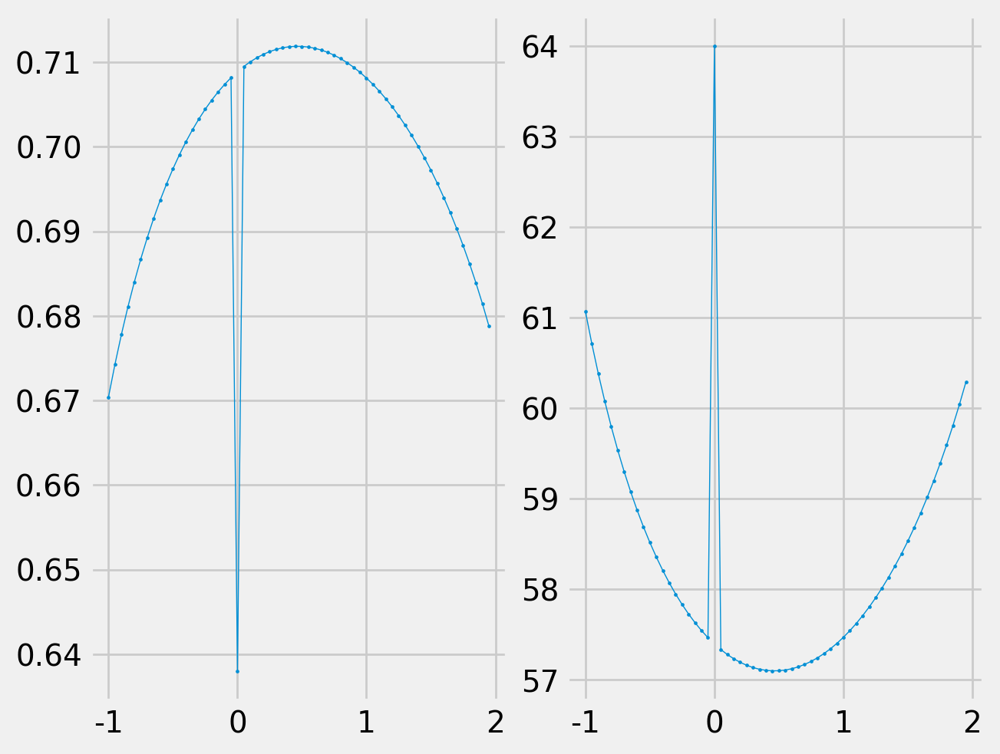

In [86]:
df_temp = df_whole[['init_lr','coeff','epoch']]

deg_list = [1,-0.3,-0.5,-1,-2]
deg_list = np.arange(-1,2,0.05)
reg_rslt=dict()

for deg in deg_list:
  X= df_whole['init_lr'].values.reshape(-1,1)
  y= np.power(df_whole['coeff'] * df_whole['epoch'], deg).values
  reg = LinearRegression(fit_intercept=True)
  reg.fit(X,y)
  a,b = reg.coef_,reg.intercept_
  estim = np.power(a*df_whole['init_lr']+b,1/deg)/df_whole['coeff']
  rslt = {
      'a':a,
      'b':b,
      'r2score':r2_score(df_whole['epoch'],estim),
      'rmse':root_mean_squared_error(df_whole['epoch'],estim),
  }
  reg_rslt[deg] = rslt

df_rslt = pd.DataFrame(reg_rslt)

fig,ax = plt.subplots(1,2)
ax[0].plot(deg_list,df_rslt.T['r2score'].values,lw=0.5,marker='o',ms=0.7)
ax[1].plot(deg_list,df_rslt.T['rmse'].values,lw=0.5,marker='o',ms=0.7)

ind = df_rslt.T['r2score'].argmax()
print(ind,deg_list[ind])
ind = df_rslt.T['rmse'].argmin()
print(ind,deg_list[ind])

In [87]:
init_lrs = sorted(df_whole.init_lr.unique())

temp = {
    lr : {
        'init_lr' : lr,
        'coeff' : df_whole.loc[df_whole['init_lr']==lr,'coeff'].mean(),
        'epoch' : df_whole.loc[df_whole['init_lr']==lr,'epoch'].mean(),
    }
    for lr in init_lrs
}

df_temp2 = pd.DataFrame(temp).T
display(df_temp2)

deg_list = [1,-0.3,-0.5,-1,-2]
deg_list = np.append(-1/np.arange(1,6),np.arange(1,3,0.5))
reg_rslt=dict()

for deg in deg_list:
  X= df_temp2['init_lr'].values.reshape(-1,1)
  y= np.power(df_temp2['coeff'] * df_temp2['epoch'], deg).values
  reg = LinearRegression(fit_intercept=True)
  reg.fit(X,y)
  a,b = reg.coef_,reg.intercept_
  estim = np.power(a*df_temp2['init_lr']+b,1/deg)/df_temp2['coeff']
  rslt = {
      'a':a,
      'b':b,
      'r2score':r2_score(df_temp2['epoch'],estim),
      'rmse':root_mean_squared_error(df_temp2['epoch'],estim),
  }
  reg_rslt[deg] = rslt

pd.DataFrame(reg_rslt)

,init_lr,coeff,epoch
0.000176,0.000176,296.405273,465.142857
0.000284,0.000284,296.405273,387.897436
0.000392,0.000392,296.405273,301.292683
0.000446,0.000446,296.405273,248.608696
0.000500,0.000500,296.405273,238.263158
0.000527,0.000527,296.405273,235.210526
0.000554,0.000554,296.405273,204.875000


,-1.000000,-0.500000,-0.333333,-0.250000,-0.200000,1.000000,1.500000,2.000000,2.500000
a,[0.023592153872606113],[3.5333077775021984],[15.797798227912658],[30.697606896758586],[43.483507773928764],[-202490520.7624325],[-94948387017.0751],[-39987134933967.25],[-1.5947297565334656e+16]
b,0.000003,0.002015,0.016371,0.046136,0.085657,171410.806614,66052361.071389,24898808454.381031,9261076706160.986328
r2score,0.952428,0.978573,0.982805,0.984376,0.985166,0.980096,0.965143,0.936669,0.872863
rmse,19.271623,12.933669,11.586079,11.044357,10.76145,12.465598,16.496346,22.235675,31.504766


In [88]:
init_lrs = sorted(df_whole.init_lr.unique())

temp = {
    lr : {
        'init_lr' : lr,
        'coeff' : df_whole.loc[df_whole['init_lr']==lr,'coeff'].median(),
        'epoch' : df_whole.loc[df_whole['init_lr']==lr,'epoch'].median(),
    }
    for lr in init_lrs
}

df_temp2 = pd.DataFrame(temp).T
display(df_temp2)

deg_list = [1,-0.3,-0.5,-1,-2]
deg_list = np.append(-1/np.arange(1,11),np.arange(1,3,0.5))
reg_rslt=dict()

for deg in deg_list:
  X= df_temp2['init_lr'].values.reshape(-1,1)
  y= np.power(df_temp2['coeff'] * df_temp2['epoch'], deg).values
  reg = LinearRegression(fit_intercept=True)
  reg.fit(X,y)
  a,b = reg.coef_,reg.intercept_
  estim = np.power(a*df_temp2['init_lr']+b,1/deg)/df_temp2['coeff']
  rslt = {
      'a':a,
      'b':b,
      'r2score':r2_score(df_temp2['epoch'],estim),
      'rmse':root_mean_squared_error(df_temp2['epoch'],estim),
  }
  reg_rslt[deg] = rslt

pd.DataFrame(reg_rslt)

,init_lr,coeff,epoch
0.000176,0.000176,296.405273,466.0
0.000284,0.000284,296.405273,379.0
0.000392,0.000392,296.405273,290.0
0.000446,0.000446,296.405273,243.0
0.000500,0.000500,296.405273,226.0
0.000527,0.000527,296.405273,218.0
0.000554,0.000554,296.405273,186.0


,-1.000000,-0.500000,-0.333333,-0.250000,-0.200000,-0.166667,-0.142857,-0.125000,-0.111111,-0.100000,1.000000,1.500000,2.000000,2.500000
a,[0.02722824000975886],[3.977762862169875],[17.648558448583227],[34.16587958163629],[48.28955492744992],[58.81452772984671],[66.11149126555743],[70.8921254532562],[73.81395566973893],[75.39431865294937],[-214937157.3464912],[-99329688774.72972],[-41324332840530.12],[-1.6315335682236352e+16]
b,0.000002,0.001917,0.015967,0.045388,0.084627,0.128022,0.171956,0.214474,0.25464,0.292092,173426.552152,66599445.511448,24992793810.221237,9255300152019.199219
r2score,0.933995,0.97794,0.984606,0.987081,0.988337,0.989088,0.989584,0.989935,0.990196,0.990397,0.98716,0.971849,0.93939,0.844416
rmse,24.009212,13.880095,11.594777,10.621921,10.092331,9.762152,9.537686,9.375637,9.253371,9.157956,10.589397,15.679623,23.007001,36.861293


In [89]:
init_lrs = sorted(df_whole.init_lr.unique())

temp = {
    lr : {
        'init_lr' : lr,
        'coeff' : df_whole.loc[df_whole['init_lr']==lr,'coeff'].median(),
        'epoch' : df_whole.loc[df_whole['init_lr']==lr,'epoch'].median(),
    }
    for lr in init_lrs
}

df_temp2 = pd.DataFrame(temp).T
display(df_temp2)

deg_list = [1,-0.3,-0.5,-1,-2]
deg_list = np.append(-1/np.arange(1,11),np.arange(1,3,0.5))
reg_rslt=dict()

for deg in deg_list:
  X= df_temp2['init_lr'].values.reshape(-1,1)
  y= np.power(df_temp2['coeff'] * df_temp2['epoch'], deg).values
  reg = LinearRegression(fit_intercept=True)
  reg.fit(X,y)
  a,b = reg.coef_,reg.intercept_
  estim = np.power(a*df_temp2['init_lr']+b,1/deg)/df_temp2['coeff']
  rslt = {
      'a':a,
      'b':b,
      'r2score':r2_score(df_temp2['epoch'],estim),
      'rmse':root_mean_squared_error(df_temp2['epoch'],estim),
  }
  reg_rslt[deg] = rslt

pd.DataFrame(reg_rslt)

,init_lr,coeff,epoch
0.000176,0.000176,296.405273,466.0
0.000284,0.000284,296.405273,379.0
0.000392,0.000392,296.405273,290.0
0.000446,0.000446,296.405273,243.0
0.000500,0.000500,296.405273,226.0
0.000527,0.000527,296.405273,218.0
0.000554,0.000554,296.405273,186.0


,-1.000000,-0.500000,-0.333333,-0.250000,-0.200000,-0.166667,-0.142857,-0.125000,-0.111111,-0.100000,1.000000,1.500000,2.000000,2.500000
a,[0.02722824000975886],[3.977762862169875],[17.648558448583227],[34.16587958163629],[48.28955492744992],[58.81452772984671],[66.11149126555743],[70.8921254532562],[73.81395566973893],[75.39431865294937],[-214937157.3464912],[-99329688774.72972],[-41324332840530.12],[-1.6315335682236352e+16]
b,0.000002,0.001917,0.015967,0.045388,0.084627,0.128022,0.171956,0.214474,0.25464,0.292092,173426.552152,66599445.511448,24992793810.221237,9255300152019.199219
r2score,0.933995,0.97794,0.984606,0.987081,0.988337,0.989088,0.989584,0.989935,0.990196,0.990397,0.98716,0.971849,0.93939,0.844416
rmse,24.009212,13.880095,11.594777,10.621921,10.092331,9.762152,9.537686,9.375637,9.253371,9.157956,10.589397,15.679623,23.007001,36.861293


27 0.3500000000000012
27 0.3500000000000012


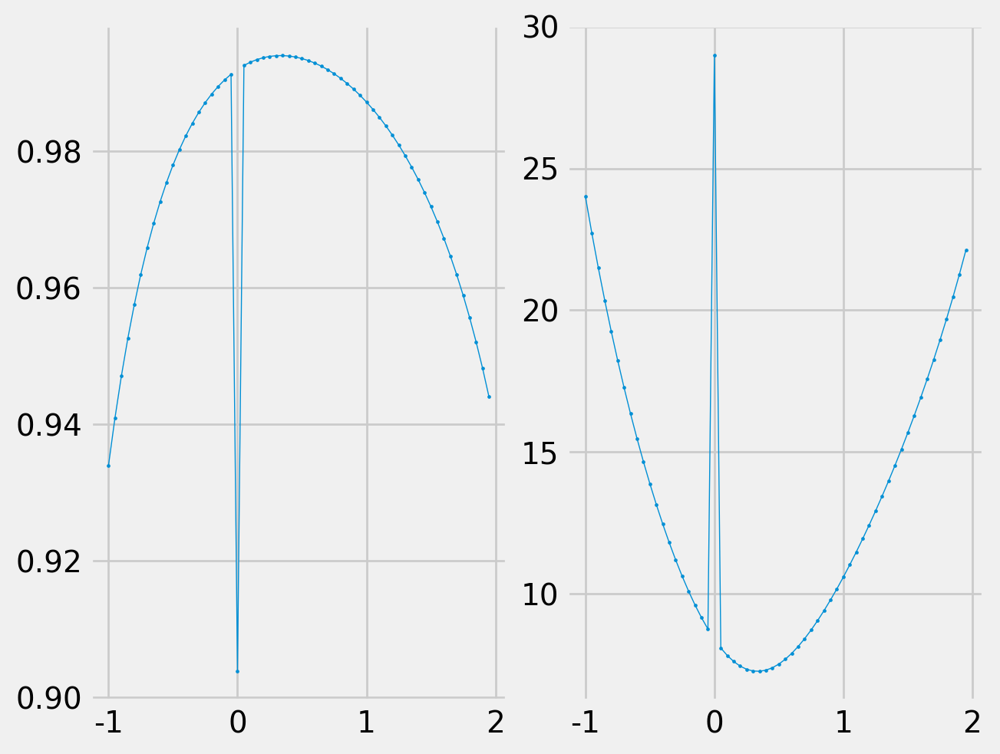

In [90]:
deg_list = np.arange(-1,2,0.05)
reg_rslt=dict()

for deg in deg_list:
  X= df_temp2['init_lr'].values.reshape(-1,1)
  y= np.power(df_temp2['coeff'] * df_temp2['epoch'], deg).values
  reg = LinearRegression(fit_intercept=True)
  reg.fit(X,y)
  a,b = reg.coef_,reg.intercept_
  estim = np.power(a*df_temp2['init_lr']+b,1/deg)/df_temp2['coeff']
  rslt = {
      'a':a,
      'b':b,
      'r2score':r2_score(df_temp2['epoch'],estim),
      'rmse':root_mean_squared_error(df_temp2['epoch'],estim),
  }
  reg_rslt[deg] = rslt

df_rslt = pd.DataFrame(reg_rslt)

fig,ax = plt.subplots(1,2)
ax[0].plot(deg_list,df_rslt.T['r2score'].values,lw=0.5,marker='o',ms=0.7)
ax[1].plot(deg_list,df_rslt.T['rmse'].values,lw=0.5,marker='o',ms=0.7)

ind = df_rslt.T['r2score'].argmax()
print(ind,deg_list[ind])
ind = df_rslt.T['rmse'].argmin()
print(ind,deg_list[ind])

In [91]:
lens = np.round(df_whole['init_lr'].value_counts()/10,0)*10
lens = lens.astype(int)

display(df_whole['init_lr'].value_counts())
display(lens)
lcm_len = np.lcm.reduce(lens)
print(lcm_len)
weights =lcm_len//lens
display(weights)

,count
init_lr,
0.000392,41
0.000284,39
0.000176,35
0.000554,24
0.000446,23
0.000500,19
0.000527,19


,count
init_lr,
0.000392,40
0.000284,40
0.000176,40
0.000554,20
0.000446,20
0.000500,20
0.000527,20


40


,count
init_lr,
0.000392,1
0.000284,1
0.000176,1
0.000554,2
0.000446,2
0.000500,2
0.000527,2


In [92]:
temp = []
for lr in weights.index:
  if lr < 2e-4 : continue
  cond = df_whole['init_lr'] == lr
  temp.extend([df_whole[cond] for _ in range(weights[lr])])

df_mod = pd.concat(temp)
len(df_mod)

250

21 0.05000000000000093
21 0.05000000000000093
30 0.5000000000000013


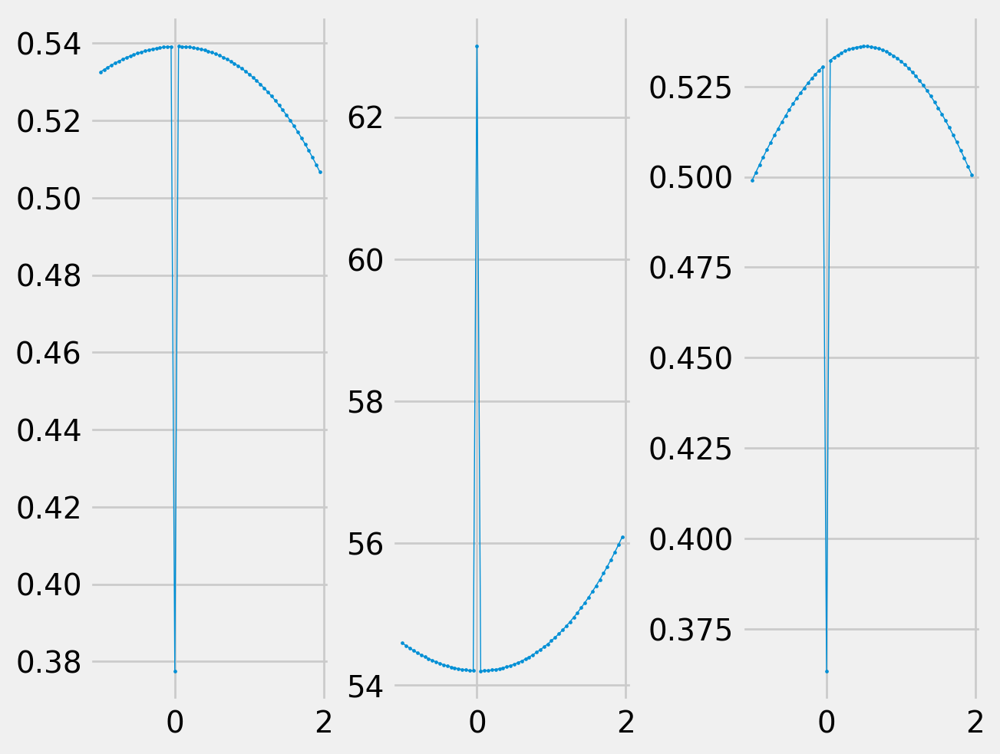

In [93]:

df_temp = df_mod[['init_lr','coeff','epoch']]

#deg_list = [1,-0.3,-0.5,-1,-]
deg_list = np.arange(-1,2,0.05)
reg_rslt=dict()

for deg in deg_list:
  X= df_mod['init_lr'].values.reshape(-1,1)
  y= np.power(df_mod['coeff'] * df_mod['epoch'], deg).values
  reg = LinearRegression(fit_intercept=True)
  reg.fit(X,y)
  a,b = reg.coef_,reg.intercept_
  estim = np.power(a*df_mod['init_lr']+b,1/deg)/df_mod['coeff']
  rslt = {
      'a':a,
      'b':b,
      'r2score1':r2_score(df_mod['epoch'],estim),
      'r2score2':r2_score(y,a*X+b),
      'rmse':root_mean_squared_error(df_mod['epoch'],estim),
  }
  reg_rslt[deg] = rslt

df_rslt = pd.DataFrame(reg_rslt)

fig,ax = plt.subplots(1,3)
ax[0].plot(deg_list,df_rslt.T['r2score1'].values,lw=0.5,marker='o',ms=0.7)
ax[1].plot(deg_list,df_rslt.T['rmse'].values,lw=0.5,marker='o',ms=0.7)
ax[2].plot(deg_list,df_rslt.T['r2score2'].values,lw=0.5,marker='o',ms=0.7)

ind = df_rslt.T['r2score1'].argmax()
print(ind,deg_list[ind])
ind = df_rslt.T['rmse'].argmin()
print(ind,deg_list[ind])
ind = df_rslt.T['r2score2'].argmax()
print(ind,deg_list[ind])

In [94]:
from mpl_toolkits.axes_grid1.inset_locator import inset_axes, mark_inset
import matplotlib.patches as mpatches
from mpl_toolkits.axes_grid1.inset_locator import (inset_axes, TransformedBbox,BboxPatch, BboxConnector)

def my_mark_inset(parent_axes, inset_axes, loc1a=1, loc1b=1, loc2a=2, loc2b=2,boxlw=0.5,connectlw=0.5, **kwargs):
    rect = TransformedBbox(inset_axes.viewLim, parent_axes.transData)
    pp = BboxPatch(rect, fill=False,lw=boxlw, **kwargs)
    parent_axes.add_patch(pp)
    p1 = BboxConnector(inset_axes.bbox, rect, loc1=loc1a, loc2=loc1b,lw=connectlw, **kwargs)
    inset_axes.add_patch(p1)
    p1.set_clip_on(False)
    p2 = BboxConnector(inset_axes.bbox, rect, loc1=loc2a, loc2=loc2b,lw=connectlw, **kwargs)
    inset_axes.add_patch(p2)
    p2.set_clip_on(False)
    return pp, p1, p2

In [95]:
!pip install latex
!sudo apt install cm-super dvipng texlive-latex-extra texlive-latex-recommended

  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
  Created wheel for latex: filename=latex-0.7.0-py3-none-any.whl size=7588 sha256=5ed3a3c6b390d273914bc828c9209dcbfc3e1f183300b3458ec061f8c01e4125
  Stored in directory: /root/.cache/pip/wheels/e5/b3/95/f4b45b5116d4585893cdcb2ac7c07614a59fb047c754c4651a
  Created wheel for data: filename=data-0.4-py3-none-any.whl size=7227 sha256=110bc51eb2ccc44ff72fdd4bec0fd56cafae76ec0f8970dd642ac5fa21418bfd
  Stored in directory: /root/.cache/pip/wheels/d2/d3/10/d5fe9bc9dcb197ea289baccca92a25f2f95135235a92ca1b11
  Created wheel for shutilwhich: filename=shutilwhich-1.1.0-py3-none-any.whl size=2766 sha256=fe1723824fccad1ceda1cf7eb57f9d3818d6cecb1158796d248ed4004bc4a204
  Stored in directory: /root/.cache/pip/wheels/6a/49/7a/3997889a5643ddb4a1d21692c6916fd2fc482965211d9a3ca5
  Created wheel for tempdir: filename=tempdir-0.7.1-py3-none-any.w

In [96]:
from matplotlib import rcParams
rcParams['text.usetex'] = True

302 0.02999999999993541
302 0.02999999999993541
351 0.519999999999925


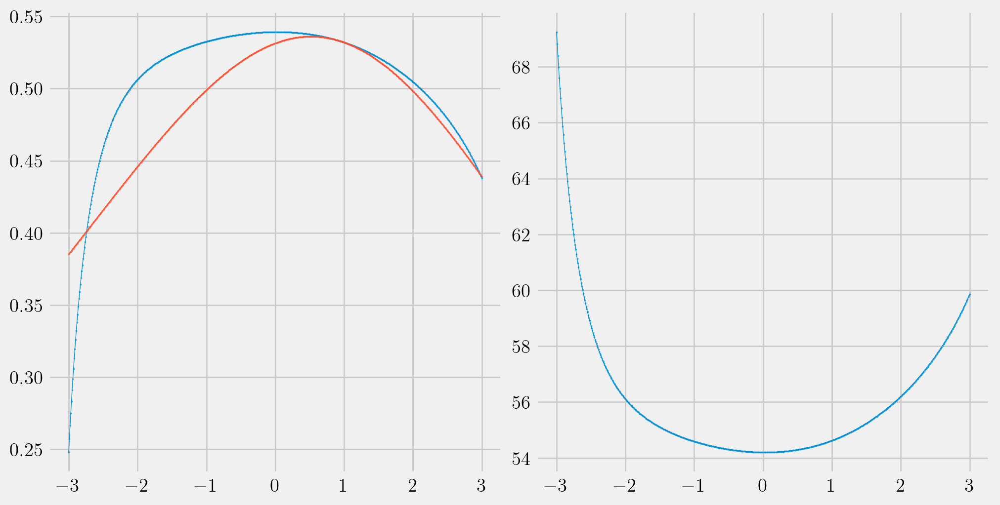

In [97]:
from sklearn.linear_model import TheilSenRegressor, LinearRegression

df_temp = df_mod[['init_lr','coeff','epoch']]

#deg_list = [1,-0.3,-0.5,-1,-]
deg_list = np.arange(-3,3.01,0.01)
reg_rslt=dict()

deg_list = deg_list[np.abs(deg_list) > 0.008]

X = df_mod['init_lr'].values.reshape(-1,1)
for deg in deg_list:
  y= np.power(df_mod['epoch'], deg).values
  reg = LinearRegression(fit_intercept=True)
  reg.fit(X,y)
  a,b = reg.coef_,reg.intercept_
  estim = np.power(a*df_mod['init_lr']+b,1/deg)
  rslt = {
      'a':a,
      'b':b,
      'r2score1':r2_score(df_mod['epoch'],estim),
      'r2score2':r2_score(y,a*X+b),
      'rmse':root_mean_squared_error(df_mod['epoch'],estim),
  }
  reg_rslt[deg] = rslt

df_rslt1 = pd.DataFrame(reg_rslt)

fig,ax = plt.subplots(1,2,figsize=(10,5))
ax[0].plot(deg_list,df_rslt1.T['r2score1'].values,lw=0.5,marker='o',ms=0.3)
ax[0].plot(deg_list,df_rslt1.T['r2score2'].values,lw=0.5,marker='o',ms=0.3)
ax[1].plot(deg_list,df_rslt1.T['rmse'].values,lw=0.5,marker='o',ms=0.3)

ind = df_rslt1.T['r2score1'].argmax()
print(ind,deg_list[ind])
ind = df_rslt1.T['rmse'].argmin()
print(ind,deg_list[ind])
ind = df_rslt1.T['r2score2'].argmax()
print(ind,deg_list[ind])

In [98]:
ind1 = df_rslt1.T['r2score1'].argmax()
ind2 = df_rslt1.T['r2score2'].argmax()

display(df_rslt1.T.iloc[ind1])
display(df_rslt1.T.iloc[ind2])

,0.03
a,[-80.29371049618584]
b,1.21746
r2score1,0.539214
r2score2,0.531914
rmse,54.202452


,0.52
a,[-22024.303988223353]
b,28.062768
r2score1,0.537477
r2score2,0.536105
rmse,54.304509


Text(0.0, 1.0, '(b)')

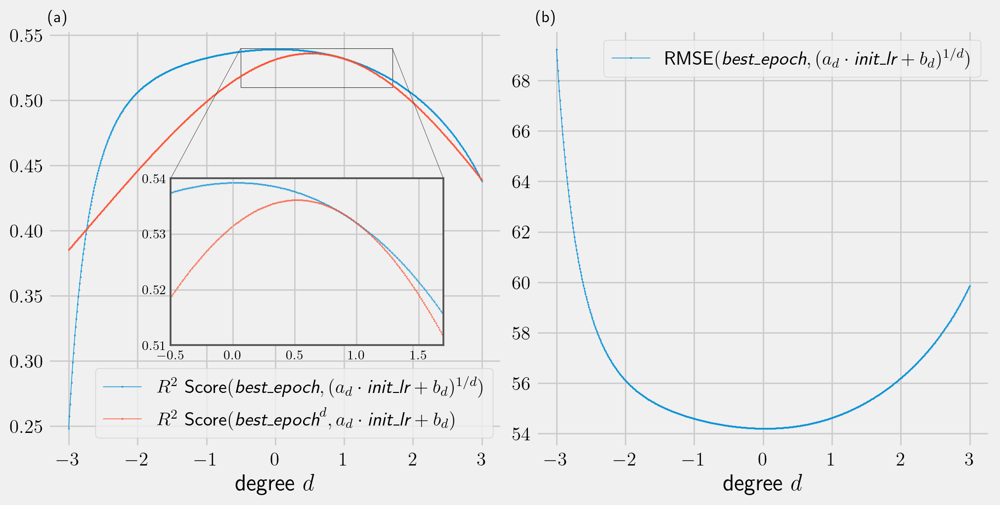

In [99]:
fig,ax = plt.subplots(1,2,figsize=(10,5))
text1 = r'$R^2$ Score$(\textit{best_epoch},(a_d \cdot \textit{init_lr} + b_d)^{1/d})$'
text2 = r'$R^2$ Score$(\textit{best_epoch}^d,a_d \cdot \textit{init_lr} + b_d)$'
text3 = r'RMSE$(\textit{best_epoch},(a_d \cdot \textit{init_lr} + b_d)^{1/d})$'

ax[0].plot(deg_list,df_rslt1.T['r2score1'].values,lw=0.5,marker='o',ms=0.3,label=text1)
ax[0].plot(deg_list,df_rslt1.T['r2score2'].values,lw=0.5,marker='o',ms=0.3,label=text2)
ax[1].plot(deg_list,df_rslt1.T['rmse'].values,lw=0.5,marker='o',ms=0.3,label=text3)

axins = inset_axes(ax[0], "100%", "100%", bbox_to_anchor=[0.27, .245, .6, .4],
                   bbox_transform=ax[0].transAxes, borderpad=0)

axins.plot(deg_list,df_rslt1.T['r2score1'].values,lw=0.2,marker='o',ms=0.25)
axins.plot(deg_list,df_rslt1.T['r2score2'].values,lw=0.2,marker='o',ms=0.25)
xlims = (-0.5,1.7)
ylims = (0.51,0.54)
axins.set(xlim=xlims, ylim=ylims)

my_mark_inset(ax[0],axins,loc1a=2,loc1b=2,loc2a=1,loc2b=1,fc="none",ec="0.2",boxlw=0.4,connectlw=0.3)

for axis in ['top','bottom','left','right']:
    axins.spines[axis].set_visible(True)
    axins.spines[axis].set_linewidth(1.3)
    axins.spines[axis].set_color('#525252')

axins.tick_params(axis='both', which='major', labelsize=9.5)
#axins.tick_params(width=0.5)


ax[0].legend()
ax[1].legend()
ax[0].set_xlabel(r'degree $d$')
ax[1].set_xlabel(r'degree $d$')

ax[0].set_title('(a)',loc='left',fontsize=12)
ax[1].set_title('(b)',loc='left',fontsize=12)

302 0.02999999999993541
302 0.02999999999993541
351 0.519999999999925


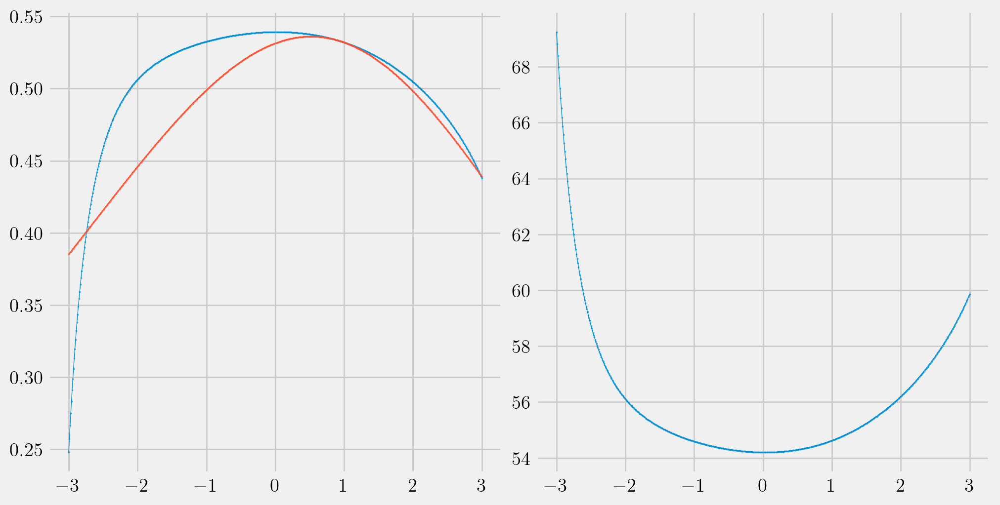

In [100]:
from sklearn.linear_model import TheilSenRegressor, LinearRegression

init_lrs = sorted(df_whole.init_lr.unique())
init_lrs = init_lrs[1:]
cond = df_mod['init_lr'].isin(init_lrs)

df_temp = df_mod.loc[cond,['init_lr','coeff','epoch']]

#deg_list = [1,-0.3,-0.5,-1,-]
deg_list = np.arange(-3,3.01,0.01)
reg_rslt=dict()

deg_list = deg_list[np.abs(deg_list) > 0.008]

X = df_temp['init_lr'].values.reshape(-1,1)
for deg in deg_list:
  y= np.power(df_temp['coeff'] * df_temp['epoch'], deg).values
  reg = LinearRegression(fit_intercept=True)
  reg.fit(X,y)
  a,b = reg.coef_,reg.intercept_
  estim = np.power(a*df_temp['init_lr']+b,1/deg)/df_temp['coeff']
  rslt = {
      'a':a,
      'b':b,
      'r2score1':r2_score(df_temp['epoch'],estim),
      'r2score2':r2_score(y,a*X+b),
      'rmse':root_mean_squared_error(df_temp['epoch'],estim),
  }
  reg_rslt[deg] = rslt

df_rslt2 = pd.DataFrame(reg_rslt)

fig,ax = plt.subplots(1,2,figsize=(10,5))
ax[0].plot(deg_list,df_rslt2.T['r2score1'].values,lw=0.5,marker='o',ms=0.3)
ax[0].plot(deg_list,df_rslt2.T['r2score2'].values,lw=0.5,marker='o',ms=0.3)
ax[1].plot(deg_list,df_rslt2.T['rmse'].values,lw=0.5,marker='o',ms=0.3)

ind = df_rslt2.T['r2score1'].argmax()
print(ind,deg_list[ind])
ind = df_rslt2.T['rmse'].argmin()
print(ind,deg_list[ind])
ind = df_rslt2.T['r2score2'].argmax()
print(ind,deg_list[ind])

In [101]:
init_lrs

[0.000284, 0.000392, 0.000446, 0.0005, 0.000527, 0.000554]

In [102]:
ind1 = df_rslt2.T['r2score1'].argmax()
ind2 = df_rslt2.T['r2score2'].argmax()

display(df_rslt2.T.iloc[ind1])
display(df_rslt2.T.iloc[ind2])

,0.03
a,[-95.24410509762615]
b,1.444146
r2score1,0.539214
r2score2,0.531914
rmse,54.202452


,0.52
a,[-424896.22663062887]
b,541.391186
r2score1,0.537477
r2score2,0.536105
rmse,54.304509


ValueError: x and y must have same first dimension, but have shapes (600,) and (60,)

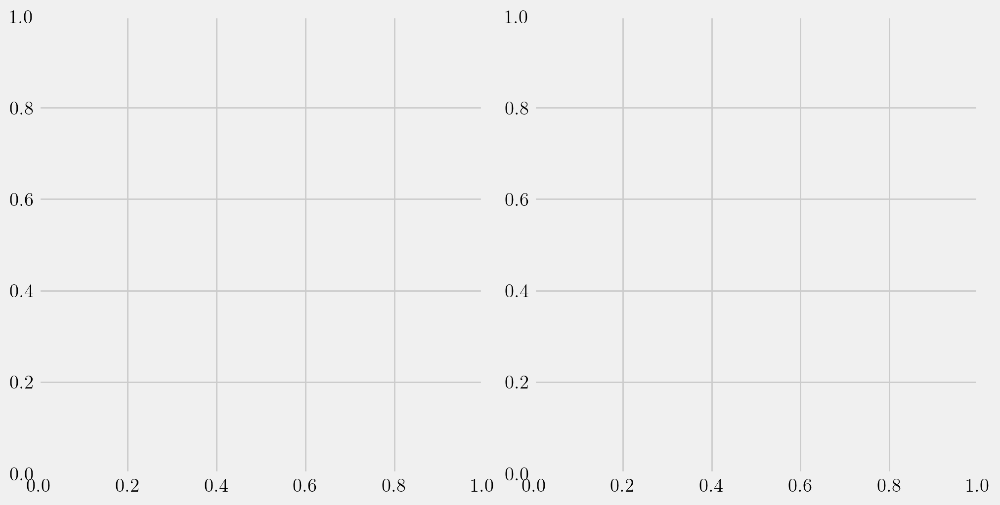

In [103]:
fig,ax = plt.subplots(1,2,figsize=(10,5))
text1 = r'$R^2$ Score$(\textit{best_epoch},(a_d \cdot \textit{init_lr} + b_d)^{1/d})$'
text2 = r'$R^2$ Score$(\textit{best_epoch}^d,a_d \cdot \textit{init_lr} + b_d)$'
text3 = r'RMSE$(\textit{best_epoch},(a_d \cdot \textit{init_lr} + b_d)^{1/d})$'

ax[0].plot(deg_list,df_rslt.T['r2score1'].values,lw=0.5,marker='o',ms=0.3,label=text1)
ax[0].plot(deg_list,df_rslt.T['r2score2'].values,lw=0.5,marker='o',ms=0.3,label=text2)
ax[1].plot(deg_list,df_rslt.T['rmse'].values,lw=0.5,marker='o',ms=0.3,label=text3)

axins = inset_axes(ax[0], "100%", "100%", bbox_to_anchor=[0.27, .245, .6, .4],
                   bbox_transform=ax[0].transAxes, borderpad=0)

axins.plot(deg_list,df_rslt.T['r2score1'].values,lw=0.2,marker='o',ms=0.25)
axins.plot(deg_list,df_rslt.T['r2score2'].values,lw=0.2,marker='o',ms=0.25)
xlims = (-0.5,1.7)
ylims = (0.51,0.54)
axins.set(xlim=xlims, ylim=ylims)

my_mark_inset(ax[0],axins,loc1a=2,loc1b=2,loc2a=1,loc2b=1,fc="none",ec="0.2",boxlw=0.4,connectlw=0.3)

for axis in ['top','bottom','left','right']:
    axins.spines[axis].set_visible(True)
    axins.spines[axis].set_linewidth(1.3)
    axins.spines[axis].set_color('#525252')

axins.tick_params(axis='both', which='major', labelsize=9.5)
#axins.tick_params(width=0.5)


ax[0].legend()
ax[1].legend()
ax[0].set_xlabel(r'degree $d$')
ax[1].set_xlabel(r'degree $d$')

ax[0].set_title('(a)',loc='left',fontsize=12)
ax[1].set_title('(b)',loc='left',fontsize=12)

In [104]:
def estim_reg_d_model(deg,feats,X):
  a, b = feats['a'],feats['b']
  estim = np.power(a*X+b,1/deg)
  return estim

def eval_reg_d_model(deg,feats,X,y):
  y_pred = estim_reg_d_model(deg,feats,X)
  return r2_score(y,y_pred), rmse(y,y_pred)

In [105]:
init_lrs

[0.000284, 0.000392, 0.000446, 0.0005, 0.000527, 0.000554]

282 -0.1800000000000601
282 -0.1800000000000601
329 0.29999999999992966


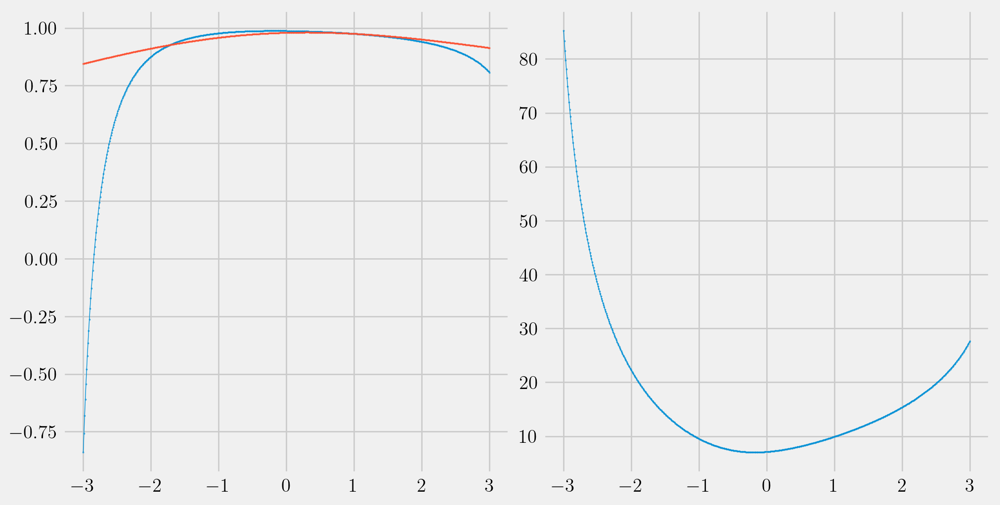

In [106]:
from sklearn.linear_model import TheilSenRegressor, LinearRegression
init_lrs_whole = sorted(df_whole.init_lr.unique())
init_lrs = init_lrs_whole[1:]

temp = {
    lr : {
        'init_lr' : lr,
        'coeff' : df_mod.loc[df_mod['init_lr']==lr,'coeff'].median(),
        'epoch' : df_mod.loc[df_mod['init_lr']==lr,'epoch'].median(),
    }
    for lr in init_lrs
}

df_temp2 = pd.DataFrame(temp).T
#display(df_temp2)

deg_list = np.arange(-3,3.01,0.01)
deg_list = deg_list[np.abs(deg_list)>0.008]

reg_rslt=dict()

for deg in deg_list:
  X= df_temp2['init_lr'].values.reshape(-1,1)
  y= np.power(df_temp2['epoch'], deg).values
  #reg = TheilSenRegressor(random_state=12,fit_intercept=True)
  reg = LinearRegression(fit_intercept=True)
  reg.fit(X,y)
  a,b = reg.coef_,reg.intercept_
  estim = np.power(a*df_temp2['init_lr']+b,1/deg)
  rslt = {
      'a':a,
      'b':b,
      'r2score1':r2_score(df_temp2['epoch'],estim),
      'rmse':root_mean_squared_error(df_temp2['epoch'],estim),
      'r2score2':r2_score(y,a*X+b),
  }
  reg_rslt[deg] = rslt

df_rslt_med = pd.DataFrame(reg_rslt)

fig,ax = plt.subplots(1,2,figsize=(10,5))
ax[0].plot(deg_list,df_rslt_med.T['r2score1'].values,lw=0.5,marker='o',ms=0.3)
ax[0].plot(deg_list,df_rslt_med.T['r2score2'].values,lw=0.5,marker='o',ms=0.3)
ax[1].plot(deg_list,df_rslt_med.T['rmse'].values,lw=0.5,marker='o',ms=0.3)

ind = df_rslt_med.T['r2score1'].argmax()
print(ind,deg_list[ind])
ind = df_rslt_med.T['rmse'].argmin()
print(ind,deg_list[ind])
ind = df_rslt_med.T['r2score2'].argmax()
print(ind,deg_list[ind])

In [107]:
ind1 = df_rslt_med.T['r2score1'].argmax()
ind2 = df_rslt_med.T['r2score2'].argmax()

display(df_rslt_med.T.iloc[ind1])
display(df_rslt_med.T.iloc[ind2])

ind3= (np.abs(deg_list-0.03)).argmin()
case_reg =df_rslt_med.T.iloc[ind3]

estim_reg_d_model(case_reg.name,case_reg,init_lrs_whole)

,-0.18
a,[162.3451103897291]
b,0.297289
r2score1,0.987536
rmse,7.015384
r2score2,0.977772


,0.3
a,[-3979.4350740078976]
b,7.046468
r2score1,0.985337
rmse,7.609094
r2score2,0.980823


array([490.40163114, 376.99245142, 289.20449757, 253.10228396,
       221.38821924, 207.01219297, 193.54345757])

In [108]:
desc_dist(df_whole,'init_lr','epoch')

,count,mean,std,min,q1,median,q3,max
0.000176,35.0,465.142857,55.800139,355.0,423.50,466.0,515.5,550.0
0.000284,39.0,387.897436,69.559060,234.0,338.00,379.0,435.5,550.0
0.000392,41.0,301.292683,64.963930,210.0,251.00,290.0,341.0,491.0
0.000446,23.0,248.608696,38.617870,194.0,213.50,243.0,284.5,326.0
0.000500,19.0,238.263158,36.169112,181.0,215.00,226.0,258.0,317.0
0.000527,19.0,235.210526,60.807144,167.0,196.00,218.0,252.0,407.0
0.000554,24.0,204.875000,48.144089,149.0,172.75,186.0,245.5,320.0


282 -0.1800000000000601
282 -0.1800000000000601
329 0.29999999999992966


Text(0.0, 1.0, '(b)')

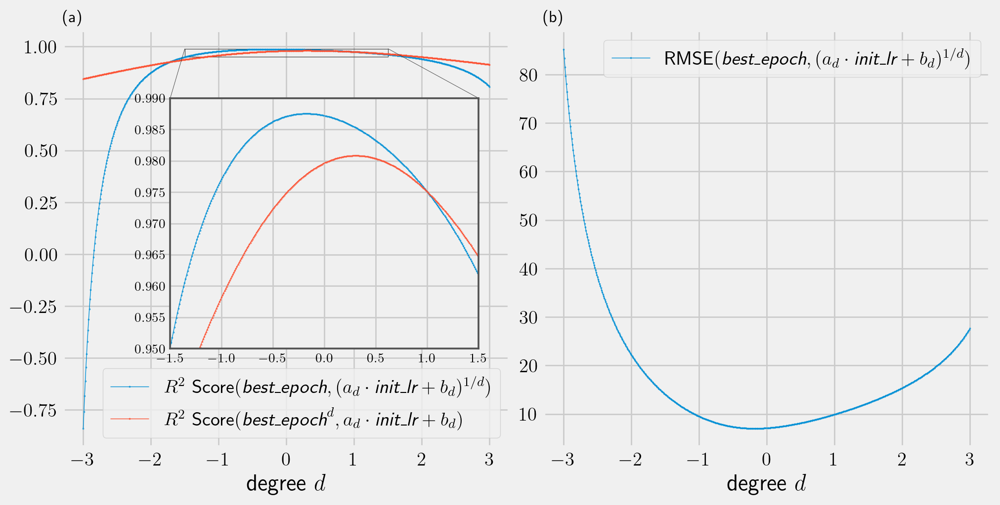

In [109]:
fig,ax = plt.subplots(1,2,figsize=(10,5))
text1 = r'$R^2$ Score$(\textit{best_epoch},(a_d \cdot \textit{init_lr} + b_d)^{1/d})$'
text2 = r'$R^2$ Score$(\textit{best_epoch}^d,a_d \cdot \textit{init_lr} + b_d)$'
text3 = r'RMSE$(\textit{best_epoch},(a_d \cdot \textit{init_lr} + b_d)^{1/d})$'

ax[0].plot(deg_list,df_rslt_med.T['r2score1'].values,lw=0.5,marker='o',ms=0.3,label=text1)
ax[0].plot(deg_list,df_rslt_med.T['r2score2'].values,lw=0.5,marker='o',ms=0.3,label=text2)
ax[1].plot(deg_list,df_rslt_med.T['rmse'].values,lw=0.5,marker='o',ms=0.3,label=text3)

ind = df_rslt_med.T['r2score1'].argmax()
print(ind,deg_list[ind])
ind = df_rslt_med.T['rmse'].argmin()
print(ind,deg_list[ind])
ind = df_rslt_med.T['r2score2'].argmax()
print(ind,deg_list[ind])

axins = inset_axes(ax[0], "100%", "100%", bbox_to_anchor=[0.24, .237, .69, .6],
                   bbox_transform=ax[0].transAxes, borderpad=0)

axins.plot(deg_list,df_rslt_med.T['r2score1'].values,lw=0.5,marker='o',ms=0.3)
axins.plot(deg_list,df_rslt_med.T['r2score2'].values,lw=0.5,marker='o',ms=0.3)
xlims = (-1.5,1.5)
ylims = (0.95,0.99)
axins.set(xlim=xlims, ylim=ylims)

my_mark_inset(ax[0],axins,loc1a=2,loc1b=2,loc2a=1,loc2b=1,fc="none",ec="0.2",boxlw=0.4,connectlw=0.3)

for axis in ['top','bottom','left','right']:
    axins.spines[axis].set_visible(True)
    axins.spines[axis].set_linewidth(1.3)
    axins.spines[axis].set_color('#525252')

axins.tick_params(axis='both', which='major', labelsize=9.5)
#axins.tick_params(width=0.5)


ax[0].legend()
ax[1].legend()
ax[0].set_xlabel(r'degree $d$')
ax[1].set_xlabel(r'degree $d$')

ax[0].set_title('(a)',loc='left',fontsize=12)
ax[1].set_title('(b)',loc='left',fontsize=12)

222 -0.7800000000000473
222 -0.7800000000000473
290 -0.10000000000006182


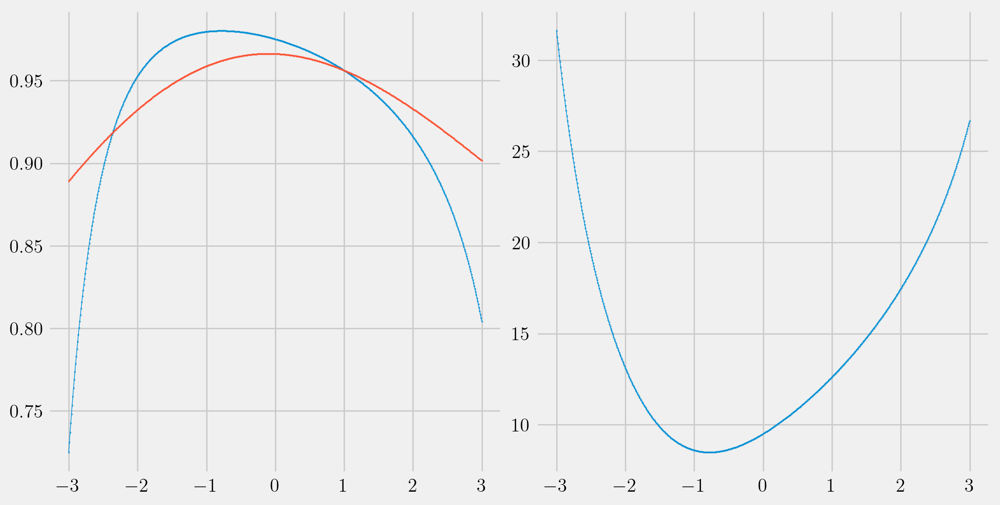

In [110]:
from sklearn.linear_model import TheilSenRegressor, LinearRegression
init_lrs = sorted(df_whole.init_lr.unique())
init_lrs = init_lrs[1:]

temp = {
    lr : {
        'init_lr' : lr,
        'coeff' : df_mod.loc[df_mod['init_lr']==lr,'coeff'].mean(),
        'epoch' : df_mod.loc[df_mod['init_lr']==lr,'epoch'].mean(),
    }
    for lr in init_lrs
}

df_temp2 = pd.DataFrame(temp).T
#display(df_temp2)

deg_list = np.arange(-3,3.01,0.01)
deg_list = deg_list[np.abs(deg_list)>0.008]

reg_rslt=dict()

for deg in deg_list:
  X= df_temp2['init_lr'].values.reshape(-1,1)
  y= np.power(df_temp2['epoch'], deg).values
  #reg = TheilSenRegressor(random_state=12,fit_intercept=True)
  reg = LinearRegression(fit_intercept=True)
  reg.fit(X,y)
  a,b = reg.coef_,reg.intercept_
  estim = np.power(a*df_temp2['init_lr']+b,1/deg)
  rslt = {
      'a':a,
      'b':b,
      'r2score1':r2_score(df_temp2['epoch'],estim),
      'rmse':root_mean_squared_error(df_temp2['epoch'],estim),
      'r2score2':r2_score(y,a*X+b),
  }
  reg_rslt[deg] = rslt

df_rslt_mean = pd.DataFrame(reg_rslt)

fig,ax = plt.subplots(1,2,figsize=(10,5))
ax[0].plot(deg_list,df_rslt_mean.T['r2score1'].values,lw=0.5,marker='o',ms=0.3)
ax[0].plot(deg_list,df_rslt_mean.T['r2score2'].values,lw=0.5,marker='o',ms=0.3)
ax[1].plot(deg_list,df_rslt_mean.T['rmse'].values,lw=0.5,marker='o',ms=0.3)

ind = df_rslt_mean.T['r2score1'].argmax()
print(ind,deg_list[ind])
ind = df_rslt_mean.T['rmse'].argmin()
print(ind,deg_list[ind])
ind = df_rslt_mean.T['r2score2'].argmax()
print(ind,deg_list[ind])

In [111]:
ind1 = df_rslt_mean.T['r2score1'].argmax()
ind2 = df_rslt_mean.T['r2score2'].argmax()

display(df_rslt_mean.T.iloc[ind1])
display(df_rslt_mean.T.iloc[ind2])

,-0.78
a,[21.27481958616206]
b,0.00352
r2score1,0.980196
rmse,8.481235
r2score2,0.962064


,-0.1
a,[126.45884859040908]
b,0.515878
r2score1,0.976314
rmse,9.275378
r2score2,0.966349


222 -0.7800000000000473
222 -0.7800000000000473
290 -0.10000000000006182


Text(0.0, 1.0, '(b)')

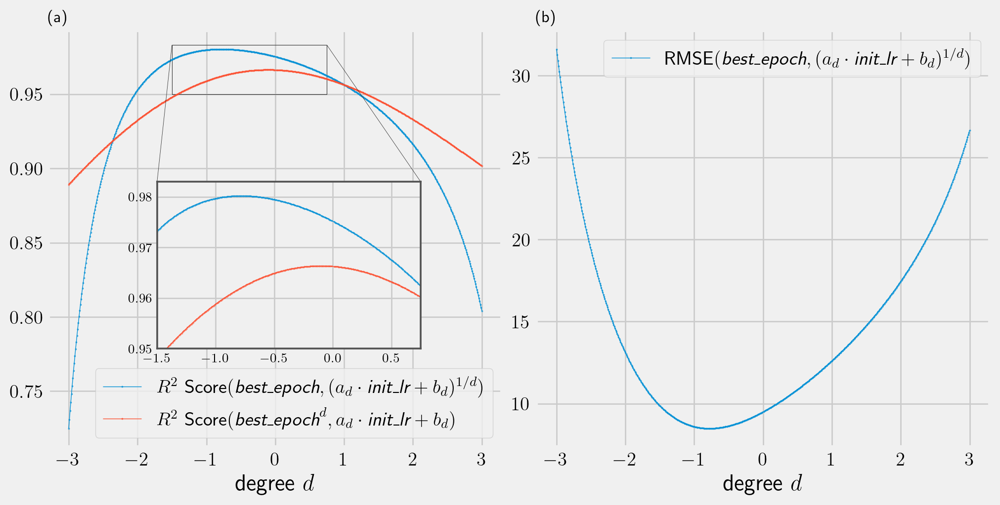

In [112]:
fig,ax = plt.subplots(1,2,figsize=(10,5))
text1 = r'$R^2$ Score$(\textit{best_epoch},(a_d \cdot \textit{init_lr} + b_d)^{1/d})$'
text2 = r'$R^2$ Score$(\textit{best_epoch}^d,a_d \cdot \textit{init_lr} + b_d)$'
text3 = r'RMSE$(\textit{best_epoch},(a_d \cdot \textit{init_lr} + b_d)^{1/d})$'

ax[0].plot(deg_list,df_rslt_mean.T['r2score1'].values,lw=0.5,marker='o',ms=0.3,label=text1)
ax[0].plot(deg_list,df_rslt_mean.T['r2score2'].values,lw=0.5,marker='o',ms=0.3,label=text2)
ax[1].plot(deg_list,df_rslt_mean.T['rmse'].values,lw=0.5,marker='o',ms=0.3,label=text3)

ind = df_rslt_mean.T['r2score1'].argmax()
print(ind,deg_list[ind])
ind = df_rslt_mean.T['rmse'].argmin()
print(ind,deg_list[ind])
ind = df_rslt_mean.T['r2score2'].argmax()
print(ind,deg_list[ind])

axins = inset_axes(ax[0], "100%", "100%", bbox_to_anchor=[0.24, .237, .58, .4],
                   bbox_transform=ax[0].transAxes, borderpad=0)

axins.plot(deg_list,df_rslt_mean.T['r2score1'].values,lw=0.5,marker='o',ms=0.3)
axins.plot(deg_list,df_rslt_mean.T['r2score2'].values,lw=0.5,marker='o',ms=0.3)
xlims = (-1.5,0.75)
ylims = (0.95,0.983)
axins.set(xlim=xlims, ylim=ylims)

my_mark_inset(ax[0],axins,loc1a=2,loc1b=2,loc2a=1,loc2b=1,fc="none",ec="0.2",boxlw=0.4,connectlw=0.3)

for axis in ['top','bottom','left','right']:
    axins.spines[axis].set_visible(True)
    axins.spines[axis].set_linewidth(1.3)
    axins.spines[axis].set_color('#525252')

axins.tick_params(axis='both', which='major', labelsize=9.5)
#axins.tick_params(width=0.5)


ax[0].legend()
ax[1].legend()
ax[0].set_xlabel(r'degree $d$')
ax[1].set_xlabel(r'degree $d$')

ax[0].set_title('(a)',loc='left',fontsize=12)
ax[1].set_title('(b)',loc='left',fontsize=12)

In [113]:
deg = 0.03
i = np.argmin(np.abs(deg_list - deg))
key = deg_list[i]

a = reg_rslt[key]['a']
b = reg_rslt[key]['b']

In [114]:
display(df_rslt1.info())
display(df_rslt_med.info())
display(df_rslt_mean.info())

<class 'pandas.core.frame.DataFrame'>
Index: 5 entries, a to rmse
Columns: 600 entries, -3.0 to 2.999999999999872
dtypes: object(600)
memory usage: 23.6+ KB


None

<class 'pandas.core.frame.DataFrame'>
Index: 5 entries, a to r2score2
Columns: 600 entries, -3.0 to 2.999999999999872
dtypes: object(600)
memory usage: 23.6+ KB


None

<class 'pandas.core.frame.DataFrame'>
Index: 5 entries, a to r2score2
Columns: 600 entries, -3.0 to 2.999999999999872
dtypes: object(600)
memory usage: 23.6+ KB


None

In [115]:
df_rslt1.T.info()

<class 'pandas.core.frame.DataFrame'>
Index: 600 entries, -3.0 to 2.999999999999872
Data columns (total 5 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   a         600 non-null    object
 1   b         600 non-null    object
 2   r2score1  600 non-null    object
 3   r2score2  600 non-null    object
 4   rmse      600 non-null    object
dtypes: object(5)
memory usage: 44.3+ KB


In [116]:
ind3= (np.abs(deg_list-0.03)).argmin()
case_reg =df_rslt_med.T.iloc[ind3]

display(case_reg)
estim_reg_d_model(case_reg.name,case_reg,init_lrs_whole)

,0.03
a,[-87.6308235841702]
b,1.219673
r2score1,0.9871
rmse,7.137032
r2score2,0.979854


array([490.40163114, 376.99245142, 289.20449757, 253.10228396,
       221.38821924, 207.01219297, 193.54345757])

In [117]:
df_desc = desc_dist(df_whole,'init_lr','epoch')
display(df_desc['median'])
display(df_desc['mean'])

,median
0.000176,466.0
0.000284,379.0
0.000392,290.0
0.000446,243.0
0.000500,226.0
0.000527,218.0
0.000554,186.0


,mean
0.000176,465.142857
0.000284,387.897436
0.000392,301.292683
0.000446,248.608696
0.000500,238.263158
0.000527,235.210526
0.000554,204.875000


In [118]:
def find_reg_d_info(deg,df_reg_rslt):
  degs = df_reg_rslt.columns.values
  idx= (np.abs(degs-deg)).argmin()
  case_reg =df_reg_rslt.T.iloc[idx]
  return case_reg

def make_reg_d_func(deg,feats):
  a, b = feats['a'],feats['b']
  return lambda x: np.power(a*x+b,1/deg)

def find_reg_d_func(deg,df_reg_rslt):
  case_reg = find_reg_d_info(deg,df_reg_rslt)
  return make_reg_d_func(case_reg.name,case_reg),case_reg.name

In [119]:
case_reg =find_reg_d_info(-0.1,df_rslt_mean)

display(case_reg)
estim_reg_d_model(case_reg.name,case_reg,init_lrs_whole)

,-0.1
a,[126.45884859040908]
b,0.515878
r2score1,0.976314
rmse,9.275378
r2score2,0.966349


array([491.01315133, 382.16156788, 299.26939898, 265.41650932,
       235.72843857, 222.27026165, 209.65245421])

0.7023858071193054 58.03312326975203


NameError: name 'x_epochr' is not defined

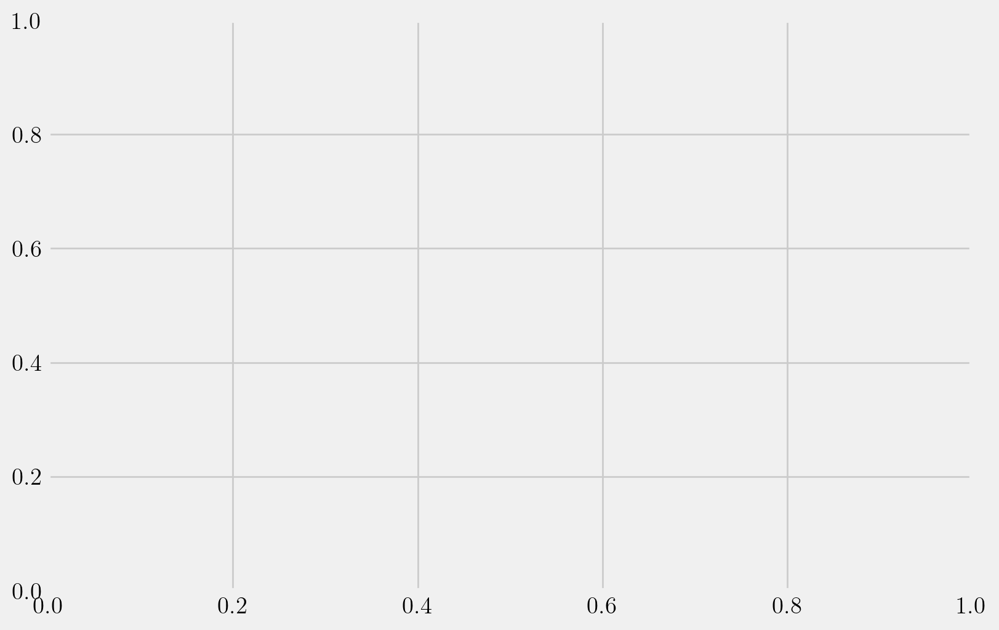

In [120]:
epoch_r,deg = find_reg_d_func(0.3,df_rslt_med)
df_whole['epoch_r'] = epoch_r(df_whole['init_lr'].values)
print(r2_score(df_whole['epoch'],df_whole['epoch_r']), root_mean_squared_error(df_whole['epoch'],df_whole['epoch_r']))

fig,ax = plt.subplots(figsize=(8,5))
ax.plot(x_epochr,epoch_r(x_epochr),color='#afde32',lw=0.7)
ax.plot(df_whole.loc[ind,'init_lr'],df_whole.loc[ind,'epoch_r'],color='#afde32',lw=0,marker='o',markersize=3,label='estimate')
sns.scatterplot(data=df_whole,x='init_lr',y='epoch',alpha=0.3,label='simulation')

ind = df_whole['init_lr'].drop_duplicates(keep='first').sort_values().index
x_epochr = np.linspace(df_whole['init_lr'].min(),df_whole['init_lr'].max(),300)

df_desc = desc_dist(df_whole,'init_lr','epoch')
ax.scatter(data=df_desc,x=df_desc.index,y='median',lw=0.7,marker='^',s=45,color='#24b38f',alpha=0.8,label='median')
ax.scatter(data=df_desc,x=df_desc.index,y='mean',lw=0.7,marker='p',s=45,color='#af34c3',alpha=0.8,label='mean')

ax.legend()

0.7039689139893605 57.87856891802614


NameError: name 'x_epochr' is not defined

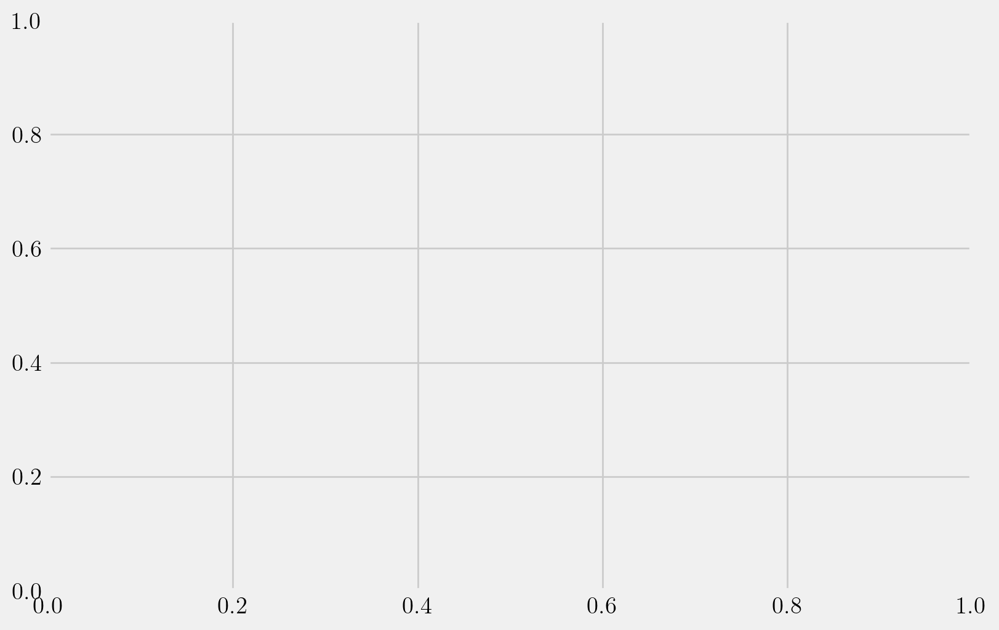

In [121]:
epoch_r,deg = find_reg_d_func(-0.1,df_rslt_mean)
df_whole['epoch_r'] = epoch_r(df_whole['init_lr'].values)
print(r2_score(df_whole['epoch'],df_whole['epoch_r']), root_mean_squared_error(df_whole['epoch'],df_whole['epoch_r']))

ind = df_whole['init_lr'].drop_duplicates(keep='first').sort_values().index
fig,ax = plt.subplots(figsize=(8,5))
ax.plot(x_epochr,epoch_r(x_epochr),color='#afde32',lw=0.7)
ax.plot(df_whole.loc[ind,'init_lr'],df_whole.loc[ind,'epoch_r'],color='#afde32',lw=0,marker='o',markersize=3,label='estimate')
sns.scatterplot(data=df_whole,x='init_lr',y='epoch',alpha=0.3,label='simulation')

x_epochr = np.linspace(df_whole['init_lr'].min(),df_whole['init_lr'].max(),300)

df_desc = desc_dist(df_whole,'init_lr','epoch')
ax.scatter(data=df_desc,x=df_desc.index,y='median',lw=0.7,marker='^',s=45,color='#24b38f',alpha=0.8,label='median')
ax.scatter(data=df_desc,x=df_desc.index,y='mean',lw=0.7,marker='p',s=45,color='#af34c3',alpha=0.8,label='mean')
#ax.set_yscale('log')
ax.legend()

0.7102150534636515 57.26470606963699


NameError: name 'x_epochr' is not defined

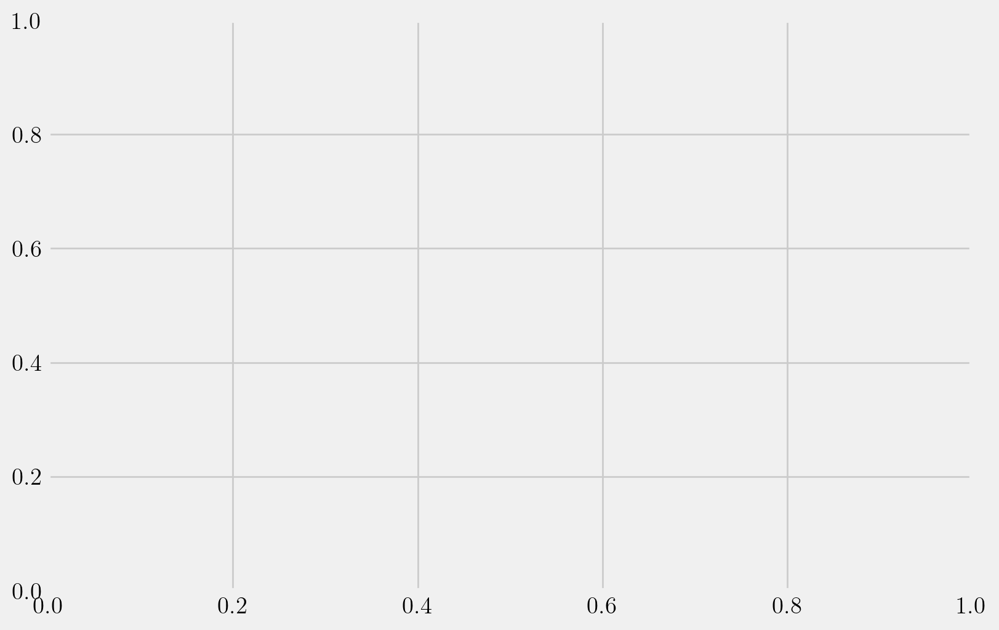

In [122]:
epoch_r,deg = find_reg_d_func(0.52,df_rslt1)
df_whole['epoch_r'] = epoch_r(df_whole['init_lr'].values)
print(r2_score(df_whole['epoch'],df_whole['epoch_r']), root_mean_squared_error(df_whole['epoch'],df_whole['epoch_r']))

ind = df_whole['init_lr'].drop_duplicates(keep='first').sort_values().index
fig,ax = plt.subplots(figsize=(8,5))
ax.plot(x_epochr,epoch_r(x_epochr),color='#afde32',lw=0.7)
ax.plot(df_whole.loc[ind,'init_lr'],df_whole.loc[ind,'epoch_r'],color='#afde32',lw=0,marker='o',markersize=3,label='estimate')
sns.scatterplot(data=df_whole,x='init_lr',y='epoch',alpha=0.3,label='simulation')

x_epochr = np.linspace(df_whole['init_lr'].min(),df_whole['init_lr'].max(),300)

ax.scatter(data=df_desc,x=df_desc.index,y='median',lw=0.7,marker='^',s=45,color='#24b38f',alpha=0.8,label='median')
ax.scatter(data=df_desc,x=df_desc.index,y='mean',lw=0.7,marker='p',s=45,color='#af34c3',alpha=0.8,label='mean')

ax.legend()

reg_whole - 55.479501175062076
reg_median - 55.58040470220025
reg_mean - 60.778005881136735


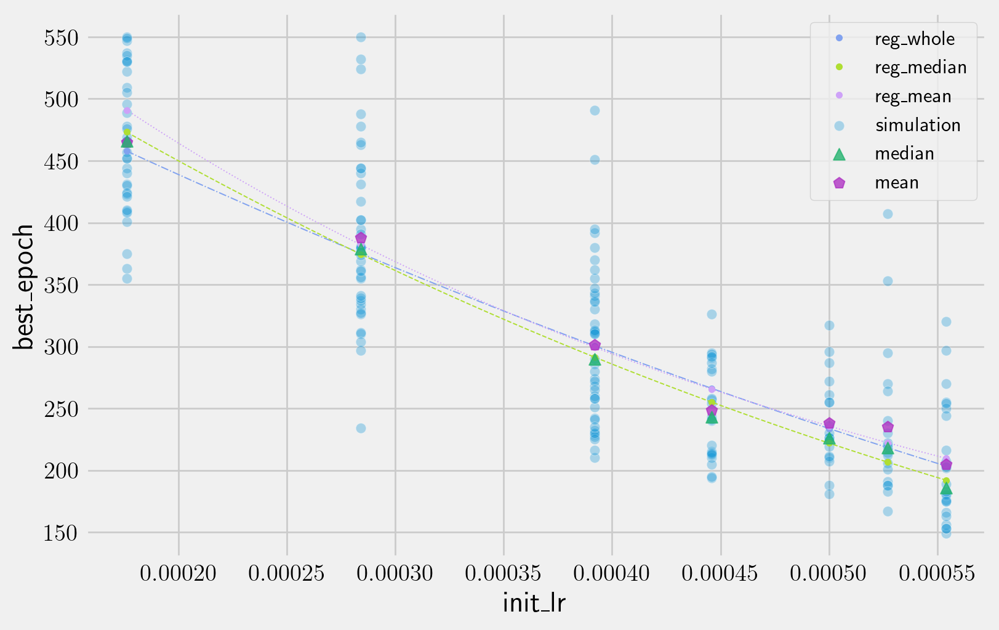

In [123]:
info_dict={
    'reg_whole':{
        'deg':0.52,
        'rslt':df_rslt1,
        'c':'#81a2ef',
        'ls':'dashdot'
    },
    'reg_median':{
        'deg':0.3,
        'rslt':df_rslt_med,
        'c':'#afde32',
        'ls':'dashed'
    },
    'reg_mean':{
        'deg':-0.1,
        'rslt':df_rslt_mean,
        'c':'#cea2f8',
        'ls':'dotted'
    },
}

x_epochr = np.linspace(df_whole['init_lr'].min(),df_whole['init_lr'].max(),300)
ind = df_whole['init_lr'].drop_duplicates(keep='first').sort_values().index
fig,ax = plt.subplots(figsize=(8,5))

for name,dat in info_dict.items():
  epoch_r,deg = find_reg_d_func(dat['deg'],dat['rslt'])
  df_whole['epoch_r'] = epoch_r(df_whole['init_lr'].values)
  ax.plot(x_epochr,epoch_r(x_epochr),color=dat['c'],lw=0.7,ls=dat['ls'])
  ax.plot(df_whole.loc[ind,'init_lr'],df_whole.loc[ind,'epoch_r'],color=dat['c'],lw=0,marker='o',markersize=3,label=name)

  cond = df_whole['init_lr']==0.000176
  print(name,'-',rmse(df_whole.loc[cond,'epoch'],df_whole.loc[cond,'epoch_r']))

sns.scatterplot(data=df_whole,x='init_lr',y='epoch',alpha=0.3,label='simulation')
ax.scatter(data=df_desc,x=df_desc.index,y='median',lw=0.7,marker='^',s=45,color='#24b36f',alpha=0.8,label='median',zorder=10)
ax.scatter(data=df_desc,x=df_desc.index,y='mean',lw=0.7,marker='p',s=45,color='#af34c3',alpha=0.8,label='mean',zorder=5)

ax.legend(fontsize=12)
ax.set_ylabel('best_epoch');

In [124]:
df_desc.loc[0.000176]

,0.000176
count,35.000000
mean,465.142857
std,55.800139
min,355.000000
q1,423.500000
median,466.000000
q3,515.500000
max,550.000000


In [125]:
for name,dat in info_dict.items():
  epoch_r,deg = find_reg_d_func(dat['deg'],dat['rslt'])
  df_whole['epoch_r'] = epoch_r(df_whole['init_lr'].values)
  ax.plot(x_epochr,epoch_r(x_epochr),color=dat['c'],lw=0.7,ls=dat['ls'])
  ax.plot(df_whole.loc[ind,'init_lr'],df_whole.loc[ind,'epoch_r'],color=dat['c'],lw=0,marker='o',markersize=3,label=name)

  cond = df_whole['init_lr']==0.000176
  pred = df_whole.loc[cond,'epoch_r'].unique()[0]
  print(name,'-',pred,'\t rmse : ',rmse(df_whole.loc[cond,'epoch'],df_whole.loc[cond,'epoch_r']))
  print(pred-df_desc.loc[0.000176,['mean','median']])

reg_whole - 457.843461751272 	 rmse :  55.479501175062076
mean     -7.299395
median   -8.156538
Name: 0.000176, dtype: float64
reg_median - 473.17326867087627 	 rmse :  55.58040470220025
mean      8.030412
median    7.173269
Name: 0.000176, dtype: float64
reg_mean - 491.01315133013827 	 rmse :  60.778005881136735
mean      25.870294
median    25.013151
Name: 0.000176, dtype: float64


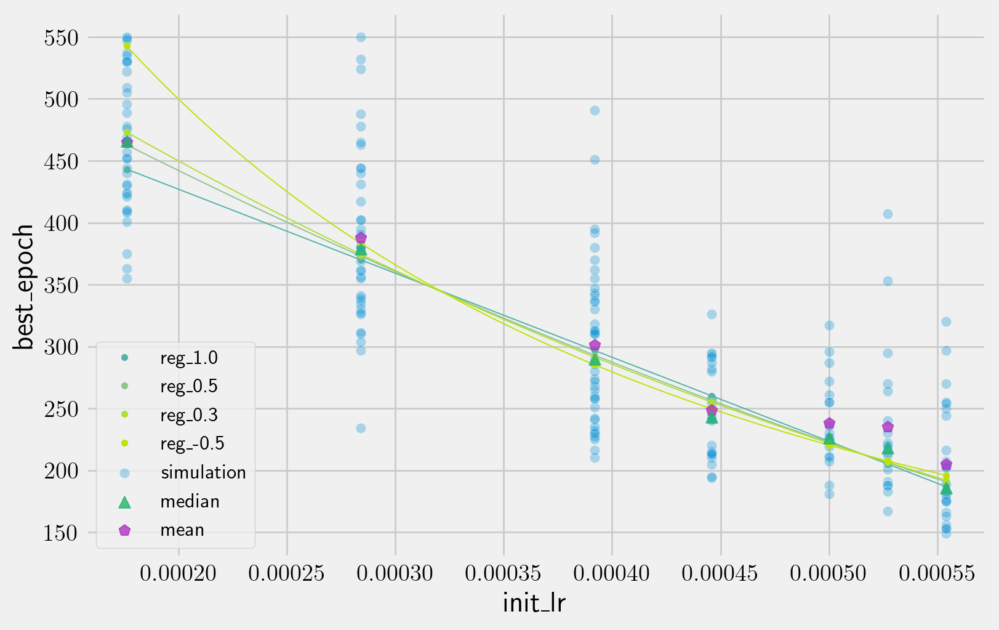

In [126]:
info_dict={
    'reg_1.0':{
        'deg':1.0,
        'rslt':df_rslt_med,
        'c':'#51b2a8',
        #'ls':(0,(3,5,1,5,1,5))
    },
    'reg_0.5':{
        'deg':0.5,
        'rslt':df_rslt_med,
        'c':'#91c28f',
        #'ls':'dotted'
    },
    'reg_0.3':{
        'deg':0.3,
        'rslt':df_rslt_med,
        'c':'#afde32',
        #'ls':'dashed'
    },
    'reg_-0.5':{
        'deg':-0.5,
        'rslt':df_rslt_med,
        'c':'#bee201',
        #'ls':'dashdot'
    },
}

x_epochr = np.linspace(df_whole['init_lr'].min(),df_whole['init_lr'].max(),300)
ind = df_whole['init_lr'].drop_duplicates(keep='first').sort_values().index
fig,ax = plt.subplots(figsize=(8,5))

for name,dat in info_dict.items():
  epoch_r,deg = find_reg_d_func(dat['deg'],dat['rslt'])
  df_whole['epoch_r'] = epoch_r(df_whole['init_lr'].values)
  ax.plot(x_epochr,epoch_r(x_epochr),color=dat['c'],lw=0.7)#,ls=dat['ls'])
  ax.plot(df_whole.loc[ind,'init_lr'],df_whole.loc[ind,'epoch_r'],color=dat['c'],lw=0,marker='o',markersize=3,label=name)

sns.scatterplot(data=df_whole,x='init_lr',y='epoch',alpha=0.3,label='simulation')
ax.scatter(data=df_desc,x=df_desc.index,y='median',lw=0.7,marker='^',s=45,color='#24b36f',alpha=0.8,label='median',zorder=10)
ax.scatter(data=df_desc,x=df_desc.index,y='mean',lw=0.7,marker='p',s=45,color='#af34c3',alpha=0.8,label='mean',zorder=5)

ax.legend(fontsize=12)
ax.set_ylabel('best_epoch');

-8.877775110806125 334.33257429983917


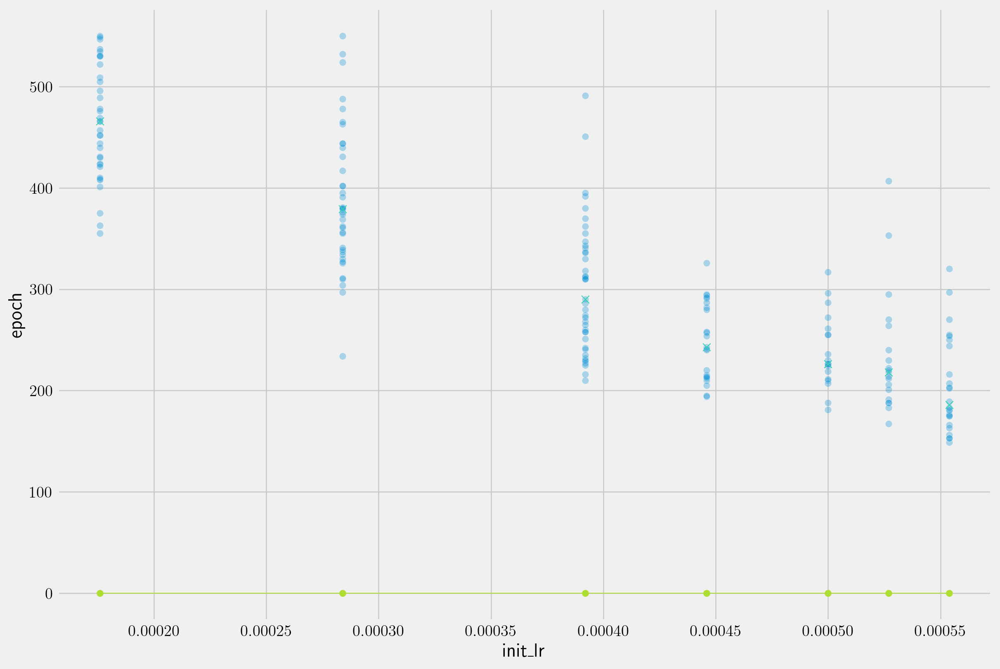

In [127]:
epoch_r = lambda x : np.power(x*a+b,1/deg)/coeff
df_whole['epoch_r'] = epoch_r(df_whole['init_lr'].values)
print(r2_score(df_whole['epoch'],df_whole['epoch_r']), root_mean_squared_error(df_whole['epoch'],df_whole['epoch_r']))

fig,ax = plt.subplots(figsize=(12,8))
sns.scatterplot(data=df_whole,x='init_lr',y='epoch',alpha=0.3)

ind = df_whole['init_lr'].drop_duplicates(keep='first').sort_values().index
x_epochr = np.linspace(df_whole['init_lr'].min(),df_whole['init_lr'].max(),300)
ax.plot(x_epochr,epoch_r(x_epochr),color='#afde32',lw=0.7)
ax.plot(df_whole.loc[ind,'init_lr'],df_whole.loc[ind,'epoch_r'],color='#afde32',lw=0,marker='o',markersize=5)

ax.scatter(df_mode.lr.to_numpy(),df_mode[0].to_numpy(),lw=0.7,marker='x',s=45,color='#34d3af')

-11.178534507420741 278.6550223421651


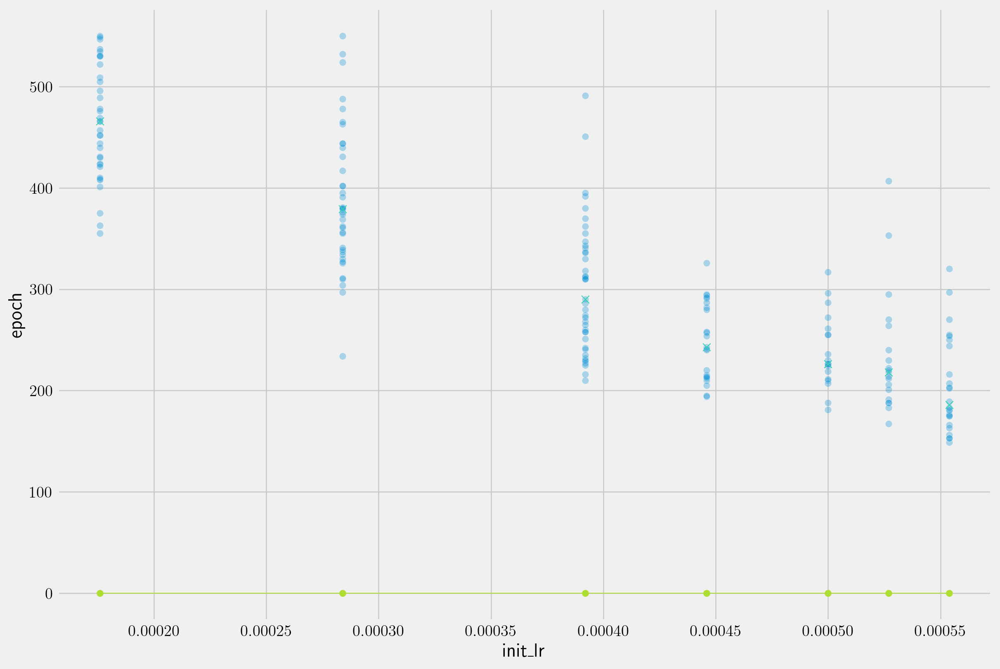

In [128]:

epoch_r = lambda x : np.power(x*a+b,1/deg)/coeff
df_whole['epoch_r'] = epoch_r(df_whole['init_lr'].values)

df_mod2 = df_mod.copy()
df_mod2['epoch_r'] = epoch_r(df_mod2['init_lr'].values)
print(r2_score(df_mod2['epoch'],df_mod2['epoch_r']), root_mean_squared_error(df_mod2['epoch'],df_mod2['epoch_r']))

fig,ax = plt.subplots(figsize=(12,8))
sns.scatterplot(data=df_whole,x='init_lr',y='epoch',alpha=0.3)

ind = df_whole['init_lr'].drop_duplicates(keep='first').sort_values().index
x_epochr = np.linspace(df_whole['init_lr'].min(),df_whole['init_lr'].max(),300)
ax.plot(x_epochr,epoch_r(x_epochr),color='#afde32',lw=0.7)
ax.plot(df_whole.loc[ind,'init_lr'],df_whole.loc[ind,'epoch_r'],color='#afde32',lw=0,marker='o',markersize=5)

ax.scatter(df_mode.lr.to_numpy(),df_mode[0].to_numpy(),lw=0.7,marker='x',s=45,color='#34d3af')

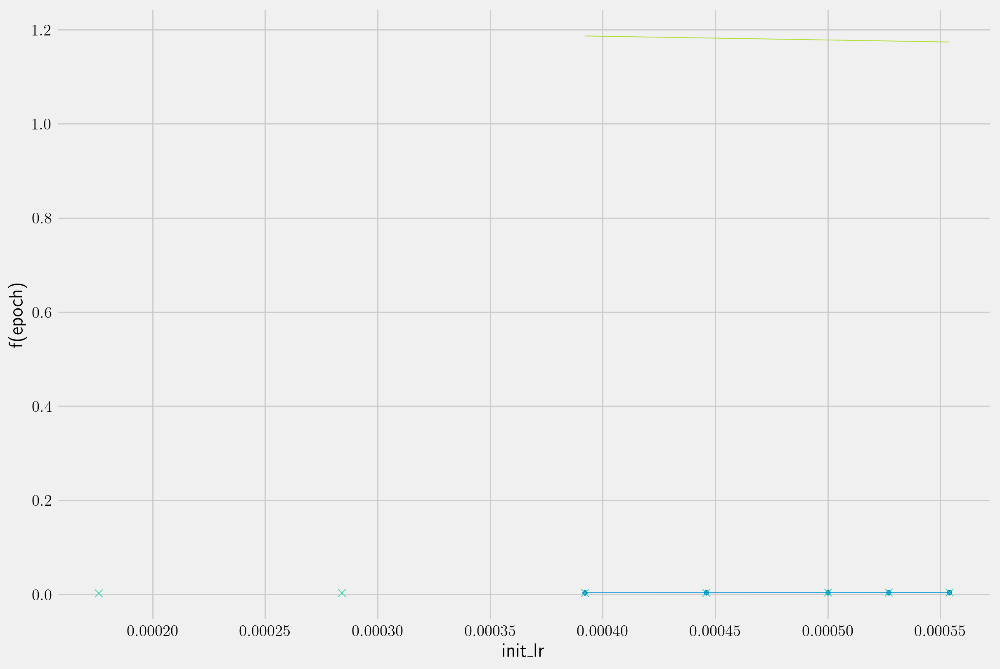

In [129]:
df_part = pd.concat(df_expt_list[3:]+df_expt_list[1:2])
len(df_part)
coeff = (len(data_dict['trn']['X'])/20480)*60
df_part['f(epoch)'] = np.power(coeff * df_part['epoch'],-0.5)

fig,ax = plt.subplots(figsize=(12,8))
#sns.scatterplot(data=df_whole,x='init_lr',y='f(epoch)',alpha=0.3,s=10,ax=ax)
sns.regplot(data=df_part,x='init_lr',y='f(epoch)',scatter_kws={'alpha':0.3,'s':10},line_kws={'alpha':0.8,'lw':0.7},ax=ax);

x_epochr = np.linspace(df_part['init_lr'].min(),df_part['init_lr'].max(),300)
ax.plot(x_epochr,(x_epochr*a+b),color='#afde32',lw=0.7)

ax.scatter(df_mode.lr.to_numpy(),np.power(df_mode[0].to_numpy()*coeff,-0.5),lw=0.7,marker='x',s=45,color='#34d3af')

In [130]:
weight_ind = lambda x : weights[lr_dict[f'20480_2.{x}']]
temp = list()
for  i in range(len(df_expt_list)):
  temp.extend([df_expt_list[i] for _ in range(weight_ind(i))])
df_mod = pd.concat(temp)
len(df_mod)

285

In [131]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score, root_mean_squared_error

coeff = (len(data_dict['trn']['X'])/20480)*60
df_mod['f(epoch)'] = np.power(coeff * df_mod['epoch'],-0.5)
X = df_mod['init_lr'].values.reshape(-1,1)
y = df_mod['f(epoch)'].values

reg = LinearRegression(fit_intercept=True)

reg.fit(X,y)

print(reg.score(X,y))

a_mod,b_mod = reg.coef_,reg.intercept_
r2_score(y,a_mod*X+b_mod), root_mean_squared_error(y,a_mod*X+b_mod)

0.6566469039469718


(0.6566469039469718, 0.00033273678941941957)

In [132]:
print(a,a_mod)
print(b,b_mod)

[-79.1126287] [3.69985834]
1.2176593943981209 0.001995454033436905


0.695781548771391 58.67348718063884


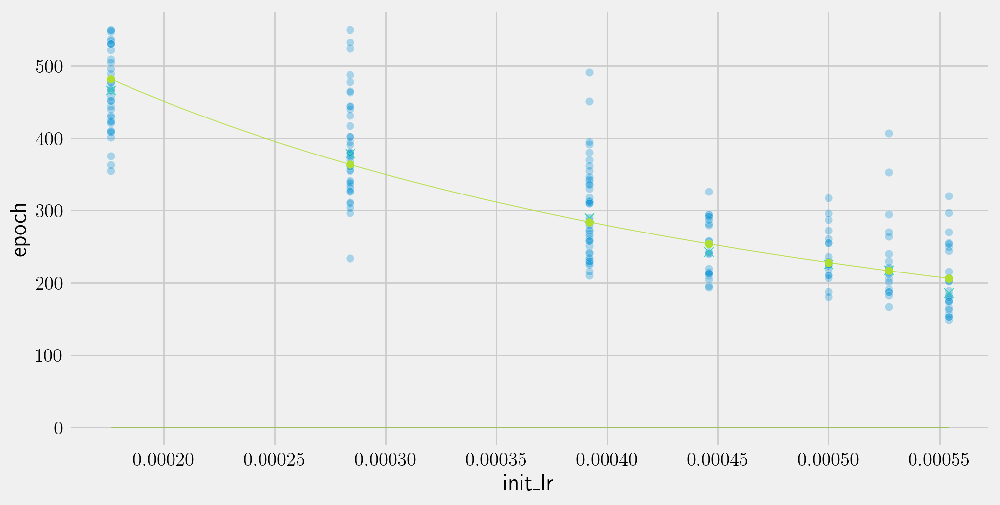

In [133]:
epoch_r_mod = lambda x : np.power(x*a_mod+b_mod,-2)/coeff
df_whole['epoch_r_mod'] = epoch_r_mod(df_whole['init_lr'].values)
print(r2_score(df_whole['epoch'],df_whole['epoch_r_mod']), root_mean_squared_error(df_whole['epoch'],df_whole['epoch_r_mod']))

fig,ax = plt.subplots(figsize=(10,5))
sns.scatterplot(data=df_whole,x='init_lr',y='epoch',alpha=0.3)

ind = df_whole['init_lr'].drop_duplicates(keep='first').sort_values().index
x_epochr = np.linspace(df_whole['init_lr'].min(),df_whole['init_lr'].max(),300)
ax.plot(x_epochr,epoch_r(x_epochr),color='#91be42',lw=0.7,alpha=0.8)
ax.plot(x_epochr,epoch_r_mod(x_epochr),color='#afde32',lw=0.7,alpha=0.8)
ax.plot(df_whole.loc[ind,'init_lr'],df_whole.loc[ind,'epoch_r_mod'],color='#afde32',lw=0,marker='o',markersize=5)

ax.scatter(df_mode.lr.to_numpy(),df_mode[0].to_numpy(),lw=0.7,marker='x',s=45,color='#34d3af')

In [134]:
df_mod['init_lr'].value_counts()

,count
init_lr,
0.000554,48
0.000446,46
0.000392,41
0.000284,39
0.000500,38
0.000527,38
0.000176,35


In [135]:
df_whole.info()

<class 'pandas.core.frame.DataFrame'>
Index: 200 entries, model4.5_20480_2.0_0_lr0.000176_1 to model4.5_20480_2.6_18_lr0.000527_1
Data columns (total 17 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   epoch        200 non-null    int64  
 1   score        200 non-null    float64
 2   init_lr      200 non-null    float64
 3   valid_score  200 non-null    float64
 4   f(epoch)     200 non-null    int64  
 5   tst_loss     200 non-null    float64
 6   tst_score    200 non-null    float64
 7   tst_mape     200 non-null    float64
 8   vld_loss     200 non-null    float64
 9   vld_score    200 non-null    float64
 10  vld_mape     200 non-null    float64
 11  trn_loss     200 non-null    float64
 12  trn_score    200 non-null    float64
 13  trn_mape     200 non-null    float64
 14  coeff        200 non-null    float64
 15  epoch_r      200 non-null    float64
 16  epoch_r_mod  200 non-null    float64
dtypes: float64(15), int64(2)
memory us

In [136]:
from decimal import Decimal

label_dict= {
    'loss_diff' : 'valid_loss - train_loss',
    'vld_loss' : 'valid_loss',
    'vld_score' : 'valid_score',
    'vld_mape' : 'valid_mape',
    'epoch' : 'best_epoch',
}

def plot_expt_data_rslt(data,title):

  ft_size = 8
  if 'epoch_r_mod' in data.columns :
    temp = data['epoch_r_mod'].unique()
    epoch_lr = temp[0]
  else : epoch_lr = None

  fig,axes = plt.subplots(2,4,figsize=(14,8))
  fig.suptitle(title)
  axes_flat = axes.flatten()
  sns.histplot(data=data,x='epoch',ax=axes_flat[0],bins=(len(data)//3)+1)
  axes_flat[0].set_xlabel('best_epoch')

  sns.histplot(data=data,x='vld_loss',ax=axes_flat[1],binwidth=25)
  axes_flat[1].set_xlabel('valid_loss')

  sns.histplot(data=data,x='vld_score',ax=axes_flat[2],bins=(len(data)//3)+1)
  axes_flat[2].set_xlabel('valid_r2_score')

  sns.histplot(data=data,x='vld_mape',ax=axes_flat[3],bins=(len(data)//3)+1)
  axes_flat[3].set_xlabel('valid_mape')

  data['loss_diff'] = (data['vld_loss']-data['trn_loss'])

  scatter_space_dict={
      'loss_diff' : (0,11),
      'vld_loss' : (0,8),
      'vld_score' :(0,0.0009),
      'vld_mape' : (0,0.0011),
  }

  scatter_keys = [
      'loss_diff',
      'vld_loss',
      'vld_score',
      'vld_mape',
  ]

  for ind,key in enumerate(scatter_keys):
    sns.scatterplot(data=data,x='epoch',y=key,ax=axes_flat[4+ind])
    for i,dir in enumerate(data.index):
      x,y = data.loc[dir,'epoch'],data.loc[dir,key]
      y_h = (data[key].max()-data[key].min())/120
      x_h = (x-data['epoch'].min())/60
      axes_flat[4+ind].annotate(f'{i}',xy = (x,y),xytext = (x+x_h,y+y_h), fontsize = ft_size, ha='center')
    axes_flat[4+ind].set_ylabel(label_dict[key])
    axes_flat[4+ind].set_xlabel('best_epoch')

    e_mean, e_med, = data['epoch'].mean(),data['epoch'].median()
    axes_flat[4+ind].axvline(x=e_mean,alpha = 0.8, c = '#a92219', ls = 'dotted', lw=0.6,label=f'mean: {e_mean:.1f}')
    axes_flat[4+ind].axvline(x=e_med,alpha = 0.8, c = '#32a959', ls = 'dashed', lw=0.6,label=f'median: {e_med:.1f}')
#    axes_flat[4+ind].axvline(x=epoch_lr,alpha = 0.8, c = '#721279', ls = 'dashdot', lw=0.6,label=f'estimate: {epoch_lr:.1f}')
    axes_flat[4+ind].legend(fontsize=ft_size)

<ipython-input-136-23db92137f9c>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['loss_diff'] = (data['vld_loss']-data['trn_loss'])
<ipython-input-136-23db92137f9c>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['loss_diff'] = (data['vld_loss']-data['trn_loss'])
<ipython-input-136-23db92137f9c>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pa

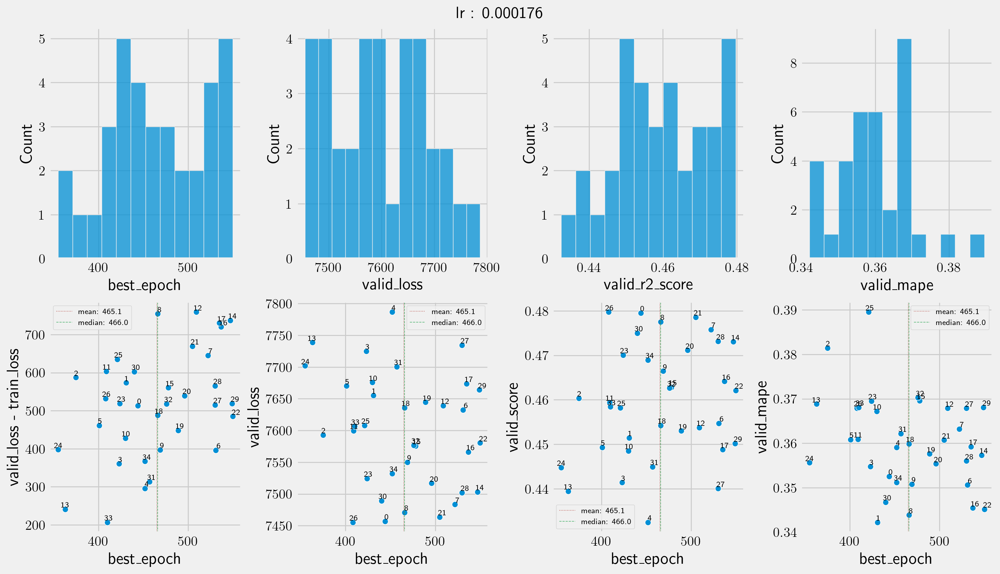

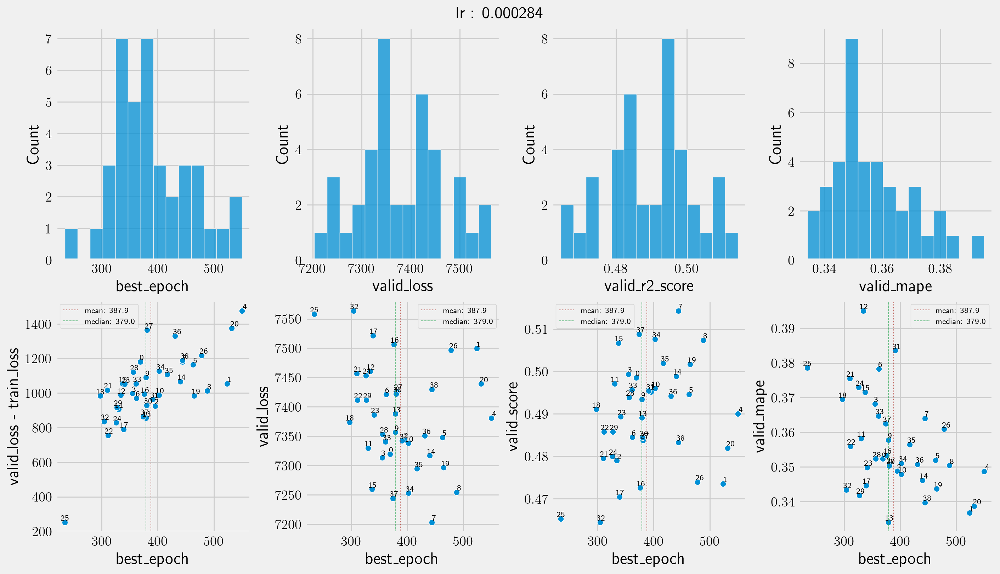

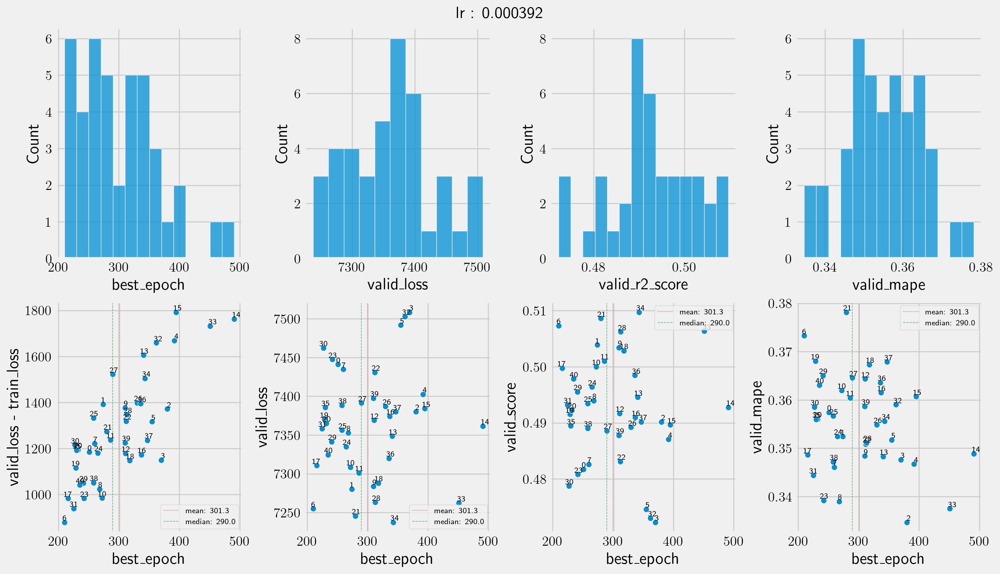

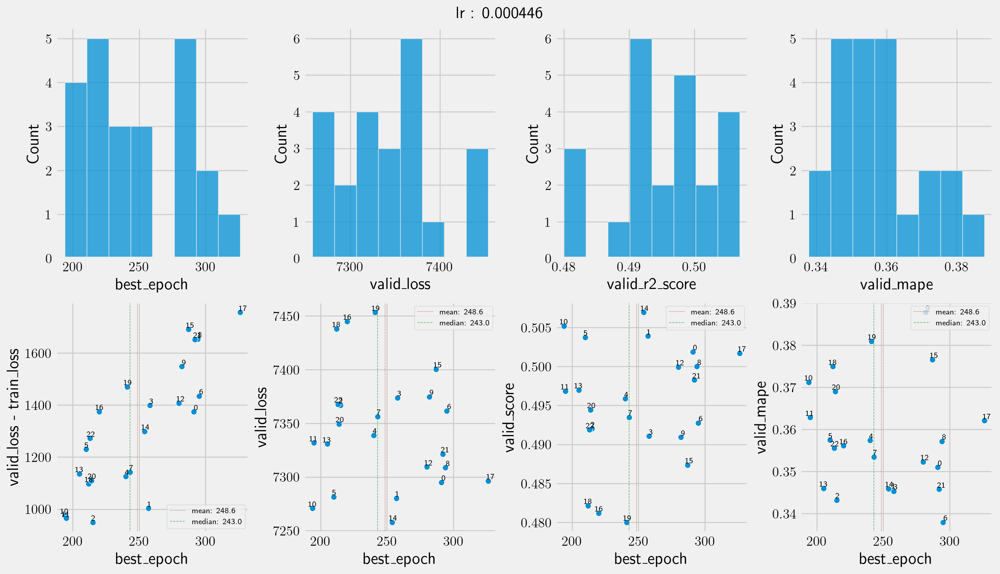

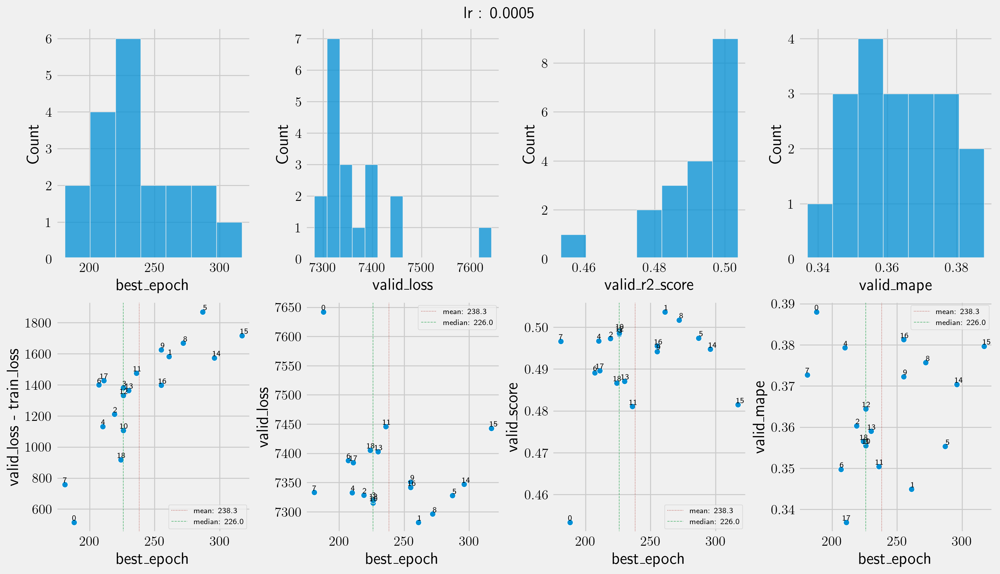

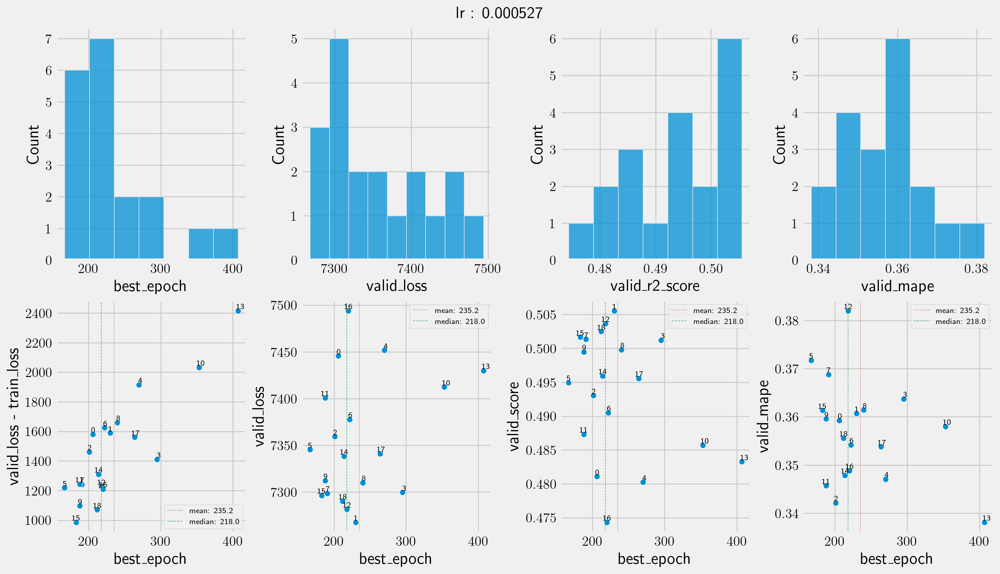

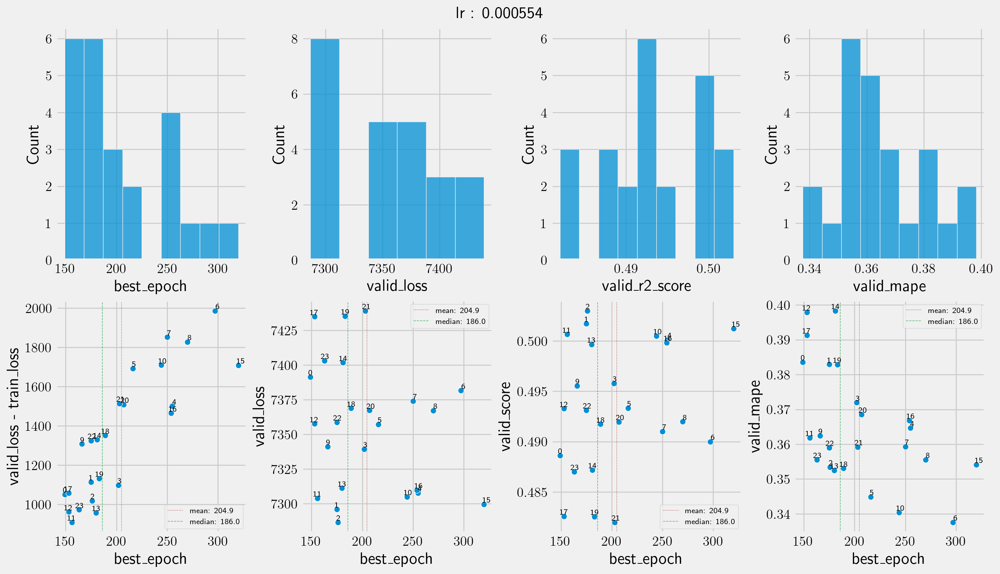

In [137]:
init_lrs = sorted(df_whole.init_lr.unique())

for key in init_lrs:
  cond = df_whole['init_lr'] == key
  plot_expt_data_rslt(df_whole[cond],f'lr : {key}')

In [138]:
display(df_whole.info())
display(df_temp.info())
df_temp['epoch_r_mod'] = df_whole['epoch_r_mod']

<class 'pandas.core.frame.DataFrame'>
Index: 200 entries, model4.5_20480_2.0_0_lr0.000176_1 to model4.5_20480_2.6_18_lr0.000527_1
Data columns (total 17 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   epoch        200 non-null    int64  
 1   score        200 non-null    float64
 2   init_lr      200 non-null    float64
 3   valid_score  200 non-null    float64
 4   f(epoch)     200 non-null    int64  
 5   tst_loss     200 non-null    float64
 6   tst_score    200 non-null    float64
 7   tst_mape     200 non-null    float64
 8   vld_loss     200 non-null    float64
 9   vld_score    200 non-null    float64
 10  vld_mape     200 non-null    float64
 11  trn_loss     200 non-null    float64
 12  trn_score    200 non-null    float64
 13  trn_mape     200 non-null    float64
 14  coeff        200 non-null    float64
 15  epoch_r      200 non-null    float64
 16  epoch_r_mod  200 non-null    float64
dtypes: float64(15), int64(2)
memory us

None

<class 'pandas.core.frame.DataFrame'>
Index: 250 entries, model4.5_20480_2.3_0_lr0.000392_1 to model4.5_20480_2.6_18_lr0.000527_1
Data columns (total 3 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   init_lr  250 non-null    float64
 1   coeff    250 non-null    float64
 2   epoch    250 non-null    int64  
dtypes: float64(2), int64(1)
memory usage: 15.9+ KB


None

<Axes: xlabel='tst_mape', ylabel='epoch_r_mod'>

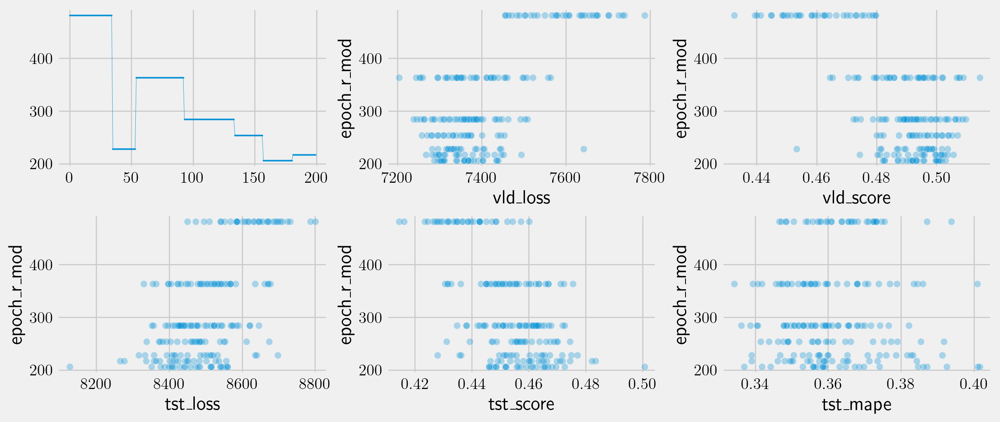

In [139]:
fig,axes = plt.subplots(2,3,figsize=(12,5))
ax = axes.flatten()
ax[0].plot(range(len(df_whole)),df_whole['epoch_r_mod'],lw=0.3,marker='o',markersize=0.5)
sns.scatterplot(data=df_whole, x='vld_loss',y='epoch_r_mod',ax=ax[1],alpha=0.3)
sns.scatterplot(data=df_whole, x='vld_score',y='epoch_r_mod',ax=ax[2],alpha=0.3)
sns.scatterplot(data=df_whole, x='tst_loss',y='epoch_r_mod',ax=ax[3],alpha=0.3)
sns.scatterplot(data=df_whole, x='tst_score',y='epoch_r_mod',ax=ax[4],alpha=0.3)
sns.scatterplot(data=df_whole, x='tst_mape',y='epoch_r_mod',ax=ax[5],alpha=0.3)

<Axes: xlabel='vld_mape', ylabel='init_lr'>

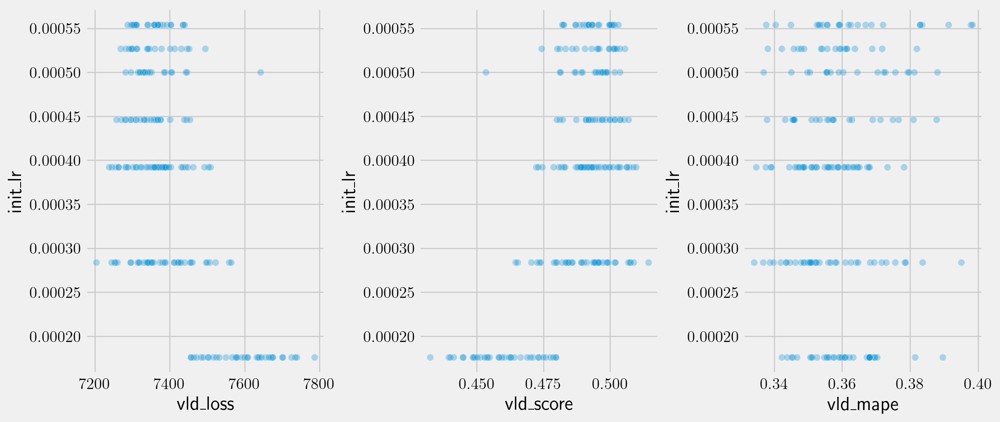

In [140]:
fig,axes = plt.subplots(1,3,figsize=(12,5))
ax = axes.flatten()
sns.scatterplot(data=df_whole, x='vld_loss',y='init_lr',ax=ax[0],alpha=0.3)
sns.scatterplot(data=df_whole, x='vld_score',y='init_lr',ax=ax[1],alpha=0.3)
sns.scatterplot(data=df_whole, x='vld_mape',y='init_lr',ax=ax[2],alpha=0.3)


In [141]:
df_whole.info()

<class 'pandas.core.frame.DataFrame'>
Index: 200 entries, model4.5_20480_2.0_0_lr0.000176_1 to model4.5_20480_2.6_18_lr0.000527_1
Data columns (total 17 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   epoch        200 non-null    int64  
 1   score        200 non-null    float64
 2   init_lr      200 non-null    float64
 3   valid_score  200 non-null    float64
 4   f(epoch)     200 non-null    int64  
 5   tst_loss     200 non-null    float64
 6   tst_score    200 non-null    float64
 7   tst_mape     200 non-null    float64
 8   vld_loss     200 non-null    float64
 9   vld_score    200 non-null    float64
 10  vld_mape     200 non-null    float64
 11  trn_loss     200 non-null    float64
 12  trn_score    200 non-null    float64
 13  trn_mape     200 non-null    float64
 14  coeff        200 non-null    float64
 15  epoch_r      200 non-null    float64
 16  epoch_r_mod  200 non-null    float64
dtypes: float64(15), int64(2)
memory us

<ipython-input-142-5e2eaca474ae>:19: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(labels,fontsize=9)
<ipython-input-142-5e2eaca474ae>:19: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(labels,fontsize=9)
<ipython-input-142-5e2eaca474ae>:19: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(labels,fontsize=9)
<ipython-input-142-5e2eaca474ae>:19: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(labels,fontsize=9)


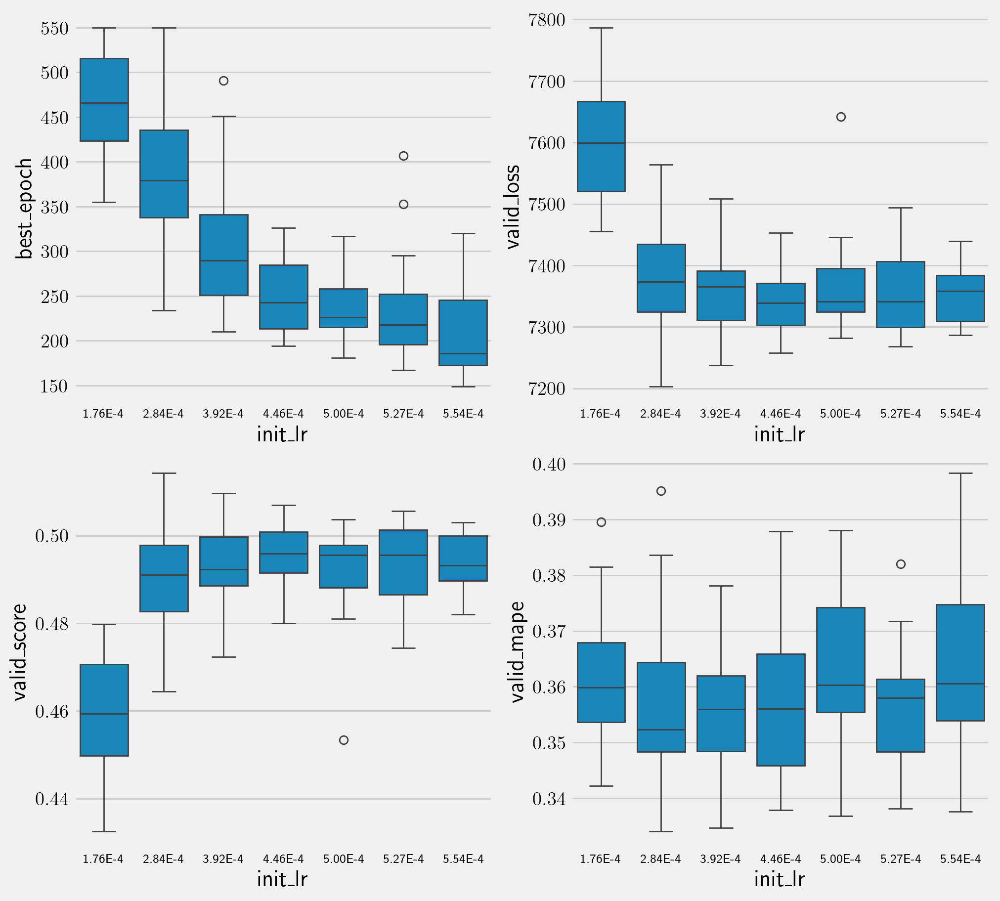

In [142]:
from decimal import Decimal

fig,axes = plt.subplots(2,2,figsize=(10,9))
axes_flat = axes.flatten()

feats = ['epoch',
         'vld_loss',
         'vld_score',
         'vld_mape']

for i,(key,ax) in enumerate(zip(feats,axes_flat)):
  sns.boxplot(data=df_whole, y=key,x='init_lr',ax=ax)
  ax.set_ylabel(label_dict[key])

for ax in axes_flat:
  ax.xaxis.set_tick_params(labelsize=9)
  labels = [tl._text for tl in ax.xaxis.get_majorticklabels()]
  labels = [f'{Decimal(txt):.2E}' for txt in labels]
  ax.set_xticklabels(labels,fontsize=9)


InvalidOperation: [<class 'decimal.ConversionSyntax'>]

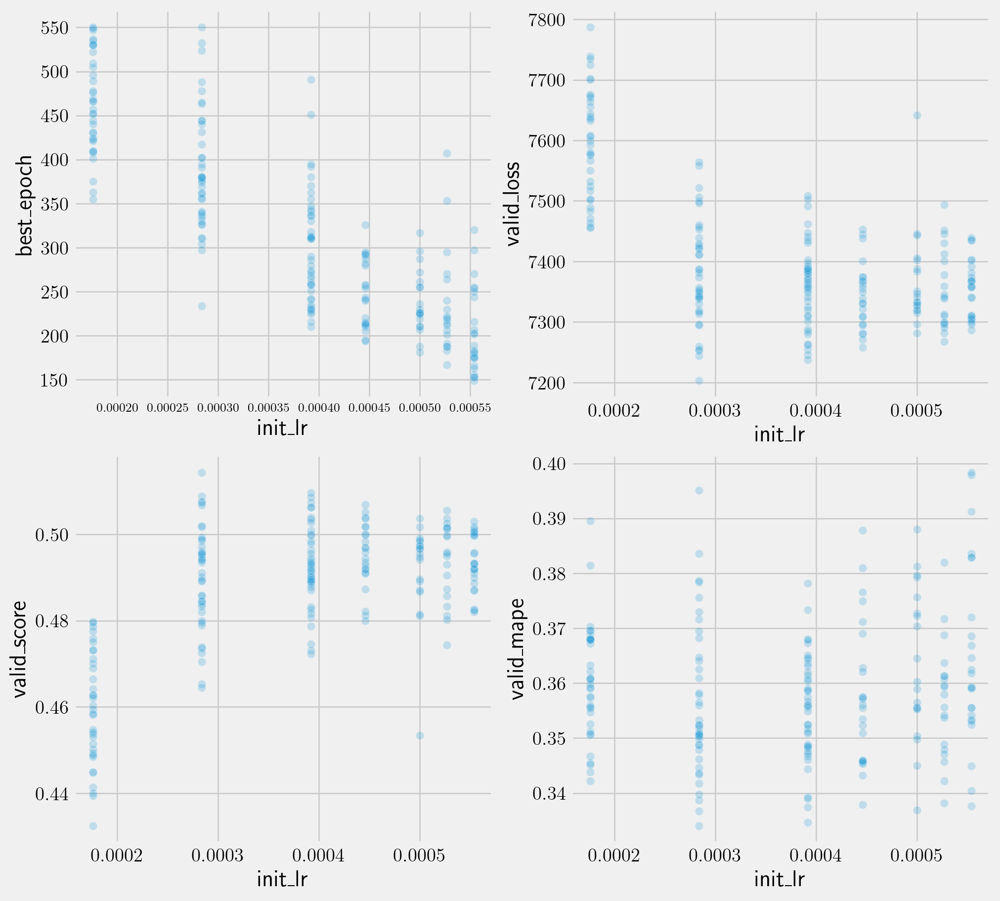

In [144]:
from decimal import Decimal

fig,axes = plt.subplots(2,2,figsize=(10,9))
axes_flat = axes.flatten()

feats = ['epoch',
         'vld_loss',
         'vld_score',
         'vld_mape']

for i,(key,ax) in enumerate(zip(feats,axes_flat)):
  sns.scatterplot(data=df_whole, y=key,x='init_lr',ax=ax,alpha=0.2)
  ax.set_ylabel(label_dict[key])

for ax in axes_flat:
  ax.xaxis.set_tick_params(labelsize=9)
  labels = [tl._text for tl in ax.xaxis.get_majorticklabels()]
  labels = [f'{Decimal(txt):.2E}' for txt in labels]
  ax.set_xticklabels(labels,fontsize=8.5)


<ipython-input-145-51ce13815e61>:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(labels,fontsize=8.5)
<ipython-input-145-51ce13815e61>:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(labels,fontsize=8.5)
<ipython-input-145-51ce13815e61>:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(labels,fontsize=8.5)
<ipython-input-145-51ce13815e61>:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(labels,fontsize=8.5)


InvalidOperation: [<class 'decimal.ConversionSyntax'>]

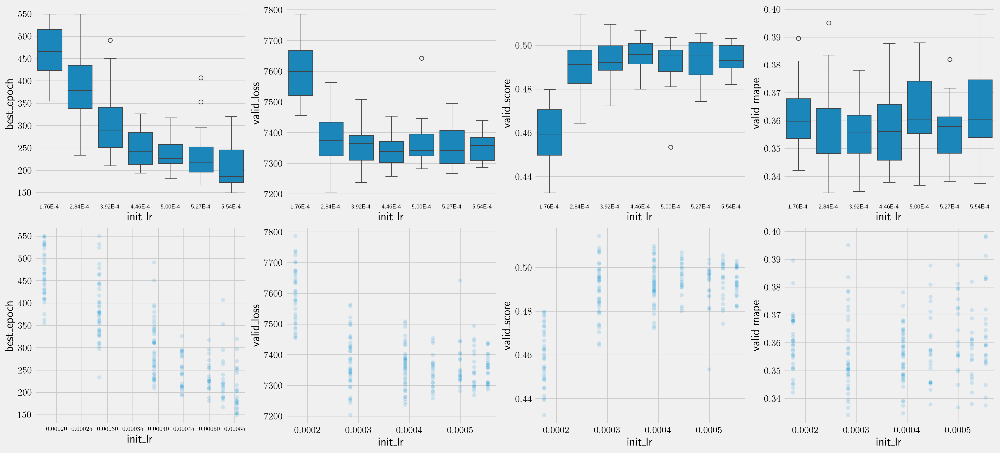

In [145]:
from decimal import Decimal

fig,axes = plt.subplots(2,4,figsize=(20,9))
axes_flat = axes.flatten()

feats = ['epoch',
         'vld_loss',
         'vld_score',
         'vld_mape']

for key,ax in zip(feats,axes_flat[:len(feats)]):
  sns.boxplot(data=df_whole, y=key,x='init_lr',ax=ax)
  ax.set_ylabel(label_dict[key])

for key,ax in zip(feats,axes_flat[len(feats):]):
  sns.scatterplot(data=df_whole, y=key,x='init_lr',ax=ax,alpha=0.15)
  ax.set_ylabel(label_dict[key])

for ax in axes_flat:
  ax.xaxis.set_tick_params(labelsize=9)
  labels = [tl._text for tl in ax.xaxis.get_majorticklabels()]
  labels = [f'{Decimal(txt):.2E}' for txt in labels]
  ax.set_xticklabels(labels,fontsize=8.5)


/usr/local/lib/python3.11/dist-packages/seaborn/utils.py:105: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scout = method(scout_x, scout_y, **kws)
/usr/local/lib/python3.11/dist-packages/seaborn/relational.py:438: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  points = ax.scatter(x=x, y=y, **kws)
/usr/local/lib/python3.11/dist-packages/seaborn/utils.py:105: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scout = method(scout_x, scout_y, **kws)
/usr/local/lib/python3.11/dist-packages/seaborn/relational.py:438: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  points = ax.scatter(x=x, y=y, **kws)
/usr/local/lib/python3.11/dist-packages/seaborn/utils.py:105: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scout = method(scout_x, scout_y, **kws)
/usr/local/lib/python3.11/

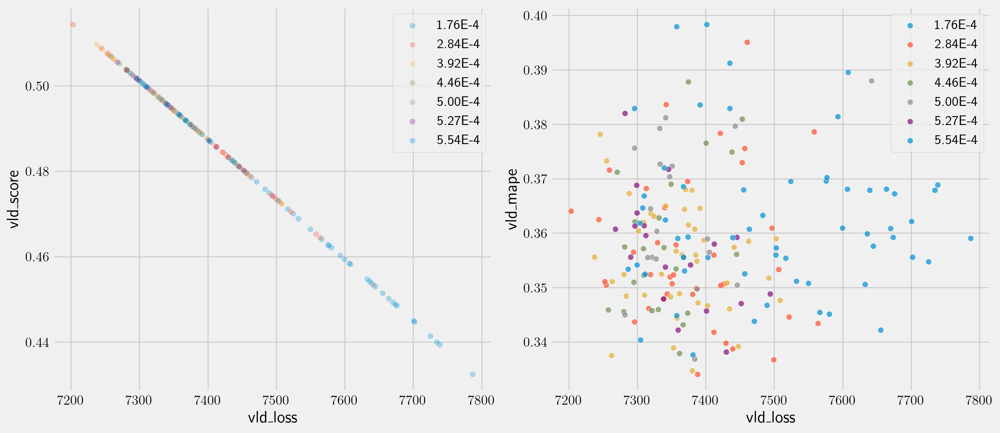

In [146]:
fig,axes = plt.subplots(1,2,figsize=(14,6))
init_lrs = sorted(df_whole.init_lr.unique())
colors = range(7)
for color,key in zip(colors,init_lrs):
  cond = df_whole['init_lr'] == key
  sns.scatterplot(data =df_whole[cond],x='vld_loss',y='vld_score',cmap='RdBu',label=f'{Decimal(key):.2E}',ax=axes[0],alpha=0.3)
  sns.scatterplot(data =df_whole[cond],x='vld_loss',y='vld_mape',cmap='RdBu',label=f'{Decimal(key):.2E}',ax=axes[1],alpha=0.7)



In [147]:
type(key)

numpy.float64

In [148]:
ax.xaxis.__dict__

{'_stale': False,
 'stale_callback': <function matplotlib.artist._stale_axes_callback(self, val)>,
 '_axes': <Axes: xlabel='init_lr', ylabel='best_epoch'>,
 '_parent_figure': <Figure size 2000x900 with 8 Axes>,
 '_transform': None,
 '_transformSet': False,
 '_visible': True,
 '_animated': False,
 '_alpha': None,
 'clipbox': <matplotlib.transforms.TransformedBbox at 0x786bdfda3750>,
 '_clippath': None,
 '_clipon': True,
 '_label': '',
 '_picker': None,
 '_rasterized': False,
 '_agg_filter': None,
 '_mouseover': False,
 '_callbacks': <matplotlib.cbook.CallbackRegistry at 0x786bdfd93350>,
 '_remove_method': None,
 '_url': None,
 '_gid': None,
 '_snap': None,
 '_sketch': None,
 '_path_effects': [],
 '_sticky_edges': _XYPair(x=[], y=[]),
 '_in_layout': True,
 '_remove_overlapping_locs': True,
 'isDefault_label': False,
 'major': <matplotlib.axis.Ticker at 0x786bdfd93490>,
 'minor': <matplotlib.axis.Ticker at 0x786bdfd934d0>,
 'callbacks': <matplotlib.cbook.CallbackRegistry at 0x786bdfd9d4d0

In [149]:
list(filter(lambda x : 'set' in x,axes[2].xaxis.get_majorticklabels()[0].__dir__()))

IndexError: index 2 is out of bounds for axis 0 with size 2

In [150]:
display(df_whole[['init_lr','epoch_r_mod','epoch_r']].value_counts().sort_index())
display(df_mode)

,,,count
init_lr,epoch_r_mod,epoch_r,
0.000176,481.645944,0.002328,35
0.000284,363.574413,0.002362,39
0.000392,284.141271,0.002396,41
0.000446,253.850616,0.002413,23
0.000500,228.157539,0.002431,19
0.000527,216.749722,0.002440,19
0.000554,206.176578,0.002449,24


,lr,0
0,0.000176,466.0
2,0.000284,379.0
3,0.000392,290.0
4,0.000446,243.0
1,0.000500,226.0
6,0.000527,218.0
5,0.000554,186.0


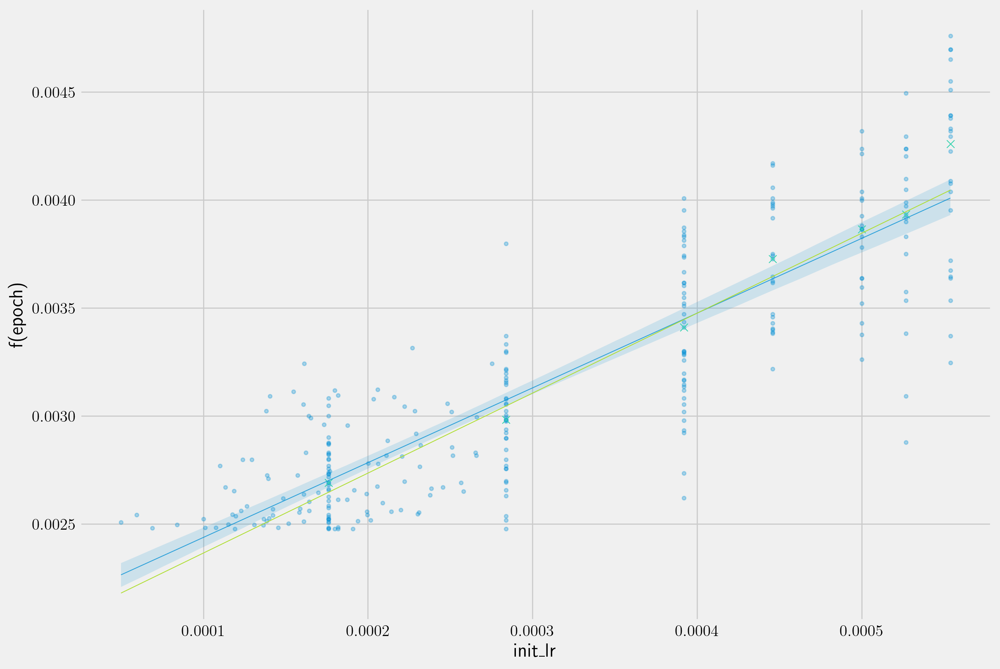

In [151]:
df_expt_whole = get_expt_whole_rslt_df(os.path.join(RSLT_DIR,'model_test'),'20480_')
coeff = (len(data_dict['trn']['X'])/20480)*60
df_expt_whole['f(epoch)'] = np.power(coeff * df_expt_whole['epoch'],-0.5)

fig,ax = plt.subplots(figsize=(12,8))
#sns.scatterplot(data=df_whole,x='init_lr',y='f(epoch)',alpha=0.3,s=10,ax=ax)
sns.regplot(data=df_expt_whole,x='init_lr',y='f(epoch)',scatter_kws={'alpha':0.3,'s':10},line_kws={'alpha':0.8,'lw':0.7},ax=ax);

x_epochr = np.linspace(df_expt_whole['init_lr'].min(),df_expt_whole['init_lr'].max(),300)
ax.plot(x_epochr,(x_epochr*a_mod+b_mod),color='#afde32',lw=0.7)
ax.scatter(df_mode.lr.to_numpy(),np.power(df_mode[0].to_numpy()*coeff,-0.5),lw=0.7,marker='x',s=45,color='#34d3af')

In [152]:
indx = epoch_r_mod(x_epochr)<520
lr_lwbnd = min(x_epochr[indx])

cond = df_expt_whole['init_lr'] >= lr_lwbnd
df_expt_bnded = df_expt_whole[cond]

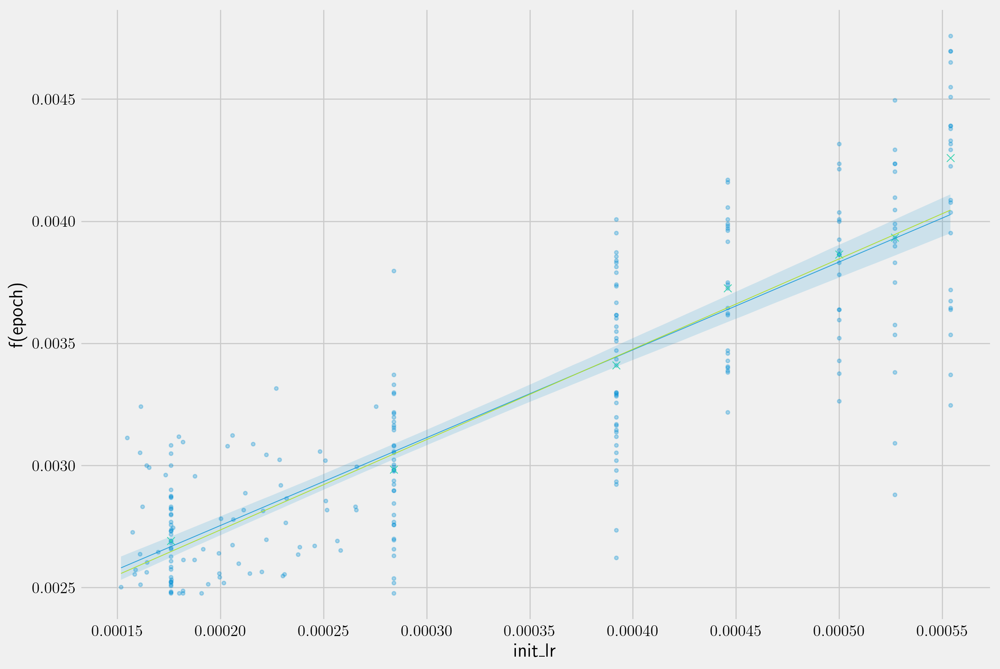

In [153]:
fig,ax = plt.subplots(figsize=(12,8))
#sns.scatterplot(data=df_whole,x='init_lr',y='f(epoch)',alpha=0.3,s=10,ax=ax)
sns.regplot(data=df_expt_bnded,x='init_lr',y='f(epoch)',scatter_kws={'alpha':0.3,'s':10},line_kws={'alpha':0.8,'lw':0.7},ax=ax);

x_epochr = np.linspace(df_expt_bnded['init_lr'].min(),df_expt_bnded['init_lr'].max(),300)
ax.plot(x_epochr,(x_epochr*a_mod+b_mod),color='#afde32',lw=0.7)
ax.scatter(df_mode.lr.to_numpy(),np.power(df_mode[0].to_numpy()*coeff,-0.5),lw=0.7,marker='x',s=45,color='#34d3af')

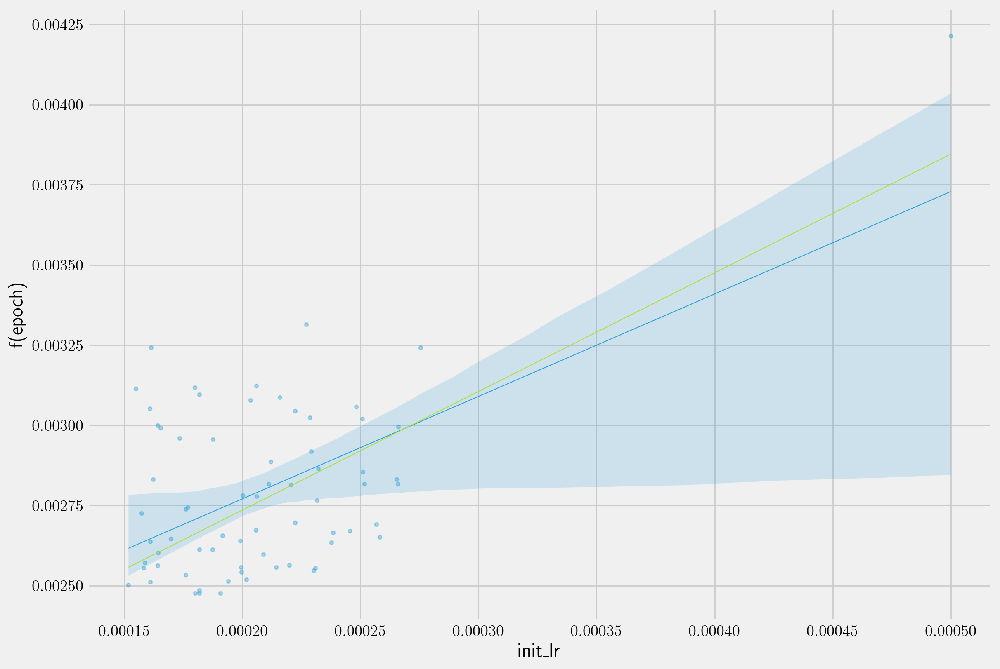

In [154]:
df_expt1 = get_expt_whole_rslt_df(os.path.join(RSLT_DIR,'model_test'),'20480_1')
coeff = (len(data_dict['trn']['X'])/20480)*60
df_expt1['f(epoch)'] = np.power(coeff * df_expt1['epoch'],-0.5)

cond = (lr_lwbnd <= df_expt1['init_lr']) #& (df_expt1['init_lr']<5e-4)
df_expt1_bnded = df_expt1[cond]

fig,ax = plt.subplots(figsize=(12,8))
#sns.scatterplot(data=df_whole,x='init_lr',y='f(epoch)',alpha=0.3,s=10,ax=ax)
sns.regplot(data=df_expt1_bnded,x='init_lr',y='f(epoch)',scatter_kws={'alpha':0.3,'s':10},line_kws={'alpha':0.8,'lw':0.7},ax=ax);

x_epochr = np.linspace(df_expt1_bnded['init_lr'].min(),df_expt1['init_lr'].max(),300)
ax.plot(x_epochr,(x_epochr*a_mod+b_mod),color='#afde32',lw=0.7)
#ax.scatter(df_mode.lr.to_numpy(),np.power(df_mode[0].to_numpy()*coeff,-0.5),lw=0.7,marker='x',s=45,color='#34d3af')

0.6932333377147784 65.42145261466815


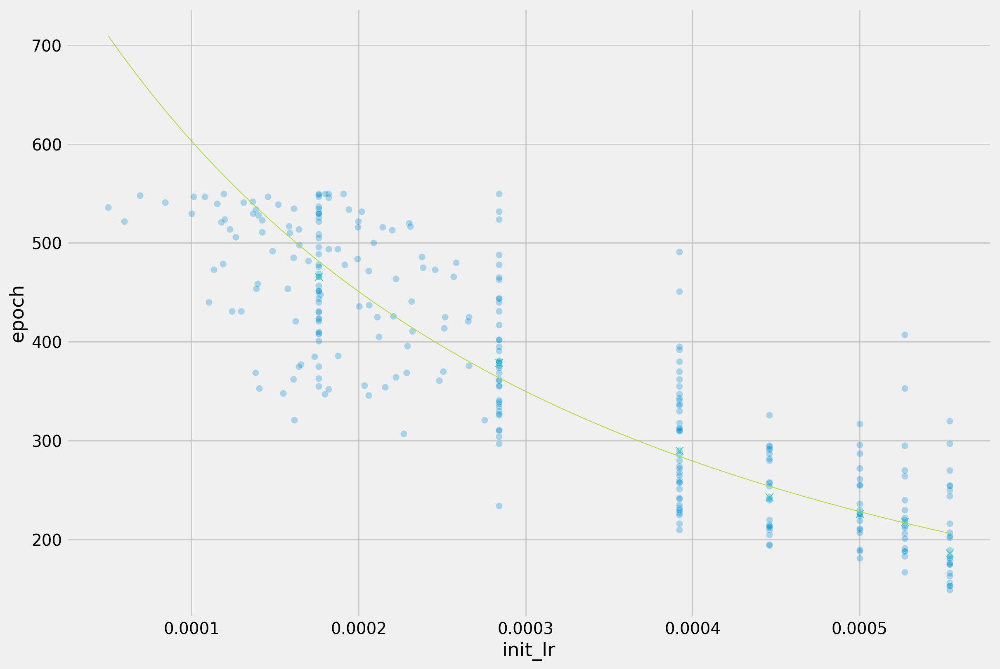

In [ ]:
df_expt_whole['epoch_r_mod'] = epoch_r_mod(df_expt_whole['init_lr'].values)
print(r2_score(df_expt_whole['epoch'],df_expt_whole['epoch_r_mod']), root_mean_squared_error(df_expt_whole['epoch'],df_expt_whole['epoch_r_mod']))

fig,ax = plt.subplots(figsize=(12,8))
sns.scatterplot(data=df_expt_whole,x='init_lr',y='epoch',alpha=0.3)

ind = df_expt_whole['init_lr'].drop_duplicates(keep='first').sort_values().index
x_epochr = np.linspace(df_expt_whole['init_lr'].min(),df_expt_whole['init_lr'].max(),300)
ax.plot(x_epochr,epoch_r_mod(x_epochr),color='#afde32',lw=0.7)
#ax.plot(df_expt_whole.loc[ind,'init_lr'],df_expt_whole.loc[ind,'epoch_r_mod'],color='#afde32',lw=0,marker='o',markersize=5)

ax.scatter(df_mode.lr.to_numpy(),df_mode[0].to_numpy(),lw=0.7,marker='x',s=45,color='#34d3af')

In [ ]:
test_n_plot(model,iter_dict['vld'],criterion,device) #gridsize 180
test_n_plot(model,iter_dict['vld'],criterion,device,scatter=False,gridsize=180)

NameError: name 'model' is not defined

In [ ]:
test_n_plot(model,iter_dict['tst'],criterion,device) #gridsize 350
test_n_plot(model,iter_dict['tst'],criterion,device,scatter=False,gridsize=350) #gridsize 350

In [ ]:
x = val_loss
plot_area(x,start=0,end=-1);
#plot_area(x,start=750,end=-1,log=False);

In [ ]:
x = train_loss
plot_area(x,start=0,end=-1);

In [ ]:
x = val_score
plot_area(x,False,start=0,end=-1,log=False);

# data box 2

# train, evaluate

In [ ]:
model, train_config, init_lr,save_dir,file_name = box_expt_config(2)
model,train_loss,val_loss,train_score,val_score,best_epoch = run(model,train_config,iter_dict_box[1]['trn'],iter_dict_box[1]['vld'],epoch,warmup,8500,save_dir,file_name[:-3])
torch.save(model,os.path.join(save_dir,file_name))
save_pkl(save_dir,'train_loss.pkl',train_loss)
save_pkl(save_dir,'valid_loss.pkl',val_loss)
save_pkl(save_dir,'valid_score.pkl',val_score)

The model has 11,852,587 trainable parameters
Epoch:     1		lr: 0.00008266
	Train Loss: 16032.707	Train Score: -2.851	Val Loss: 15926.162	Val Score: -2.839
Epoch:     2		lr: 0.00008266
	Train Loss: 15836.106	Train Score: -2.760	Val Loss: 15608.287	Val Score: -2.688
Epoch:     3		lr: 0.00008266
	Train Loss: 15451.237	Train Score: -2.582	Val Loss: 15080.171	Val Score: -2.444
Epoch:     4		lr: 0.00008266
	Train Loss: 14875.775	Train Score: -2.323	Val Loss: 14366.283	Val Score: -2.127
Epoch:     5		lr: 0.00008266
	Train Loss: 14131.655	Train Score: -2.001	Val Loss: 13499.520	Val Score: -1.763
Epoch:     6		lr: 0.00008266
	Train Loss: 13247.823	Train Score: -1.640	Val Loss: 12509.313	Val Score: -1.375
Epoch:     7		lr: 0.00008266
	Train Loss: 12254.234	Train Score: -1.260	Val Loss: 11435.630	Val Score: -0.987
Epoch:     8		lr: 0.00008266
	Train Loss: 11189.237	Train Score: -0.886	Val Loss: 10324.171	Val Score: -0.623
Epoch:     9		lr: 0.00008266
	Train Loss: 10115.093	Train Score: -0.542	Va

In [ ]:
model, train_config, init_lr,save_dir,file_name = box_expt_config(2)
init_lr *= (365/450)
model,train_loss,val_loss,train_score,val_score,best_epoch = run(model,train_config,iter_dict_box[1]['trn'],iter_dict_box[1]['vld'],epoch,warmup,8500,save_dir,file_name[:-3])
torch.save(model,os.path.join(save_dir,file_name))
save_pkl(save_dir,'train_loss.pkl',train_loss)
save_pkl(save_dir,'valid_loss.pkl',val_loss)
save_pkl(save_dir,'valid_score.pkl',val_score)

The model has 11,852,587 trainable parameters


/content/drive/MyDrive/kdt-EST-AI/project/project2/module_aladin/torch_train.py:164: FutureWarning: `nn.init.kaiming_uniform` is now deprecated in favor of `nn.init.kaiming_uniform_`.
  nn.init.kaiming_uniform(m.weight.data)
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Epoch:     1		lr: 0.00008266
	Train Loss: 16037.856	Train Score: -2.854	Val Loss: 15939.787	Val Score: -2.846
Epoch:     2		lr: 0.00008266
	Train Loss: 15849.734	Train Score: -2.766	Val Loss: 15636.926	Val Score: -2.702
Epoch:     3		lr: 0.00008266
	Train Loss: 15478.325	Train Score: -2.594	Val Loss: 15135.593	Val Score: -2.469
Epoch:     4		lr: 0.00008266
	Train Loss: 14929.329	Train Score: -2.346	Val Loss: 14463.107	Val Score: -2.169
Epoch:     5		lr: 0.00008266
	Train Loss: 14229.336	Train Score: -2.042	Val Loss: 13648.813	Val Score: -1.824
Epoch:     6		lr: 0.00008266
	Train Loss: 13400.066	Train Score: -1.700	Val Loss: 12714.636	Val Score: -1.453
Epoch:     7		lr: 0.00008266
	Train Loss: 12460.191	Train Score: -1.336	Val Loss: 11686.923	Val Score: -1.075
Epoch:     8		lr: 0.00008266
	Train Loss: 11438.243	Train Score: -0.970	Val Loss: 10605.330	Val Score: -0.711
Epoch:     9		lr: 0.00008266
	Train Loss: 10383.511	Train Score: -0.625	Val Loss: 9549.345	Val Score: -0.391
Epoch:    1

In [ ]:
model, train_config, init_lr,save_dir,file_name = box_expt_config(2)
init_lr *= (353/450) * (365/450)
model,train_loss,val_loss,train_score,val_score,best_epoch = run(model,train_config,iter_dict_box[1]['trn'],iter_dict_box[1]['vld'],epoch,warmup,8500,save_dir,file_name[:-3])
torch.save(model,os.path.join(save_dir,file_name))
save_pkl(save_dir,'train_loss.pkl',train_loss)
save_pkl(save_dir,'valid_loss.pkl',val_loss)
save_pkl(save_dir,'valid_score.pkl',val_score)

The model has 11,852,587 trainable parameters
Epoch:     1		lr: 0.00008266
	Train Loss: 16036.604	Train Score: -2.853	Val Loss: 15937.798	Val Score: -2.845
Epoch:     2		lr: 0.00008266
	Train Loss: 15852.568	Train Score: -2.767	Val Loss: 15644.949	Val Score: -2.706
Epoch:     3		lr: 0.00008266
	Train Loss: 15499.222	Train Score: -2.604	Val Loss: 15168.937	Val Score: -2.484
Epoch:     4		lr: 0.00008266
	Train Loss: 14975.594	Train Score: -2.367	Val Loss: 14520.588	Val Score: -2.194
Epoch:     5		lr: 0.00008266
	Train Loss: 14296.282	Train Score: -2.070	Val Loss: 13716.710	Val Score: -1.852
Epoch:     6		lr: 0.00008266
	Train Loss: 13473.591	Train Score: -1.729	Val Loss: 12776.395	Val Score: -1.476
Epoch:     7		lr: 0.00008266
	Train Loss: 12525.410	Train Score: -1.361	Val Loss: 11729.123	Val Score: -1.090
Epoch:     8		lr: 0.00008266
	Train Loss: 11483.109	Train Score: -0.986	Val Loss: 10624.210	Val Score: -0.717
Epoch:     9		lr: 0.00008266
	Train Loss: 10402.177	Train Score: -0.631	Va

In [ ]:
model, train_config, init_lr,save_dir,file_name = box_expt_config(2)
init_lr *= (best_epoch/450)* (353/450) * (365/450)
model,train_loss,val_loss,train_score,val_score,best_epoch = run(model,train_config,iter_dict_box[1]['trn'],iter_dict_box[1]['vld'],epoch,warmup,8500,save_dir,file_name[:-3])
torch.save(model,os.path.join(save_dir,file_name))
save_pkl(save_dir,'train_loss.pkl',train_loss)
save_pkl(save_dir,'valid_loss.pkl',val_loss)
save_pkl(save_dir,'valid_score.pkl',val_score)

The model has 11,852,587 trainable parameters
Epoch:     1		lr: 0.00008266
	Train Loss: 16043.966	Train Score: -2.857	Val Loss: 15955.930	Val Score: -2.854
Epoch:     2		lr: 0.00008266
	Train Loss: 15880.816	Train Score: -2.781	Val Loss: 15692.391	Val Score: -2.728
Epoch:     3		lr: 0.00008266
	Train Loss: 15553.001	Train Score: -2.628	Val Loss: 15242.965	Val Score: -2.518
Epoch:     4		lr: 0.00008266
	Train Loss: 15048.365	Train Score: -2.399	Val Loss: 14613.188	Val Score: -2.235
Epoch:     5		lr: 0.00008266
	Train Loss: 14380.815	Train Score: -2.107	Val Loss: 13828.092	Val Score: -1.898
Epoch:     6		lr: 0.00008266
	Train Loss: 13571.895	Train Score: -1.769	Val Loss: 12907.708	Val Score: -1.527
Epoch:     7		lr: 0.00008266
	Train Loss: 12643.585	Train Score: -1.405	Val Loss: 11881.396	Val Score: -1.144
Epoch:     8		lr: 0.00008266
	Train Loss: 11621.607	Train Score: -1.034	Val Loss: 10786.941	Val Score: -0.770
Epoch:     9		lr: 0.00008266
	Train Loss: 10553.868	Train Score: -0.678	Va

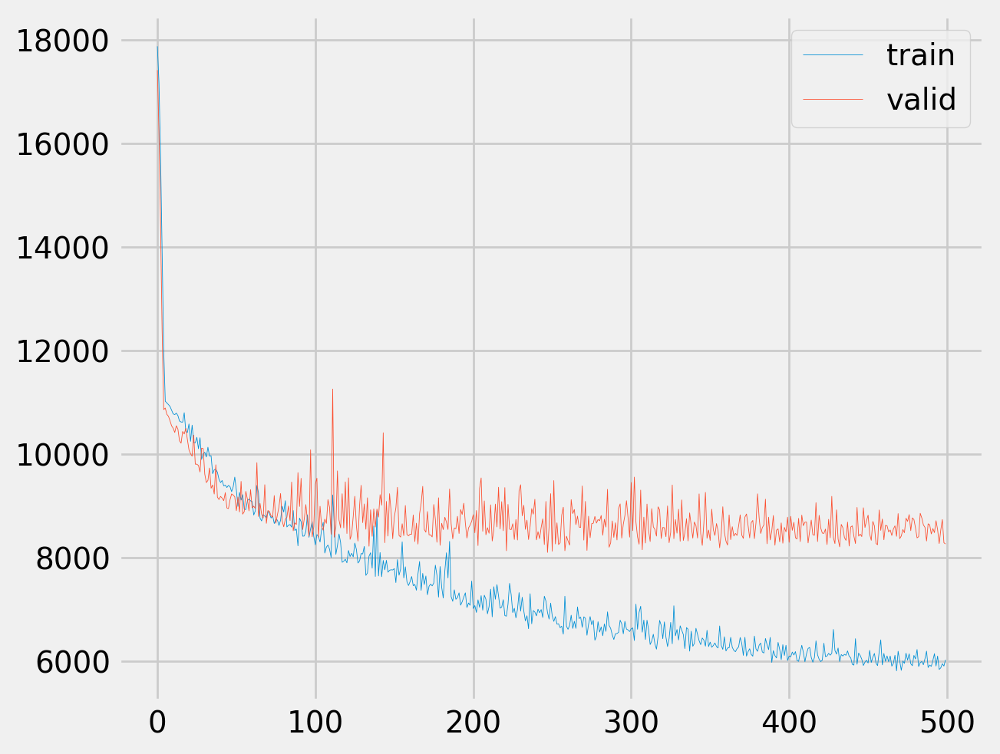

In [ ]:
train_loss = load_pkl(os.path.join(save_dir,'train_loss.pkl'))
valid_loss = load_pkl(os.path.join(save_dir,'valid_loss.pkl'))
valid_score = load_pkl(os.path.join(save_dir,'valid_score.pkl'))

loss_train = np.array(train_loss)
loss_valid = np.array(val_loss)

fig, ax = plt.subplots()

ax.plot(range(len(loss_train)),loss_train,label='train',lw=0.3)
ax.plot(range(len(loss_valid)),loss_valid,label='valid',lw=0.3)
#ax.set_yscale('log')
ax.legend();

In [ ]:
best_model = torch.load(os.path.join(save_dir,f'best_{file_name}'))
criterion = train_config[-2]

<ipython-input-45-1790dcb0272c>:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  best_model = torch.load(os.path.join(save_dir,f'best_{file_name}'))


6079.8402813029425 	r2 :  0.6872004866600037 	mape :  0.31050563


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


6079.8402813029425 	r2 :  0.6872004866600037 	mape :  0.31050563


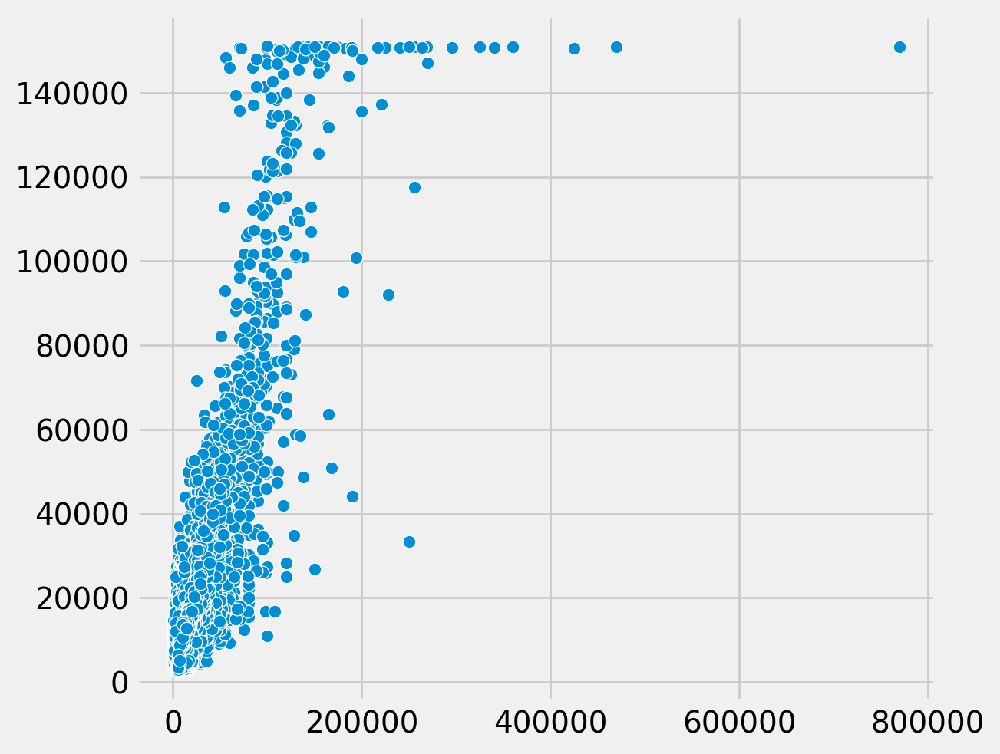

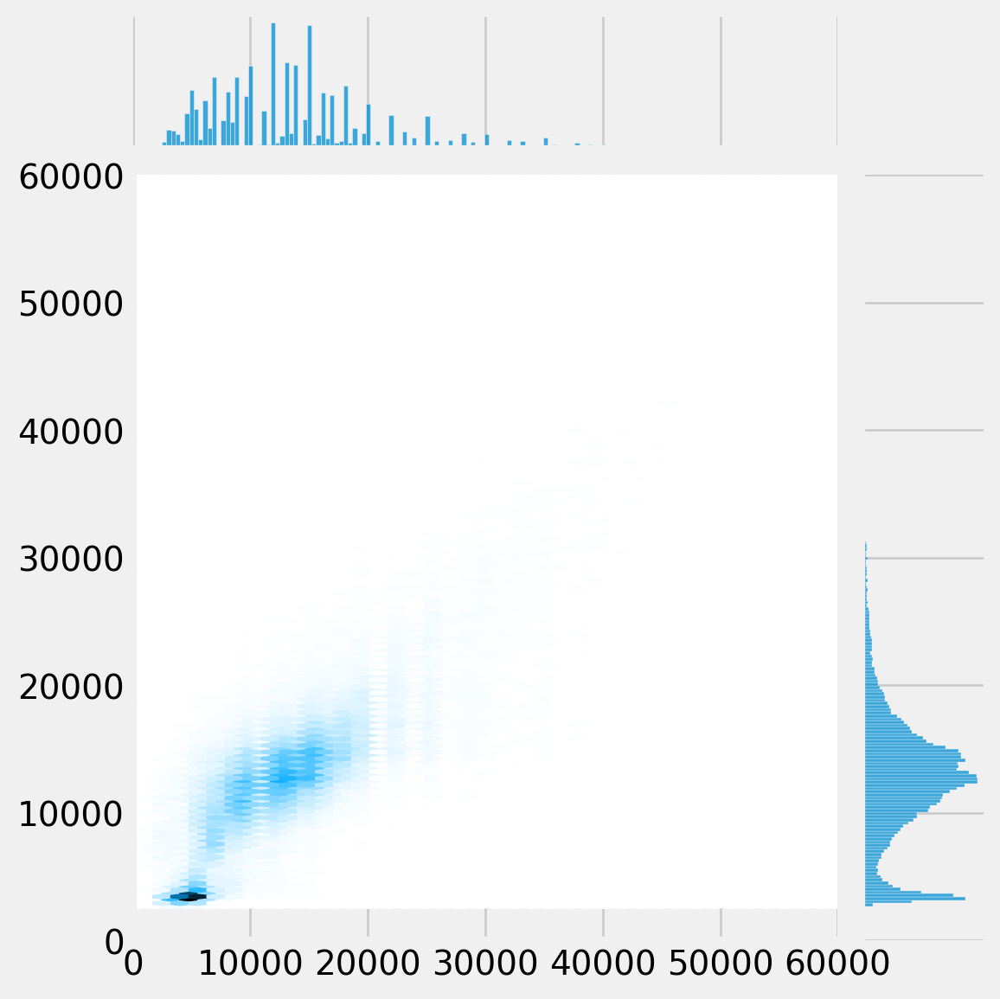

In [ ]:
test_n_plot(best_model,iter_dict['trn'],criterion,device) #gridsize 500
test_n_plot(best_model,iter_dict['trn'],criterion,device,scatter=False,gridsize=500) #gridsize 500

8099.6480787747805 	r2 :  0.48702794313430786 	mape :  0.3616164


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8099.6480787747805 	r2 :  0.48702794313430786 	mape :  0.3616164


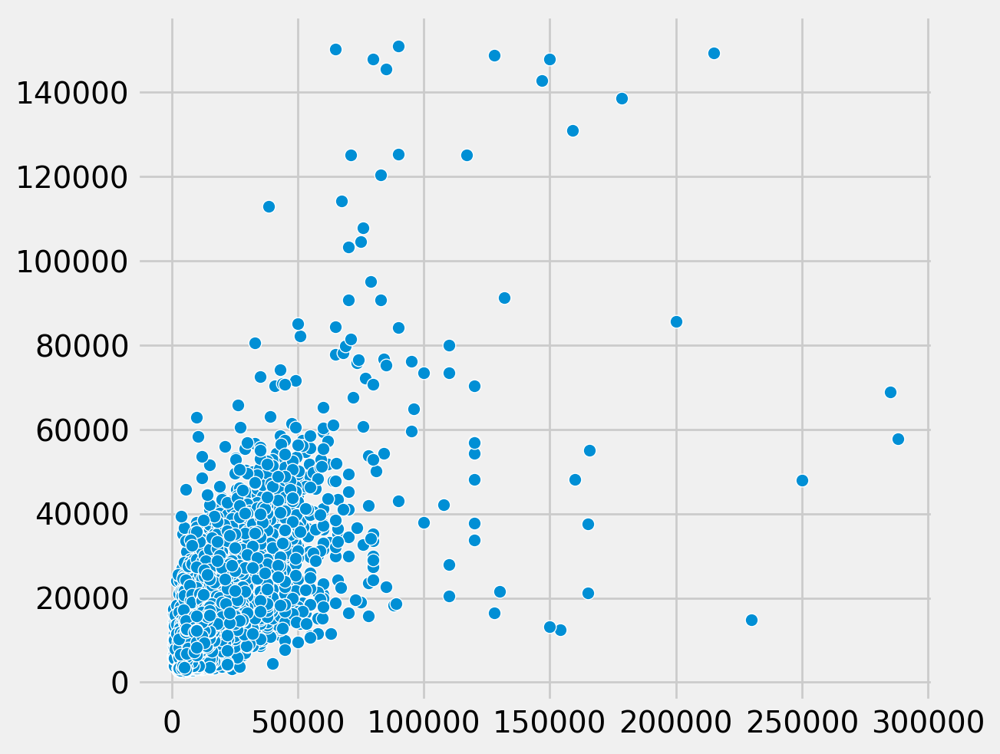

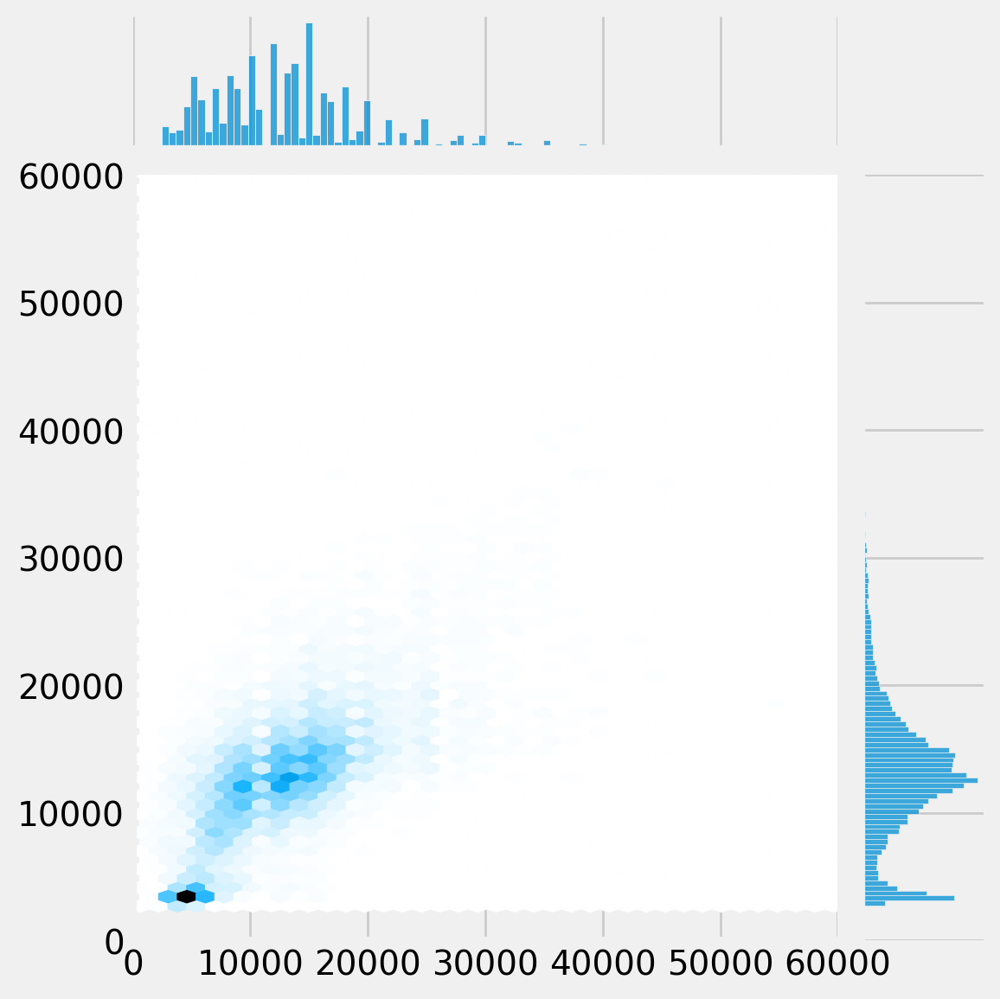

In [ ]:
test_n_plot(best_model,iter_dict['vld'],criterion,device) #gridsize 180
test_n_plot(best_model,iter_dict['vld'],criterion,device,scatter=False,gridsize=180) #gridsize 180

8483.909829789565 	r2 :  0.4573727250099182 	mape :  0.3639279


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8483.909829789565 	r2 :  0.4573727250099182 	mape :  0.3639279


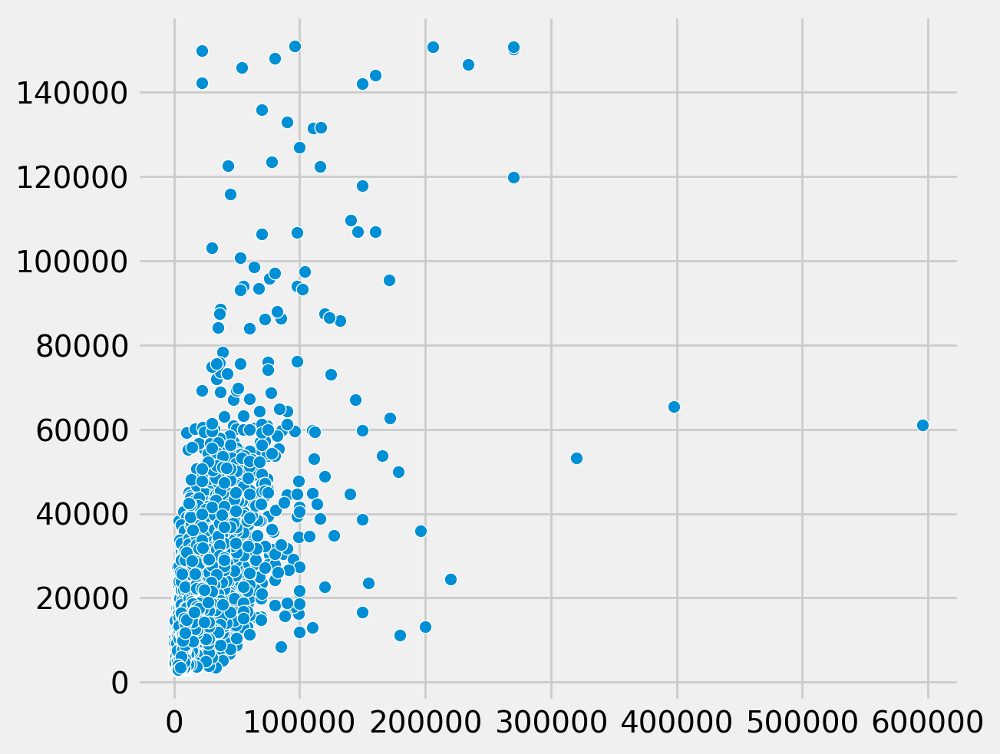

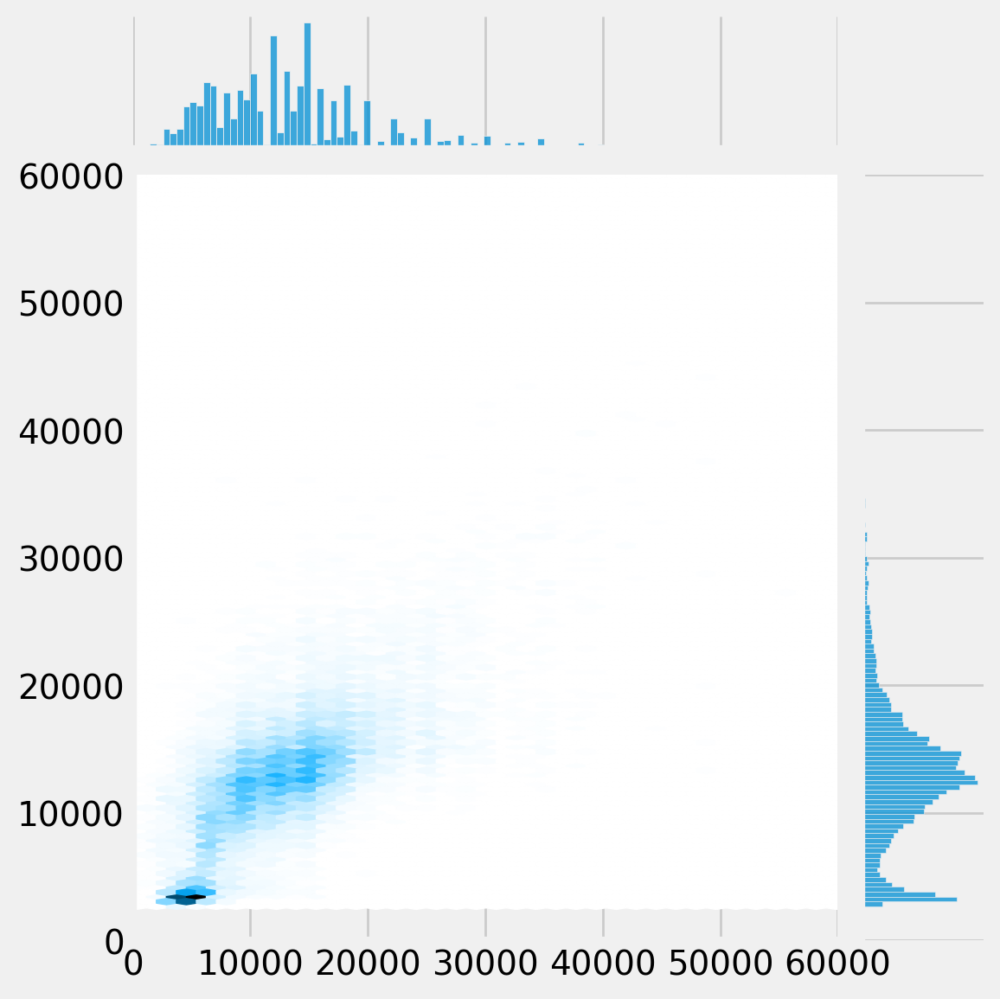

In [ ]:
test_n_plot(best_model,iter_dict['tst'],criterion,device) #gridsize 350
test_n_plot(best_model,iter_dict['tst'],criterion,device,scatter=False,gridsize=350) #gridsize 350

5421.616094572086 	r2 :  0.7526980638504028 	mape :  0.28877568


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


5421.616094572086 	r2 :  0.7526980638504028 	mape :  0.28877568


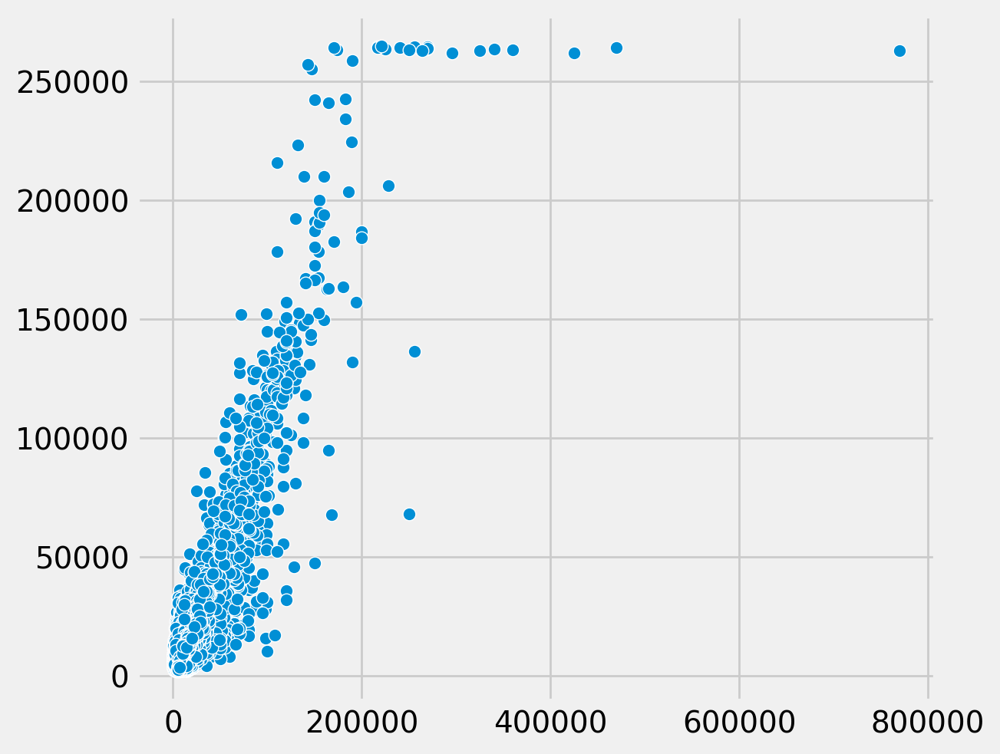

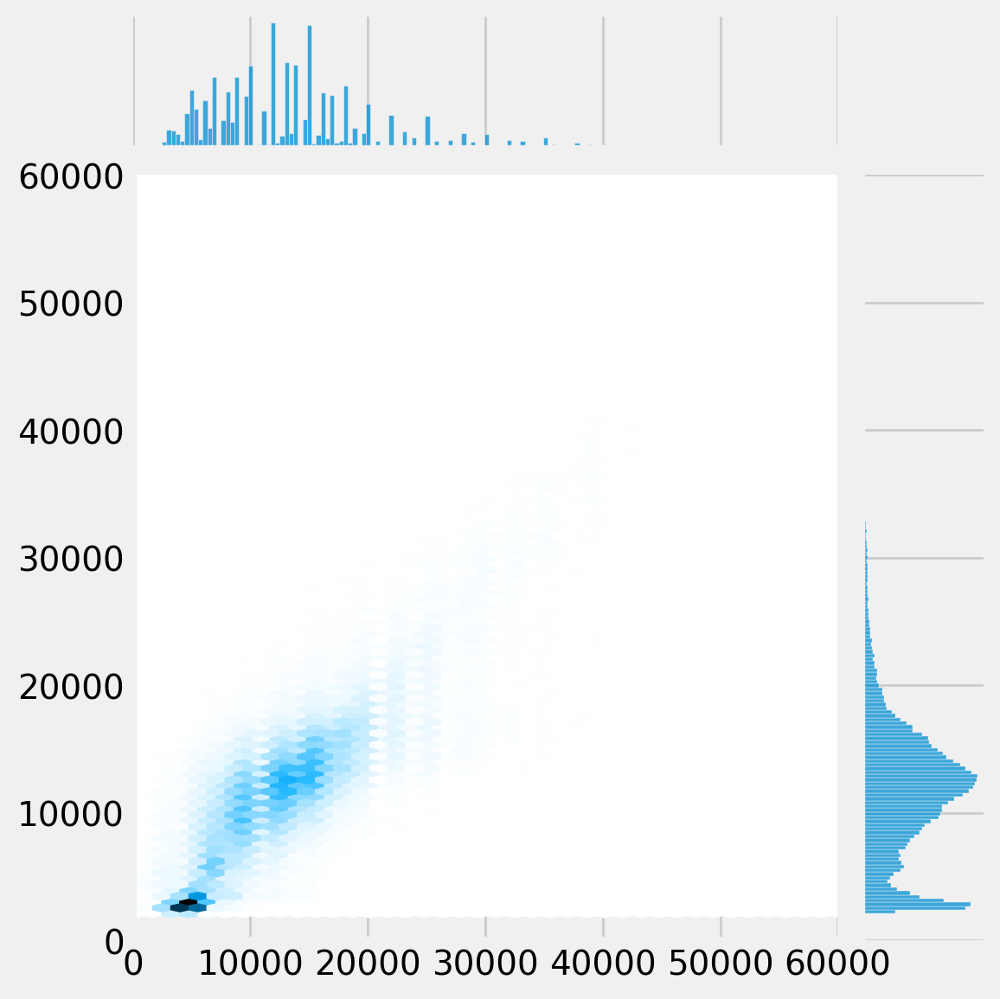

In [ ]:
test_n_plot(model,iter_dict['trn'],criterion,device) #gridsize 500
test_n_plot(model,iter_dict['trn'],criterion,device,scatter=False,gridsize=500) #gridsize 500

8262.704762969568 	r2 :  0.4583730101585388 	mape :  0.35924602


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8262.704762969568 	r2 :  0.4583730101585388 	mape :  0.35924602


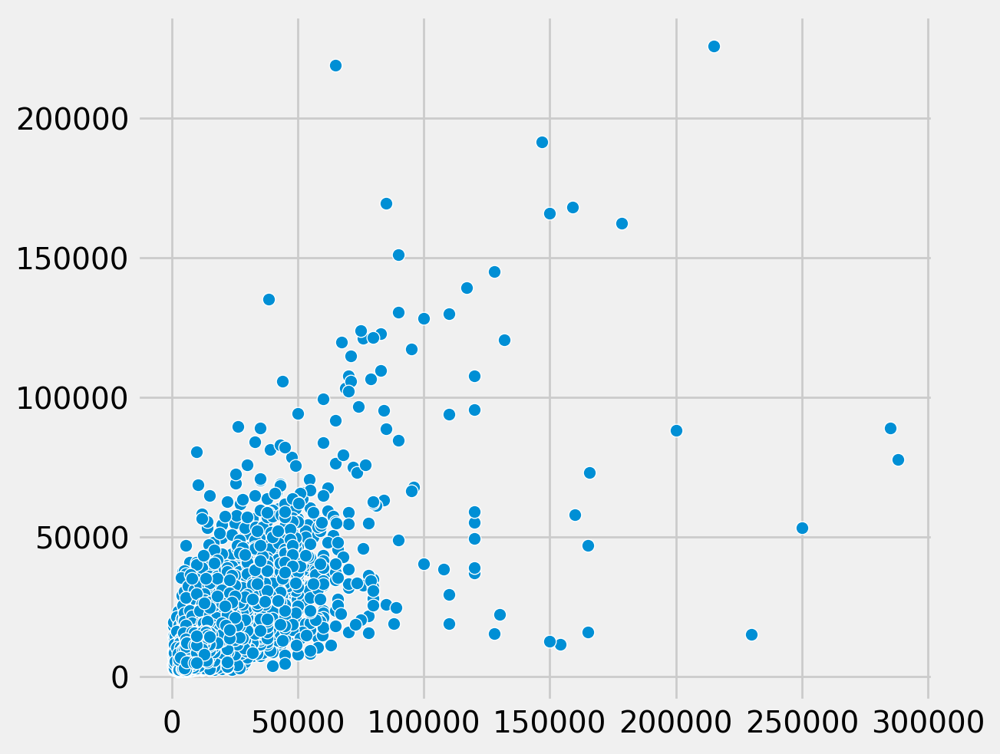

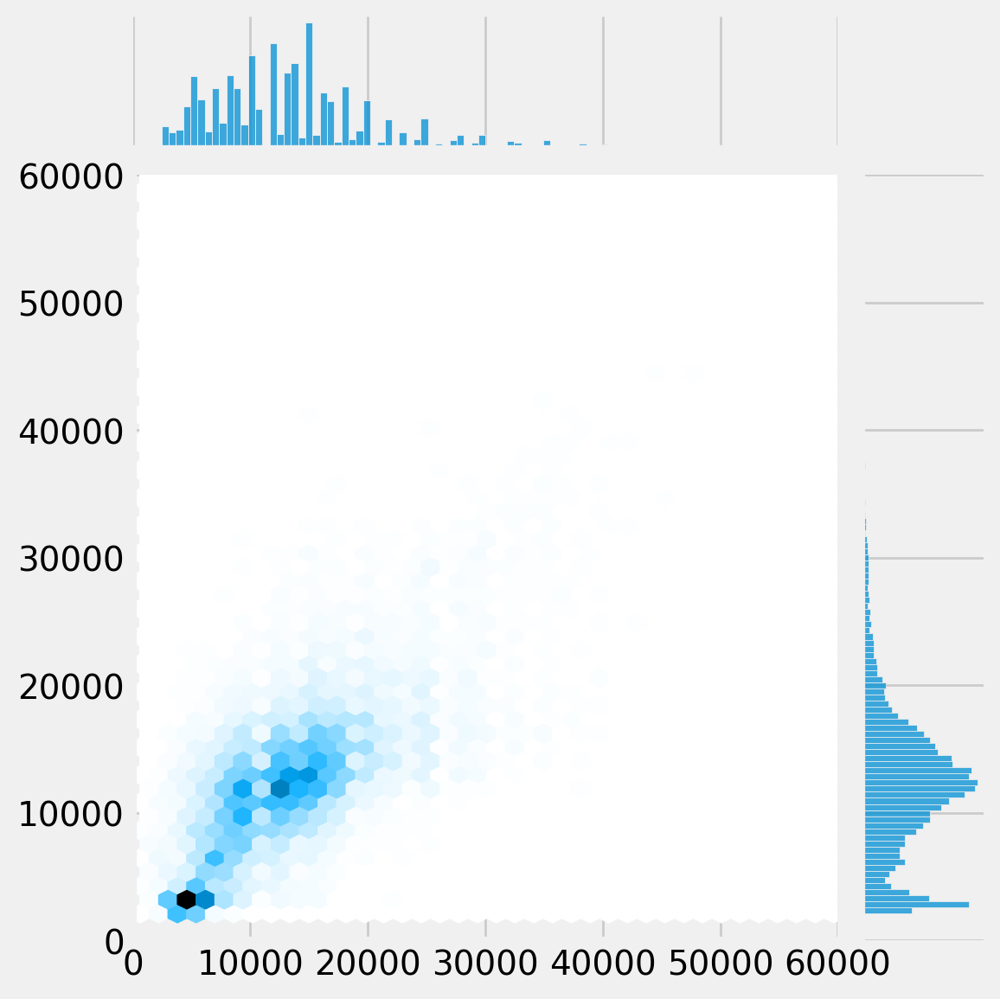

In [ ]:
test_n_plot(model,iter_dict['vld'],criterion,device) #gridsize 180
test_n_plot(model,iter_dict['vld'],criterion,device,scatter=False,gridsize=180)

8606.021670899976 	r2 :  0.4417092204093933 	mape :  0.359285


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8606.021670899976 	r2 :  0.4417092204093933 	mape :  0.359285


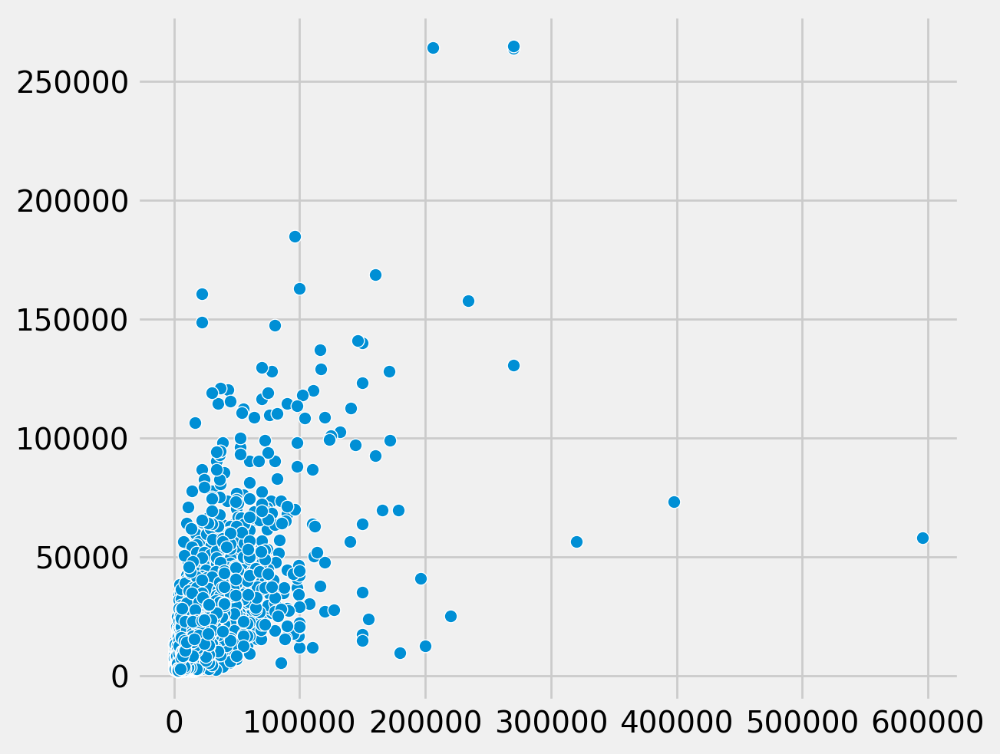

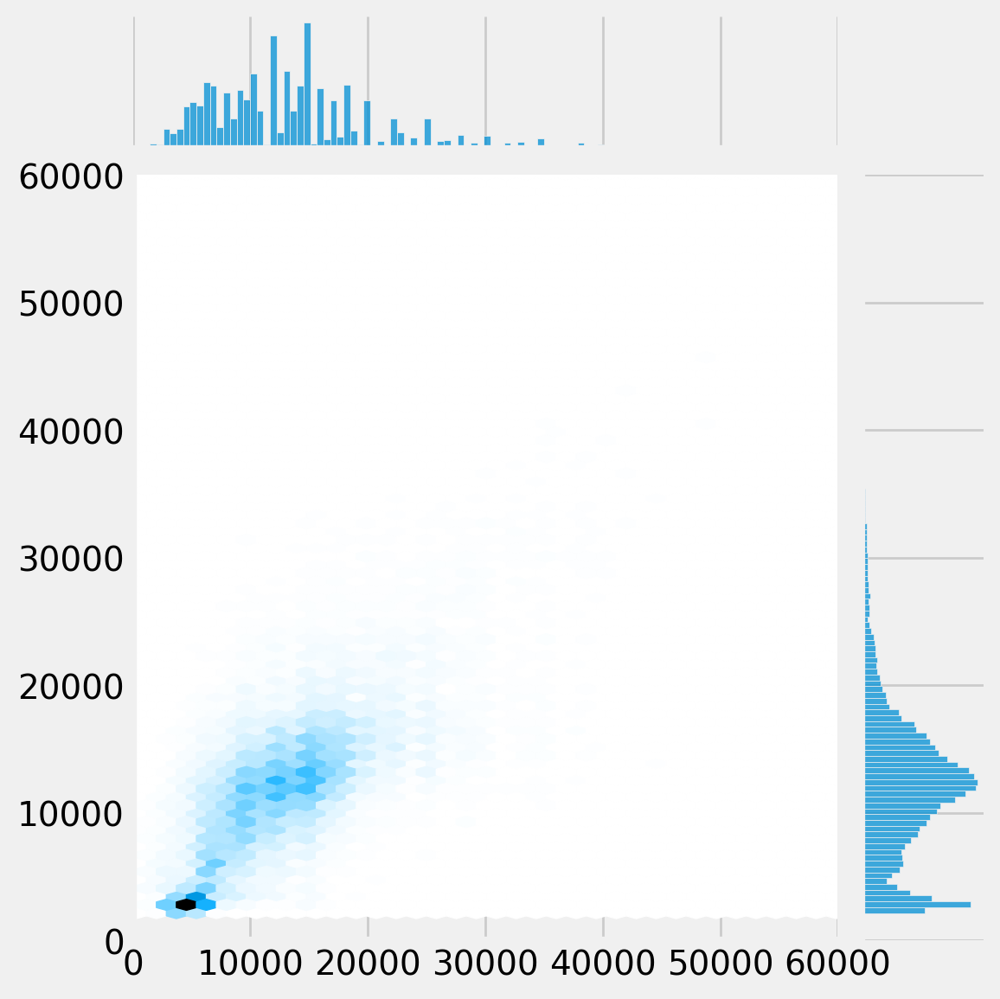

In [ ]:
test_n_plot(model,iter_dict['tst'],criterion,device) #gridsize 350
test_n_plot(model,iter_dict['tst'],criterion,device,scatter=False,gridsize=350) #gridsize 350

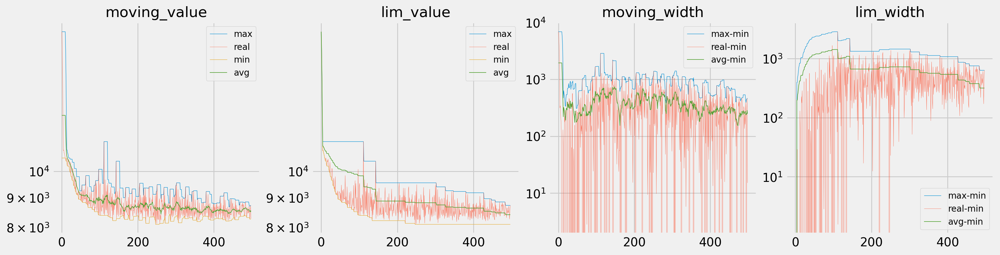

In [ ]:
x = val_loss
plot_area(x,start=0,end=-1);
#plot_area(x,start=750,end=-1,log=False);

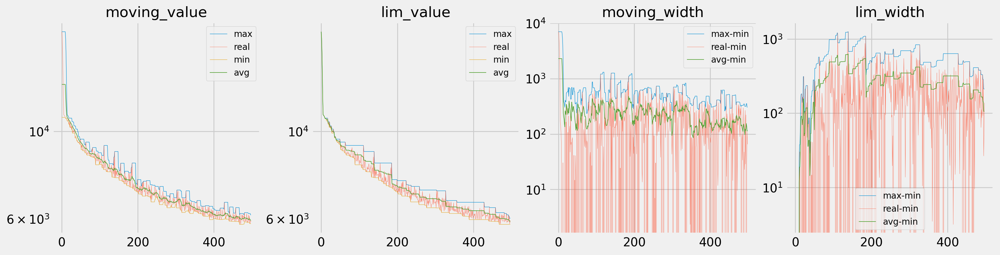

In [ ]:
x = train_loss
plot_area(x,start=0,end=-1);

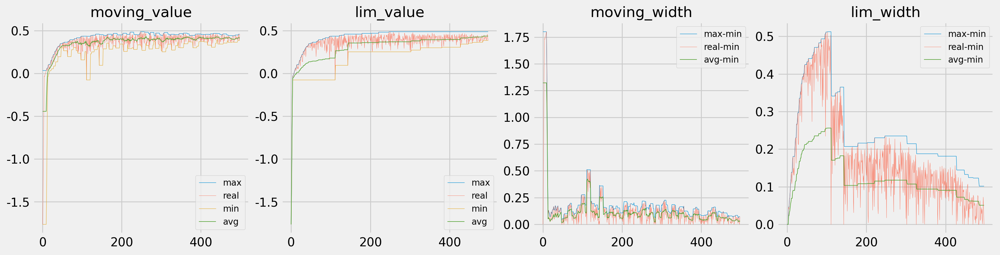

In [ ]:
x = val_score
plot_area(x,False,start=0,end=-1,log=False);

# data box 3

# train, evaluate

In [ ]:
model, train_config, init_lr,save_dir,file_name = box_expt_config(3)
model,train_loss,val_loss,train_score,val_score,best_epoch = run(model,train_config,iter_dict_box[1]['trn'],iter_dict_box[1]['vld'],epoch,warmup,8500,save_dir,file_name[:-3])
torch.save(model,os.path.join(save_dir,file_name))
save_pkl(save_dir,'train_loss.pkl',train_loss)
save_pkl(save_dir,'valid_loss.pkl',val_loss)
save_pkl(save_dir,'valid_score.pkl',val_score)

The model has 11,852,587 trainable parameters
Epoch:     1		lr: 0.00008425
	Train Loss: 16037.955	Train Score: -2.854	Val Loss: 15939.502	Val Score: -2.846
Epoch:     2		lr: 0.00008425
	Train Loss: 15855.209	Train Score: -2.769	Val Loss: 15645.640	Val Score: -2.706
Epoch:     3		lr: 0.00008425
	Train Loss: 15499.601	Train Score: -2.604	Val Loss: 15158.708	Val Score: -2.480


KeyboardInterrupt: 

In [ ]:
model, train_config, init_lr,save_dir,file_name = box_expt_config(3)
init_lr *= (391/450)
model,train_loss,val_loss,train_score,val_score,best_epoch = run(model,train_config,iter_dict_box[1]['trn'],iter_dict_box[1]['vld'],epoch,warmup,8500,save_dir,file_name[:-3])
torch.save(model,os.path.join(save_dir,file_name))
save_pkl(save_dir,'train_loss.pkl',train_loss)
save_pkl(save_dir,'valid_loss.pkl',val_loss)
save_pkl(save_dir,'valid_score.pkl',val_score)

The model has 11,852,587 trainable parameters
Epoch:     1		lr: 0.00008425
	Train Loss: 16037.185	Train Score: -2.854	Val Loss: 15937.355	Val Score: -2.845
Epoch:     2		lr: 0.00008425
	Train Loss: 15850.333	Train Score: -2.767	Val Loss: 15635.160	Val Score: -2.701
Epoch:     3		lr: 0.00008425
	Train Loss: 15486.098	Train Score: -2.598	Val Loss: 15141.165	Val Score: -2.472
Epoch:     4		lr: 0.00008425
	Train Loss: 14948.232	Train Score: -2.355	Val Loss: 14475.010	Val Score: -2.174
Epoch:     5		lr: 0.00008425
	Train Loss: 14256.850	Train Score: -2.054	Val Loss: 13665.026	Val Score: -1.831
Epoch:     6		lr: 0.00008425
	Train Loss: 13432.604	Train Score: -1.713	Val Loss: 12723.813	Val Score: -1.456
Epoch:     7		lr: 0.00008425
	Train Loss: 12491.106	Train Score: -1.348	Val Loss: 11687.452	Val Score: -1.075
Epoch:     8		lr: 0.00008425
	Train Loss: 11461.972	Train Score: -0.979	Val Loss: 10597.133	Val Score: -0.709
Epoch:     9		lr: 0.00008425
	Train Loss: 10397.351	Train Score: -0.629	Va

In [ ]:
model, train_config, init_lr,save_dir,file_name = box_expt_config(3)
init_lr *= (395/450) * (391/450)
model,train_loss,val_loss,train_score,val_score,best_epoch = run(model,train_config,iter_dict_box[1]['trn'],iter_dict_box[1]['vld'],epoch,warmup,8500,save_dir,file_name[:-3])
torch.save(model,os.path.join(save_dir,file_name))
save_pkl(save_dir,'train_loss.pkl',train_loss)
save_pkl(save_dir,'valid_loss.pkl',val_loss)
save_pkl(save_dir,'valid_score.pkl',val_score)

The model has 11,852,587 trainable parameters
Epoch:     1		lr: 0.00008425
	Train Loss: 16038.438	Train Score: -2.854	Val Loss: 15938.736	Val Score: -2.845
Epoch:     2		lr: 0.00008425
	Train Loss: 15853.203	Train Score: -2.768	Val Loss: 15635.549	Val Score: -2.701
Epoch:     3		lr: 0.00008425
	Train Loss: 15486.341	Train Score: -2.598	Val Loss: 15128.526	Val Score: -2.466
Epoch:     4		lr: 0.00008425
	Train Loss: 14933.152	Train Score: -2.348	Val Loss: 14439.569	Val Score: -2.159
Epoch:     5		lr: 0.00008425
	Train Loss: 14215.678	Train Score: -2.036	Val Loss: 13595.926	Val Score: -1.802
Epoch:     6		lr: 0.00008425
	Train Loss: 13355.918	Train Score: -1.682	Val Loss: 12620.300	Val Score: -1.417
Epoch:     7		lr: 0.00008425
	Train Loss: 12376.783	Train Score: -1.306	Val Loss: 11546.471	Val Score: -1.026
Epoch:     8		lr: 0.00008425
	Train Loss: 11313.046	Train Score: -0.928	Val Loss: 10424.905	Val Score: -0.654
Epoch:     9		lr: 0.00008425
	Train Loss: 10224.113	Train Score: -0.576	Va

In [ ]:
model, train_config, init_lr,save_dir,file_name = box_expt_config(3)
init_lr *= (best_epoch/450) * (395/450) * (391/450)
model,train_loss,val_loss,train_score,val_score,best_epoch = run(model,train_config,iter_dict_box[1]['trn'],iter_dict_box[1]['vld'],epoch,warmup,8500,save_dir,file_name[:-3])
torch.save(model,os.path.join(save_dir,file_name))
save_pkl(save_dir,'train_loss.pkl',train_loss)
save_pkl(save_dir,'valid_loss.pkl',val_loss)
save_pkl(save_dir,'valid_score.pkl',val_score)

The model has 11,852,587 trainable parameters
Epoch:     1		lr: 0.00008425
	Train Loss: 16038.071	Train Score: -2.854	Val Loss: 15940.042	Val Score: -2.846
Epoch:     2		lr: 0.00008425
	Train Loss: 15853.134	Train Score: -2.768	Val Loss: 15645.513	Val Score: -2.706
Epoch:     3		lr: 0.00008425
	Train Loss: 15494.115	Train Score: -2.601	Val Loss: 15162.412	Val Score: -2.481
Epoch:     4		lr: 0.00008425
	Train Loss: 14961.391	Train Score: -2.360	Val Loss: 14503.952	Val Score: -2.187
Epoch:     5		lr: 0.00008425
	Train Loss: 14272.222	Train Score: -2.060	Val Loss: 13689.024	Val Score: -1.841
Epoch:     6		lr: 0.00008425
	Train Loss: 13439.944	Train Score: -1.716	Val Loss: 12739.658	Val Score: -1.462
Epoch:     7		lr: 0.00008425
	Train Loss: 12484.377	Train Score: -1.346	Val Loss: 11683.606	Val Score: -1.074
Epoch:     8		lr: 0.00008425
	Train Loss: 11435.822	Train Score: -0.970	Val Loss: 10569.112	Val Score: -0.700
Epoch:     9		lr: 0.00008425
	Train Loss: 10350.427	Train Score: -0.615	Va

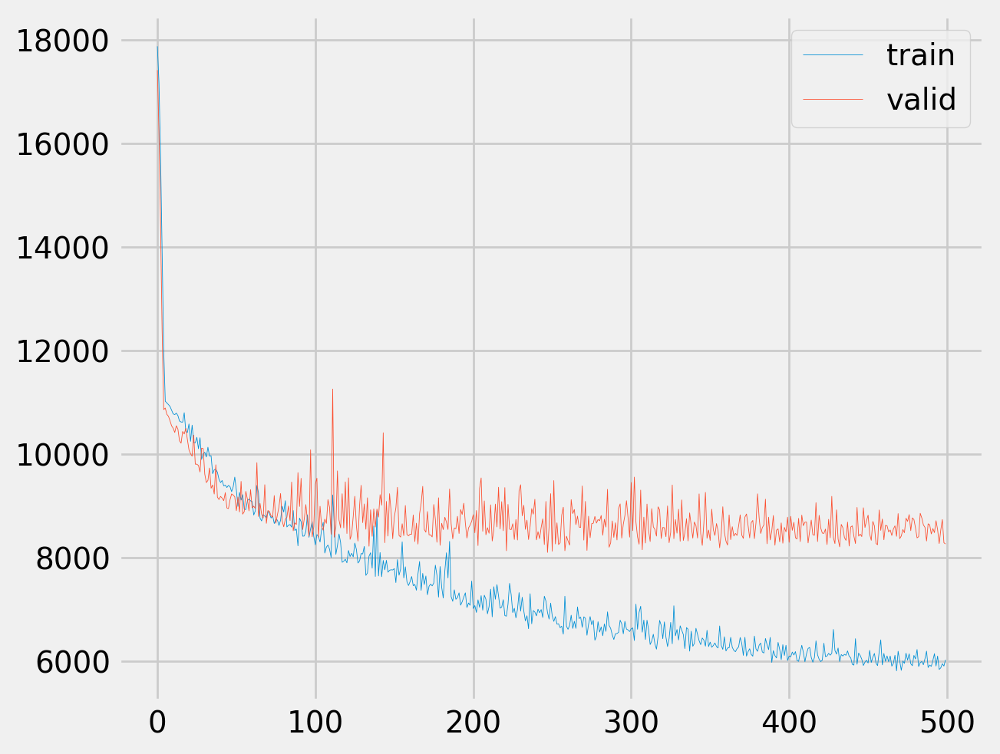

In [ ]:
train_loss = load_pkl(os.path.join(save_dir,'train_loss.pkl'))
valid_loss = load_pkl(os.path.join(save_dir,'valid_loss.pkl'))
valid_score = load_pkl(os.path.join(save_dir,'valid_score.pkl'))

loss_train = np.array(train_loss)
loss_valid = np.array(val_loss)

fig, ax = plt.subplots()

ax.plot(range(len(loss_train)),loss_train,label='train',lw=0.3)
ax.plot(range(len(loss_valid)),loss_valid,label='valid',lw=0.3)
#ax.set_yscale('log')
ax.legend();

#### TEST

In [ ]:
total_model_path = os.path.join(RSLT_DIR,'model/model4.5_8192_500_N6_lr0.000082','best_model_241115.pt')

In [ ]:
model, train_config, init_lr,save_dir,file_name = box_expt_config(3)
best_model = torch.load(os.path.join(save_dir,f'best_{file_name}'))
total_model = torch.load(total_model_path)
criterion = train_config[-2]

The model has 11,852,587 trainable parameters


/content/drive/MyDrive/kdt-EST-AI/project/project2/module_aladin/torch_train.py:175: FutureWarning: `nn.init.kaiming_uniform` is now deprecated in favor of `nn.init.kaiming_uniform_`.
  nn.init.kaiming_uniform(m.weight.data)
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
<ipython-input-44-ff201c90abf1>:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to b

4160.324987305679 	r2 :  -0.486175537109375 	mape :  0.24889141


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


4160.324987305679 	r2 :  -0.486175537109375 	mape :  0.24889141


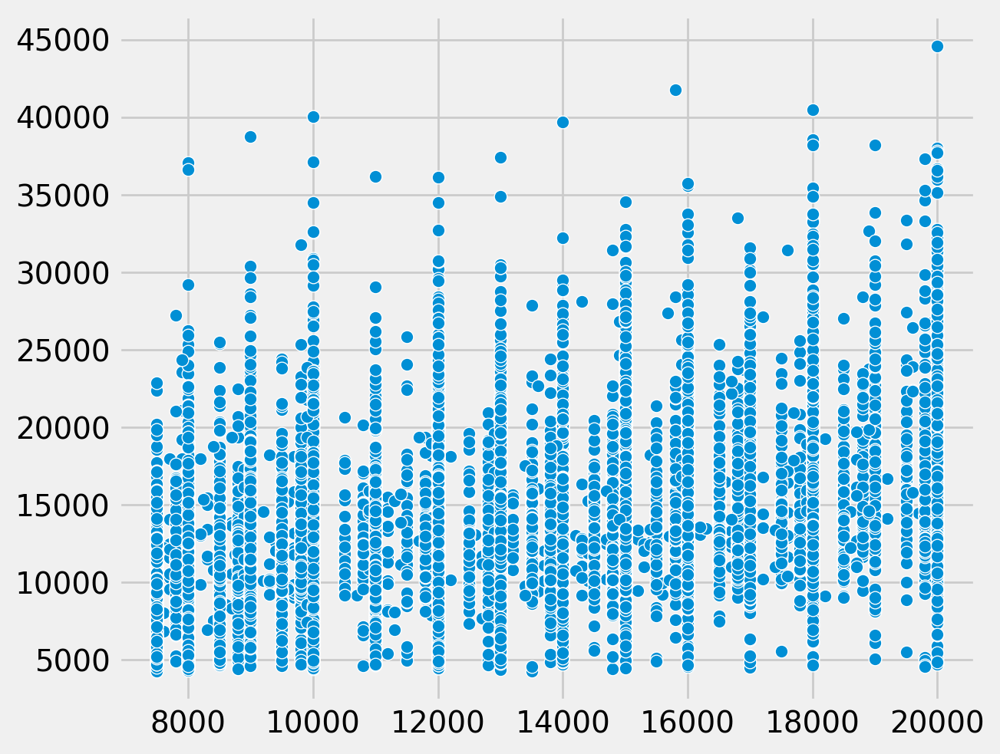

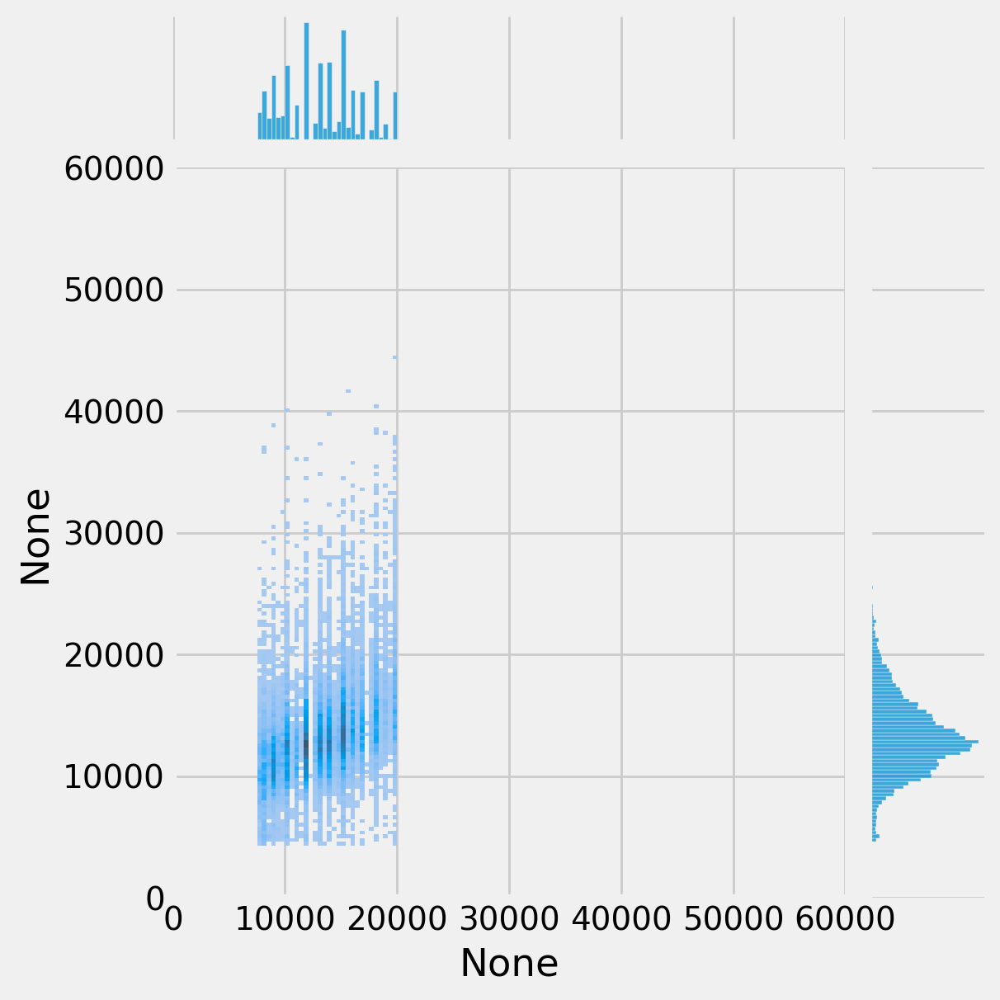

In [ ]:
test_n_plot(best_model,iter_dict_box[7]['tst'],criterion,device) #gridsize 500
test_n_plot(best_model,iter_dict_box[7]['tst'],criterion,device,scatter=False) #gridsize 500

In [ ]:
y_pred,y_true=get_test_rslt(best_model,iter_dict_box[7]['tst'],criterion,device) #gridsize 500
val1 = (y_pred-np.mean(y_true))*(y_pred+np.mean(y_true)-2*y_true)/(np.mean((y_true-np.mean(y_true))**2))
val2 = (y_true-np.mean(y_true))*(y_true+np.mean(y_true)-2*y_true)/(np.mean((y_true-np.mean(y_true))**2))
val_best = val1-val2
#sns.histplot(val_best)
#sns.jointplot(x=y_true,y=val_best,kind='hist',bins=300,ylim=(0,15),cbar=True)
np.mean(1-val_best)

-0.4861754

In [ ]:
y_pred,y_true=get_test_rslt(total_model,iter_dict_box[7]['tst'],criterion,device) #gridsize 500
val1 = (y_pred-np.mean(y_true))*(y_pred+np.mean(y_true)-2*y_true)/(np.mean((y_true-np.mean(y_true))**2))
val2 = (y_true-np.mean(y_true))*(y_true+np.mean(y_true)-2*y_true)/(np.mean((y_true-np.mean(y_true))**2))
val_total = val1-val2
#sns.histplot(val_total)
#sns.jointplot(x=y_true,y=val_total,kind='hist',bins=300,ylim=(0,15),cbar=True)
np.mean(1-val_total)

-0.4380049

<Axes: xlabel='val', ylabel='Count'>

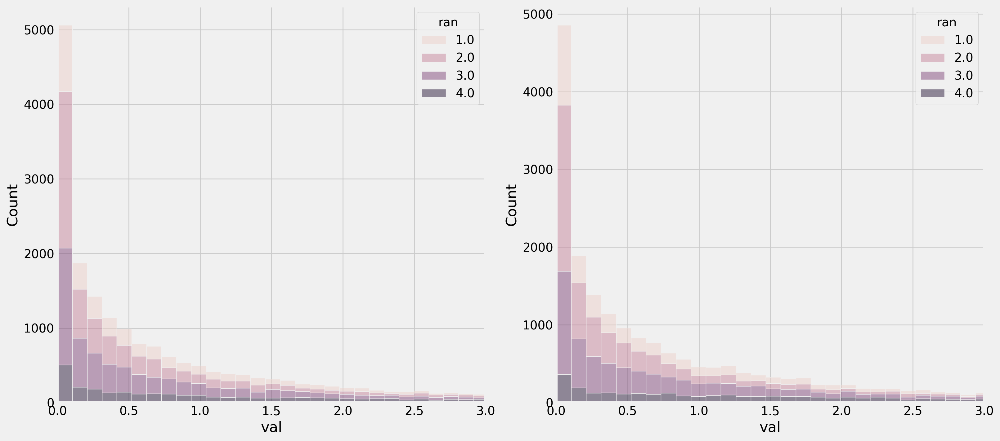

In [ ]:
ran = (y_true-3000)//3500
fig,ax=plt.subplots(1,2,figsize=(16,7))
ax[0].set_xlim(0,3)
ax[1].set_xlim(0,3)
data1 = {'val':val_best,'ran':ran}
data2 = {'val':val_total,'ran':ran}
sns.histplot(data=data1,x='val',hue='ran',alpha=0.5,ax=ax[0],multiple='stack')
sns.histplot(data=data2,x='val',hue='ran',alpha=0.5,ax=ax[1],multiple='stack')

In [ ]:
print(np.min(val_best),np.max(val_best))
print(np.min(val_total),np.max(val_total))

-2.3841858e-07 77.42485
-9.536743e-07 81.29799


In [ ]:
y_pred,y_true=get_test_rslt(best_model,iter_dict_box[3]['tst'],criterion,device) #gridsize 500
val1 = (y_pred-np.mean(y_true))*(y_pred+np.mean(y_true)-2*y_true)/(np.mean((y_true-np.mean(y_true))**2))
val2 = (y_true-np.mean(y_true))*(y_true+np.mean(y_true)-2*y_true)/(np.mean((y_true-np.mean(y_true))**2))
val_best = val1-val2
#sns.histplot(val_best)
#sns.jointplot(x=y_true,y=val_best,kind='hist',bins=300,ylim=(0,15),cbar=True)
y_true1 = y_true
np.mean(1-val_best)

0.49826893

In [ ]:
y_pred,y_true=get_test_rslt(best_model,iter_dict_box[7]['tst'],criterion,device) #gridsize 500
val1 = (y_pred-np.mean(y_true))*(y_pred+np.mean(y_true)-2*y_true)/(np.mean((y_true-np.mean(y_true))**2))
val2 = (y_true-np.mean(y_true))*(y_true+np.mean(y_true)-2*y_true)/(np.mean((y_true-np.mean(y_true))**2))
val_part= val1-val2
#sns.histplot(val_total)
#sns.jointplot(x=y_true,y=val_total,kind='hist',bins=300,ylim=(0,15),cbar=True)
y_true2 = y_true
np.mean(1-val_part)

-0.4861754

<Axes: xlabel='val', ylabel='Count'>

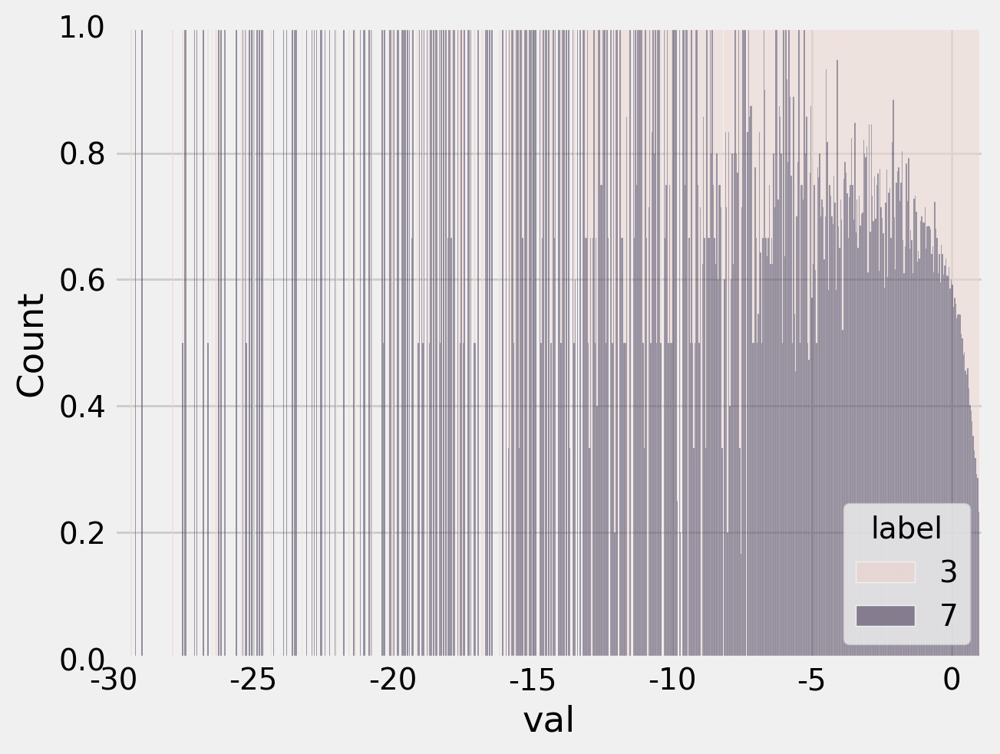

In [ ]:
ran1 = (y_true1-3000)//3500
ran2 = (y_true2-3000)//3500
fig,ax=plt.subplots()#(1,2,figsize=(16,7))
ax.set_xlim(-30,1.2)
data1 = pd.DataFrame({'val':1-val_best,'ran':ran1,'label':3})
data2 = pd.DataFrame({'val':1-val_part,'ran':ran2,'label':7})
data = pd.concat([data1,data2])
sns.histplot(data=data,x='val',hue='label',alpha=0.5,ax=ax,multiple='fill')

In [ ]:
display(data1.describe())
display(data2.describe())

,val,ran,label
count,30104.000000,30104.000000,30104.0
mean,0.498269,2.757740,3.0
std,1.484012,2.335231,0.0
min,-36.211140,0.000000,3.0
25%,0.612786,1.000000,3.0
50%,0.894864,2.000000,3.0
75%,0.981797,4.000000,3.0
max,1.000000,17.000000,3.0


,val,ran,label
count,20601.000000,20601.00000,20601.0
mean,-0.486175,2.44425,7.0
std,3.283754,1.00403,0.0
min,-76.424850,1.00000,7.0
25%,-0.536052,2.00000,7.0
50%,0.499799,2.00000,7.0
75%,0.891211,3.00000,7.0
max,1.000000,4.00000,7.0


In [ ]:
print(np.min(val_best),np.max(val_best))
print(np.min(val_total),np.max(val_total))

-2.3841858e-07 77.42485
-9.536743e-07 81.29799


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


-1.0

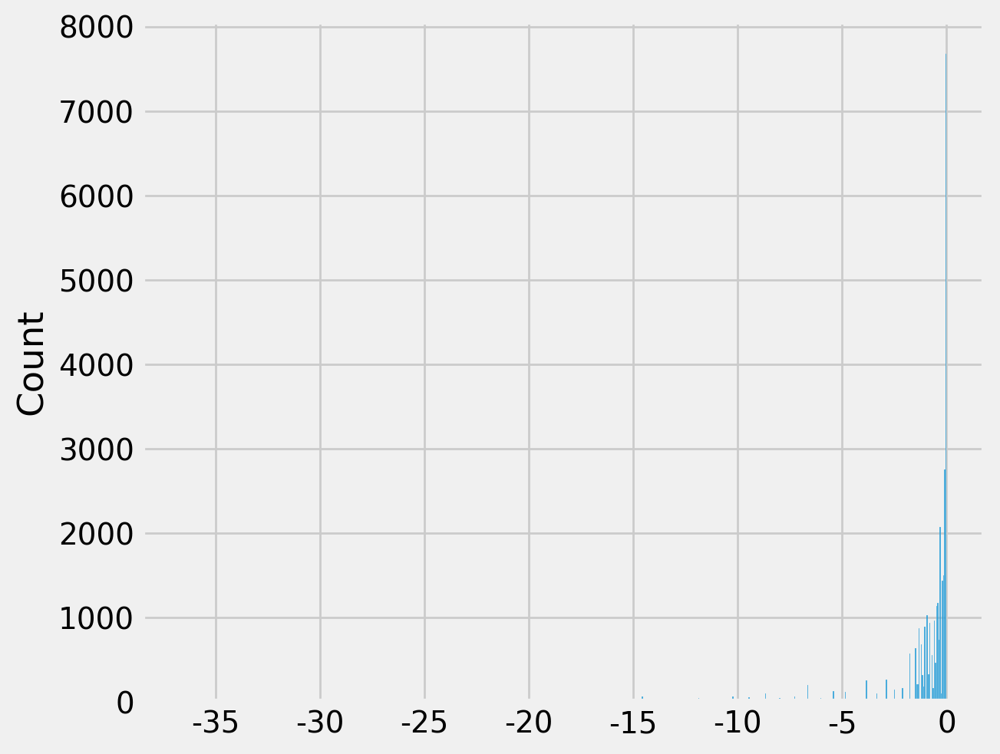

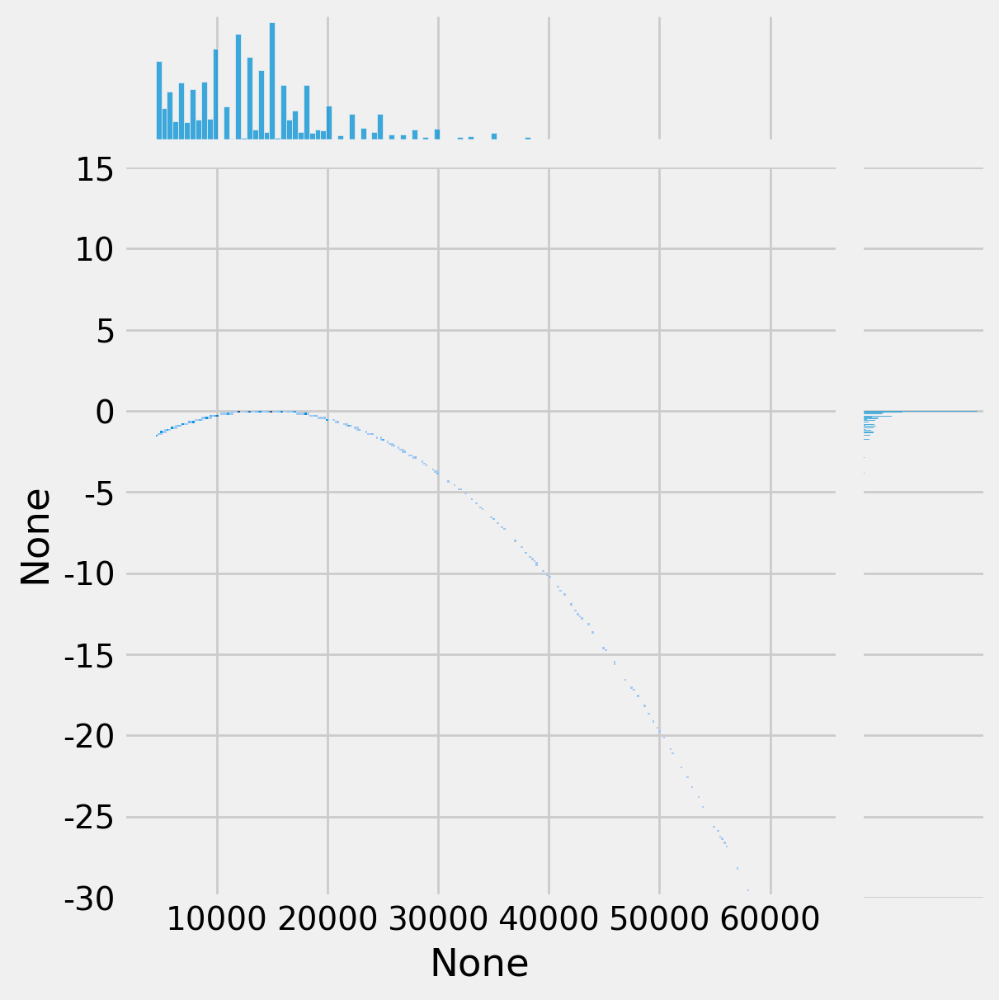

In [ ]:
y_pred,y_true=get_test_rslt(total_model,iter_dict_box[3]['tst'],criterion,device) #gridsize 500
val = (y_true-np.mean(y_true))*(y_true+np.mean(y_true)-2*y_true)/(np.mean((y_true-np.mean(y_true))**2))
sns.histplot(val)
sns.jointplot(x=y_true,y=val,kind='hist',ylim=(-30,15),bins=300)
np.mean(val)

/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


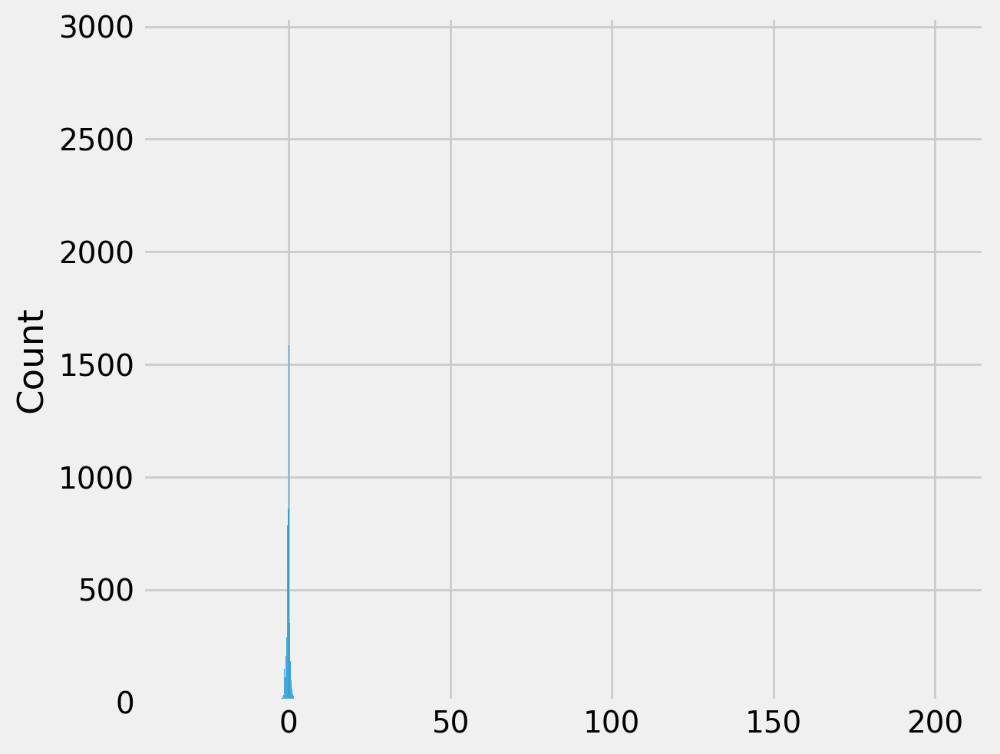

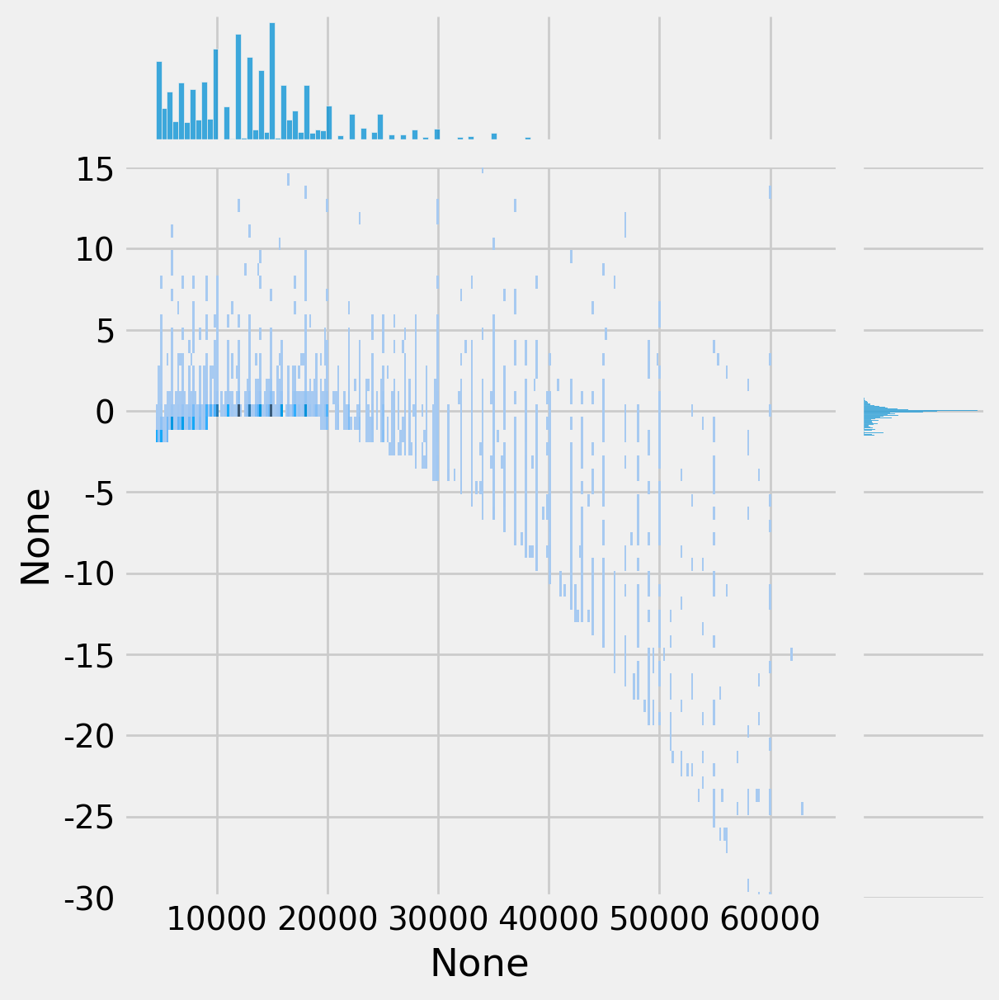

In [ ]:
y_pred,y_true=get_test_rslt(total_model,iter_dict_box[3]['tst'],criterion,device) #gridsize 500
val = (y_pred-np.mean(y_true))*(y_pred+np.mean(y_true)-2*y_true)/(np.mean((y_true-np.mean(y_true))**2))
sns.histplot(val)
sns.jointplot(x=y_true,y=val,kind='hist',ylim=(-30,15),bins=300)

In [ ]:
np.mean(val)

-0.42722005

In [ ]:
r2_score(y_true,y_pred)

0.42722010612487793

In [ ]:
i = np.argmin(val)
y_pred[i],y_true[i],np.mean(y_true)

(44096.94, 62000.0, 14291.837)

In [ ]:
fig,ax=plt.subplots()
ax.set_xlim(0,10)
sns.histplot(val,ax=ax)
#sns.jointplot(x=y_true,y=val,kind='hist',ylim=(0,5))

In [ ]:
np.sum((y_pred-np.mean(y_true))**2)/np.sum((y_true-np.mean(y_true))**2)
1-np.sum((y_pred-y_true)**2)/np.sum((y_true-np.mean(y_true))**2)

0.49826890230178833

7829.522335366315 	r2 :  0.42619526386260986 	mape :  0.34356847


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


7829.522335366315 	r2 :  0.42619526386260986 	mape :  0.34356847


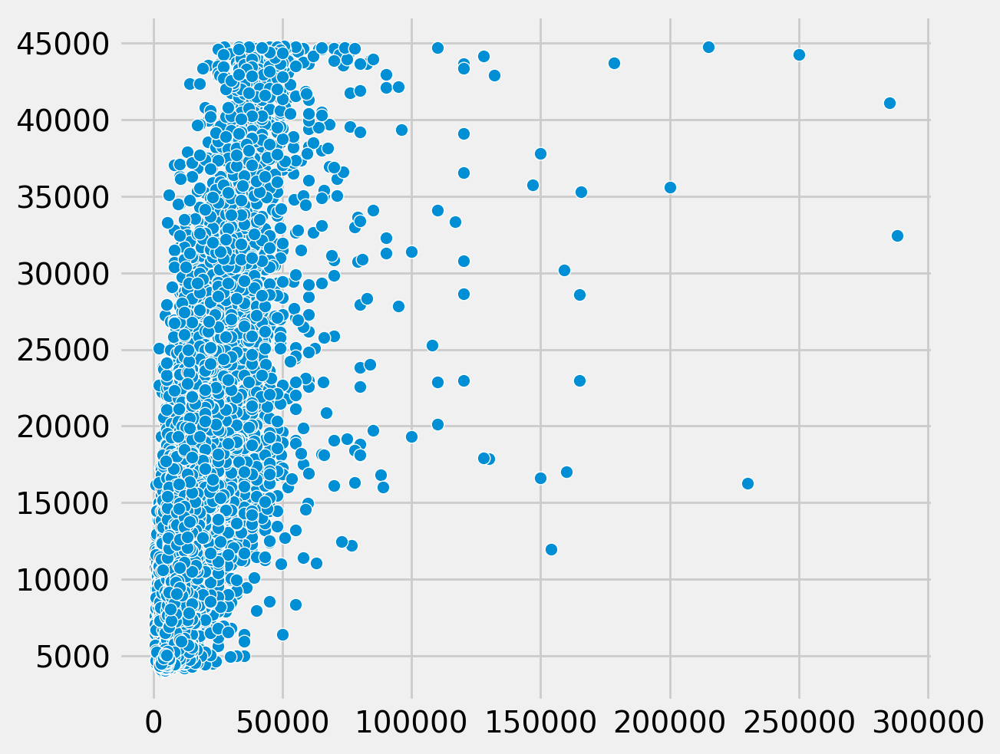

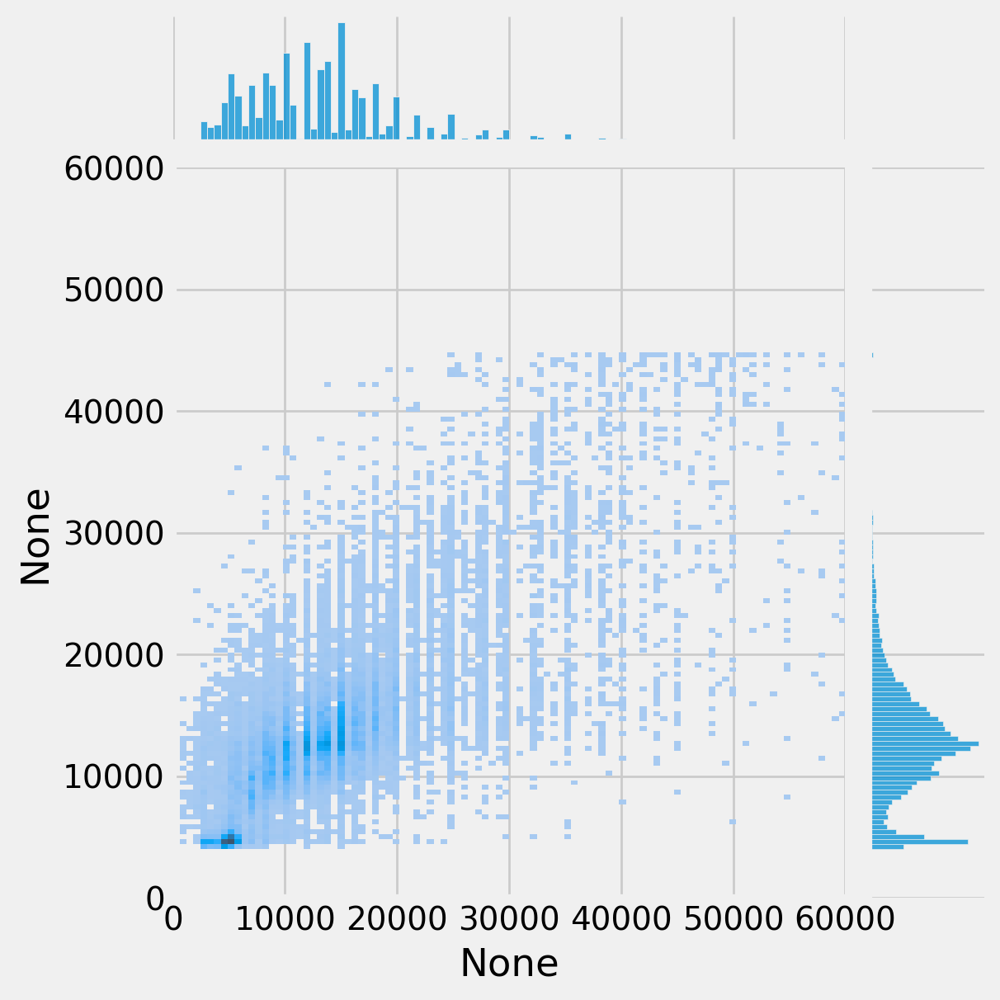

In [ ]:
test_n_plot(best_model,iter_dict['vld'],criterion,device) #gridsize 180
test_n_plot(best_model,iter_dict['vld'],criterion,device,scatter=False) #gridsize 180

9043.04373538025 	r2 :  0.381686270236969 	mape :  0.34596652


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


9043.04373538025 	r2 :  0.381686270236969 	mape :  0.34596652


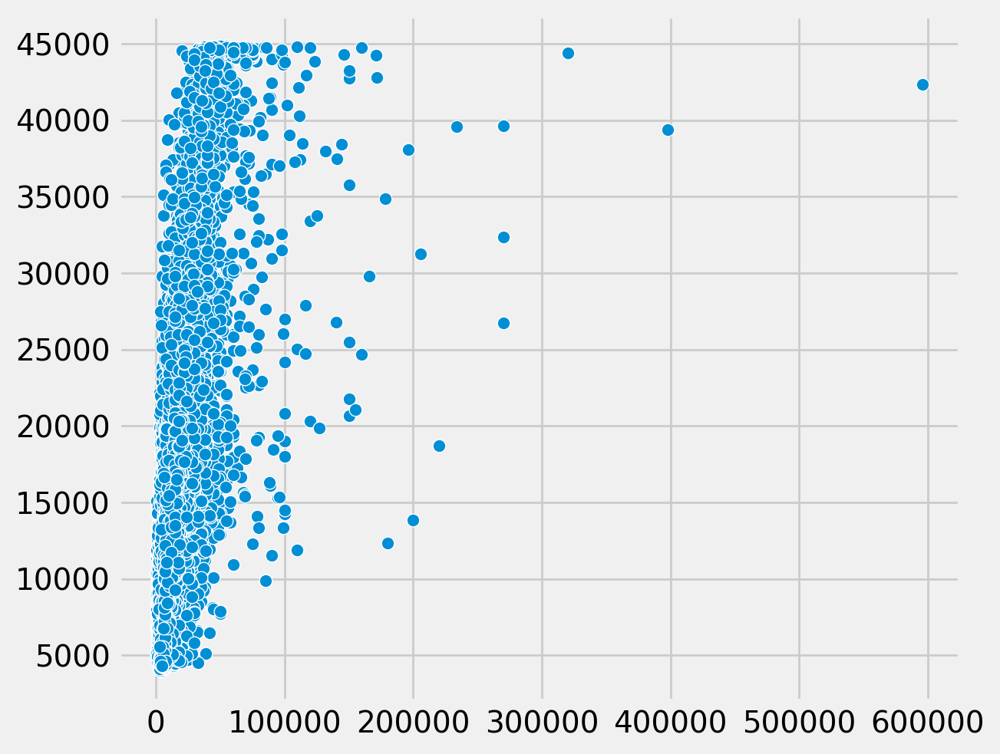

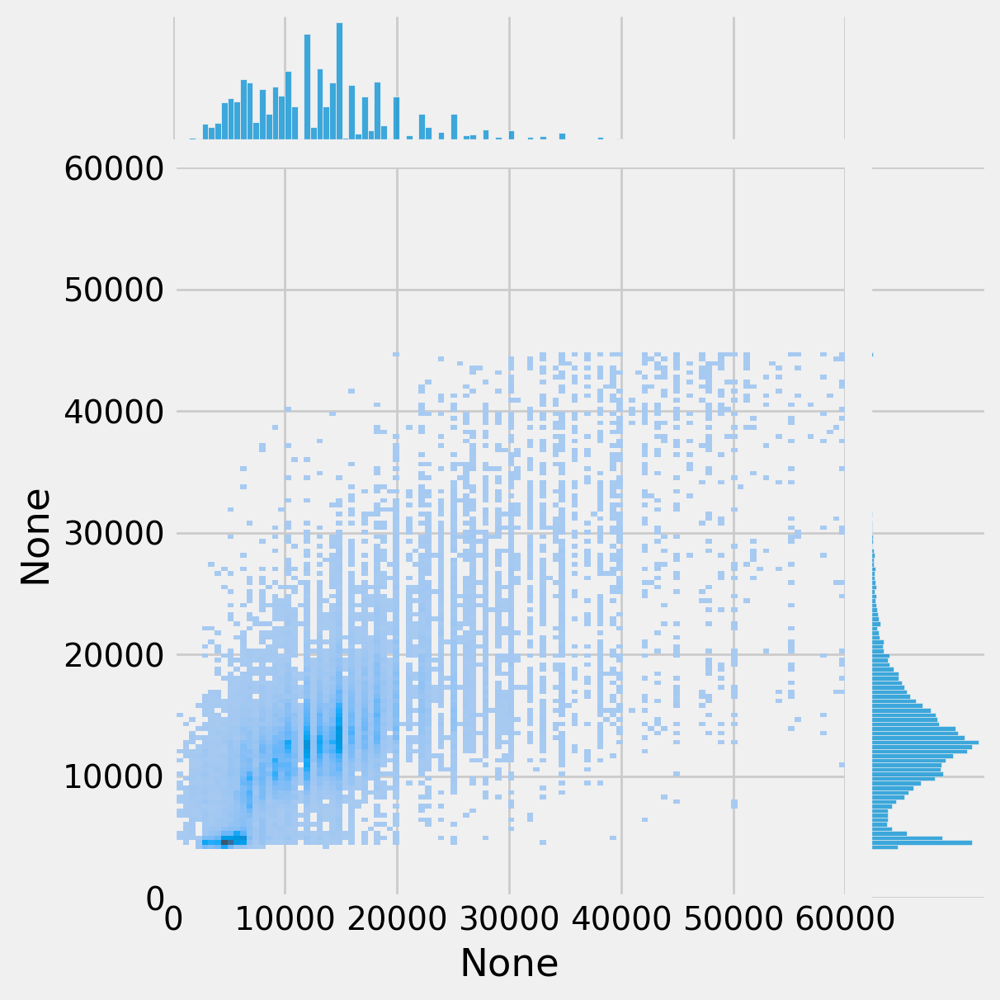

In [ ]:
test_n_plot(best_model,iter_dict['tst'],criterion,device) #gridsize 350
test_n_plot(best_model,iter_dict['tst'],criterion,device,scatter=False) #gridsize 350

/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()
/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


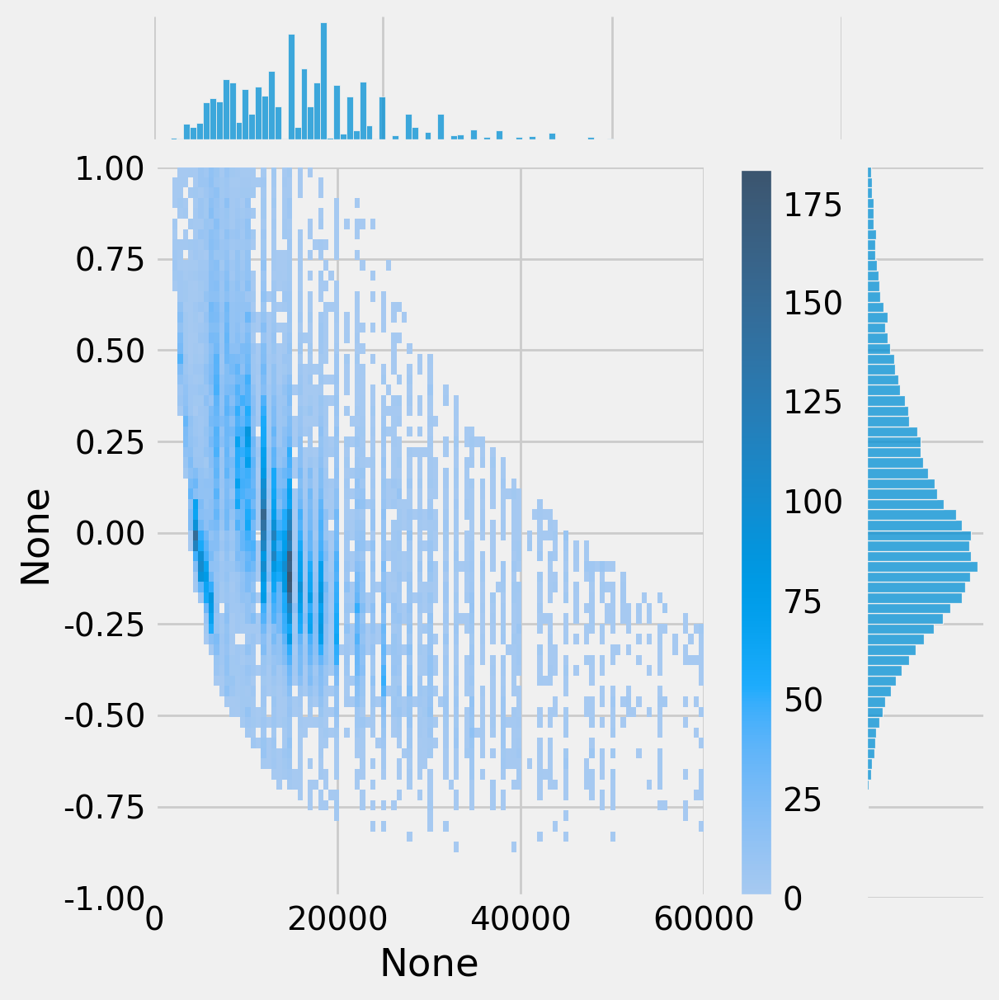

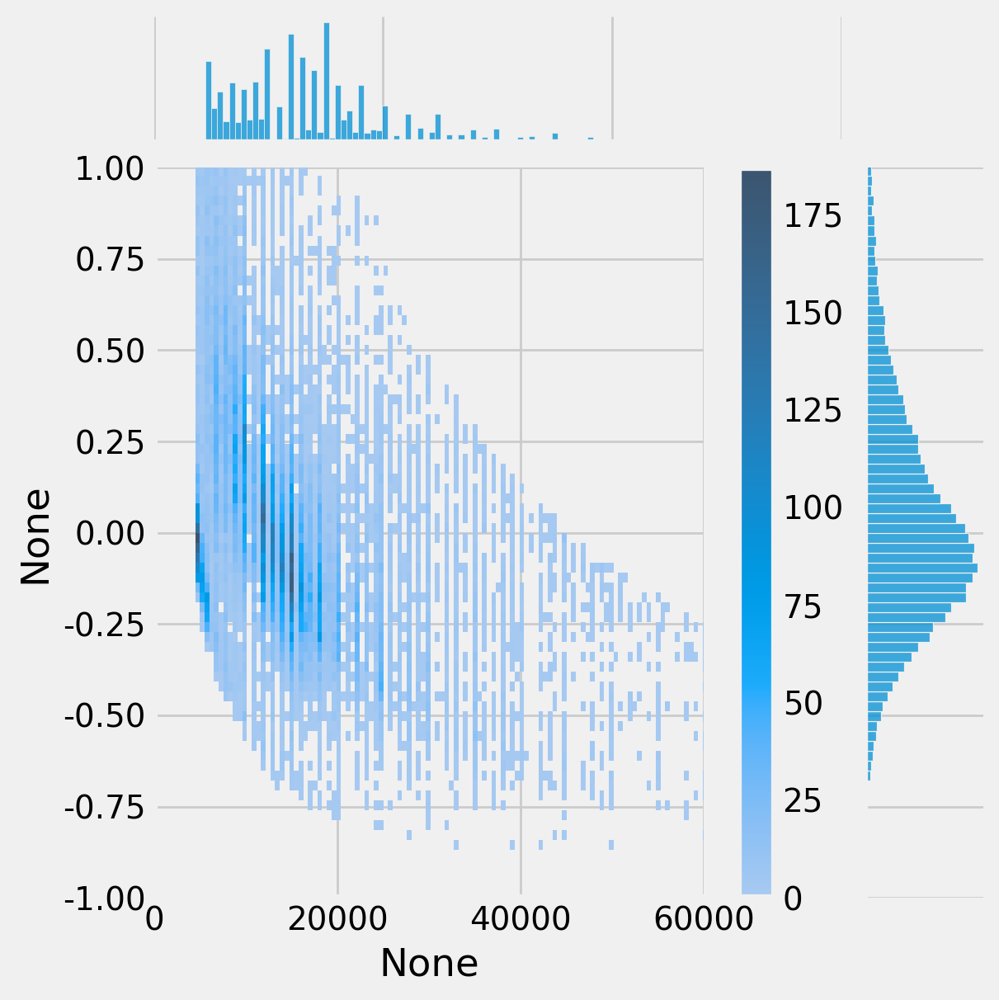

In [ ]:
test_plot_err_dist(best_model,iter_dict['tst'],criterion,device,percent=True,ylim=(-1,1),xlim=(0,60000),cbar=True) #gridsize 180
test_plot_err_dist(best_model,iter_dict_box[3]['tst'],criterion,device,percent=True,ylim=(-1,1),xlim=(0,60000),cbar=True) #gridsize 180

/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()
/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


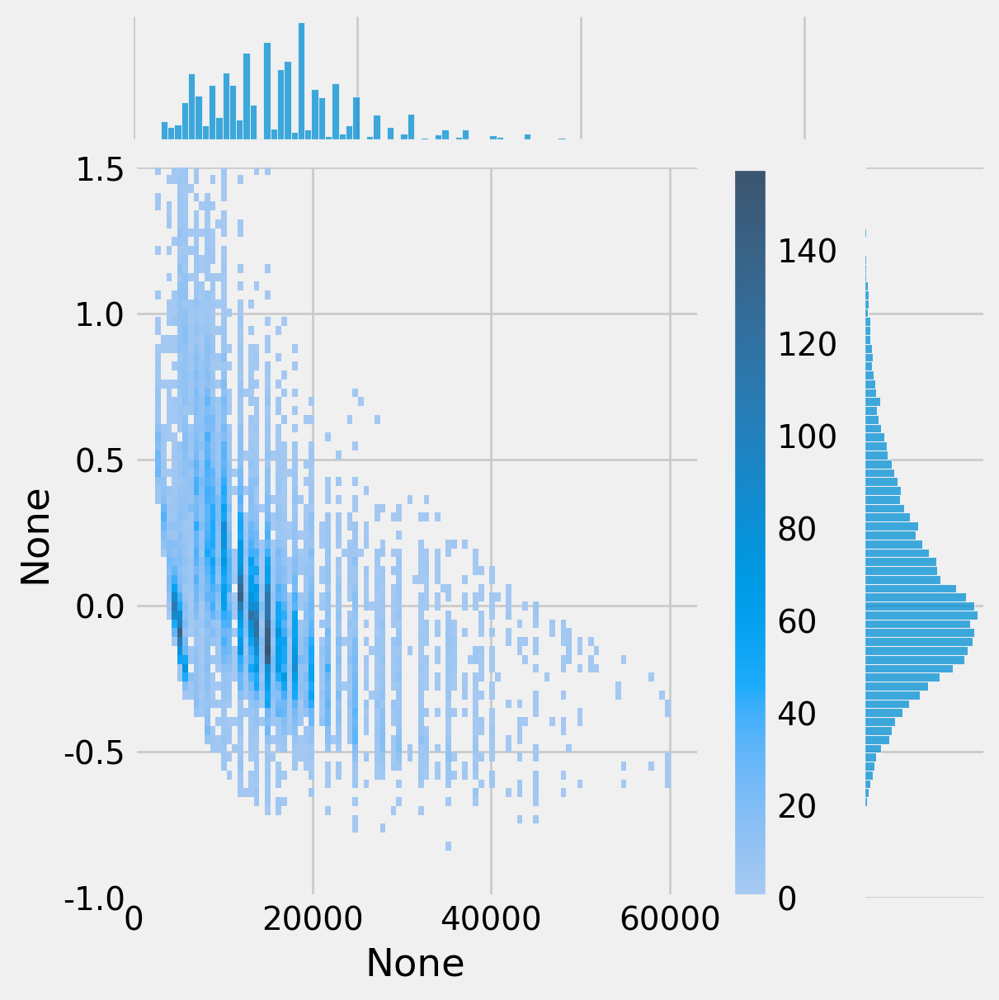

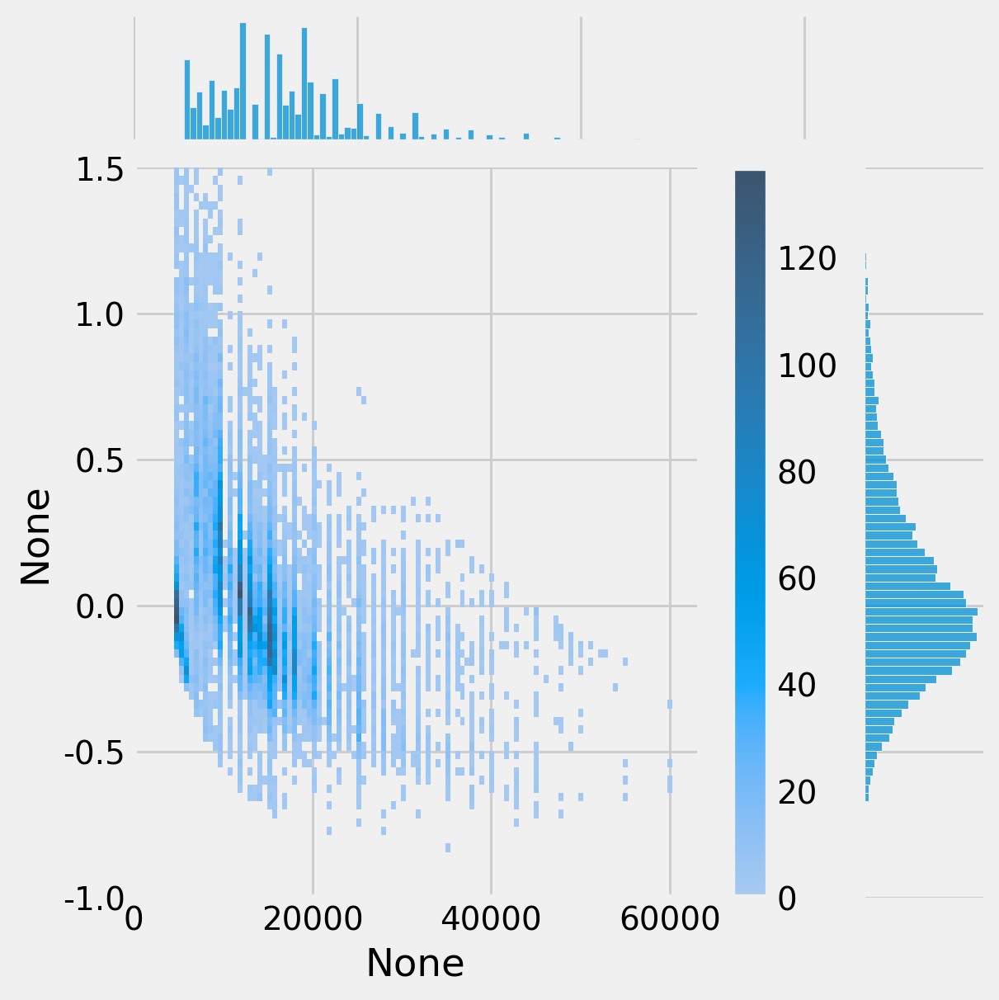

In [ ]:
test_plot_err_dist(best_model,iter_dict['vld'],criterion,device,percent=True,cbar=True,pthresh=0.00001,xlim=(0,63000),ylim=(-1,1.5)) #gridsize 180
test_plot_err_dist(best_model,iter_dict_box[3]['vld'],criterion,device,percent=True,cbar=True,pthresh=0.00001,xlim=(0,63000),ylim=(-1,1.5)) #gridsize 180

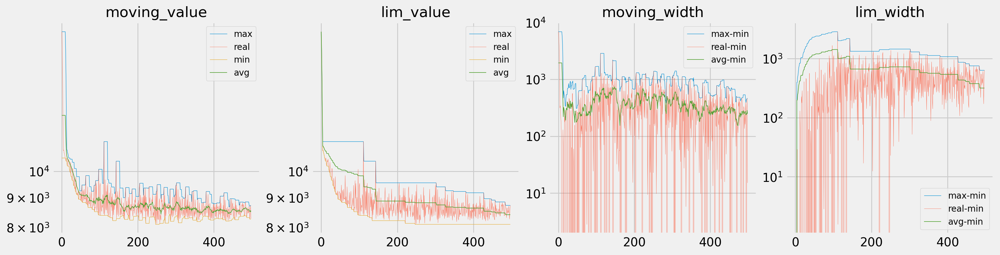

In [ ]:
x = val_loss
plot_area(x,start=0,end=-1);
#plot_area(x,start=750,end=-1,log=False);

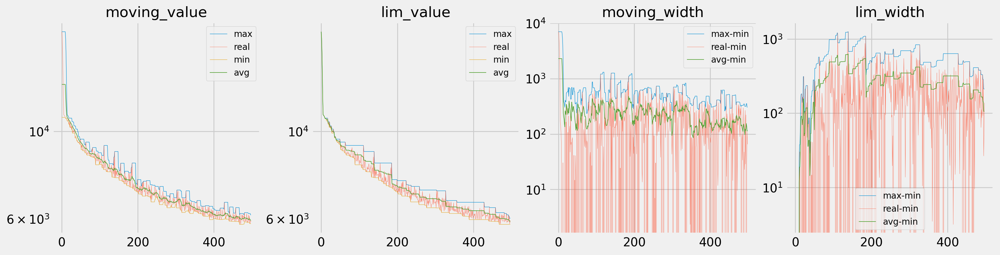

In [ ]:
x = train_loss
plot_area(x,start=0,end=-1);

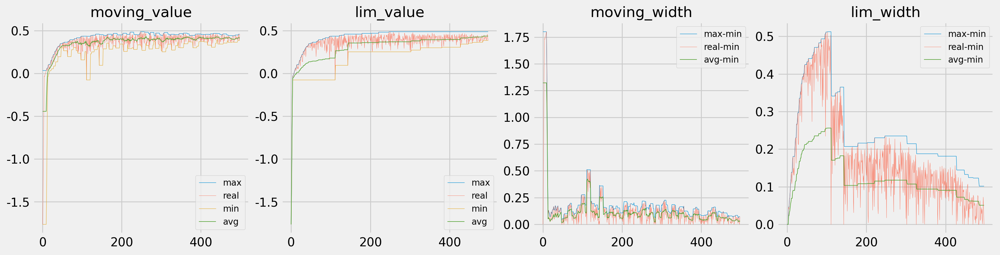

In [ ]:
x = val_score
plot_area(x,False,start=0,end=-1,log=False);

# data box 4

# train, evaluate

In [ ]:
model, train_config, init_lr,save_dir,file_name = box_expt_config(4)
model,train_loss,val_loss,train_score,val_score,best_epoch = run(model,train_config,iter_dict_box[1]['trn'],iter_dict_box[1]['vld'],epoch,warmup,8500,save_dir,file_name[:-3])
torch.save(model,os.path.join(save_dir,file_name))
save_pkl(save_dir,'train_loss.pkl',train_loss)
save_pkl(save_dir,'valid_loss.pkl',val_loss)
save_pkl(save_dir,'valid_score.pkl',val_score)

Epoch:     1		lr: 0.00008247
	Train Loss: 16041.199	Train Score: -2.855	Val Loss: 15946.197	Val Score: -2.849
Epoch:     2		lr: 0.00008247
	Train Loss: 15866.778	Train Score: -2.774	Val Loss: 15668.166	Val Score: -2.717
Epoch:     3		lr: 0.00008247
	Train Loss: 15529.277	Train Score: -2.618	Val Loss: 15204.042	Val Score: -2.500
Epoch:     4		lr: 0.00008247
	Train Loss: 15020.101	Train Score: -2.387	Val Loss: 14567.724	Val Score: -2.215
Epoch:     5		lr: 0.00008247
	Train Loss: 14351.619	Train Score: -2.094	Val Loss: 13772.713	Val Score: -1.875
Epoch:     6		lr: 0.00008247
	Train Loss: 13539.609	Train Score: -1.756	Val Loss: 12844.129	Val Score: -1.503
Epoch:     7		lr: 0.00008247
	Train Loss: 12603.100	Train Score: -1.390	Val Loss: 11802.895	Val Score: -1.116
Epoch:     8		lr: 0.00008247
	Train Loss: 11572.751	Train Score: -1.017	Val Loss: 10701.478	Val Score: -0.742
Epoch:     9		lr: 0.00008247
	Train Loss: 10499.588	Train Score: -0.661	Val Loss: 9616.320	Val Score: -0.410
Epoch:    1

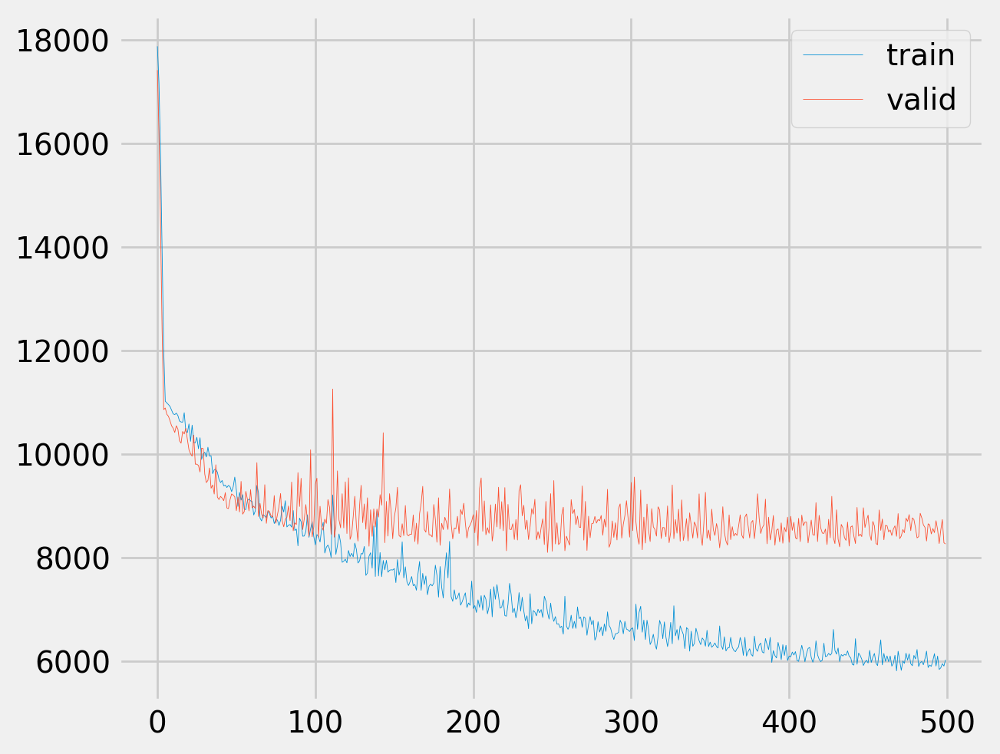

In [ ]:
train_loss = load_pkl(os.path.join(save_dir,'train_loss.pkl'))
valid_loss = load_pkl(os.path.join(save_dir,'valid_loss.pkl'))
valid_score = load_pkl(os.path.join(save_dir,'valid_score.pkl'))

loss_train = np.array(train_loss)
loss_valid = np.array(val_loss)

fig, ax = plt.subplots()

ax.plot(range(len(loss_train)),loss_train,label='train',lw=0.3)
ax.plot(range(len(loss_valid)),loss_valid,label='valid',lw=0.3)
#ax.set_yscale('log')
ax.legend();

In [ ]:
best_model = torch.load(os.path.join(save_dir,f'best_{file_name}'))
criterion = train_config[-2]

<ipython-input-45-1790dcb0272c>:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  best_model = torch.load(os.path.join(save_dir,f'best_{file_name}'))


6079.8402813029425 	r2 :  0.6872004866600037 	mape :  0.31050563


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


6079.8402813029425 	r2 :  0.6872004866600037 	mape :  0.31050563


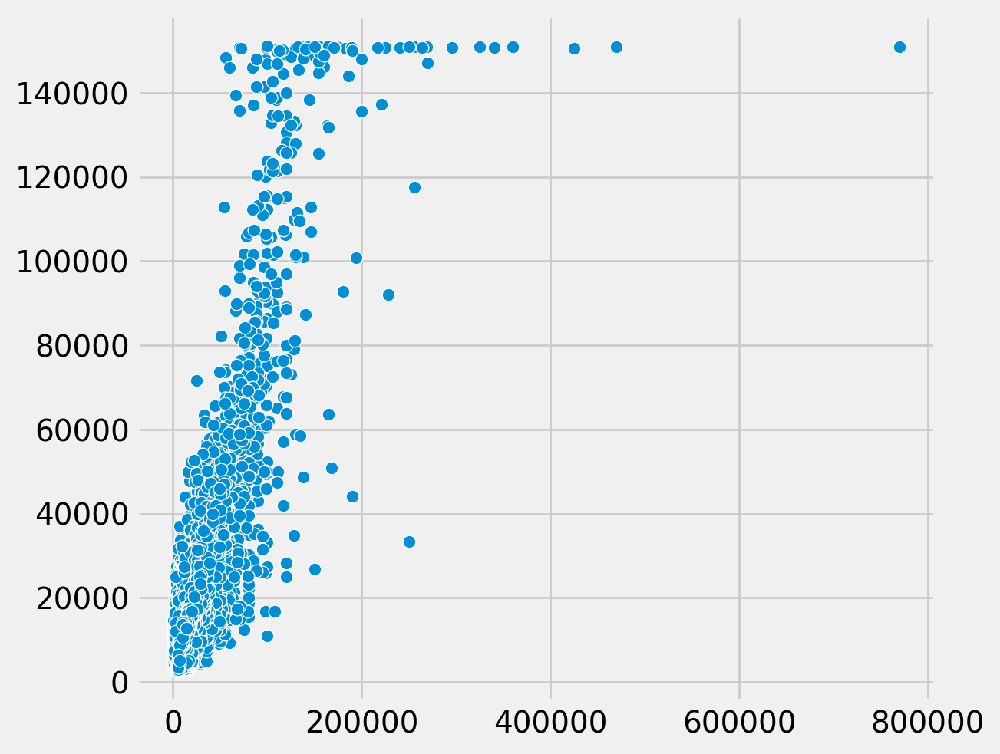

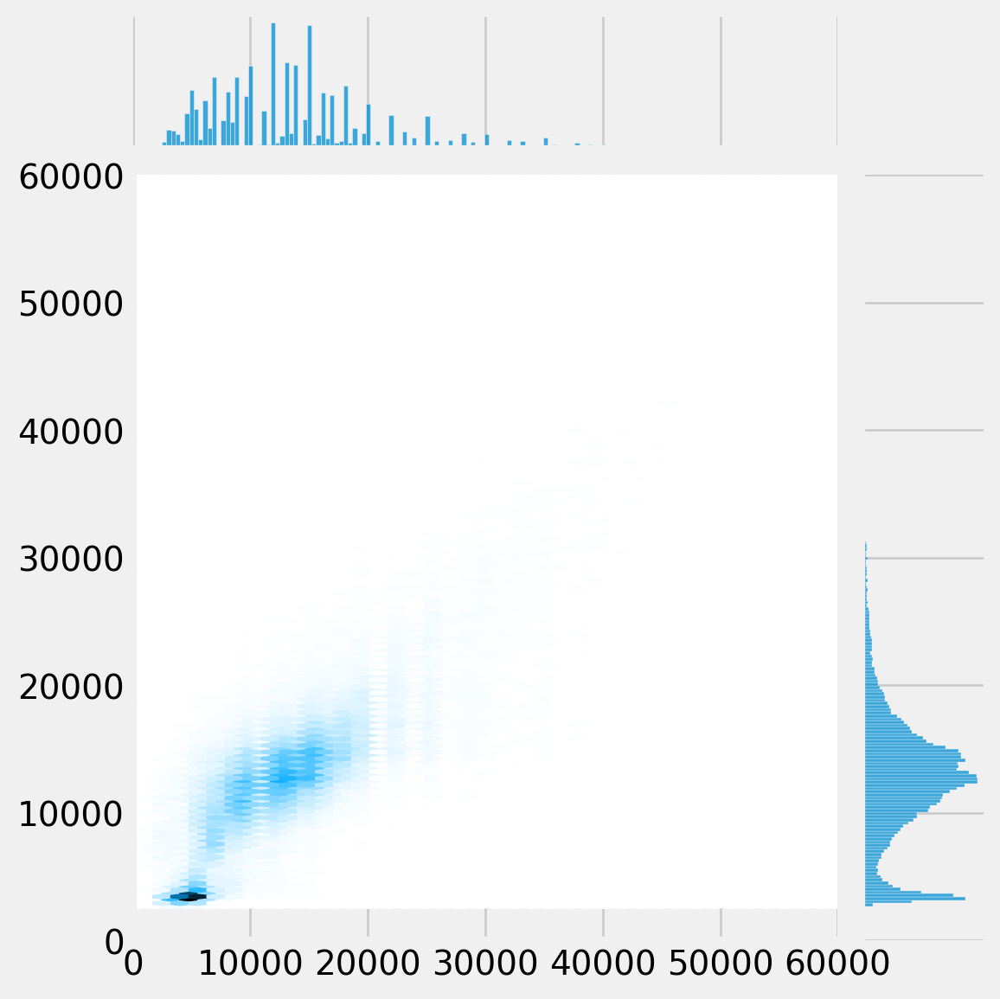

In [ ]:
test_n_plot(best_model,iter_dict['trn'],criterion,device) #gridsize 500
test_n_plot(best_model,iter_dict['trn'],criterion,device,scatter=False,gridsize=500) #gridsize 500

8099.6480787747805 	r2 :  0.48702794313430786 	mape :  0.3616164


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8099.6480787747805 	r2 :  0.48702794313430786 	mape :  0.3616164


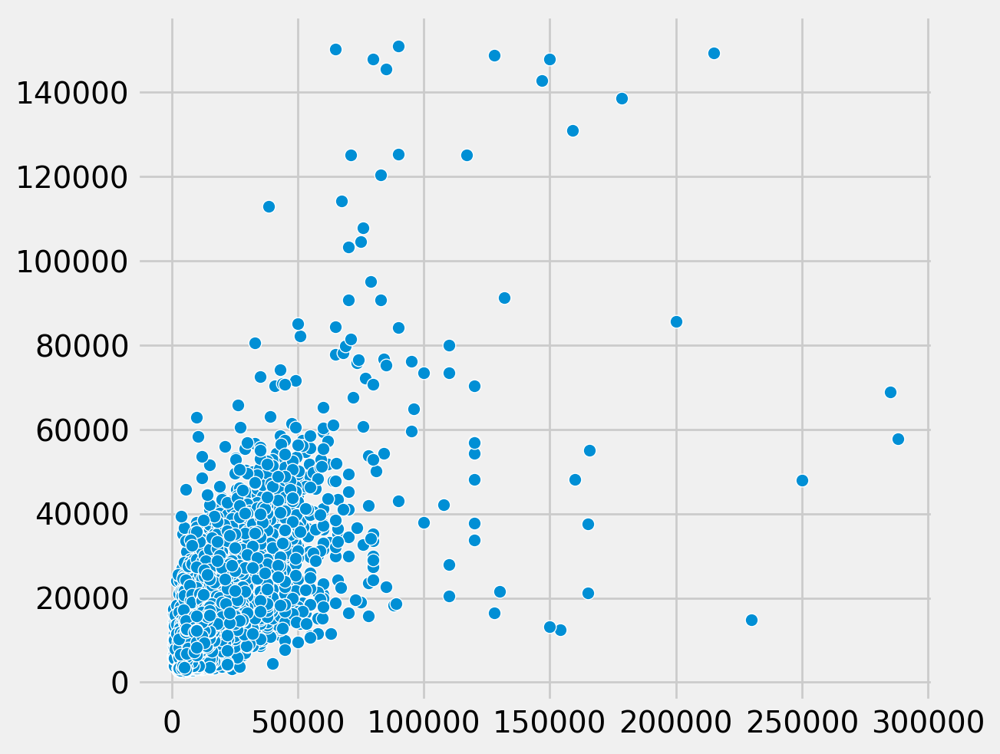

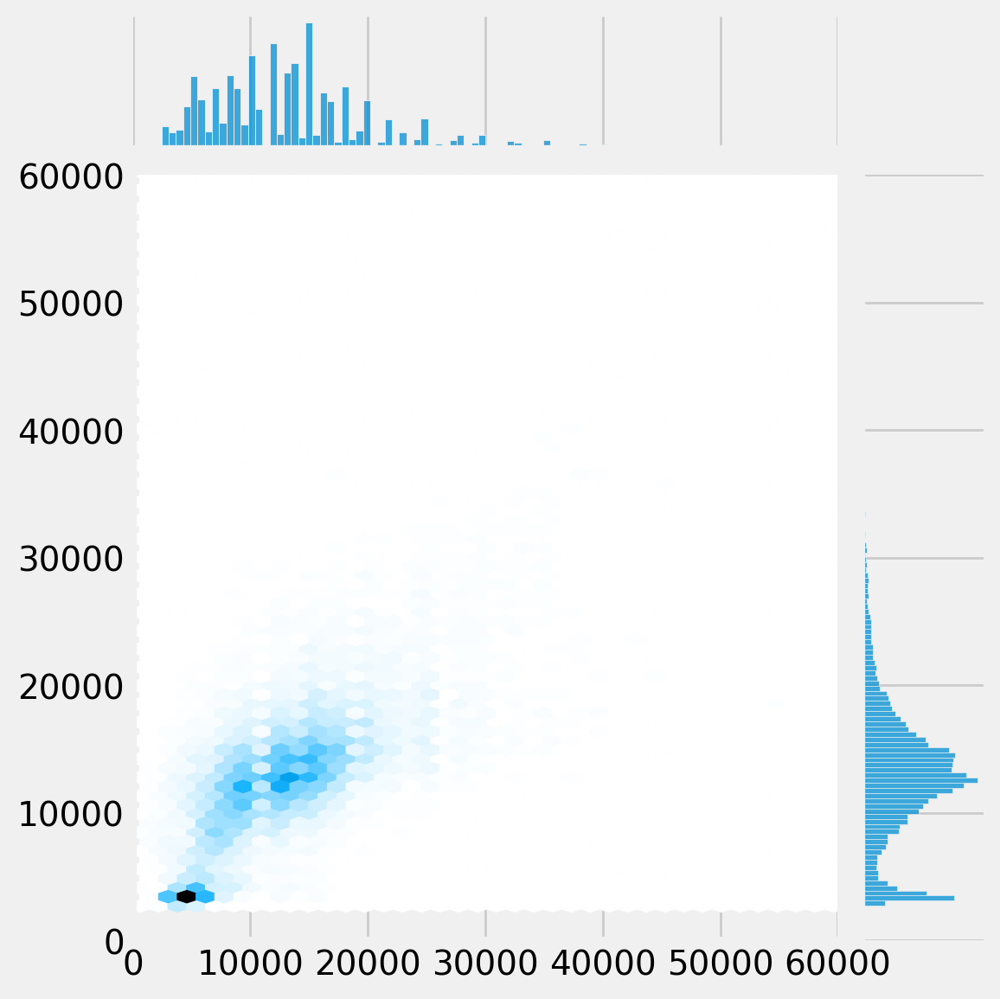

In [ ]:
test_n_plot(best_model,iter_dict['vld'],criterion,device) #gridsize 180
test_n_plot(best_model,iter_dict['vld'],criterion,device,scatter=False,gridsize=180) #gridsize 180

8483.909829789565 	r2 :  0.4573727250099182 	mape :  0.3639279


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8483.909829789565 	r2 :  0.4573727250099182 	mape :  0.3639279


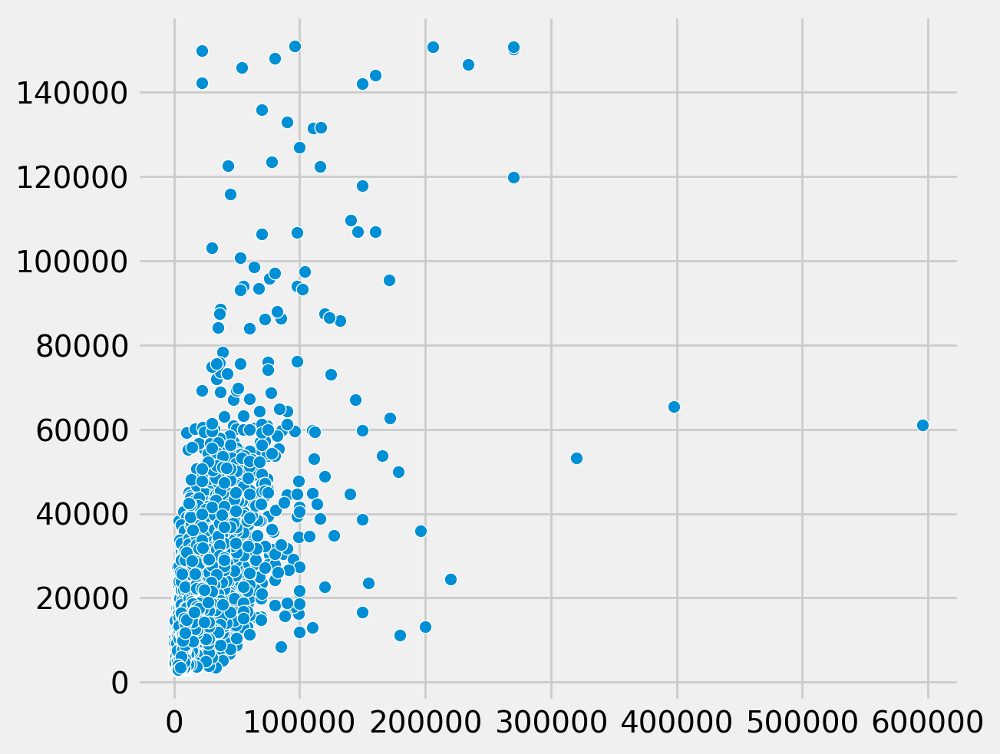

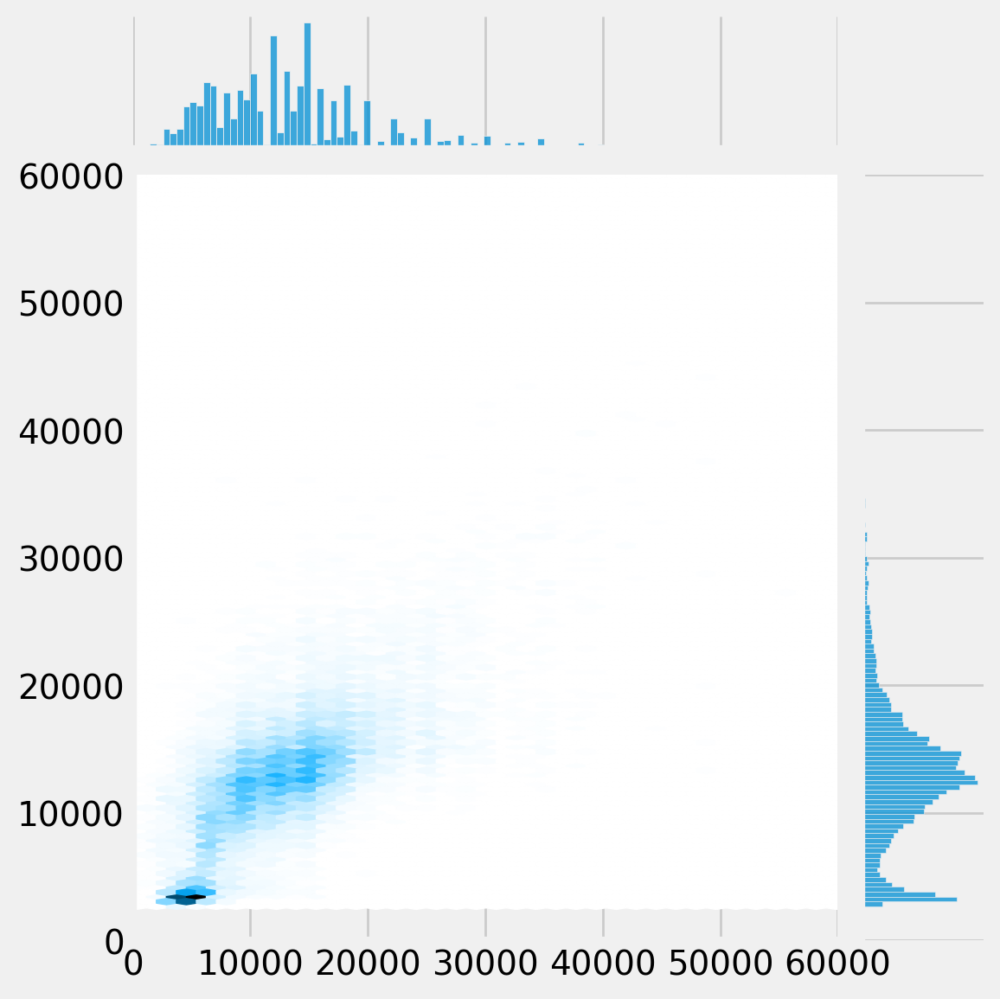

In [ ]:
test_n_plot(best_model,iter_dict['tst'],criterion,device) #gridsize 350
test_n_plot(best_model,iter_dict['tst'],criterion,device,scatter=False,gridsize=350) #gridsize 350

5421.616094572086 	r2 :  0.7526980638504028 	mape :  0.28877568


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


5421.616094572086 	r2 :  0.7526980638504028 	mape :  0.28877568


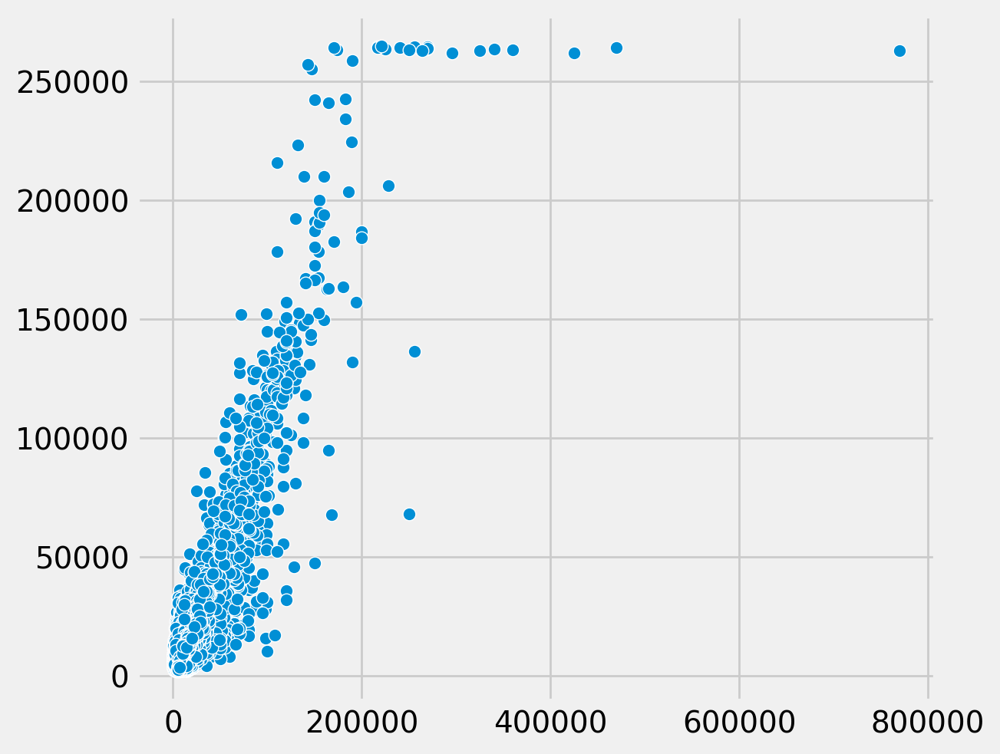

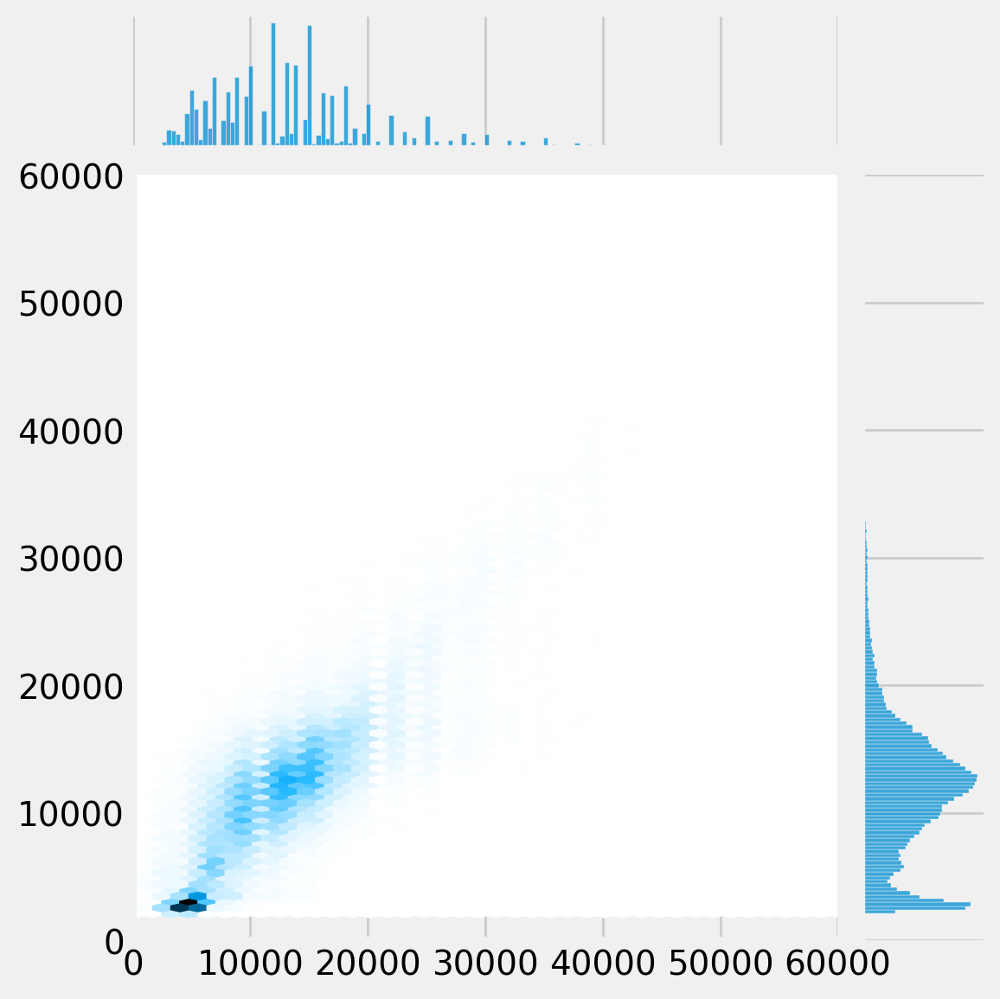

In [ ]:
test_n_plot(model,iter_dict['trn'],criterion,device) #gridsize 500
test_n_plot(model,iter_dict['trn'],criterion,device,scatter=False,gridsize=500) #gridsize 500

8262.704762969568 	r2 :  0.4583730101585388 	mape :  0.35924602


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8262.704762969568 	r2 :  0.4583730101585388 	mape :  0.35924602


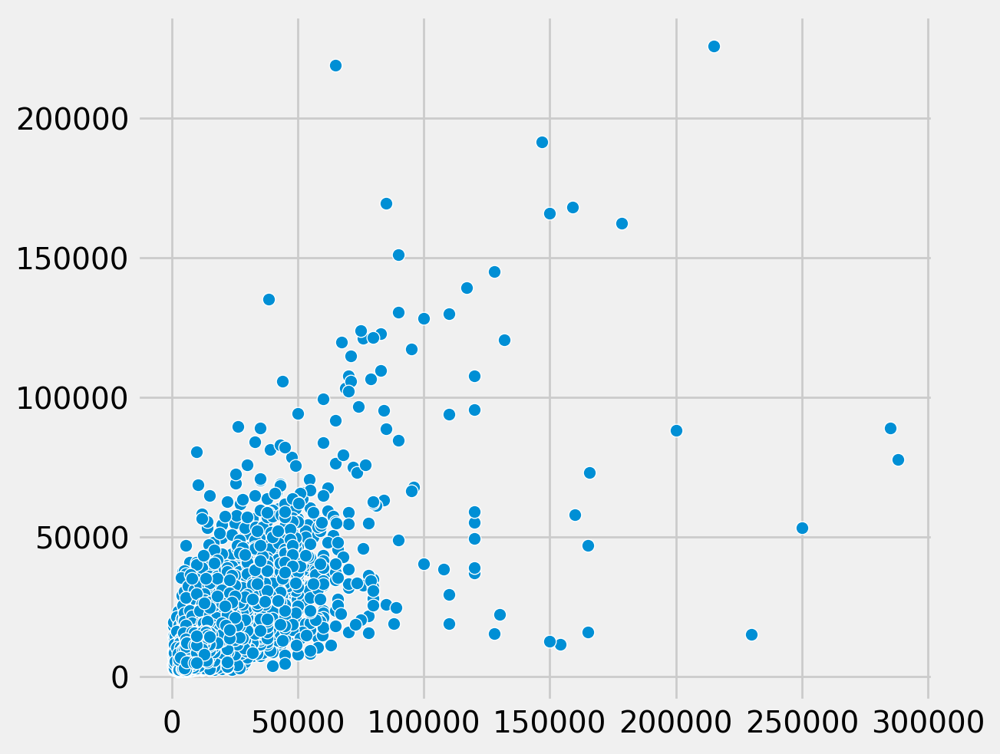

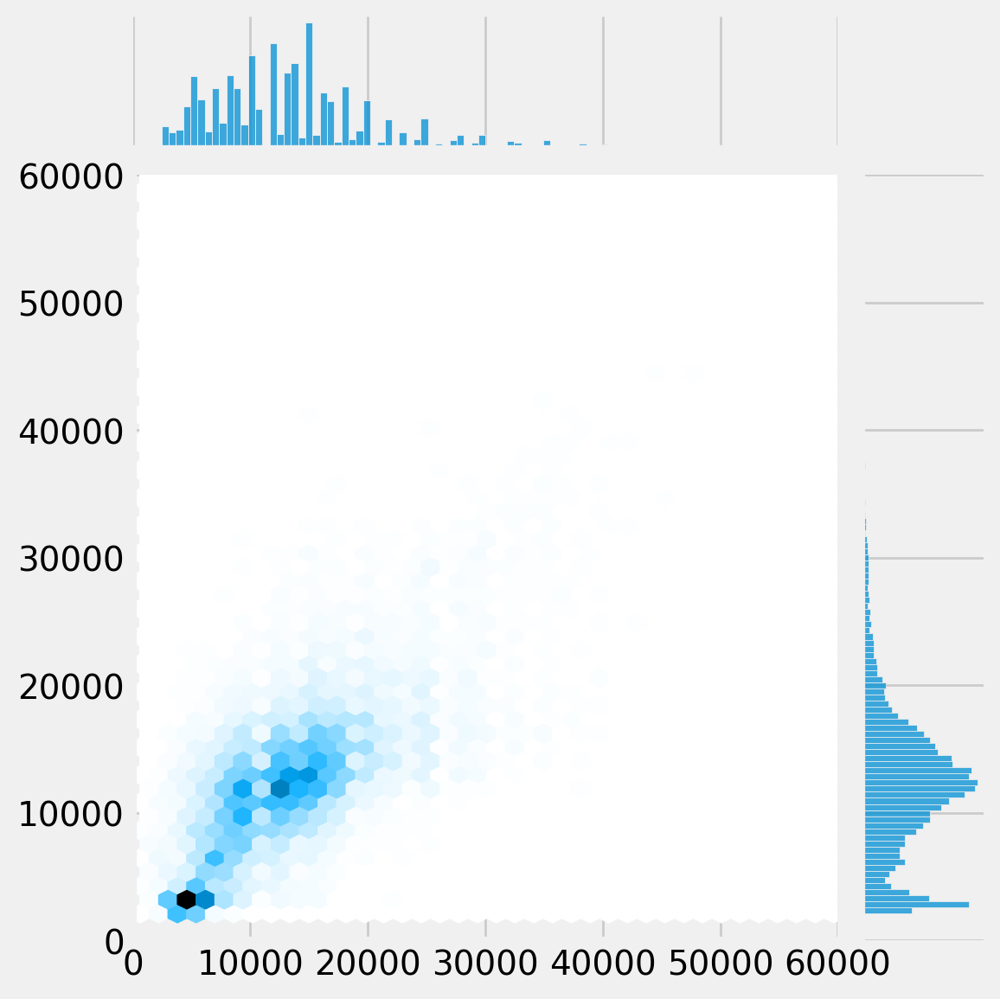

In [ ]:
test_n_plot(model,iter_dict['vld'],criterion,device) #gridsize 180
test_n_plot(model,iter_dict['vld'],criterion,device,scatter=False,gridsize=180)

8606.021670899976 	r2 :  0.4417092204093933 	mape :  0.359285


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8606.021670899976 	r2 :  0.4417092204093933 	mape :  0.359285


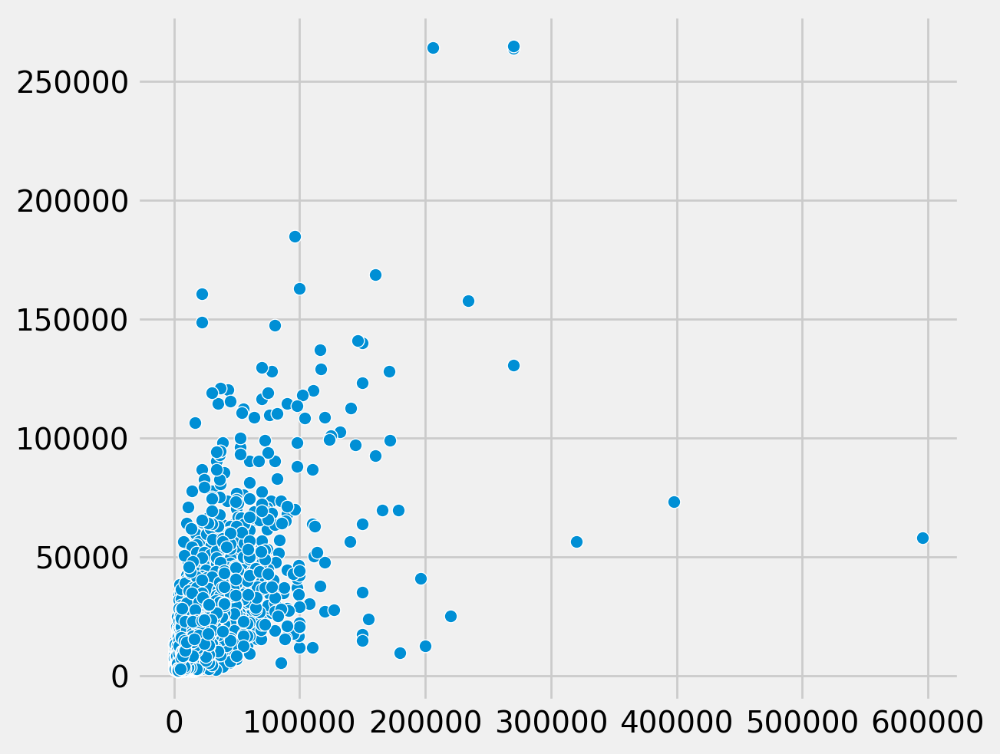

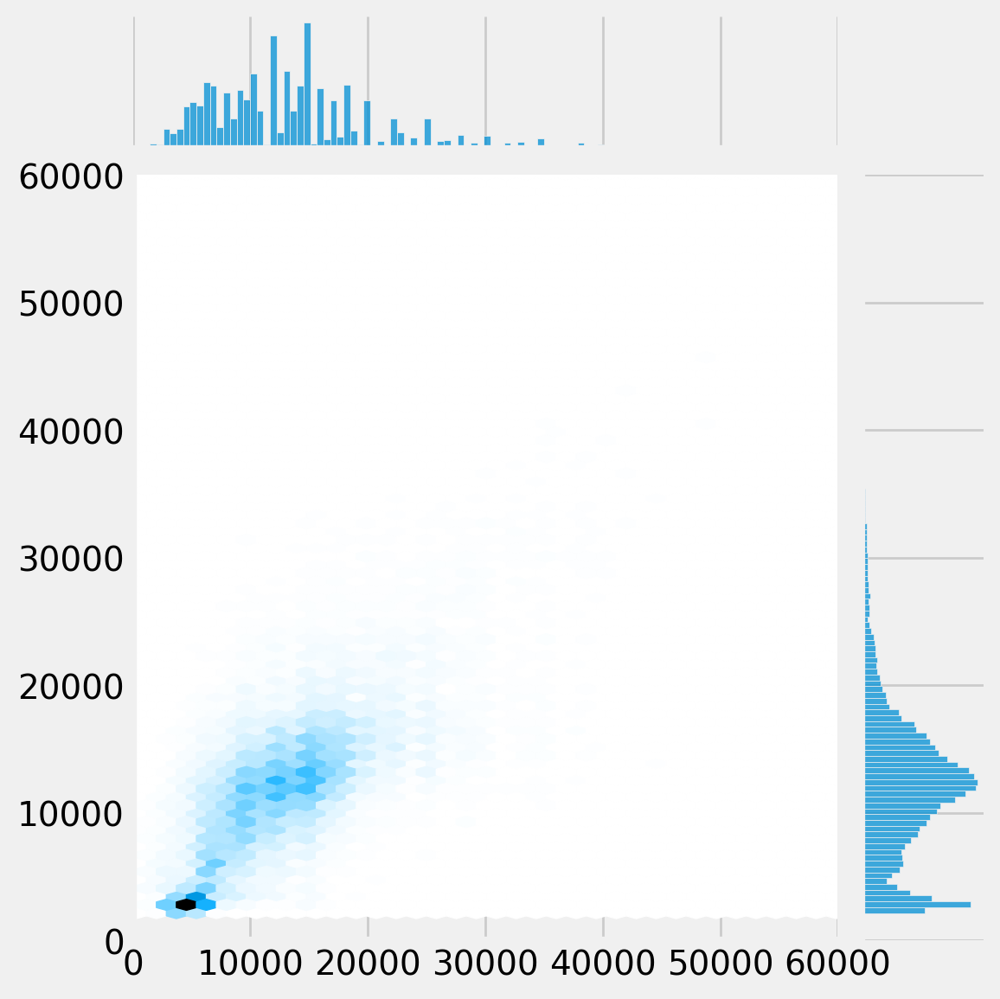

In [ ]:
test_n_plot(model,iter_dict['tst'],criterion,device) #gridsize 350
test_n_plot(model,iter_dict['tst'],criterion,device,scatter=False,gridsize=350) #gridsize 350

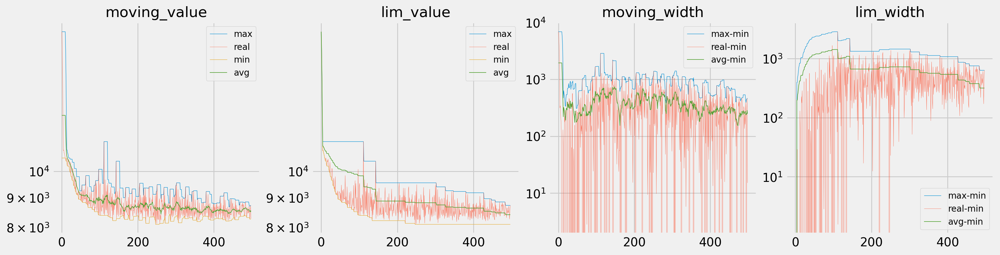

In [ ]:
x = val_loss
plot_area(x,start=0,end=-1);
#plot_area(x,start=750,end=-1,log=False);

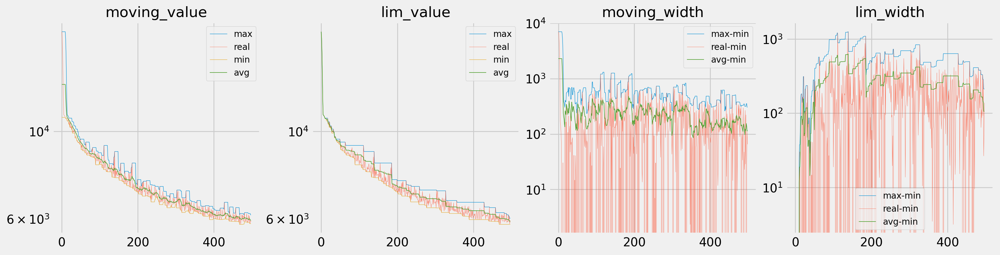

In [ ]:
x = train_loss
plot_area(x,start=0,end=-1);

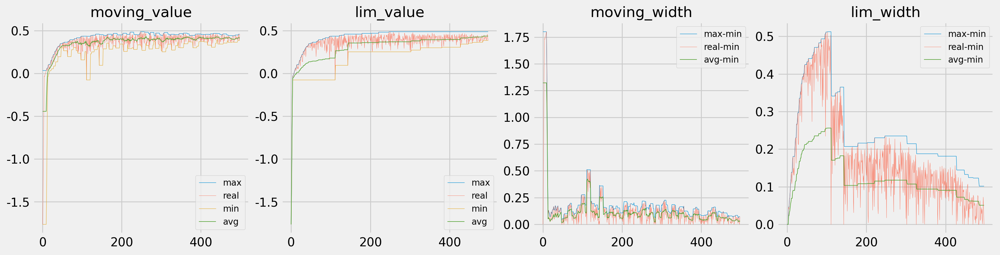

In [ ]:
x = val_score
plot_area(x,False,start=0,end=-1,log=False);

# data box 5

# train, evaluate

In [ ]:
model, train_config, init_lr,save_dir,file_name = box_expt_config(5)
model,train_loss,val_loss,train_score,val_score,best_epoch = run(model,train_config,iter_dict_box[1]['trn'],iter_dict_box[1]['vld'],epoch,warmup,8500,save_dir,file_name[:-3])
torch.save(model,os.path.join(save_dir,file_name))
save_pkl(save_dir,'train_loss.pkl',train_loss)
save_pkl(save_dir,'valid_loss.pkl',val_loss)
save_pkl(save_dir,'valid_score.pkl',val_score)

Epoch:     1		lr: 0.00008247
	Train Loss: 16041.199	Train Score: -2.855	Val Loss: 15946.197	Val Score: -2.849
Epoch:     2		lr: 0.00008247
	Train Loss: 15866.778	Train Score: -2.774	Val Loss: 15668.166	Val Score: -2.717
Epoch:     3		lr: 0.00008247
	Train Loss: 15529.277	Train Score: -2.618	Val Loss: 15204.042	Val Score: -2.500
Epoch:     4		lr: 0.00008247
	Train Loss: 15020.101	Train Score: -2.387	Val Loss: 14567.724	Val Score: -2.215
Epoch:     5		lr: 0.00008247
	Train Loss: 14351.619	Train Score: -2.094	Val Loss: 13772.713	Val Score: -1.875
Epoch:     6		lr: 0.00008247
	Train Loss: 13539.609	Train Score: -1.756	Val Loss: 12844.129	Val Score: -1.503
Epoch:     7		lr: 0.00008247
	Train Loss: 12603.100	Train Score: -1.390	Val Loss: 11802.895	Val Score: -1.116
Epoch:     8		lr: 0.00008247
	Train Loss: 11572.751	Train Score: -1.017	Val Loss: 10701.478	Val Score: -0.742
Epoch:     9		lr: 0.00008247
	Train Loss: 10499.588	Train Score: -0.661	Val Loss: 9616.320	Val Score: -0.410
Epoch:    1

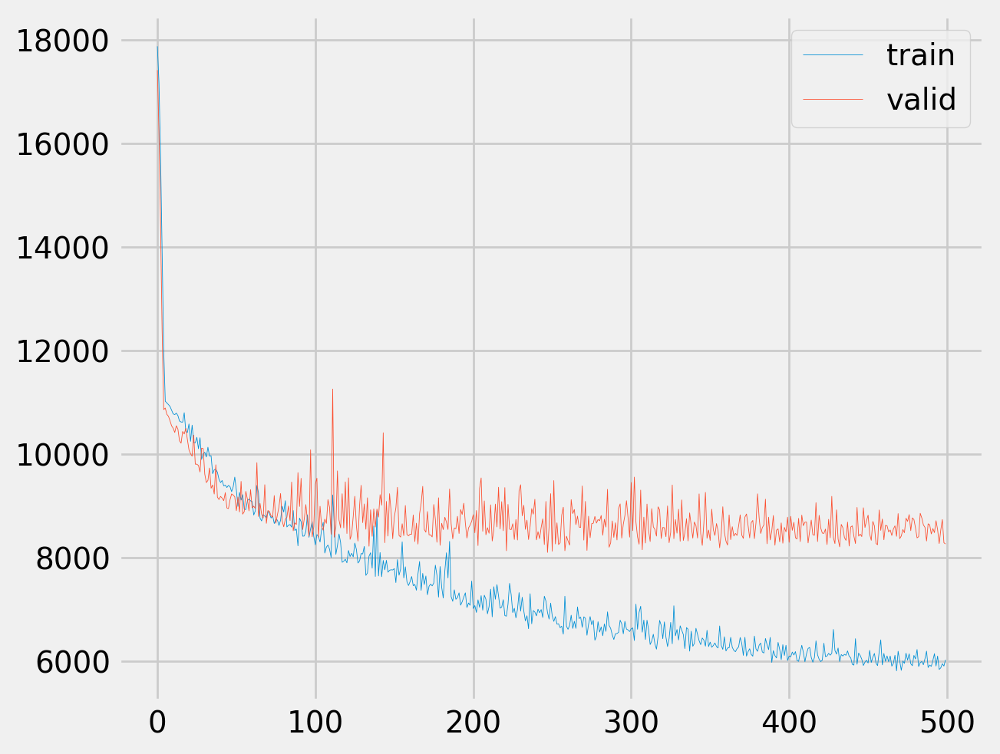

In [ ]:
train_loss = load_pkl(os.path.join(save_dir,'train_loss.pkl'))
valid_loss = load_pkl(os.path.join(save_dir,'valid_loss.pkl'))
valid_score = load_pkl(os.path.join(save_dir,'valid_score.pkl'))

loss_train = np.array(train_loss)
loss_valid = np.array(val_loss)

fig, ax = plt.subplots()

ax.plot(range(len(loss_train)),loss_train,label='train',lw=0.3)
ax.plot(range(len(loss_valid)),loss_valid,label='valid',lw=0.3)
#ax.set_yscale('log')
ax.legend();

In [ ]:
best_model = torch.load(os.path.join(save_dir,f'best_{file_name}'))
criterion = train_config[-2]

<ipython-input-45-1790dcb0272c>:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  best_model = torch.load(os.path.join(save_dir,f'best_{file_name}'))


6079.8402813029425 	r2 :  0.6872004866600037 	mape :  0.31050563


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


6079.8402813029425 	r2 :  0.6872004866600037 	mape :  0.31050563


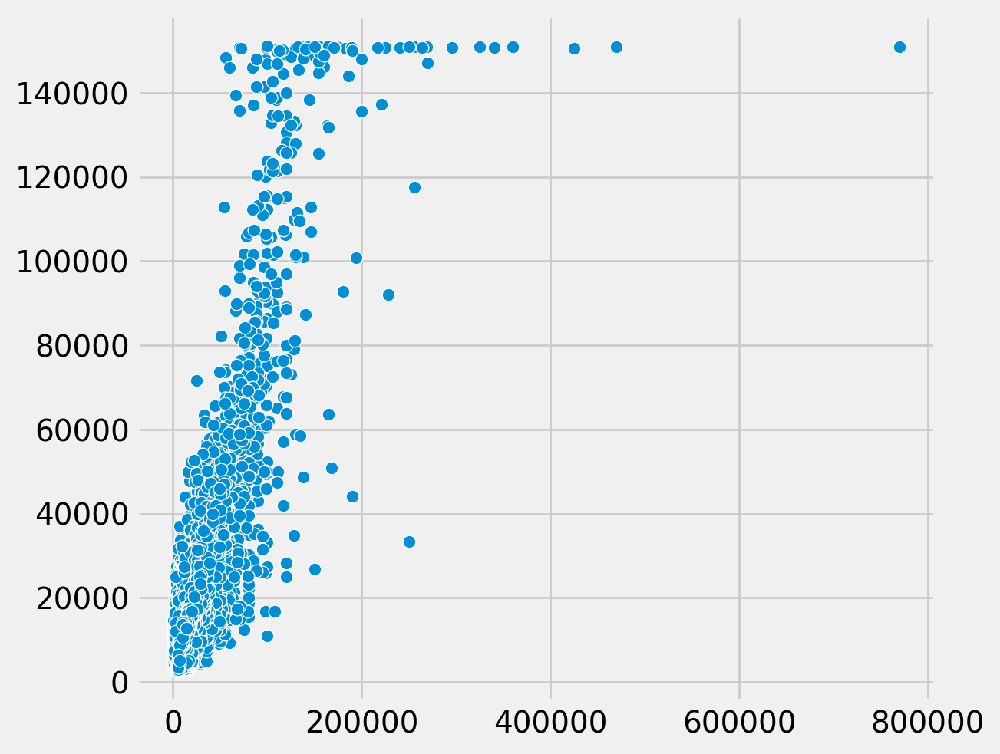

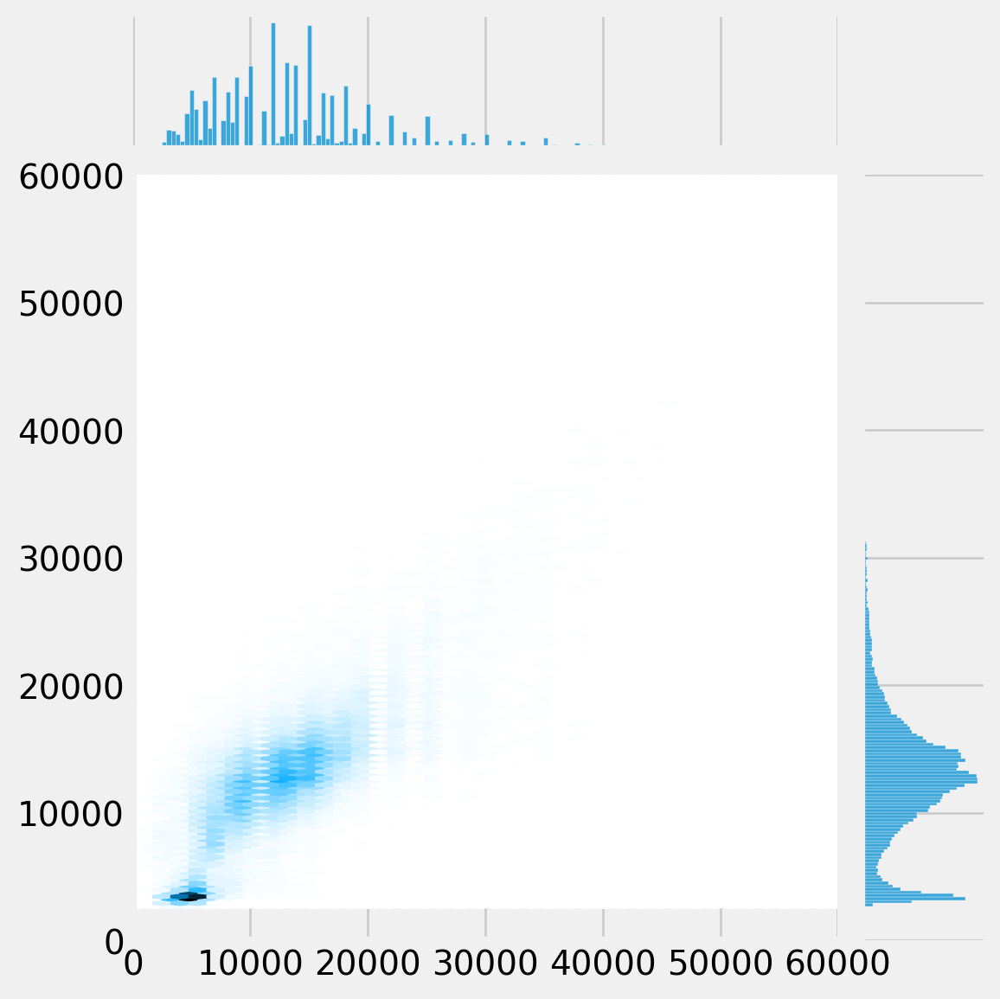

In [ ]:
test_n_plot(best_model,iter_dict['trn'],criterion,device) #gridsize 500
test_n_plot(best_model,iter_dict['trn'],criterion,device,scatter=False,gridsize=500) #gridsize 500

8099.6480787747805 	r2 :  0.48702794313430786 	mape :  0.3616164


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8099.6480787747805 	r2 :  0.48702794313430786 	mape :  0.3616164


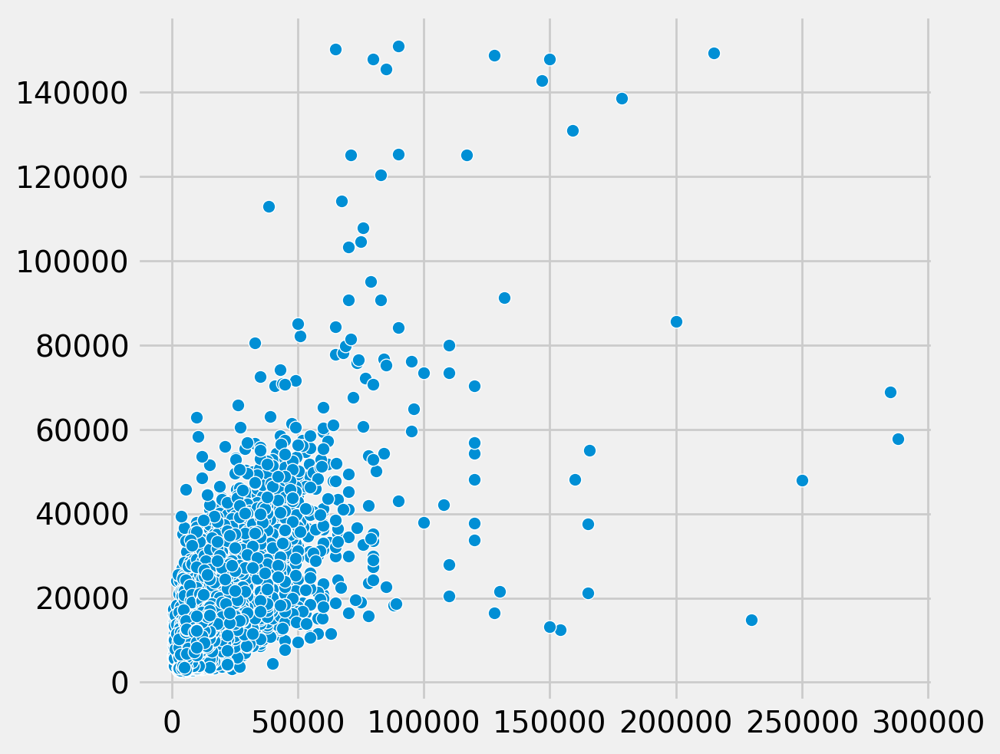

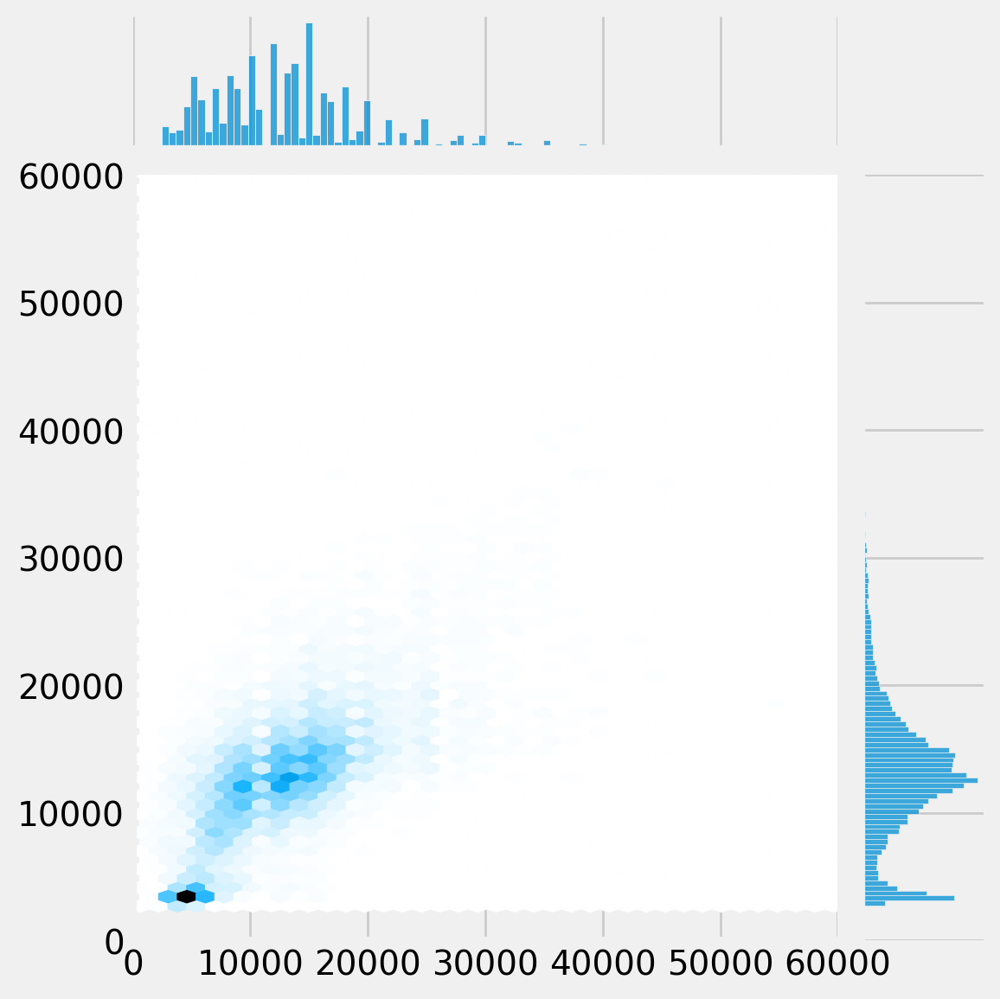

In [ ]:
test_n_plot(best_model,iter_dict['vld'],criterion,device) #gridsize 180
test_n_plot(best_model,iter_dict['vld'],criterion,device,scatter=False,gridsize=180) #gridsize 180

8483.909829789565 	r2 :  0.4573727250099182 	mape :  0.3639279


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8483.909829789565 	r2 :  0.4573727250099182 	mape :  0.3639279


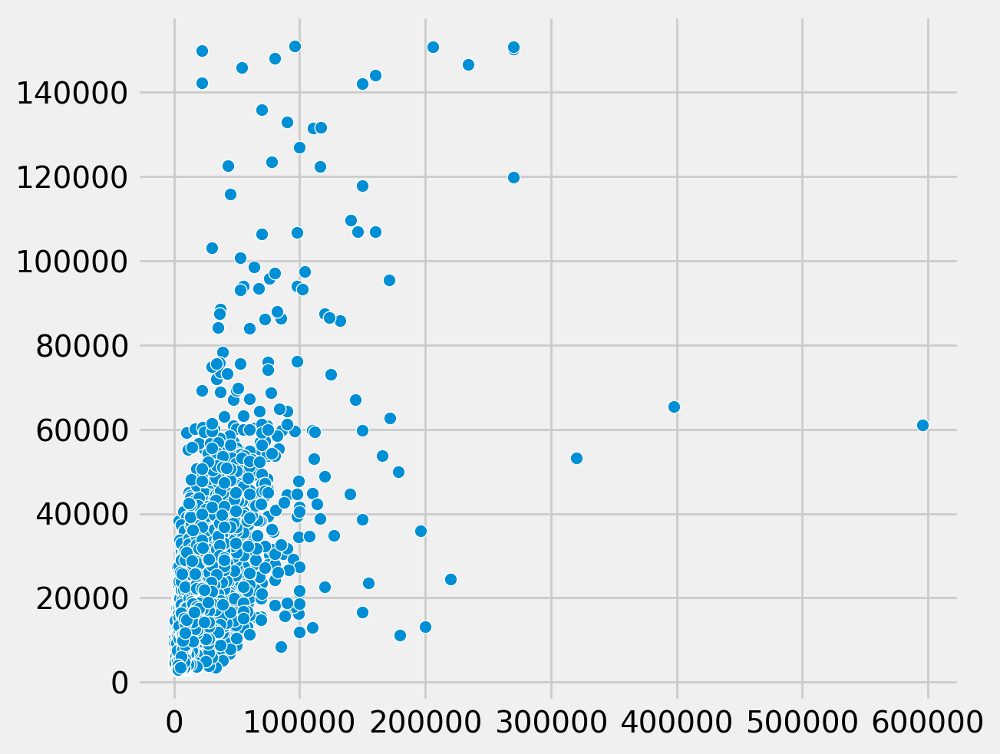

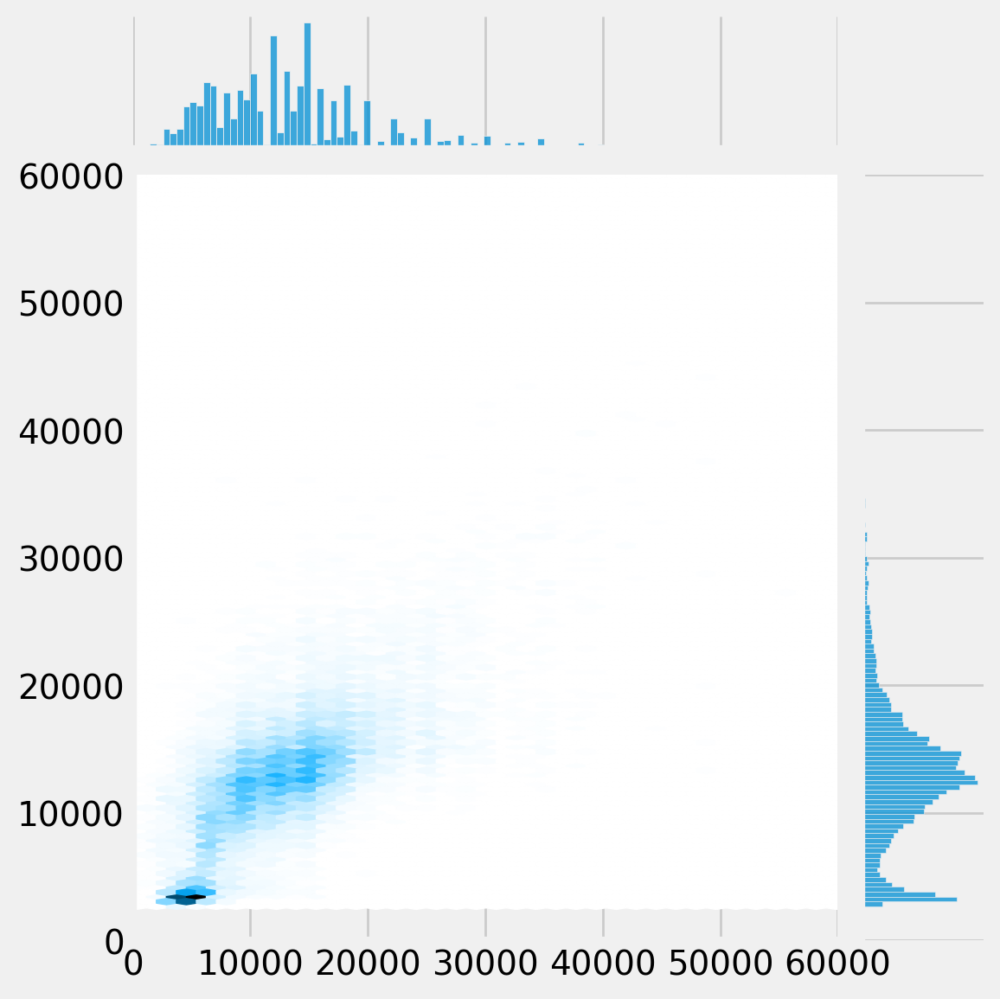

In [ ]:
test_n_plot(best_model,iter_dict['tst'],criterion,device) #gridsize 350
test_n_plot(best_model,iter_dict['tst'],criterion,device,scatter=False,gridsize=350) #gridsize 350

5421.616094572086 	r2 :  0.7526980638504028 	mape :  0.28877568


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


5421.616094572086 	r2 :  0.7526980638504028 	mape :  0.28877568


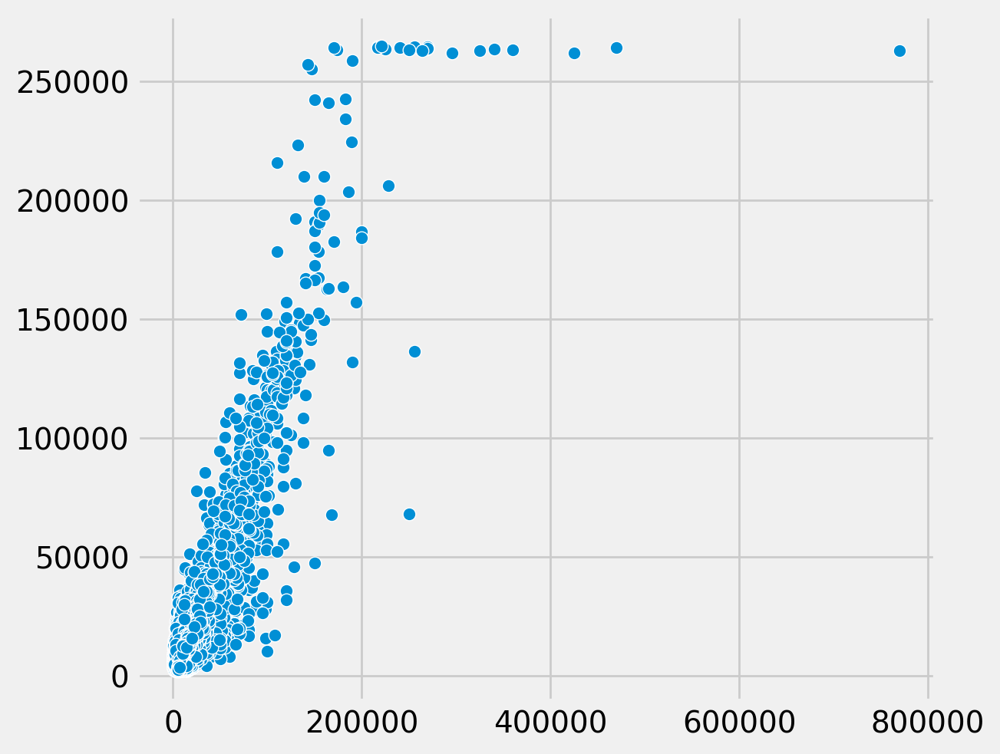

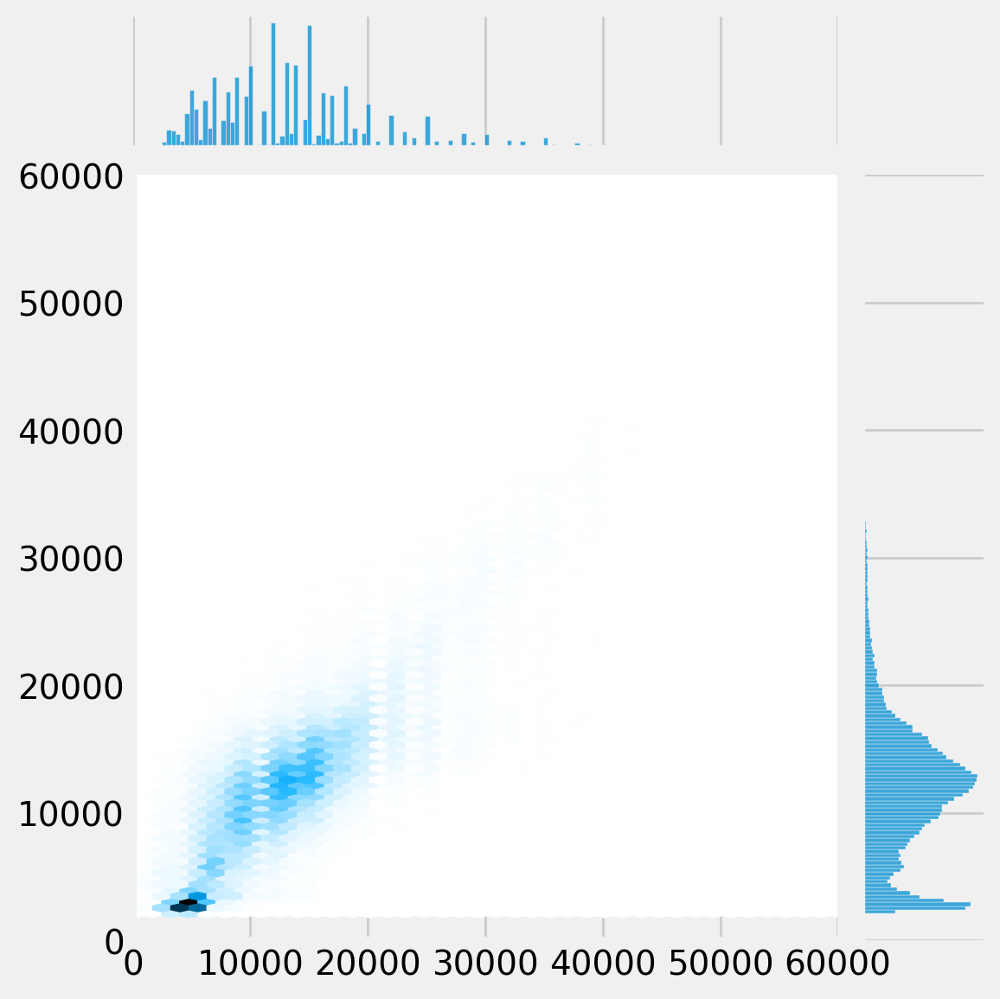

In [ ]:
test_n_plot(model,iter_dict['trn'],criterion,device) #gridsize 500
test_n_plot(model,iter_dict['trn'],criterion,device,scatter=False,gridsize=500) #gridsize 500

8262.704762969568 	r2 :  0.4583730101585388 	mape :  0.35924602


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8262.704762969568 	r2 :  0.4583730101585388 	mape :  0.35924602


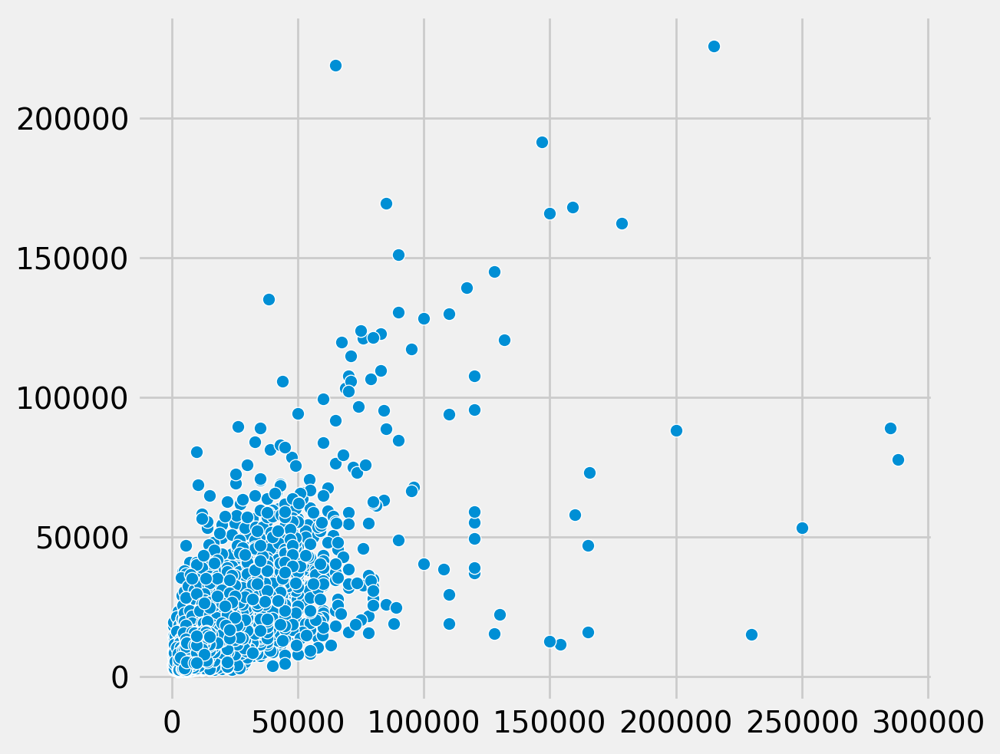

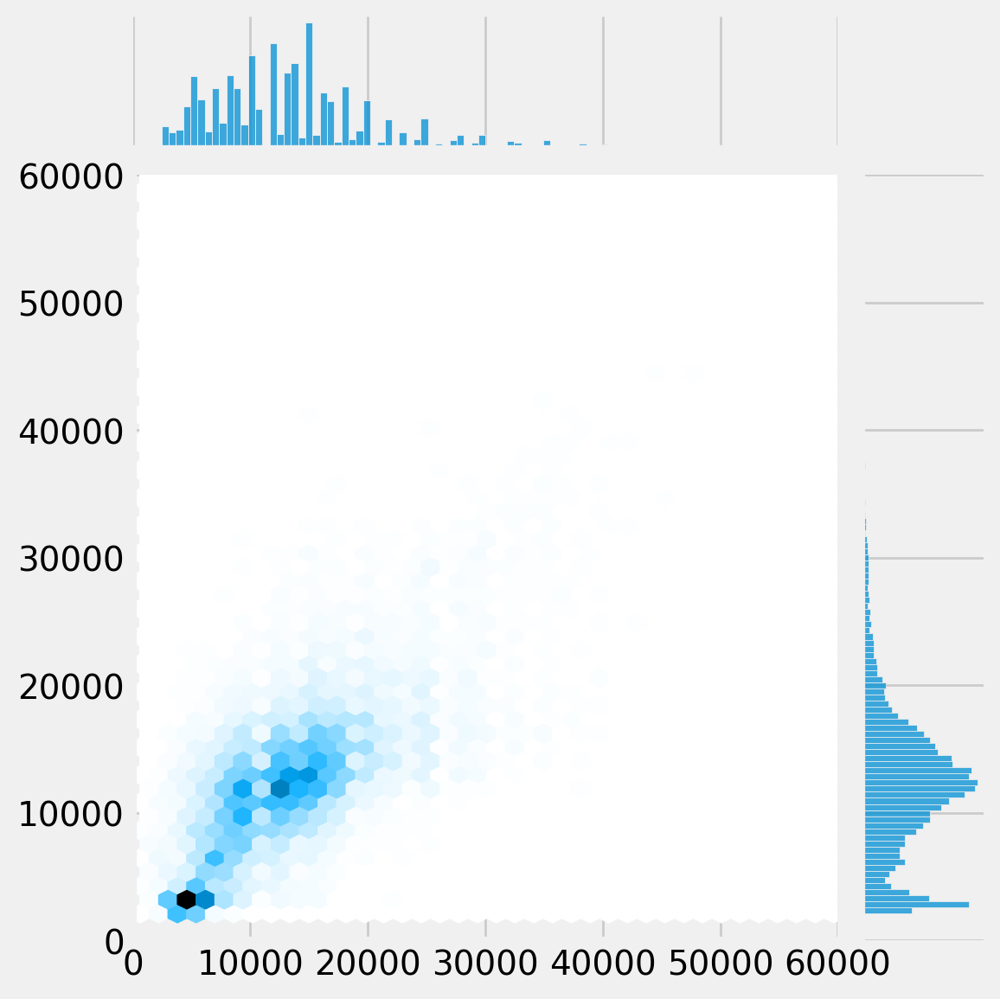

In [ ]:
test_n_plot(model,iter_dict['vld'],criterion,device) #gridsize 180
test_n_plot(model,iter_dict['vld'],criterion,device,scatter=False,gridsize=180)

8606.021670899976 	r2 :  0.4417092204093933 	mape :  0.359285


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8606.021670899976 	r2 :  0.4417092204093933 	mape :  0.359285


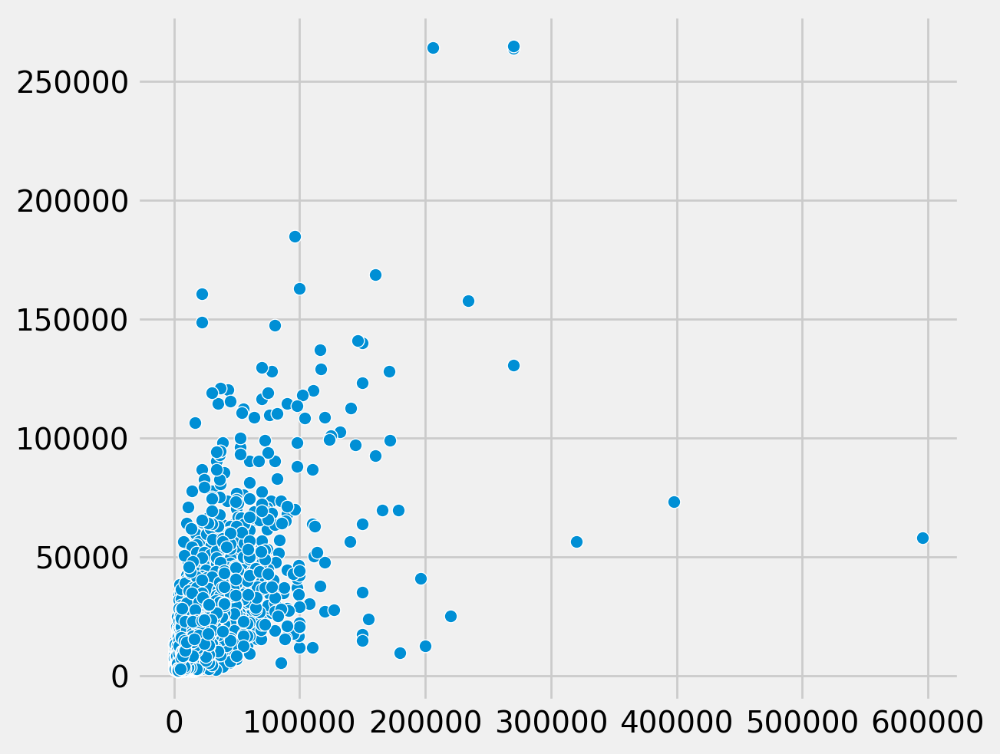

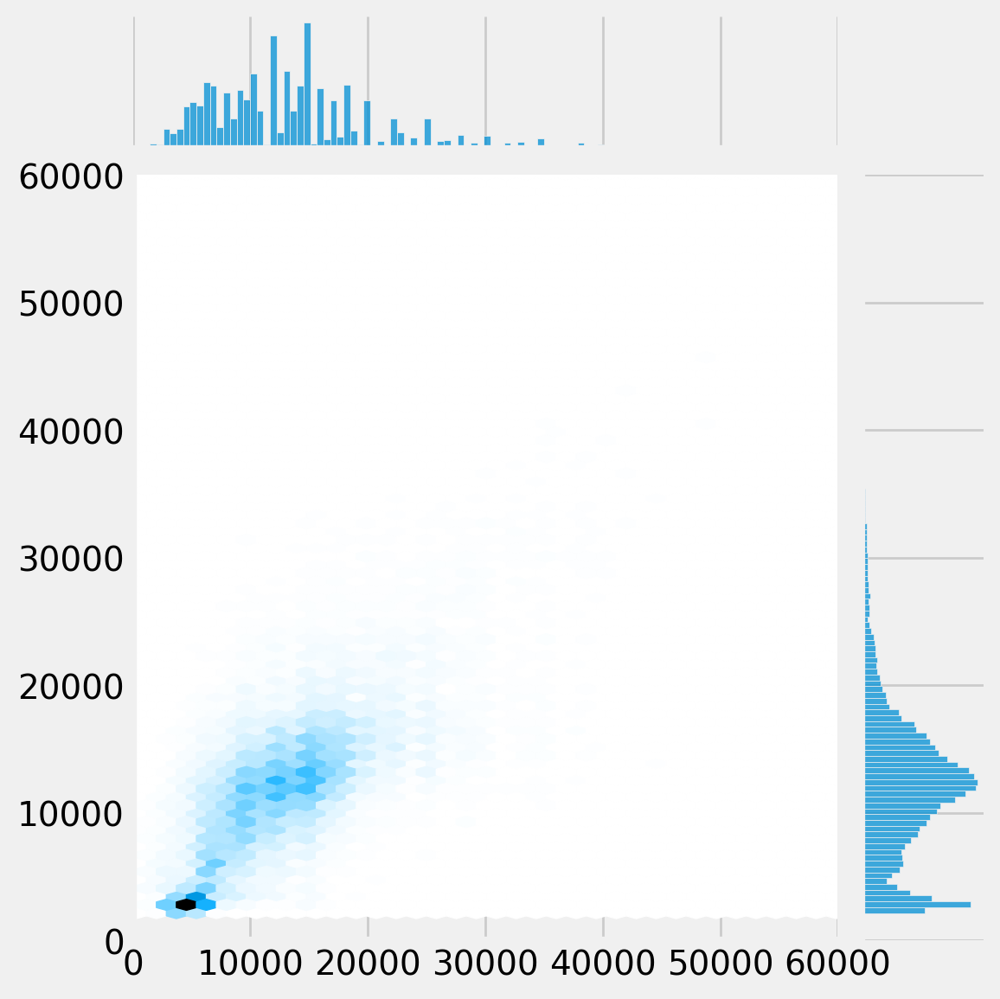

In [ ]:
test_n_plot(model,iter_dict['tst'],criterion,device) #gridsize 350
test_n_plot(model,iter_dict['tst'],criterion,device,scatter=False,gridsize=350) #gridsize 350

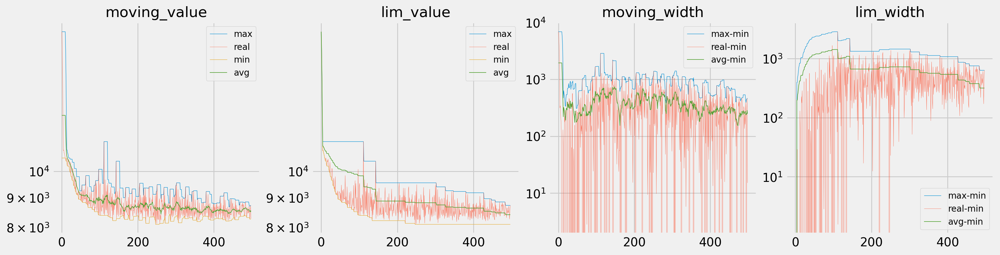

In [ ]:
x = val_loss
plot_area(x,start=0,end=-1);
#plot_area(x,start=750,end=-1,log=False);

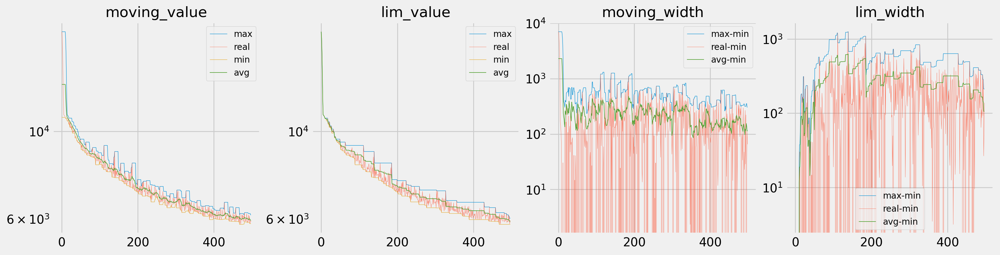

In [ ]:
x = train_loss
plot_area(x,start=0,end=-1);

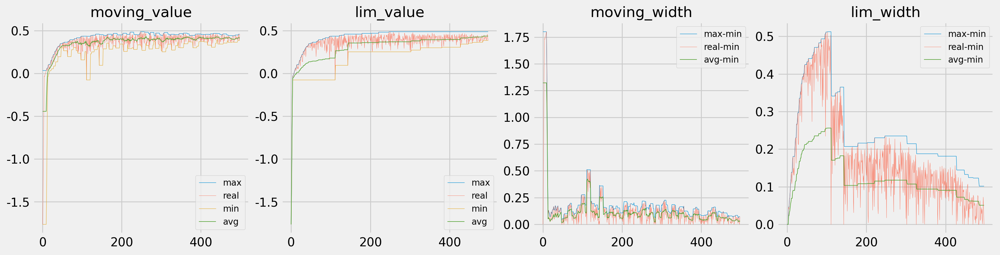

In [ ]:
x = val_score
plot_area(x,False,start=0,end=-1,log=False);

# data box 6

# train, evaluate

In [ ]:
model, train_config, init_lr,save_dir,file_name = box_expt_config(6)
model,train_loss,val_loss,train_score,val_score,best_epoch = run(model,train_config,iter_dict_box[1]['trn'],iter_dict_box[1]['vld'],epoch,warmup,8500,save_dir,file_name[:-3])
torch.save(model,os.path.join(save_dir,file_name))
save_pkl(save_dir,'train_loss.pkl',train_loss)
save_pkl(save_dir,'valid_loss.pkl',val_loss)
save_pkl(save_dir,'valid_score.pkl',val_score)

The model has 11,852,587 trainable parameters
Epoch:     1		lr: 0.00009245
	Train Loss: 16028.539	Train Score: -2.850	Val Loss: 15907.730	Val Score: -2.831
Epoch:     2		lr: 0.00009245
	Train Loss: 15792.346	Train Score: -2.740	Val Loss: 15527.422	Val Score: -2.650
Epoch:     3		lr: 0.00009245
	Train Loss: 15332.240	Train Score: -2.528	Val Loss: 14912.197	Val Score: -2.368
Epoch:     4		lr: 0.00009245
	Train Loss: 14660.773	Train Score: -2.229	Val Loss: 14094.904	Val Score: -2.011
Epoch:     5		lr: 0.00009245
	Train Loss: 13808.672	Train Score: -1.867	Val Loss: 13108.078	Val Score: -1.606
Epoch:     6		lr: 0.00009245
	Train Loss: 12806.008	Train Score: -1.468	Val Loss: 11990.887	Val Score: -1.183
Epoch:     7		lr: 0.00009245
	Train Loss: 11693.129	Train Score: -1.060	Val Loss: 10795.863	Val Score: -0.773
Epoch:     8		lr: 0.00009245
	Train Loss: 10530.860	Train Score: -0.672	Val Loss: 9621.622	Val Score: -0.412
Epoch:     9		lr: 0.00009245
	Train Loss: 9422.528	Train Score: -0.338	Val 

In [ ]:
model, train_config, init_lr,save_dir,file_name = box_expt_config(6)
init_lr *=(406/450)
model,train_loss,val_loss,train_score,val_score,best_epoch = run(model,train_config,iter_dict_box[1]['trn'],iter_dict_box[1]['vld'],epoch,warmup,8500,save_dir,file_name[:-3])
torch.save(model,os.path.join(save_dir,file_name))
save_pkl(save_dir,'train_loss.pkl',train_loss)
save_pkl(save_dir,'valid_loss.pkl',val_loss)
save_pkl(save_dir,'valid_score.pkl',val_score)

The model has 11,852,587 trainable parameters
Epoch:     1		lr: 0.00009245
	Train Loss: 16033.056	Train Score: -2.852	Val Loss: 15924.306	Val Score: -2.838
Epoch:     2		lr: 0.00009245
	Train Loss: 15818.267	Train Score: -2.752	Val Loss: 15570.205	Val Score: -2.670
Epoch:     3		lr: 0.00009245
	Train Loss: 15383.872	Train Score: -2.552	Val Loss: 14970.146	Val Score: -2.394
Epoch:     4		lr: 0.00009245
	Train Loss: 14724.848	Train Score: -2.257	Val Loss: 14143.830	Val Score: -2.031
Epoch:     5		lr: 0.00009245
	Train Loss: 13862.448	Train Score: -1.890	Val Loss: 13124.092	Val Score: -1.612
Epoch:     6		lr: 0.00009245
	Train Loss: 12826.636	Train Score: -1.477	Val Loss: 11947.307	Val Score: -1.168
Epoch:     7		lr: 0.00009245
	Train Loss: 11655.535	Train Score: -1.047	Val Loss: 10679.832	Val Score: -0.735
Epoch:     8		lr: 0.00009245
	Train Loss: 10425.184	Train Score: -0.639	Val Loss: 9446.210	Val Score: -0.361
Epoch:     9		lr: 0.00009245
	Train Loss: 9263.572	Train Score: -0.294	Val 

In [ ]:
model, train_config, init_lr,save_dir,file_name = box_expt_config(6)
init_lr *=(best_epoch/450)*(406/450)
model,train_loss,val_loss,train_score,val_score,best_epoch = run(model,train_config,iter_dict_box[1]['trn'],iter_dict_box[1]['vld'],epoch,warmup,8500,save_dir,file_name[:-3])
torch.save(model,os.path.join(save_dir,file_name))
save_pkl(save_dir,'train_loss.pkl',train_loss)
save_pkl(save_dir,'valid_loss.pkl',val_loss)
save_pkl(save_dir,'valid_score.pkl',val_score)

The model has 11,852,587 trainable parameters
Epoch:     1		lr: 0.00009245
	Train Loss: 16035.993	Train Score: -2.853	Val Loss: 15925.611	Val Score: -2.839
Epoch:     2		lr: 0.00009245
	Train Loss: 15818.309	Train Score: -2.752	Val Loss: 15564.046	Val Score: -2.667
Epoch:     3		lr: 0.00009245
	Train Loss: 15366.496	Train Score: -2.544	Val Loss: 14942.699	Val Score: -2.382
Epoch:     4		lr: 0.00009245
	Train Loss: 14679.490	Train Score: -2.237	Val Loss: 14090.675	Val Score: -2.009
Epoch:     5		lr: 0.00009245
	Train Loss: 13785.349	Train Score: -1.858	Val Loss: 13048.666	Val Score: -1.582
Epoch:     6		lr: 0.00009245
	Train Loss: 12719.556	Train Score: -1.436	Val Loss: 11853.793	Val Score: -1.134
Epoch:     7		lr: 0.00009245
	Train Loss: 11531.625	Train Score: -1.004	Val Loss: 10583.800	Val Score: -0.704
Epoch:     8		lr: 0.00009245
	Train Loss: 10298.075	Train Score: -0.599	Val Loss: 9359.549	Val Score: -0.337
Epoch:     9		lr: 0.00009245
	Train Loss: 9161.084	Train Score: -0.265	Val 

In [ ]:
ls {save_dir}/../

model4.1_1024_500_N6/              model4.5_512_1000_N3_0.2lr/
model4_16384_1000_N9/              model4.5_512_1000_N6_0.2lr/
model4.1_8192_500_N6/              model4.5_512_1000_N9_0.2lr/
model4_256_1000_N9/                model4.5_512_100_N3/
model4_512_1000/                   model4.5_512_450_N1/
model4_512_1500/                   model4.5_512_450_N3/
model4.5_16384_150_N1/             model4.5_512_450_N6/
model4.5_16384_150_N3/             model4.5_65536_450_N1/
model4.5_16384_150_N6/             model4.5_8192_150_N1/
model4.5_16384_300_N6/             model4.5_8192_200_N9/
model4.5_16384_450_N1/             model4.5_8192_450_N1/
model4.5_16384_500_N6/             model4.5_8192_450_N12/
model4.5_16384_500_N6_lr0.000045/  model4.5_8192_450_N3/
model4.5_16384_500_N6_lr0.000082/  model4.5_8192_450_N6/
model4.5_16384_500_N6_lr0.000087/  model4.5_8192_450_N9/
model4.5_16384_500_N6_lr0.000094/  model4.5_8192_500_N6/
model4.5_16384_500_N6_lr0.000167/  model4.5_8192_500_N6_lr0.00003/
model

In [ ]:
_, train_config, init_lr,save_dir,file_name = box_expt_config(6)

The model has 11,852,587 trainable parameters


/content/drive/MyDrive/kdt-EST-AI/project/project2/module_aladin/torch_train.py:164: FutureWarning: `nn.init.kaiming_uniform` is now deprecated in favor of `nn.init.kaiming_uniform_`.
  nn.init.kaiming_uniform(m.weight.data)
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


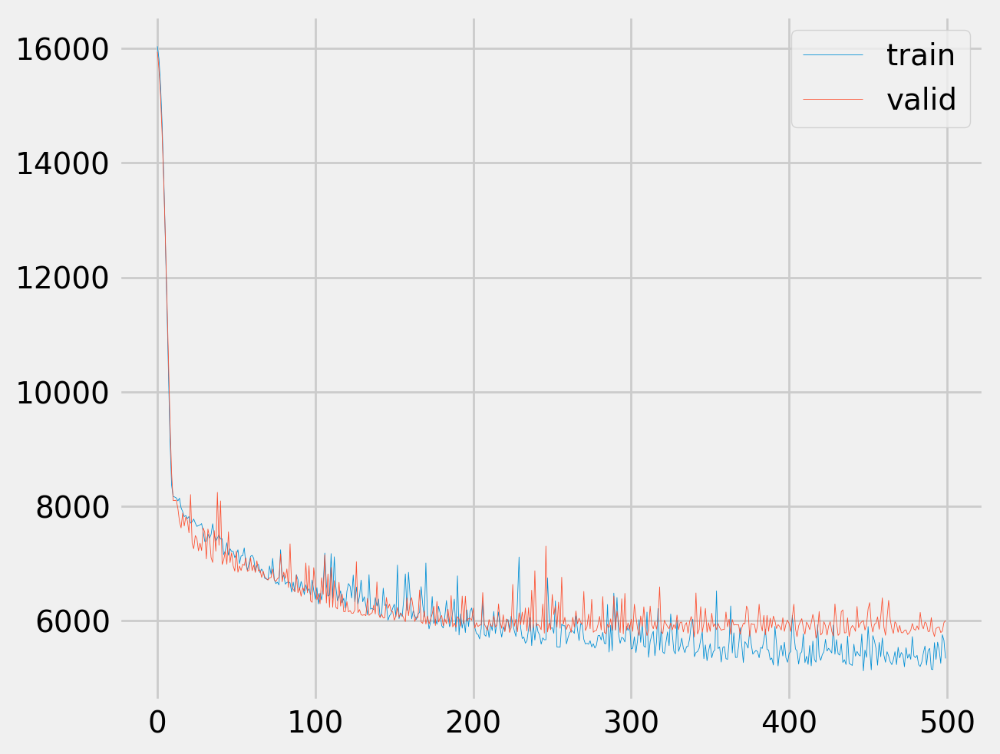

In [ ]:
train_loss = load_pkl(os.path.join(save_dir,'train_loss.pkl'))
valid_loss = load_pkl(os.path.join(save_dir,'valid_loss.pkl'))
valid_score = load_pkl(os.path.join(save_dir,'valid_score.pkl'))

loss_train = np.array(train_loss)
loss_valid = np.array(val_loss)

fig, ax = plt.subplots()

ax.plot(range(len(loss_train)),loss_train,label='train',lw=0.3)
ax.plot(range(len(loss_valid)),loss_valid,label='valid',lw=0.3)
#ax.set_yscale('log')
ax.legend();

In [ ]:
best_model = torch.load(os.path.join(save_dir,f'best_{file_name}'))
criterion = train_config[-2]

<ipython-input-73-a000df0fdf5f>:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  best_model = torch.load(os.path.join(save_dir,f'best_{file_name}'))


6079.8402813029425 	r2 :  0.6872004866600037 	mape :  0.31050563


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


6079.8402813029425 	r2 :  0.6872004866600037 	mape :  0.31050563


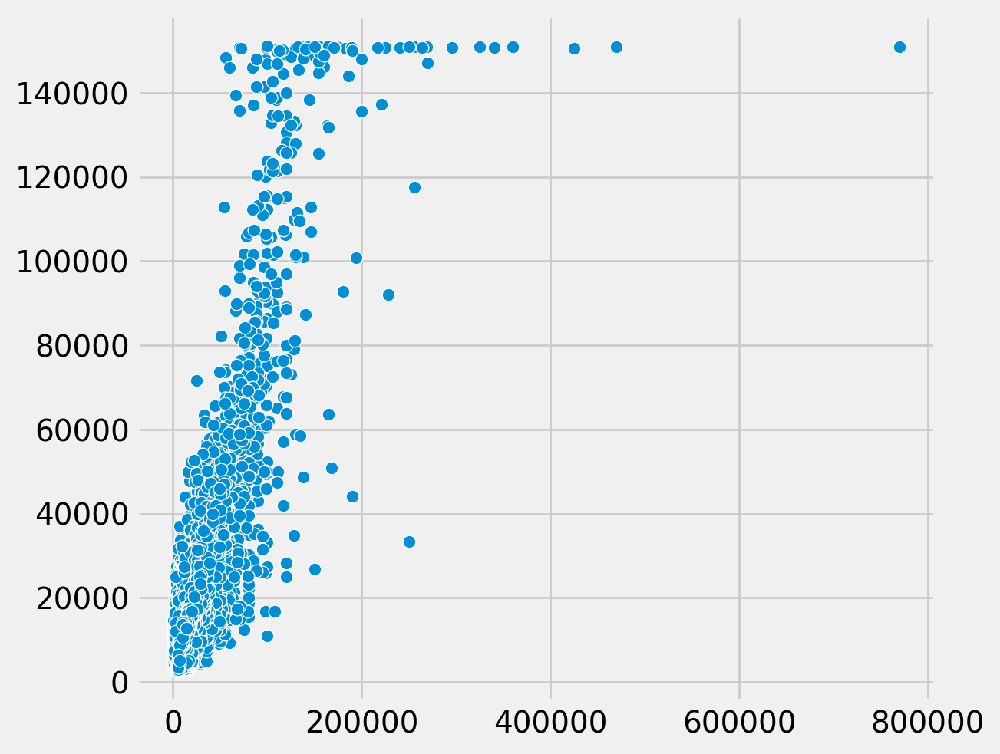

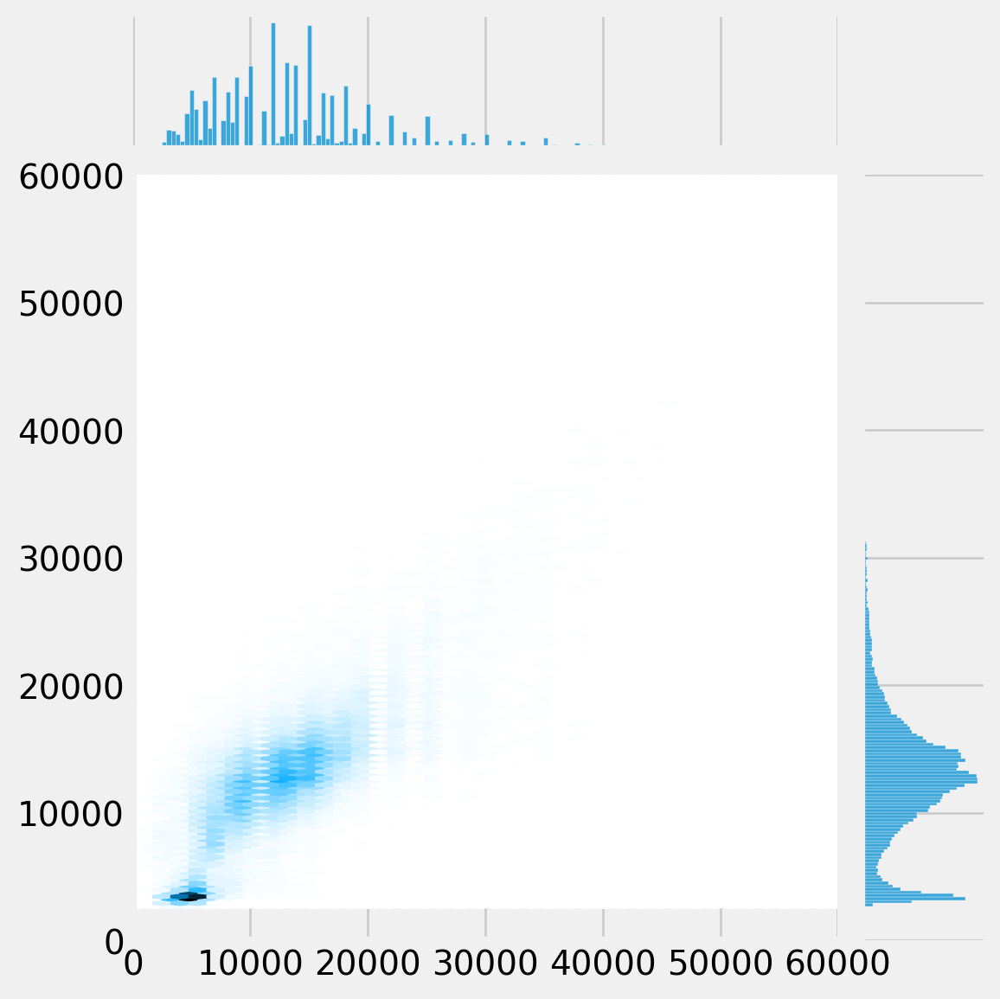

In [ ]:
test_n_plot(best_model,iter_dict['trn'],criterion,device) #gridsize 500
test_n_plot(best_model,iter_dict['trn'],criterion,device,scatter=False,gridsize=500) #gridsize 500

8099.6480787747805 	r2 :  0.48702794313430786 	mape :  0.3616164


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8099.6480787747805 	r2 :  0.48702794313430786 	mape :  0.3616164


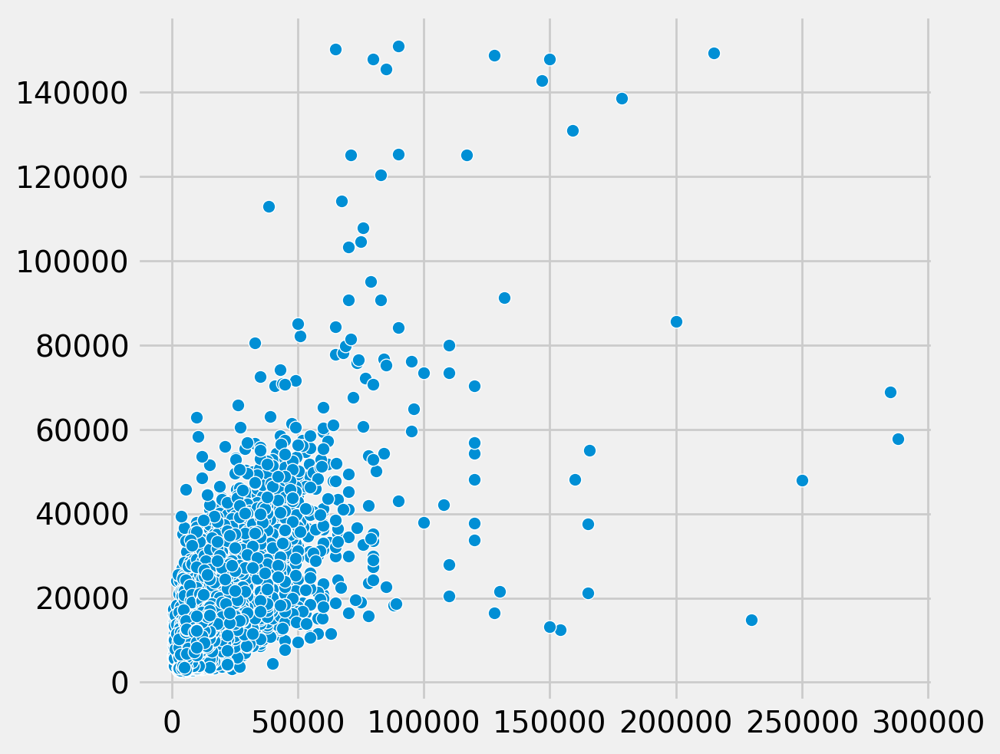

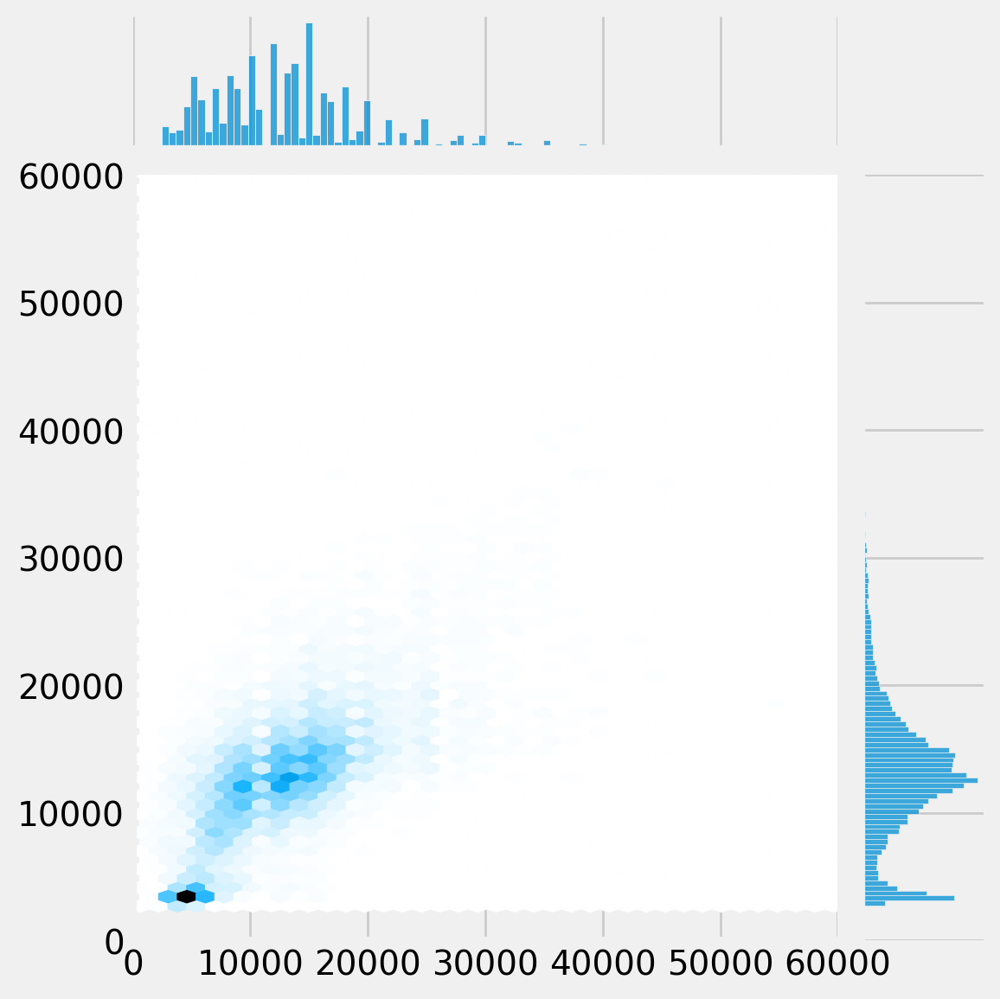

In [ ]:
test_n_plot(best_model,iter_dict['vld'],criterion,device) #gridsize 180
test_n_plot(best_model,iter_dict['vld'],criterion,device,scatter=False,gridsize=180) #gridsize 180

8483.909829789565 	r2 :  0.4573727250099182 	mape :  0.3639279


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8483.909829789565 	r2 :  0.4573727250099182 	mape :  0.3639279


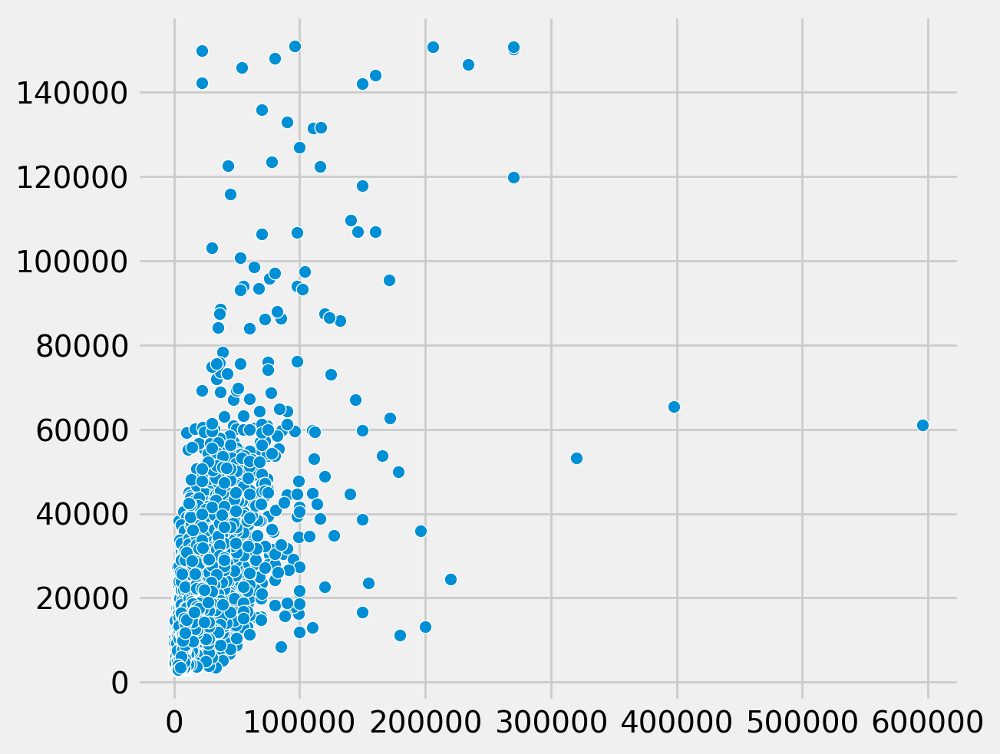

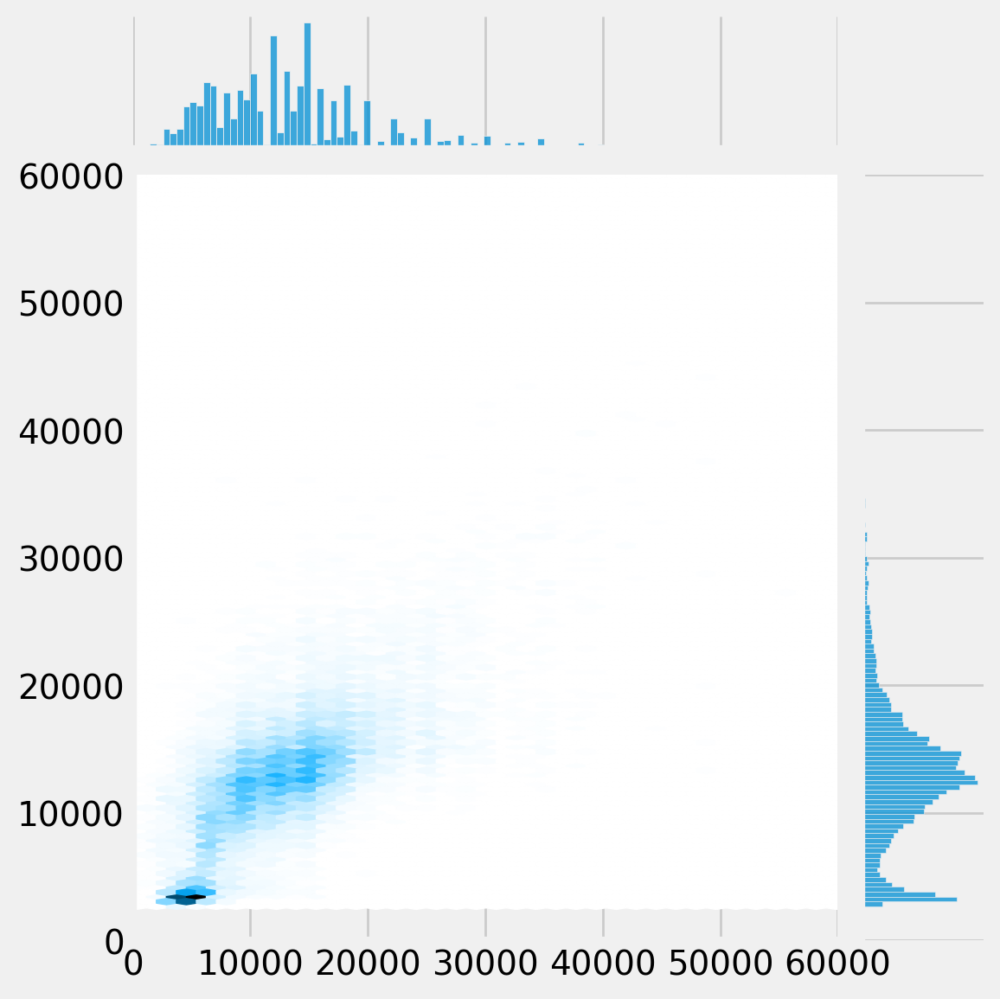

In [ ]:
test_n_plot(best_model,iter_dict['tst'],criterion,device) #gridsize 350
test_n_plot(best_model,iter_dict['tst'],criterion,device,scatter=False,gridsize=350) #gridsize 350

5421.616094572086 	r2 :  0.7526980638504028 	mape :  0.28877568


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


5421.616094572086 	r2 :  0.7526980638504028 	mape :  0.28877568


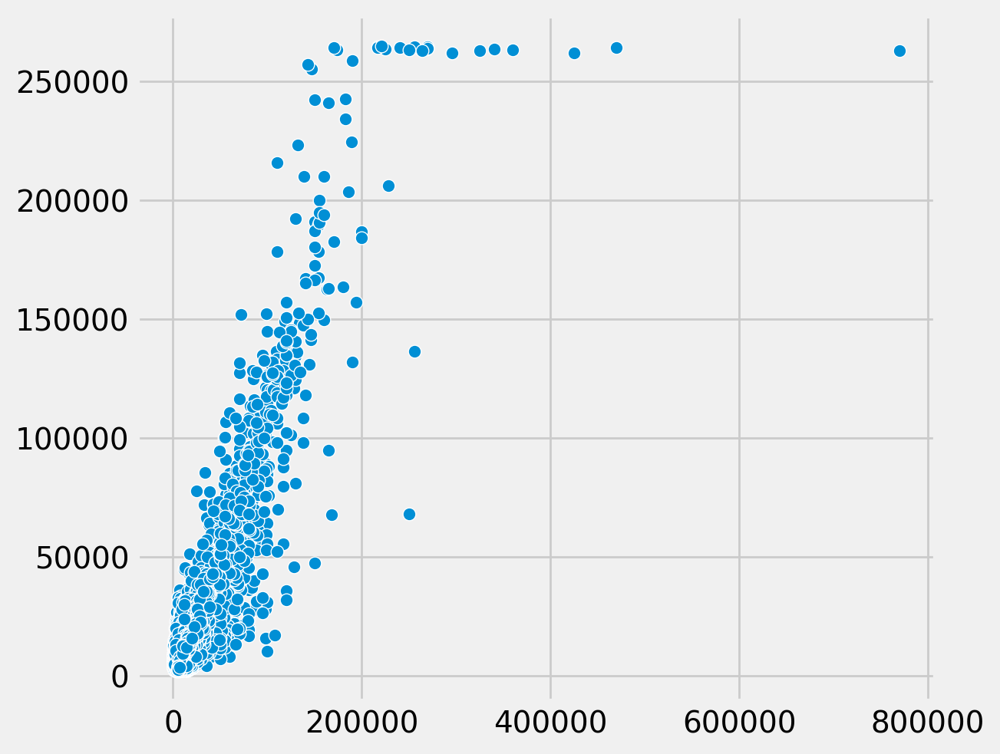

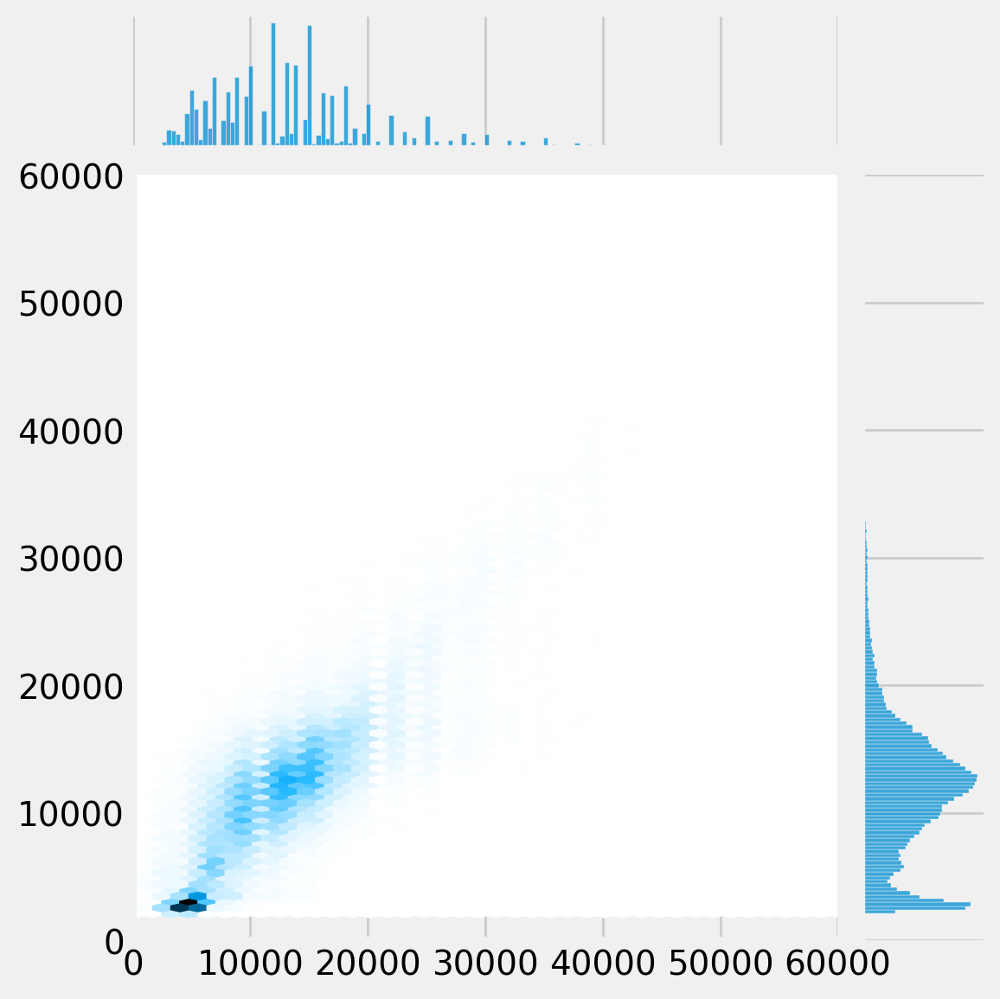

In [ ]:
test_n_plot(model,iter_dict['trn'],criterion,device) #gridsize 500
test_n_plot(model,iter_dict['trn'],criterion,device,scatter=False,gridsize=500) #gridsize 500

8262.704762969568 	r2 :  0.4583730101585388 	mape :  0.35924602


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8262.704762969568 	r2 :  0.4583730101585388 	mape :  0.35924602


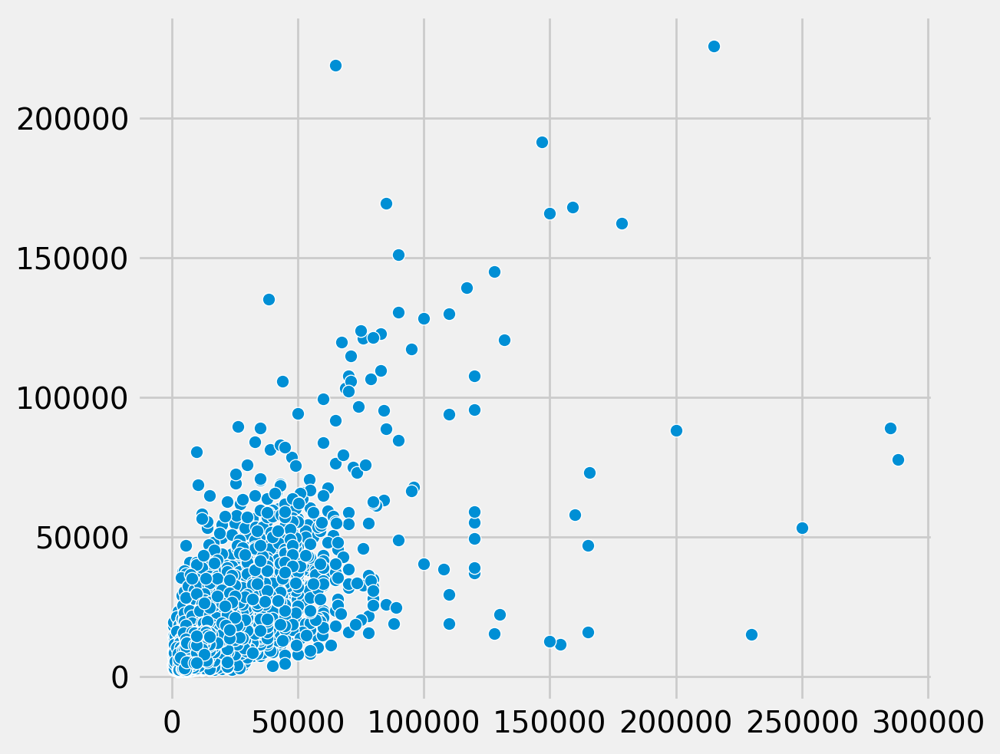

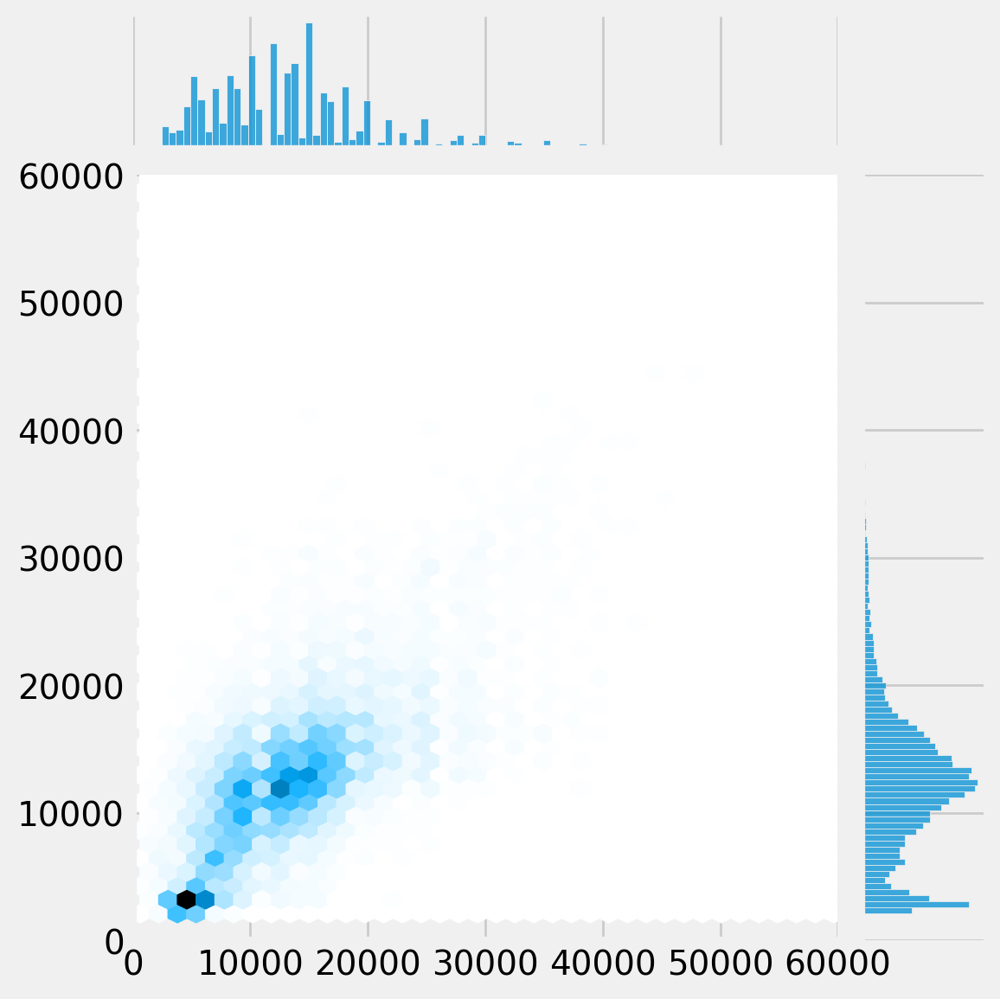

In [ ]:
test_n_plot(model,iter_dict['vld'],criterion,device) #gridsize 180
test_n_plot(model,iter_dict['vld'],criterion,device,scatter=False,gridsize=180)

8606.021670899976 	r2 :  0.4417092204093933 	mape :  0.359285


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8606.021670899976 	r2 :  0.4417092204093933 	mape :  0.359285


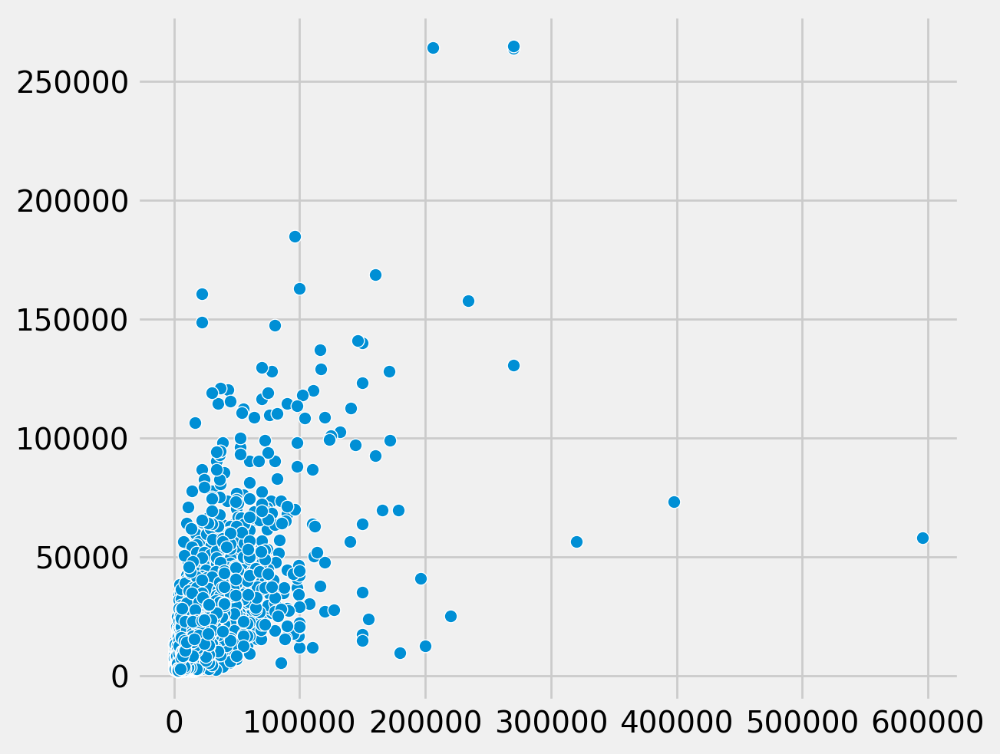

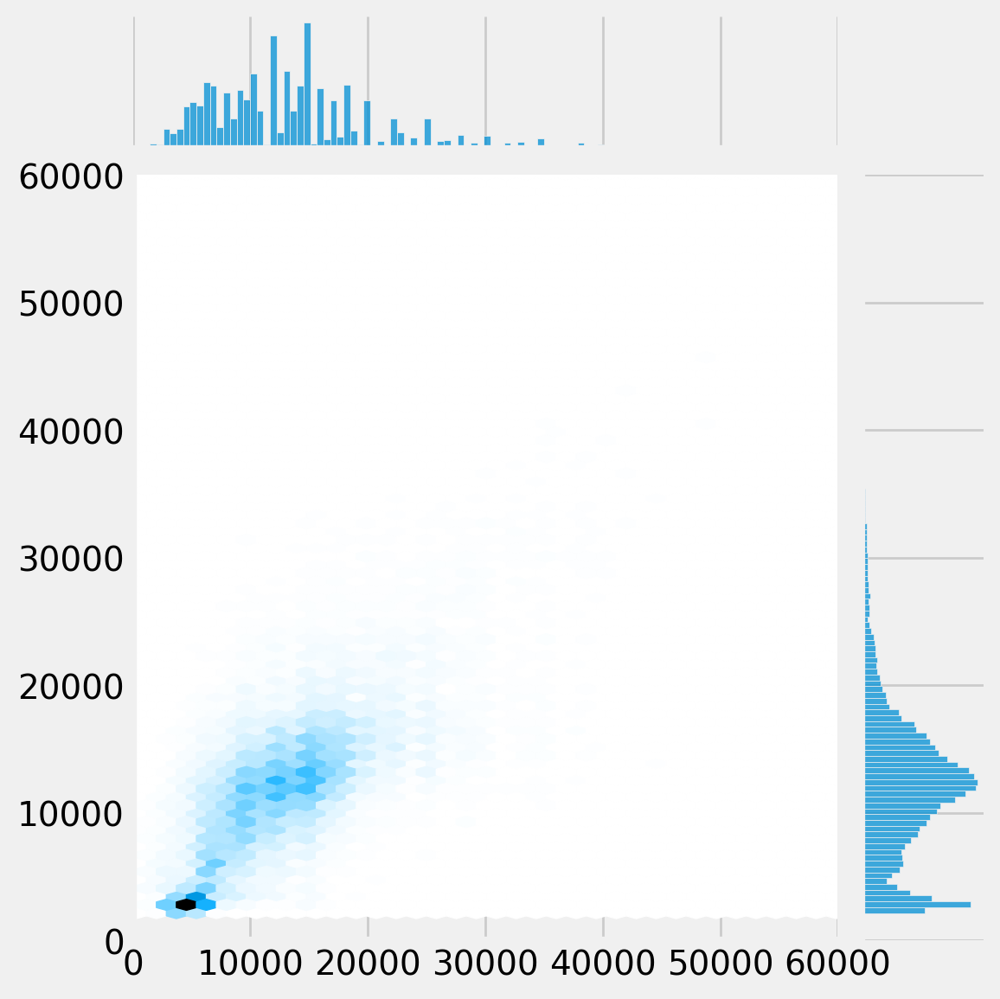

In [ ]:
test_n_plot(model,iter_dict['tst'],criterion,device) #gridsize 350
test_n_plot(model,iter_dict['tst'],criterion,device,scatter=False,gridsize=350) #gridsize 350

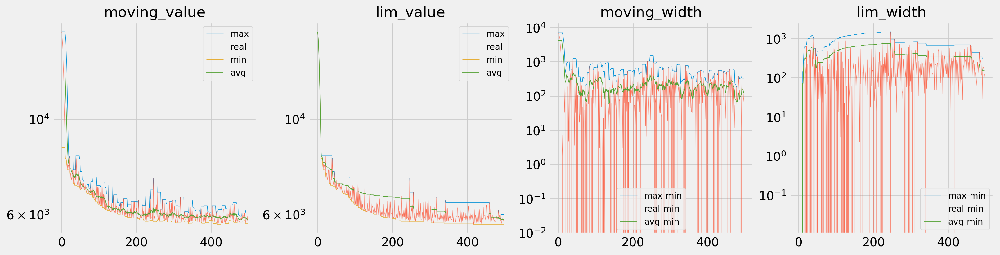

In [ ]:
x = val_loss
plot_area(x,start=0,end=-1);
#plot_area(x,start=750,end=-1,log=False);

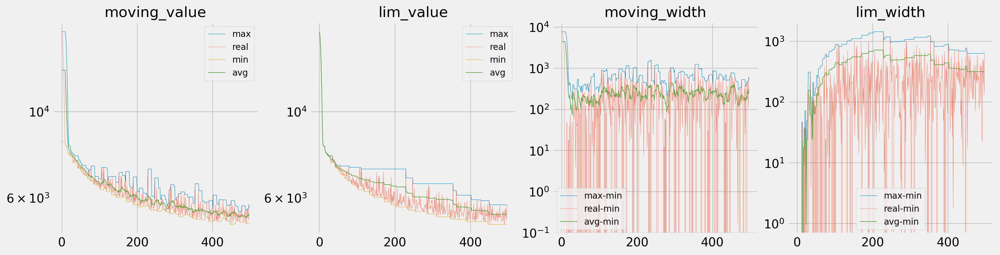

In [ ]:
x = train_loss
plot_area(x,start=0,end=-1);

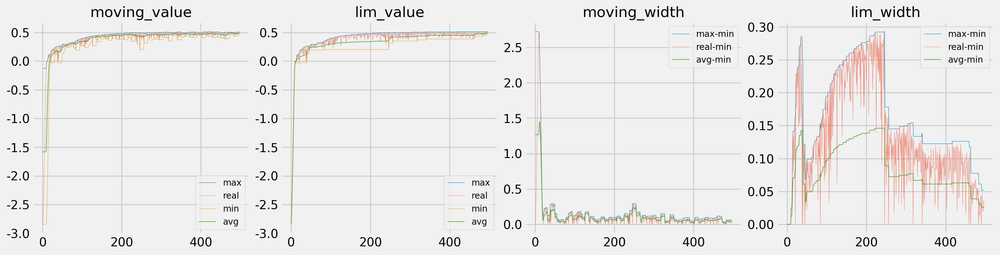

In [ ]:
x = val_score
plot_area(x,False,start=0,end=-1,log=False);